In [41]:
import matplotlib
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import sys, cv2, glob, os, time
import pandas as pd 
import io
import numpy as np
from keras.datasets import mnist
from keras.layers import Input, Dense, Reshape, Flatten,Activation
from keras.layers import LeakyReLU
from keras.models import Sequential, Model
import numpy as np # linear algebra

import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list the files in the input directory

from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

import os
import glob
import cv2
import tensorflow as tf
from keras import layers
from keras.layers import Dropout , Input, Add, Dense, Activation, ZeroPadding2D, BatchNormalization, Flatten, Conv2D, AveragePooling2D, MaxPooling2D, GlobalMaxPooling2D
from keras.models import Model, load_model
from keras.initializers import glorot_uniform
from sklearn.model_selection import train_test_split
import keras.backend as K
from sklearn.utils import shuffle
# importing all necessary libraries to run the code
import re,string
import numpy as np
import pandas as pd
import keras_metrics
import tensorflow.keras
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
from keras.models import Sequential
from sklearn.model_selection import train_test_split
from keras.layers import Dense, Flatten, LSTM, Conv1D, MaxPooling1D, Dropout, Activation,Embedding
# using the variable sw to hold all stopwords that are in English
sw = stopwords.words('english')
import matplotlib.pyplot as plt

import numpy as np # linear algebra

import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list the files in the input directory

import os
import glob
import cv2
import tensorflow as tf
from keras import layers
from keras.layers import Dropout , Input, Add, Dense, Activation, ZeroPadding2D, BatchNormalization, Flatten, Conv2D, AveragePooling2D, MaxPooling2D, GlobalMaxPooling2D
from keras.models import Model, load_model
from keras.initializers import glorot_uniform
from sklearn.model_selection import train_test_split
import keras.backend as K
from sklearn.utils import shuffle
# importing all necessary libraries to run the code
import re,string
import numpy as np
import pandas as pd
import keras_metrics
import tensorflow.keras
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
from keras.models import Sequential
from sklearn.model_selection import train_test_split
from keras.layers import Dense, Flatten, LSTM, Conv1D, MaxPooling1D, Dropout, Activation,Embedding


In [42]:
dataUN=pd.read_csv('UNSW_NB15_testing-set.csv')
dataUN1=pd.read_csv('UNSW_NB15_training-set.csv')

dataI=pd.read_csv('IoT Network Intrusion Dataset.csv')

In [43]:
dataF=dataUN.append(dataUN1,ignore_index = True) 

C:\Users\knowl\AppData\Local\Temp\ipykernel_64164\1098381135.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataF=dataUN.append(dataUN1,ignore_index = True)


In [44]:
dataF[:2]

,id,dur,proto,service,state,spkts,dpkts,sbytes,dbytes,rate,...,ct_dst_sport_ltm,ct_dst_src_ltm,is_ftp_login,ct_ftp_cmd,ct_flw_http_mthd,ct_src_ltm,ct_srv_dst,is_sm_ips_ports,attack_cat,label
0,1,0.121478,tcp,-,FIN,6,4,258,172,74.087490,...,1,1,0,0,0,1,1,0,Normal,0
1,2,0.649902,tcp,-,FIN,14,38,734,42014,78.473372,...,1,2,0,0,0,1,6,0,Normal,0


In [45]:
dataI[:2]

,Flow_ID,Src_IP,Src_Port,Dst_IP,Dst_Port,Protocol,Timestamp,Flow_Duration,Tot_Fwd_Pkts,Tot_Bwd_Pkts,...,Active_Std,Active_Max,Active_Min,Idle_Mean,Idle_Std,Idle_Max,Idle_Min,Label,Cat,Sub_Cat
0,192.168.0.13-192.168.0.16-10000-10101-17,192.168.0.13,10000,192.168.0.16,10101,17,25/07/2019 03:25:53 AM,75,1,1,...,0.0,0.0,0.0,75.0,0.000000,75.0,75.0,Anomaly,Mirai,Mirai-Ackflooding
1,192.168.0.13-222.160.179.132-554-2179-6,222.160.179.132,2179,192.168.0.13,554,6,26/05/2019 10:11:06 PM,5310,1,2,...,0.0,0.0,0.0,2655.0,2261.327486,4254.0,1056.0,Anomaly,DoS,DoS-Synflooding


In [46]:
from collections import Counter
Counter(dataF['label'])

Counter({0: 93000, 1: 164673})

In [47]:
from collections import Counter
Counter(dataI['Label'])

Counter({'Anomaly': 585710, 'Normal': 40073})

In [48]:
dataF1=dataF.loc[dataF['label'] == 0]
print(len(dataF1))
dataF2=dataF.loc[dataF['label'] == 1]
print(len(dataF2))

93000
164673


In [49]:
from collections import Counter
Counter(dataI["Label"])

Counter({'Anomaly': 585710, 'Normal': 40073})

In [50]:
dataF.rename(columns = {'label':'Label'}, inplace = True)
dataF.rename(columns = {'attack_cat':'Sub_Cat'}, inplace = True)

In [51]:
DataITarget=dataI[["Label","Cat","Sub_Cat"]]

dataIFeatures=dataI.drop(["Label","Cat","Sub_Cat"], axis=1)

DataFTarget=dataF[["Sub_Cat","Label"]]

dataFFeatures=dataF.drop(["Sub_Cat","Label"], axis=1)

In [52]:
DataITarget["Sub_Cat"]=DataITarget["Sub_Cat"].replace('Normal','Normal_I')

C:\Users\knowl\AppData\Local\Temp\ipykernel_64164\4285179342.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  DataITarget["Sub_Cat"]=DataITarget["Sub_Cat"].replace('Normal','Normal_I')


In [53]:
from collections import Counter
Counter(DataITarget["Label"])

Counter({'Anomaly': 585710, 'Normal': 40073})

In [54]:
from collections import Counter
Counter(DataFTarget["Label"])

Counter({0: 93000, 1: 164673})

In [55]:
DataFTarget['Label']=DataFTarget['Label']. replace([0,1], ['Normal','Anomaly'])

C:\Users\knowl\AppData\Local\Temp\ipykernel_64164\2780207215.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  DataFTarget['Label']=DataFTarget['Label']. replace([0,1], ['Normal','Anomaly'])


In [56]:
from collections import Counter
Counter(DataFTarget["Label"])

Counter({'Normal': 93000, 'Anomaly': 164673})

In [57]:
from sklearn import preprocessing 
from sklearn.preprocessing import LabelEncoder
le = preprocessing.LabelEncoder()

dataIFeatures=dataIFeatures.apply(LabelEncoder().fit_transform)

In [58]:
dataFFeatures=dataFFeatures.apply(LabelEncoder().fit_transform)

In [59]:
dataFFeatures

,id,dur,proto,service,state,spkts,dpkts,sbytes,dbytes,rate,...,ct_dst_ltm,ct_src_dport_ltm,ct_dst_sport_ltm,ct_dst_src_ltm,is_ftp_login,ct_ftp_cmd,ct_flw_http_mthd,ct_src_ltm,ct_srv_dst,is_sm_ips_ports
0,0,20146,113,0,4,5,4,104,41,75594,...,0,0,0,0,0,0,0,0,0,0
1,1,53096,113,0,4,13,38,355,5629,77008,...,0,0,0,1,0,0,0,0,5,0
2,2,92449,113,0,4,7,16,157,3860,12916,...,1,0,0,2,0,0,0,1,5,0
3,3,93289,113,3,4,11,12,298,305,12015,...,1,0,0,2,1,1,0,1,0,0
4,4,39276,113,0,4,9,6,246,69,54059,...,1,1,0,39,0,0,0,1,38,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
257668,82327,5,119,0,5,1,0,25,0,115757,...,1,0,0,1,0,0,0,1,0,0
257669,82328,79556,113,0,4,19,8,4758,89,35525,...,1,0,0,0,0,0,0,2,1,0
257670,82329,0,6,0,5,0,0,2,0,0,...,0,0,0,0,0,0,0,0,0,1
257671,82330,0,6,0,5,0,0,2,0,0,...,0,0,0,0,0,0,0,0,0,1


In [60]:
#dataFFeatures=dataFFeatures.drop(['pca-one','pca-two'], axis=1)

In [61]:
len(dataIFeatures)

625783

ETC


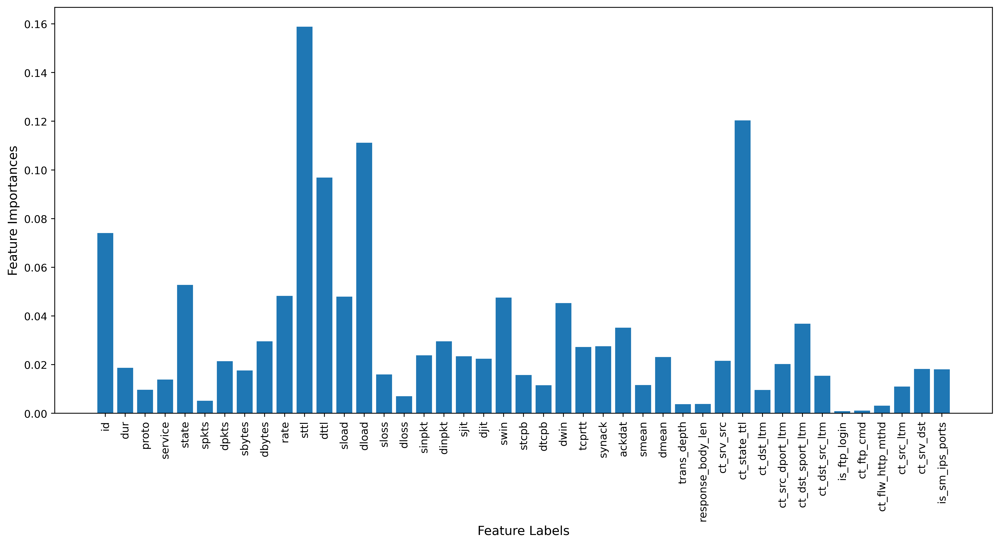

In [62]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=30)

X =dataFFeatures

y =  DataFTarget["Label"]
# Training the model
dt.fit(X, y)

# Computing the importance of each feature
feature_importance = dt.feature_importances_

# Normalizing the individual importances
feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
plt.figure(figsize=(13,7),dpi=400)
plt.xticks(rotation=90)
# Plotting a Bar Graph to compare the models
plt.bar(X.columns, feature_importance_normalized)
plt.xlabel('Feature Labels',fontsize=12)
plt.ylabel('Feature Importances',fontsize=12)


plt.tight_layout(pad=0)
plt.savefig('FeatureImp.pdf')
plt.show()

In [63]:
featuresimpF=[]
for i in range (len(X.columns)):
    if feature_importance_normalized[i]>0.02:
        featuresimpF.append(X.columns[i])
len(featuresimpF)        

23

ETC


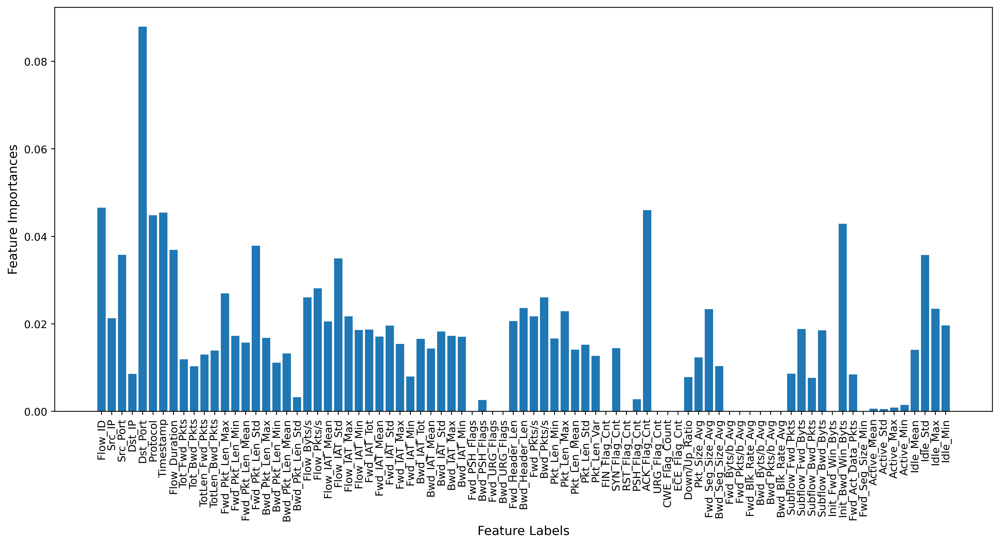

In [64]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=30)

X =dataIFeatures

y =  DataITarget["Label"]
# Training the model
dt.fit(X, y)

# Computing the importance of each feature
feature_importance = dt.feature_importances_

# Normalizing the individual importances
feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
plt.figure(figsize=(13,7),dpi=400)
plt.xticks(rotation=90)
# Plotting a Bar Graph to compare the models
plt.bar(X.columns, feature_importance_normalized)
plt.xlabel('Feature Labels',fontsize=12)
plt.ylabel('Feature Importances',fontsize=12)


plt.tight_layout(pad=0)
plt.savefig('FeatureImp.pdf')
plt.show()

In [65]:
featuresimp=[]
for i in range (len(X.columns)):
    if feature_importance_normalized[i]>0.02:
        featuresimp.append(X.columns[i])
len(featuresimp)       

24

In [66]:
dataIFeatures= dataIFeatures[featuresimp[:20]]

In [67]:
dataFFeatures= dataFFeatures[featuresimpF[:20]]

In [68]:
dataFFeatures

,id,state,dpkts,dbytes,rate,sttl,dttl,sload,dload,sinpkt,dinpkt,sjit,djit,swin,dwin,tcprtt,synack,ackdat,dmean,ct_srv_src
0,0,4,4,41,75594,10,8,55212,53560,38221,26755,12139,12505,21,18,0,0,0,4,0
1,1,4,38,5629,77008,7,6,36182,89784,56660,31225,17660,100036,21,18,0,0,0,1065,42
2,2,4,16,3860,12916,7,6,2322,73984,109569,81545,114118,113716,21,18,23094,23404,16576,784,6
3,3,4,12,305,12015,7,6,5621,25877,104156,74664,25977,107287,21,18,0,0,0,25,0
4,4,4,6,69,54059,11,6,36860,32853,55169,65933,53781,54105,21,18,29300,28980,21110,6,42
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
257668,82327,5,0,0,115757,11,0,118450,0,5,0,0,0,0,0,0,0,0,0,0
257669,82328,4,8,89,35525,11,6,83028,12230,60907,95729,81480,76786,21,18,45182,43613,30921,5,0
257670,82329,5,0,0,0,0,0,0,0,114216,0,0,0,0,0,0,0,0,0,0
257671,82330,5,0,0,0,0,0,0,0,114219,0,2829,0,0,0,0,0,0,0,0


In [69]:
a=[]
for i in range(20):
    a.append(i)

In [70]:
dataIFeatures.columns=a
dataFFeatures.columns=a

In [71]:
newfeatures=dataFFeatures.append(dataIFeatures,ignore_index = True)
newtarget=DataFTarget["Label"].append(DataITarget["Label"],ignore_index = True)

C:\Users\knowl\AppData\Local\Temp\ipykernel_64164\2545604781.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  newfeatures=dataFFeatures.append(dataIFeatures,ignore_index = True)
C:\Users\knowl\AppData\Local\Temp\ipykernel_64164\2545604781.py:2: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  newtarget=DataFTarget["Label"].append(DataITarget["Label"],ignore_index = True)


In [72]:
len(newtarget)

883456

In [73]:
from collections import Counter
Counter(newtarget)

Counter({'Normal': 133073, 'Anomaly': 750383})

In [74]:
newfeatures['target']=newtarget

In [75]:
newfeatures

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,target
0,0,4,4,41,75594,10,8,55212,53560,38221,...,12139,12505,21,18,0,0,0,4,0,Normal
1,1,4,38,5629,77008,7,6,36182,89784,56660,...,17660,100036,21,18,0,0,0,1065,42,Normal
2,2,4,16,3860,12916,7,6,2322,73984,109569,...,114118,113716,21,18,23094,23404,16576,784,6,Normal
3,3,4,12,305,12015,7,6,5621,25877,104156,...,25977,107287,21,18,0,0,0,25,0,Normal
4,4,4,6,69,54059,11,6,36860,32853,55169,...,53781,54105,21,18,29300,28980,21110,6,42,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
883451,62081,25889,10261,59,2,3443,277,16,0,1395,...,7770,0,277,1,1,4241,12794,16,0,Anomaly
883452,18760,30623,3574,10,1,3637,1648,0,0,0,...,10042,0,1649,0,8,0,11661,0,0,Anomaly
883453,12695,25886,9866,70,1,2285,77,0,0,0,...,6748,0,77,6,5,5124,13676,0,1,Anomaly
883454,12682,25883,8002,447,1,2872,240,1124,0,22392,...,7202,10012,125,14,5,4743,12868,1095,1,Normal


In [76]:
Data25=newfeatures[:220864]
dataF9=Data25.loc[Data25['target'] == "Normal"]
print(len(dataF9))
dataF10=Data25.loc[Data25['target'] == "Anomaly"]
print(len(dataF10))

76520
144344


In [77]:
Data25.to_csv('MEnDataset.csv')

In [37]:
dataF9.columns = dataF9.columns.astype(str)
dataF10.columns = dataF10.columns.astype(str)

In [38]:
dataF9['target'] = dataF9['target'].map({'Normal':0})
dataF9

C:\Users\knowl\AppData\Local\Temp\ipykernel_64164\1141975889.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataF9['target'] = dataF9['target'].map({'Normal':0})


,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,target
0,0,4,4,41,75594,10,8,55212,53560,38221,...,12139,12505,21,18,0,0,0,4,0,0
1,1,4,38,5629,77008,7,6,36182,89784,56660,...,17660,100036,21,18,0,0,0,1065,42,0
2,2,4,16,3860,12916,7,6,2322,73984,109569,...,114118,113716,21,18,23094,23404,16576,784,6,0
3,3,4,12,305,12015,7,6,5621,25877,104156,...,25977,107287,21,18,0,0,0,25,0,0
4,4,4,6,69,54059,11,6,36860,32853,55169,...,53781,54105,21,18,29300,28980,21110,6,42,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
218973,43632,4,6,69,31302,11,6,67684,17700,72824,...,69786,72620,21,18,51640,50166,32222,6,3,0
218974,43633,4,8,89,7981,11,6,50182,6599,105777,...,104973,90510,21,18,57500,51854,43451,5,3,0
218975,43634,4,10,496,4602,7,6,5283,29323,110011,...,113351,95856,21,18,55859,42724,48252,75,0,0
218976,43635,4,8,89,21435,11,6,61205,17088,90836,...,94594,70110,21,18,47374,44823,33502,5,4,0


In [39]:
def dimRed(df):
    from sklearn.decomposition import PCA
    from sklearn.manifold import TSNE
    #replace the lable with 1
    Mini=df
    i=0
    features=df.drop('target',axis=1)
    target=df['target']
    #find distance
    svd = PCA(n_components=2)
    #prepare transform on dataset
    svd.fit(features)
    pca_result = svd.transform(features)
    df['pca-one'] = pca_result[:,0]
    df['pca-two'] = pca_result[:,1] 
    #create datafram of distance
    Z=df[['pca-one','pca-two']]
    Z['target']=target
    #create dumy dataframe of original values
    Mini=Mini.drop(['pca-one','pca-two'], axis=1)
    #Z=X.loc[X['attack_cat'] == 1]
    Z=Z.reset_index()
    Mini=Mini.reset_index()
    Mini=Mini.drop('index', axis=1)
    print(Z.shape)
    print(Mini.shape)
    return Z, Mini


In [40]:
dataF9

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,target
0,0,4,4,41,75594,10,8,55212,53560,38221,...,12139,12505,21,18,0,0,0,4,0,0
1,1,4,38,5629,77008,7,6,36182,89784,56660,...,17660,100036,21,18,0,0,0,1065,42,0
2,2,4,16,3860,12916,7,6,2322,73984,109569,...,114118,113716,21,18,23094,23404,16576,784,6,0
3,3,4,12,305,12015,7,6,5621,25877,104156,...,25977,107287,21,18,0,0,0,25,0,0
4,4,4,6,69,54059,11,6,36860,32853,55169,...,53781,54105,21,18,29300,28980,21110,6,42,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
218973,43632,4,6,69,31302,11,6,67684,17700,72824,...,69786,72620,21,18,51640,50166,32222,6,3,0
218974,43633,4,8,89,7981,11,6,50182,6599,105777,...,104973,90510,21,18,57500,51854,43451,5,3,0
218975,43634,4,10,496,4602,7,6,5283,29323,110011,...,113351,95856,21,18,55859,42724,48252,75,0,0
218976,43635,4,8,89,21435,11,6,61205,17088,90836,...,94594,70110,21,18,47374,44823,33502,5,4,0


In [211]:
import random
Z, Mini=dimRed(dataF9)

import random
from scipy.spatial.distance import pdist, squareform
from sklearn.metrics.pairwise import pairwise_distances
arr=[]
import math
import statistics
# l will suppot to generate data more than its acutal lenght
l=0
for i in range(67824):
    print(i)
    if(l<len(dataF9)):    
        print(dataF9.shape)
        print(Z.shape)
        print(Mini.shape)
        print(l)
        Z['distance']=0
        Z['distance']=pairwise_distances(Z[i:i+1],Z[:]).reshape(-1)
        #distance measure
        #for j in range(len(Z)):
           # Z['distance'][j]=math.dist([Z['pca-one'][l], Z['pca-one'][l]],[Z['pca-two'][j], Z['pca-two'][j]])
        #get the points and to measure the smilarlty
        #P1=Mini.iloc[Z['distance'][l:].idxmin(),l]
        #P2=Mini.iloc[l]
        a=[]
        #for k in range(len(P1)):
            #a.append(statistics.mean([P1[k],P2[k]]))
        #    a.append((P1[k]+P2[k])/2)
        a=Mini.iloc[[Z['distance'][l+1:].idxmin(),Z['distance'][l+1:].nsmallest(9).index[1],Z['distance'][l+1:].nsmallest(7).index[1],Z['distance'][l+1:].nsmallest(8).index[1],Z['distance'][l+1:].nsmallest(2).index[1],Z['distance'][l+1:].nsmallest(3).index[1],Z['distance'][l+1:].nsmallest(6).index[1],Z['distance'][l+1:].nsmallest(5).index[1],Z['distance'][l+1:].nsmallest(4).index[1],l]].mean(axis=0)
        #num1=random.uniform(0.1, 1)
        #a1=a*num1
        arr.append(a)
        l=l+1

    else:
        Genrated=pd.DataFrame(arr)
        print(Genrated)
        new_header = Mini.columns #grab the first row for the header
        Genrated.columns = new_header #set the header row as the df header
        Genrated['target']=Genrated['target']
        dataF9=dataF9.drop(['pca-one','pca-two'], axis=1)
        dataF9=Genrated.append(dataF9,ignore_index = True)
        #print(dataF9)
        print(dataF9.shape)
        Z, Mini=dimRed(dataF9)
        dataF9=dataF9.reset_index()
        dataF9=dataF9.drop('index',axis=1)
        arr.clear()
        l=0
        
Genrated=pd.DataFrame(arr)
new_header = Mini.columns #grab the first row for the header
Genrated.columns = new_header #set the header row as the df header
Genrated['target']=Genrated['target'].astype(int)
dataF9=dataF9.drop(['pca-one','pca-two'], axis=1)
dataF9=Genrated.append(dataF9,ignore_index = True)

C:\Users\knowl\AppData\Local\Temp\ipykernel_18044\3994028085.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['pca-one'] = pca_result[:,0]
C:\Users\knowl\AppData\Local\Temp\ipykernel_18044\3994028085.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['pca-two'] = pca_result[:,1]
C:\Users\knowl\AppData\Local\Temp\ipykernel_18044\3994028085.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

(76520, 4)
(76520, 21)
0
(76520, 23)
(76520, 4)
(76520, 21)
0
1
(76520, 23)
(76520, 5)
(76520, 21)
1
2
(76520, 23)
(76520, 5)
(76520, 21)
2
3
(76520, 23)
(76520, 5)
(76520, 21)
3
4
(76520, 23)
(76520, 5)
(76520, 21)
4
5
(76520, 23)
(76520, 5)
(76520, 21)
5
6
(76520, 23)
(76520, 5)
(76520, 21)
6
7
(76520, 23)
(76520, 5)
(76520, 21)
7
8
(76520, 23)
(76520, 5)
(76520, 21)
8
9
(76520, 23)
(76520, 5)
(76520, 21)
9
10
(76520, 23)
(76520, 5)
(76520, 21)
10
11
(76520, 23)
(76520, 5)
(76520, 21)
11
12
(76520, 23)
(76520, 5)
(76520, 21)
12
13
(76520, 23)
(76520, 5)
(76520, 21)
13
14
(76520, 23)
(76520, 5)
(76520, 21)
14
15
(76520, 23)
(76520, 5)
(76520, 21)
15
16
(76520, 23)
(76520, 5)
(76520, 21)
16
17
(76520, 23)
(76520, 5)
(76520, 21)
17
18
(76520, 23)
(76520, 5)
(76520, 21)
18
19
(76520, 23)
(76520, 5)
(76520, 21)
19
20
(76520, 23)
(76520, 5)
(76520, 21)
20
21
(76520, 23)
(76520, 5)
(76520, 21)
21
22
(76520, 23)
(76520, 5)
(76520, 21)
22
23
(76520, 23)
(76520, 5)
(76520, 21)
23
24
(76520, 23

205
(76520, 23)
(76520, 5)
(76520, 21)
205
206
(76520, 23)
(76520, 5)
(76520, 21)
206
207
(76520, 23)
(76520, 5)
(76520, 21)
207
208
(76520, 23)
(76520, 5)
(76520, 21)
208
209
(76520, 23)
(76520, 5)
(76520, 21)
209
210
(76520, 23)
(76520, 5)
(76520, 21)
210
211
(76520, 23)
(76520, 5)
(76520, 21)
211
212
(76520, 23)
(76520, 5)
(76520, 21)
212
213
(76520, 23)
(76520, 5)
(76520, 21)
213
214
(76520, 23)
(76520, 5)
(76520, 21)
214
215
(76520, 23)
(76520, 5)
(76520, 21)
215
216
(76520, 23)
(76520, 5)
(76520, 21)
216
217
(76520, 23)
(76520, 5)
(76520, 21)
217
218
(76520, 23)
(76520, 5)
(76520, 21)
218
219
(76520, 23)
(76520, 5)
(76520, 21)
219
220
(76520, 23)
(76520, 5)
(76520, 21)
220
221
(76520, 23)
(76520, 5)
(76520, 21)
221
222
(76520, 23)
(76520, 5)
(76520, 21)
222
223
(76520, 23)
(76520, 5)
(76520, 21)
223
224
(76520, 23)
(76520, 5)
(76520, 21)
224
225
(76520, 23)
(76520, 5)
(76520, 21)
225
226
(76520, 23)
(76520, 5)
(76520, 21)
226
227
(76520, 23)
(76520, 5)
(76520, 21)
227
228
(76520,

401
(76520, 23)
(76520, 5)
(76520, 21)
401
402
(76520, 23)
(76520, 5)
(76520, 21)
402
403
(76520, 23)
(76520, 5)
(76520, 21)
403
404
(76520, 23)
(76520, 5)
(76520, 21)
404
405
(76520, 23)
(76520, 5)
(76520, 21)
405
406
(76520, 23)
(76520, 5)
(76520, 21)
406
407
(76520, 23)
(76520, 5)
(76520, 21)
407
408
(76520, 23)
(76520, 5)
(76520, 21)
408
409
(76520, 23)
(76520, 5)
(76520, 21)
409
410
(76520, 23)
(76520, 5)
(76520, 21)
410
411
(76520, 23)
(76520, 5)
(76520, 21)
411
412
(76520, 23)
(76520, 5)
(76520, 21)
412
413
(76520, 23)
(76520, 5)
(76520, 21)
413
414
(76520, 23)
(76520, 5)
(76520, 21)
414
415
(76520, 23)
(76520, 5)
(76520, 21)
415
416
(76520, 23)
(76520, 5)
(76520, 21)
416
417
(76520, 23)
(76520, 5)
(76520, 21)
417
418
(76520, 23)
(76520, 5)
(76520, 21)
418
419
(76520, 23)
(76520, 5)
(76520, 21)
419
420
(76520, 23)
(76520, 5)
(76520, 21)
420
421
(76520, 23)
(76520, 5)
(76520, 21)
421
422
(76520, 23)
(76520, 5)
(76520, 21)
422
423
(76520, 23)
(76520, 5)
(76520, 21)
423
424
(76520,

597
(76520, 23)
(76520, 5)
(76520, 21)
597
598
(76520, 23)
(76520, 5)
(76520, 21)
598
599
(76520, 23)
(76520, 5)
(76520, 21)
599
600
(76520, 23)
(76520, 5)
(76520, 21)
600
601
(76520, 23)
(76520, 5)
(76520, 21)
601
602
(76520, 23)
(76520, 5)
(76520, 21)
602
603
(76520, 23)
(76520, 5)
(76520, 21)
603
604
(76520, 23)
(76520, 5)
(76520, 21)
604
605
(76520, 23)
(76520, 5)
(76520, 21)
605
606
(76520, 23)
(76520, 5)
(76520, 21)
606
607
(76520, 23)
(76520, 5)
(76520, 21)
607
608
(76520, 23)
(76520, 5)
(76520, 21)
608
609
(76520, 23)
(76520, 5)
(76520, 21)
609
610
(76520, 23)
(76520, 5)
(76520, 21)
610
611
(76520, 23)
(76520, 5)
(76520, 21)
611
612
(76520, 23)
(76520, 5)
(76520, 21)
612
613
(76520, 23)
(76520, 5)
(76520, 21)
613
614
(76520, 23)
(76520, 5)
(76520, 21)
614
615
(76520, 23)
(76520, 5)
(76520, 21)
615
616
(76520, 23)
(76520, 5)
(76520, 21)
616
617
(76520, 23)
(76520, 5)
(76520, 21)
617
618
(76520, 23)
(76520, 5)
(76520, 21)
618
619
(76520, 23)
(76520, 5)
(76520, 21)
619
620
(76520,

793
(76520, 23)
(76520, 5)
(76520, 21)
793
794
(76520, 23)
(76520, 5)
(76520, 21)
794
795
(76520, 23)
(76520, 5)
(76520, 21)
795
796
(76520, 23)
(76520, 5)
(76520, 21)
796
797
(76520, 23)
(76520, 5)
(76520, 21)
797
798
(76520, 23)
(76520, 5)
(76520, 21)
798
799
(76520, 23)
(76520, 5)
(76520, 21)
799
800
(76520, 23)
(76520, 5)
(76520, 21)
800
801
(76520, 23)
(76520, 5)
(76520, 21)
801
802
(76520, 23)
(76520, 5)
(76520, 21)
802
803
(76520, 23)
(76520, 5)
(76520, 21)
803
804
(76520, 23)
(76520, 5)
(76520, 21)
804
805
(76520, 23)
(76520, 5)
(76520, 21)
805
806
(76520, 23)
(76520, 5)
(76520, 21)
806
807
(76520, 23)
(76520, 5)
(76520, 21)
807
808
(76520, 23)
(76520, 5)
(76520, 21)
808
809
(76520, 23)
(76520, 5)
(76520, 21)
809
810
(76520, 23)
(76520, 5)
(76520, 21)
810
811
(76520, 23)
(76520, 5)
(76520, 21)
811
812
(76520, 23)
(76520, 5)
(76520, 21)
812
813
(76520, 23)
(76520, 5)
(76520, 21)
813
814
(76520, 23)
(76520, 5)
(76520, 21)
814
815
(76520, 23)
(76520, 5)
(76520, 21)
815
816
(76520,

992
(76520, 23)
(76520, 5)
(76520, 21)
992
993
(76520, 23)
(76520, 5)
(76520, 21)
993
994
(76520, 23)
(76520, 5)
(76520, 21)
994
995
(76520, 23)
(76520, 5)
(76520, 21)
995
996
(76520, 23)
(76520, 5)
(76520, 21)
996
997
(76520, 23)
(76520, 5)
(76520, 21)
997
998
(76520, 23)
(76520, 5)
(76520, 21)
998
999
(76520, 23)
(76520, 5)
(76520, 21)
999
1000
(76520, 23)
(76520, 5)
(76520, 21)
1000
1001
(76520, 23)
(76520, 5)
(76520, 21)
1001
1002
(76520, 23)
(76520, 5)
(76520, 21)
1002
1003
(76520, 23)
(76520, 5)
(76520, 21)
1003
1004
(76520, 23)
(76520, 5)
(76520, 21)
1004
1005
(76520, 23)
(76520, 5)
(76520, 21)
1005
1006
(76520, 23)
(76520, 5)
(76520, 21)
1006
1007
(76520, 23)
(76520, 5)
(76520, 21)
1007
1008
(76520, 23)
(76520, 5)
(76520, 21)
1008
1009
(76520, 23)
(76520, 5)
(76520, 21)
1009
1010
(76520, 23)
(76520, 5)
(76520, 21)
1010
1011
(76520, 23)
(76520, 5)
(76520, 21)
1011
1012
(76520, 23)
(76520, 5)
(76520, 21)
1012
1013
(76520, 23)
(76520, 5)
(76520, 21)
1013
1014
(76520, 23)
(76520, 5

1186
(76520, 23)
(76520, 5)
(76520, 21)
1186
1187
(76520, 23)
(76520, 5)
(76520, 21)
1187
1188
(76520, 23)
(76520, 5)
(76520, 21)
1188
1189
(76520, 23)
(76520, 5)
(76520, 21)
1189
1190
(76520, 23)
(76520, 5)
(76520, 21)
1190
1191
(76520, 23)
(76520, 5)
(76520, 21)
1191
1192
(76520, 23)
(76520, 5)
(76520, 21)
1192
1193
(76520, 23)
(76520, 5)
(76520, 21)
1193
1194
(76520, 23)
(76520, 5)
(76520, 21)
1194
1195
(76520, 23)
(76520, 5)
(76520, 21)
1195
1196
(76520, 23)
(76520, 5)
(76520, 21)
1196
1197
(76520, 23)
(76520, 5)
(76520, 21)
1197
1198
(76520, 23)
(76520, 5)
(76520, 21)
1198
1199
(76520, 23)
(76520, 5)
(76520, 21)
1199
1200
(76520, 23)
(76520, 5)
(76520, 21)
1200
1201
(76520, 23)
(76520, 5)
(76520, 21)
1201
1202
(76520, 23)
(76520, 5)
(76520, 21)
1202
1203
(76520, 23)
(76520, 5)
(76520, 21)
1203
1204
(76520, 23)
(76520, 5)
(76520, 21)
1204
1205
(76520, 23)
(76520, 5)
(76520, 21)
1205
1206
(76520, 23)
(76520, 5)
(76520, 21)
1206
1207
(76520, 23)
(76520, 5)
(76520, 21)
1207
1208
(7652

1371
(76520, 23)
(76520, 5)
(76520, 21)
1371
1372
(76520, 23)
(76520, 5)
(76520, 21)
1372
1373
(76520, 23)
(76520, 5)
(76520, 21)
1373
1374
(76520, 23)
(76520, 5)
(76520, 21)
1374
1375
(76520, 23)
(76520, 5)
(76520, 21)
1375
1376
(76520, 23)
(76520, 5)
(76520, 21)
1376
1377
(76520, 23)
(76520, 5)
(76520, 21)
1377
1378
(76520, 23)
(76520, 5)
(76520, 21)
1378
1379
(76520, 23)
(76520, 5)
(76520, 21)
1379
1380
(76520, 23)
(76520, 5)
(76520, 21)
1380
1381
(76520, 23)
(76520, 5)
(76520, 21)
1381
1382
(76520, 23)
(76520, 5)
(76520, 21)
1382
1383
(76520, 23)
(76520, 5)
(76520, 21)
1383
1384
(76520, 23)
(76520, 5)
(76520, 21)
1384
1385
(76520, 23)
(76520, 5)
(76520, 21)
1385
1386
(76520, 23)
(76520, 5)
(76520, 21)
1386
1387
(76520, 23)
(76520, 5)
(76520, 21)
1387
1388
(76520, 23)
(76520, 5)
(76520, 21)
1388
1389
(76520, 23)
(76520, 5)
(76520, 21)
1389
1390
(76520, 23)
(76520, 5)
(76520, 21)
1390
1391
(76520, 23)
(76520, 5)
(76520, 21)
1391
1392
(76520, 23)
(76520, 5)
(76520, 21)
1392
1393
(7652

1555
(76520, 23)
(76520, 5)
(76520, 21)
1555
1556
(76520, 23)
(76520, 5)
(76520, 21)
1556
1557
(76520, 23)
(76520, 5)
(76520, 21)
1557
1558
(76520, 23)
(76520, 5)
(76520, 21)
1558
1559
(76520, 23)
(76520, 5)
(76520, 21)
1559
1560
(76520, 23)
(76520, 5)
(76520, 21)
1560
1561
(76520, 23)
(76520, 5)
(76520, 21)
1561
1562
(76520, 23)
(76520, 5)
(76520, 21)
1562
1563
(76520, 23)
(76520, 5)
(76520, 21)
1563
1564
(76520, 23)
(76520, 5)
(76520, 21)
1564
1565
(76520, 23)
(76520, 5)
(76520, 21)
1565
1566
(76520, 23)
(76520, 5)
(76520, 21)
1566
1567
(76520, 23)
(76520, 5)
(76520, 21)
1567
1568
(76520, 23)
(76520, 5)
(76520, 21)
1568
1569
(76520, 23)
(76520, 5)
(76520, 21)
1569
1570
(76520, 23)
(76520, 5)
(76520, 21)
1570
1571
(76520, 23)
(76520, 5)
(76520, 21)
1571
1572
(76520, 23)
(76520, 5)
(76520, 21)
1572
1573
(76520, 23)
(76520, 5)
(76520, 21)
1573
1574
(76520, 23)
(76520, 5)
(76520, 21)
1574
1575
(76520, 23)
(76520, 5)
(76520, 21)
1575
1576
(76520, 23)
(76520, 5)
(76520, 21)
1576
1577
(7652

1746
(76520, 23)
(76520, 5)
(76520, 21)
1746
1747
(76520, 23)
(76520, 5)
(76520, 21)
1747
1748
(76520, 23)
(76520, 5)
(76520, 21)
1748
1749
(76520, 23)
(76520, 5)
(76520, 21)
1749
1750
(76520, 23)
(76520, 5)
(76520, 21)
1750
1751
(76520, 23)
(76520, 5)
(76520, 21)
1751
1752
(76520, 23)
(76520, 5)
(76520, 21)
1752
1753
(76520, 23)
(76520, 5)
(76520, 21)
1753
1754
(76520, 23)
(76520, 5)
(76520, 21)
1754
1755
(76520, 23)
(76520, 5)
(76520, 21)
1755
1756
(76520, 23)
(76520, 5)
(76520, 21)
1756
1757
(76520, 23)
(76520, 5)
(76520, 21)
1757
1758
(76520, 23)
(76520, 5)
(76520, 21)
1758
1759
(76520, 23)
(76520, 5)
(76520, 21)
1759
1760
(76520, 23)
(76520, 5)
(76520, 21)
1760
1761
(76520, 23)
(76520, 5)
(76520, 21)
1761
1762
(76520, 23)
(76520, 5)
(76520, 21)
1762
1763
(76520, 23)
(76520, 5)
(76520, 21)
1763
1764
(76520, 23)
(76520, 5)
(76520, 21)
1764
1765
(76520, 23)
(76520, 5)
(76520, 21)
1765
1766
(76520, 23)
(76520, 5)
(76520, 21)
1766
1767
(76520, 23)
(76520, 5)
(76520, 21)
1767
1768
(7652

1935
(76520, 23)
(76520, 5)
(76520, 21)
1935
1936
(76520, 23)
(76520, 5)
(76520, 21)
1936
1937
(76520, 23)
(76520, 5)
(76520, 21)
1937
1938
(76520, 23)
(76520, 5)
(76520, 21)
1938
1939
(76520, 23)
(76520, 5)
(76520, 21)
1939
1940
(76520, 23)
(76520, 5)
(76520, 21)
1940
1941
(76520, 23)
(76520, 5)
(76520, 21)
1941
1942
(76520, 23)
(76520, 5)
(76520, 21)
1942
1943
(76520, 23)
(76520, 5)
(76520, 21)
1943
1944
(76520, 23)
(76520, 5)
(76520, 21)
1944
1945
(76520, 23)
(76520, 5)
(76520, 21)
1945
1946
(76520, 23)
(76520, 5)
(76520, 21)
1946
1947
(76520, 23)
(76520, 5)
(76520, 21)
1947
1948
(76520, 23)
(76520, 5)
(76520, 21)
1948
1949
(76520, 23)
(76520, 5)
(76520, 21)
1949
1950
(76520, 23)
(76520, 5)
(76520, 21)
1950
1951
(76520, 23)
(76520, 5)
(76520, 21)
1951
1952
(76520, 23)
(76520, 5)
(76520, 21)
1952
1953
(76520, 23)
(76520, 5)
(76520, 21)
1953
1954
(76520, 23)
(76520, 5)
(76520, 21)
1954
1955
(76520, 23)
(76520, 5)
(76520, 21)
1955
1956
(76520, 23)
(76520, 5)
(76520, 21)
1956
1957
(7652

2124
(76520, 23)
(76520, 5)
(76520, 21)
2124
2125
(76520, 23)
(76520, 5)
(76520, 21)
2125
2126
(76520, 23)
(76520, 5)
(76520, 21)
2126
2127
(76520, 23)
(76520, 5)
(76520, 21)
2127
2128
(76520, 23)
(76520, 5)
(76520, 21)
2128
2129
(76520, 23)
(76520, 5)
(76520, 21)
2129
2130
(76520, 23)
(76520, 5)
(76520, 21)
2130
2131
(76520, 23)
(76520, 5)
(76520, 21)
2131
2132
(76520, 23)
(76520, 5)
(76520, 21)
2132
2133
(76520, 23)
(76520, 5)
(76520, 21)
2133
2134
(76520, 23)
(76520, 5)
(76520, 21)
2134
2135
(76520, 23)
(76520, 5)
(76520, 21)
2135
2136
(76520, 23)
(76520, 5)
(76520, 21)
2136
2137
(76520, 23)
(76520, 5)
(76520, 21)
2137
2138
(76520, 23)
(76520, 5)
(76520, 21)
2138
2139
(76520, 23)
(76520, 5)
(76520, 21)
2139
2140
(76520, 23)
(76520, 5)
(76520, 21)
2140
2141
(76520, 23)
(76520, 5)
(76520, 21)
2141
2142
(76520, 23)
(76520, 5)
(76520, 21)
2142
2143
(76520, 23)
(76520, 5)
(76520, 21)
2143
2144
(76520, 23)
(76520, 5)
(76520, 21)
2144
2145
(76520, 23)
(76520, 5)
(76520, 21)
2145
2146
(7652

2314
(76520, 23)
(76520, 5)
(76520, 21)
2314
2315
(76520, 23)
(76520, 5)
(76520, 21)
2315
2316
(76520, 23)
(76520, 5)
(76520, 21)
2316
2317
(76520, 23)
(76520, 5)
(76520, 21)
2317
2318
(76520, 23)
(76520, 5)
(76520, 21)
2318
2319
(76520, 23)
(76520, 5)
(76520, 21)
2319
2320
(76520, 23)
(76520, 5)
(76520, 21)
2320
2321
(76520, 23)
(76520, 5)
(76520, 21)
2321
2322
(76520, 23)
(76520, 5)
(76520, 21)
2322
2323
(76520, 23)
(76520, 5)
(76520, 21)
2323
2324
(76520, 23)
(76520, 5)
(76520, 21)
2324
2325
(76520, 23)
(76520, 5)
(76520, 21)
2325
2326
(76520, 23)
(76520, 5)
(76520, 21)
2326
2327
(76520, 23)
(76520, 5)
(76520, 21)
2327
2328
(76520, 23)
(76520, 5)
(76520, 21)
2328
2329
(76520, 23)
(76520, 5)
(76520, 21)
2329
2330
(76520, 23)
(76520, 5)
(76520, 21)
2330
2331
(76520, 23)
(76520, 5)
(76520, 21)
2331
2332
(76520, 23)
(76520, 5)
(76520, 21)
2332
2333
(76520, 23)
(76520, 5)
(76520, 21)
2333
2334
(76520, 23)
(76520, 5)
(76520, 21)
2334
2335
(76520, 23)
(76520, 5)
(76520, 21)
2335
2336
(7652

2502
(76520, 23)
(76520, 5)
(76520, 21)
2502
2503
(76520, 23)
(76520, 5)
(76520, 21)
2503
2504
(76520, 23)
(76520, 5)
(76520, 21)
2504
2505
(76520, 23)
(76520, 5)
(76520, 21)
2505
2506
(76520, 23)
(76520, 5)
(76520, 21)
2506
2507
(76520, 23)
(76520, 5)
(76520, 21)
2507
2508
(76520, 23)
(76520, 5)
(76520, 21)
2508
2509
(76520, 23)
(76520, 5)
(76520, 21)
2509
2510
(76520, 23)
(76520, 5)
(76520, 21)
2510
2511
(76520, 23)
(76520, 5)
(76520, 21)
2511
2512
(76520, 23)
(76520, 5)
(76520, 21)
2512
2513
(76520, 23)
(76520, 5)
(76520, 21)
2513
2514
(76520, 23)
(76520, 5)
(76520, 21)
2514
2515
(76520, 23)
(76520, 5)
(76520, 21)
2515
2516
(76520, 23)
(76520, 5)
(76520, 21)
2516
2517
(76520, 23)
(76520, 5)
(76520, 21)
2517
2518
(76520, 23)
(76520, 5)
(76520, 21)
2518
2519
(76520, 23)
(76520, 5)
(76520, 21)
2519
2520
(76520, 23)
(76520, 5)
(76520, 21)
2520
2521
(76520, 23)
(76520, 5)
(76520, 21)
2521
2522
(76520, 23)
(76520, 5)
(76520, 21)
2522
2523
(76520, 23)
(76520, 5)
(76520, 21)
2523
2524
(7652

2685
(76520, 23)
(76520, 5)
(76520, 21)
2685
2686
(76520, 23)
(76520, 5)
(76520, 21)
2686
2687
(76520, 23)
(76520, 5)
(76520, 21)
2687
2688
(76520, 23)
(76520, 5)
(76520, 21)
2688
2689
(76520, 23)
(76520, 5)
(76520, 21)
2689
2690
(76520, 23)
(76520, 5)
(76520, 21)
2690
2691
(76520, 23)
(76520, 5)
(76520, 21)
2691
2692
(76520, 23)
(76520, 5)
(76520, 21)
2692
2693
(76520, 23)
(76520, 5)
(76520, 21)
2693
2694
(76520, 23)
(76520, 5)
(76520, 21)
2694
2695
(76520, 23)
(76520, 5)
(76520, 21)
2695
2696
(76520, 23)
(76520, 5)
(76520, 21)
2696
2697
(76520, 23)
(76520, 5)
(76520, 21)
2697
2698
(76520, 23)
(76520, 5)
(76520, 21)
2698
2699
(76520, 23)
(76520, 5)
(76520, 21)
2699
2700
(76520, 23)
(76520, 5)
(76520, 21)
2700
2701
(76520, 23)
(76520, 5)
(76520, 21)
2701
2702
(76520, 23)
(76520, 5)
(76520, 21)
2702
2703
(76520, 23)
(76520, 5)
(76520, 21)
2703
2704
(76520, 23)
(76520, 5)
(76520, 21)
2704
2705
(76520, 23)
(76520, 5)
(76520, 21)
2705
2706
(76520, 23)
(76520, 5)
(76520, 21)
2706
2707
(7652

2875
(76520, 23)
(76520, 5)
(76520, 21)
2875
2876
(76520, 23)
(76520, 5)
(76520, 21)
2876
2877
(76520, 23)
(76520, 5)
(76520, 21)
2877
2878
(76520, 23)
(76520, 5)
(76520, 21)
2878
2879
(76520, 23)
(76520, 5)
(76520, 21)
2879
2880
(76520, 23)
(76520, 5)
(76520, 21)
2880
2881
(76520, 23)
(76520, 5)
(76520, 21)
2881
2882
(76520, 23)
(76520, 5)
(76520, 21)
2882
2883
(76520, 23)
(76520, 5)
(76520, 21)
2883
2884
(76520, 23)
(76520, 5)
(76520, 21)
2884
2885
(76520, 23)
(76520, 5)
(76520, 21)
2885
2886
(76520, 23)
(76520, 5)
(76520, 21)
2886
2887
(76520, 23)
(76520, 5)
(76520, 21)
2887
2888
(76520, 23)
(76520, 5)
(76520, 21)
2888
2889
(76520, 23)
(76520, 5)
(76520, 21)
2889
2890
(76520, 23)
(76520, 5)
(76520, 21)
2890
2891
(76520, 23)
(76520, 5)
(76520, 21)
2891
2892
(76520, 23)
(76520, 5)
(76520, 21)
2892
2893
(76520, 23)
(76520, 5)
(76520, 21)
2893
2894
(76520, 23)
(76520, 5)
(76520, 21)
2894
2895
(76520, 23)
(76520, 5)
(76520, 21)
2895
2896
(76520, 23)
(76520, 5)
(76520, 21)
2896
2897
(7652

3060
(76520, 23)
(76520, 5)
(76520, 21)
3060
3061
(76520, 23)
(76520, 5)
(76520, 21)
3061
3062
(76520, 23)
(76520, 5)
(76520, 21)
3062
3063
(76520, 23)
(76520, 5)
(76520, 21)
3063
3064
(76520, 23)
(76520, 5)
(76520, 21)
3064
3065
(76520, 23)
(76520, 5)
(76520, 21)
3065
3066
(76520, 23)
(76520, 5)
(76520, 21)
3066
3067
(76520, 23)
(76520, 5)
(76520, 21)
3067
3068
(76520, 23)
(76520, 5)
(76520, 21)
3068
3069
(76520, 23)
(76520, 5)
(76520, 21)
3069
3070
(76520, 23)
(76520, 5)
(76520, 21)
3070
3071
(76520, 23)
(76520, 5)
(76520, 21)
3071
3072
(76520, 23)
(76520, 5)
(76520, 21)
3072
3073
(76520, 23)
(76520, 5)
(76520, 21)
3073
3074
(76520, 23)
(76520, 5)
(76520, 21)
3074
3075
(76520, 23)
(76520, 5)
(76520, 21)
3075
3076
(76520, 23)
(76520, 5)
(76520, 21)
3076
3077
(76520, 23)
(76520, 5)
(76520, 21)
3077
3078
(76520, 23)
(76520, 5)
(76520, 21)
3078
3079
(76520, 23)
(76520, 5)
(76520, 21)
3079
3080
(76520, 23)
(76520, 5)
(76520, 21)
3080
3081
(76520, 23)
(76520, 5)
(76520, 21)
3081
3082
(7652

3245
(76520, 23)
(76520, 5)
(76520, 21)
3245
3246
(76520, 23)
(76520, 5)
(76520, 21)
3246
3247
(76520, 23)
(76520, 5)
(76520, 21)
3247
3248
(76520, 23)
(76520, 5)
(76520, 21)
3248
3249
(76520, 23)
(76520, 5)
(76520, 21)
3249
3250
(76520, 23)
(76520, 5)
(76520, 21)
3250
3251
(76520, 23)
(76520, 5)
(76520, 21)
3251
3252
(76520, 23)
(76520, 5)
(76520, 21)
3252
3253
(76520, 23)
(76520, 5)
(76520, 21)
3253
3254
(76520, 23)
(76520, 5)
(76520, 21)
3254
3255
(76520, 23)
(76520, 5)
(76520, 21)
3255
3256
(76520, 23)
(76520, 5)
(76520, 21)
3256
3257
(76520, 23)
(76520, 5)
(76520, 21)
3257
3258
(76520, 23)
(76520, 5)
(76520, 21)
3258
3259
(76520, 23)
(76520, 5)
(76520, 21)
3259
3260
(76520, 23)
(76520, 5)
(76520, 21)
3260
3261
(76520, 23)
(76520, 5)
(76520, 21)
3261
3262
(76520, 23)
(76520, 5)
(76520, 21)
3262
3263
(76520, 23)
(76520, 5)
(76520, 21)
3263
3264
(76520, 23)
(76520, 5)
(76520, 21)
3264
3265
(76520, 23)
(76520, 5)
(76520, 21)
3265
3266
(76520, 23)
(76520, 5)
(76520, 21)
3266
3267
(7652

3433
(76520, 23)
(76520, 5)
(76520, 21)
3433
3434
(76520, 23)
(76520, 5)
(76520, 21)
3434
3435
(76520, 23)
(76520, 5)
(76520, 21)
3435
3436
(76520, 23)
(76520, 5)
(76520, 21)
3436
3437
(76520, 23)
(76520, 5)
(76520, 21)
3437
3438
(76520, 23)
(76520, 5)
(76520, 21)
3438
3439
(76520, 23)
(76520, 5)
(76520, 21)
3439
3440
(76520, 23)
(76520, 5)
(76520, 21)
3440
3441
(76520, 23)
(76520, 5)
(76520, 21)
3441
3442
(76520, 23)
(76520, 5)
(76520, 21)
3442
3443
(76520, 23)
(76520, 5)
(76520, 21)
3443
3444
(76520, 23)
(76520, 5)
(76520, 21)
3444
3445
(76520, 23)
(76520, 5)
(76520, 21)
3445
3446
(76520, 23)
(76520, 5)
(76520, 21)
3446
3447
(76520, 23)
(76520, 5)
(76520, 21)
3447
3448
(76520, 23)
(76520, 5)
(76520, 21)
3448
3449
(76520, 23)
(76520, 5)
(76520, 21)
3449
3450
(76520, 23)
(76520, 5)
(76520, 21)
3450
3451
(76520, 23)
(76520, 5)
(76520, 21)
3451
3452
(76520, 23)
(76520, 5)
(76520, 21)
3452
3453
(76520, 23)
(76520, 5)
(76520, 21)
3453
3454
(76520, 23)
(76520, 5)
(76520, 21)
3454
3455
(7652

3621
(76520, 23)
(76520, 5)
(76520, 21)
3621
3622
(76520, 23)
(76520, 5)
(76520, 21)
3622
3623
(76520, 23)
(76520, 5)
(76520, 21)
3623
3624
(76520, 23)
(76520, 5)
(76520, 21)
3624
3625
(76520, 23)
(76520, 5)
(76520, 21)
3625
3626
(76520, 23)
(76520, 5)
(76520, 21)
3626
3627
(76520, 23)
(76520, 5)
(76520, 21)
3627
3628
(76520, 23)
(76520, 5)
(76520, 21)
3628
3629
(76520, 23)
(76520, 5)
(76520, 21)
3629
3630
(76520, 23)
(76520, 5)
(76520, 21)
3630
3631
(76520, 23)
(76520, 5)
(76520, 21)
3631
3632
(76520, 23)
(76520, 5)
(76520, 21)
3632
3633
(76520, 23)
(76520, 5)
(76520, 21)
3633
3634
(76520, 23)
(76520, 5)
(76520, 21)
3634
3635
(76520, 23)
(76520, 5)
(76520, 21)
3635
3636
(76520, 23)
(76520, 5)
(76520, 21)
3636
3637
(76520, 23)
(76520, 5)
(76520, 21)
3637
3638
(76520, 23)
(76520, 5)
(76520, 21)
3638
3639
(76520, 23)
(76520, 5)
(76520, 21)
3639
3640
(76520, 23)
(76520, 5)
(76520, 21)
3640
3641
(76520, 23)
(76520, 5)
(76520, 21)
3641
3642
(76520, 23)
(76520, 5)
(76520, 21)
3642
3643
(7652

3812
(76520, 23)
(76520, 5)
(76520, 21)
3812
3813
(76520, 23)
(76520, 5)
(76520, 21)
3813
3814
(76520, 23)
(76520, 5)
(76520, 21)
3814
3815
(76520, 23)
(76520, 5)
(76520, 21)
3815
3816
(76520, 23)
(76520, 5)
(76520, 21)
3816
3817
(76520, 23)
(76520, 5)
(76520, 21)
3817
3818
(76520, 23)
(76520, 5)
(76520, 21)
3818
3819
(76520, 23)
(76520, 5)
(76520, 21)
3819
3820
(76520, 23)
(76520, 5)
(76520, 21)
3820
3821
(76520, 23)
(76520, 5)
(76520, 21)
3821
3822
(76520, 23)
(76520, 5)
(76520, 21)
3822
3823
(76520, 23)
(76520, 5)
(76520, 21)
3823
3824
(76520, 23)
(76520, 5)
(76520, 21)
3824
3825
(76520, 23)
(76520, 5)
(76520, 21)
3825
3826
(76520, 23)
(76520, 5)
(76520, 21)
3826
3827
(76520, 23)
(76520, 5)
(76520, 21)
3827
3828
(76520, 23)
(76520, 5)
(76520, 21)
3828
3829
(76520, 23)
(76520, 5)
(76520, 21)
3829
3830
(76520, 23)
(76520, 5)
(76520, 21)
3830
3831
(76520, 23)
(76520, 5)
(76520, 21)
3831
3832
(76520, 23)
(76520, 5)
(76520, 21)
3832
3833
(76520, 23)
(76520, 5)
(76520, 21)
3833
3834
(7652

4003
(76520, 23)
(76520, 5)
(76520, 21)
4003
4004
(76520, 23)
(76520, 5)
(76520, 21)
4004
4005
(76520, 23)
(76520, 5)
(76520, 21)
4005
4006
(76520, 23)
(76520, 5)
(76520, 21)
4006
4007
(76520, 23)
(76520, 5)
(76520, 21)
4007
4008
(76520, 23)
(76520, 5)
(76520, 21)
4008
4009
(76520, 23)
(76520, 5)
(76520, 21)
4009
4010
(76520, 23)
(76520, 5)
(76520, 21)
4010
4011
(76520, 23)
(76520, 5)
(76520, 21)
4011
4012
(76520, 23)
(76520, 5)
(76520, 21)
4012
4013
(76520, 23)
(76520, 5)
(76520, 21)
4013
4014
(76520, 23)
(76520, 5)
(76520, 21)
4014
4015
(76520, 23)
(76520, 5)
(76520, 21)
4015
4016
(76520, 23)
(76520, 5)
(76520, 21)
4016
4017
(76520, 23)
(76520, 5)
(76520, 21)
4017
4018
(76520, 23)
(76520, 5)
(76520, 21)
4018
4019
(76520, 23)
(76520, 5)
(76520, 21)
4019
4020
(76520, 23)
(76520, 5)
(76520, 21)
4020
4021
(76520, 23)
(76520, 5)
(76520, 21)
4021
4022
(76520, 23)
(76520, 5)
(76520, 21)
4022
4023
(76520, 23)
(76520, 5)
(76520, 21)
4023
4024
(76520, 23)
(76520, 5)
(76520, 21)
4024
4025
(7652

4195
(76520, 23)
(76520, 5)
(76520, 21)
4195
4196
(76520, 23)
(76520, 5)
(76520, 21)
4196
4197
(76520, 23)
(76520, 5)
(76520, 21)
4197
4198
(76520, 23)
(76520, 5)
(76520, 21)
4198
4199
(76520, 23)
(76520, 5)
(76520, 21)
4199
4200
(76520, 23)
(76520, 5)
(76520, 21)
4200
4201
(76520, 23)
(76520, 5)
(76520, 21)
4201
4202
(76520, 23)
(76520, 5)
(76520, 21)
4202
4203
(76520, 23)
(76520, 5)
(76520, 21)
4203
4204
(76520, 23)
(76520, 5)
(76520, 21)
4204
4205
(76520, 23)
(76520, 5)
(76520, 21)
4205
4206
(76520, 23)
(76520, 5)
(76520, 21)
4206
4207
(76520, 23)
(76520, 5)
(76520, 21)
4207
4208
(76520, 23)
(76520, 5)
(76520, 21)
4208
4209
(76520, 23)
(76520, 5)
(76520, 21)
4209
4210
(76520, 23)
(76520, 5)
(76520, 21)
4210
4211
(76520, 23)
(76520, 5)
(76520, 21)
4211
4212
(76520, 23)
(76520, 5)
(76520, 21)
4212
4213
(76520, 23)
(76520, 5)
(76520, 21)
4213
4214
(76520, 23)
(76520, 5)
(76520, 21)
4214
4215
(76520, 23)
(76520, 5)
(76520, 21)
4215
4216
(76520, 23)
(76520, 5)
(76520, 21)
4216
4217
(7652

4381
(76520, 23)
(76520, 5)
(76520, 21)
4381
4382
(76520, 23)
(76520, 5)
(76520, 21)
4382
4383
(76520, 23)
(76520, 5)
(76520, 21)
4383
4384
(76520, 23)
(76520, 5)
(76520, 21)
4384
4385
(76520, 23)
(76520, 5)
(76520, 21)
4385
4386
(76520, 23)
(76520, 5)
(76520, 21)
4386
4387
(76520, 23)
(76520, 5)
(76520, 21)
4387
4388
(76520, 23)
(76520, 5)
(76520, 21)
4388
4389
(76520, 23)
(76520, 5)
(76520, 21)
4389
4390
(76520, 23)
(76520, 5)
(76520, 21)
4390
4391
(76520, 23)
(76520, 5)
(76520, 21)
4391
4392
(76520, 23)
(76520, 5)
(76520, 21)
4392
4393
(76520, 23)
(76520, 5)
(76520, 21)
4393
4394
(76520, 23)
(76520, 5)
(76520, 21)
4394
4395
(76520, 23)
(76520, 5)
(76520, 21)
4395
4396
(76520, 23)
(76520, 5)
(76520, 21)
4396
4397
(76520, 23)
(76520, 5)
(76520, 21)
4397
4398
(76520, 23)
(76520, 5)
(76520, 21)
4398
4399
(76520, 23)
(76520, 5)
(76520, 21)
4399
4400
(76520, 23)
(76520, 5)
(76520, 21)
4400
4401
(76520, 23)
(76520, 5)
(76520, 21)
4401
4402
(76520, 23)
(76520, 5)
(76520, 21)
4402
4403
(7652

4570
(76520, 23)
(76520, 5)
(76520, 21)
4570
4571
(76520, 23)
(76520, 5)
(76520, 21)
4571
4572
(76520, 23)
(76520, 5)
(76520, 21)
4572
4573
(76520, 23)
(76520, 5)
(76520, 21)
4573
4574
(76520, 23)
(76520, 5)
(76520, 21)
4574
4575
(76520, 23)
(76520, 5)
(76520, 21)
4575
4576
(76520, 23)
(76520, 5)
(76520, 21)
4576
4577
(76520, 23)
(76520, 5)
(76520, 21)
4577
4578
(76520, 23)
(76520, 5)
(76520, 21)
4578
4579
(76520, 23)
(76520, 5)
(76520, 21)
4579
4580
(76520, 23)
(76520, 5)
(76520, 21)
4580
4581
(76520, 23)
(76520, 5)
(76520, 21)
4581
4582
(76520, 23)
(76520, 5)
(76520, 21)
4582
4583
(76520, 23)
(76520, 5)
(76520, 21)
4583
4584
(76520, 23)
(76520, 5)
(76520, 21)
4584
4585
(76520, 23)
(76520, 5)
(76520, 21)
4585
4586
(76520, 23)
(76520, 5)
(76520, 21)
4586
4587
(76520, 23)
(76520, 5)
(76520, 21)
4587
4588
(76520, 23)
(76520, 5)
(76520, 21)
4588
4589
(76520, 23)
(76520, 5)
(76520, 21)
4589
4590
(76520, 23)
(76520, 5)
(76520, 21)
4590
4591
(76520, 23)
(76520, 5)
(76520, 21)
4591
4592
(7652

4755
(76520, 23)
(76520, 5)
(76520, 21)
4755
4756
(76520, 23)
(76520, 5)
(76520, 21)
4756
4757
(76520, 23)
(76520, 5)
(76520, 21)
4757
4758
(76520, 23)
(76520, 5)
(76520, 21)
4758
4759
(76520, 23)
(76520, 5)
(76520, 21)
4759
4760
(76520, 23)
(76520, 5)
(76520, 21)
4760
4761
(76520, 23)
(76520, 5)
(76520, 21)
4761
4762
(76520, 23)
(76520, 5)
(76520, 21)
4762
4763
(76520, 23)
(76520, 5)
(76520, 21)
4763
4764
(76520, 23)
(76520, 5)
(76520, 21)
4764
4765
(76520, 23)
(76520, 5)
(76520, 21)
4765
4766
(76520, 23)
(76520, 5)
(76520, 21)
4766
4767
(76520, 23)
(76520, 5)
(76520, 21)
4767
4768
(76520, 23)
(76520, 5)
(76520, 21)
4768
4769
(76520, 23)
(76520, 5)
(76520, 21)
4769
4770
(76520, 23)
(76520, 5)
(76520, 21)
4770
4771
(76520, 23)
(76520, 5)
(76520, 21)
4771
4772
(76520, 23)
(76520, 5)
(76520, 21)
4772
4773
(76520, 23)
(76520, 5)
(76520, 21)
4773
4774
(76520, 23)
(76520, 5)
(76520, 21)
4774
4775
(76520, 23)
(76520, 5)
(76520, 21)
4775
4776
(76520, 23)
(76520, 5)
(76520, 21)
4776
4777
(7652

4942
(76520, 23)
(76520, 5)
(76520, 21)
4942
4943
(76520, 23)
(76520, 5)
(76520, 21)
4943
4944
(76520, 23)
(76520, 5)
(76520, 21)
4944
4945
(76520, 23)
(76520, 5)
(76520, 21)
4945
4946
(76520, 23)
(76520, 5)
(76520, 21)
4946
4947
(76520, 23)
(76520, 5)
(76520, 21)
4947
4948
(76520, 23)
(76520, 5)
(76520, 21)
4948
4949
(76520, 23)
(76520, 5)
(76520, 21)
4949
4950
(76520, 23)
(76520, 5)
(76520, 21)
4950
4951
(76520, 23)
(76520, 5)
(76520, 21)
4951
4952
(76520, 23)
(76520, 5)
(76520, 21)
4952
4953
(76520, 23)
(76520, 5)
(76520, 21)
4953
4954
(76520, 23)
(76520, 5)
(76520, 21)
4954
4955
(76520, 23)
(76520, 5)
(76520, 21)
4955
4956
(76520, 23)
(76520, 5)
(76520, 21)
4956
4957
(76520, 23)
(76520, 5)
(76520, 21)
4957
4958
(76520, 23)
(76520, 5)
(76520, 21)
4958
4959
(76520, 23)
(76520, 5)
(76520, 21)
4959
4960
(76520, 23)
(76520, 5)
(76520, 21)
4960
4961
(76520, 23)
(76520, 5)
(76520, 21)
4961
4962
(76520, 23)
(76520, 5)
(76520, 21)
4962
4963
(76520, 23)
(76520, 5)
(76520, 21)
4963
4964
(7652

5133
(76520, 23)
(76520, 5)
(76520, 21)
5133
5134
(76520, 23)
(76520, 5)
(76520, 21)
5134
5135
(76520, 23)
(76520, 5)
(76520, 21)
5135
5136
(76520, 23)
(76520, 5)
(76520, 21)
5136
5137
(76520, 23)
(76520, 5)
(76520, 21)
5137
5138
(76520, 23)
(76520, 5)
(76520, 21)
5138
5139
(76520, 23)
(76520, 5)
(76520, 21)
5139
5140
(76520, 23)
(76520, 5)
(76520, 21)
5140
5141
(76520, 23)
(76520, 5)
(76520, 21)
5141
5142
(76520, 23)
(76520, 5)
(76520, 21)
5142
5143
(76520, 23)
(76520, 5)
(76520, 21)
5143
5144
(76520, 23)
(76520, 5)
(76520, 21)
5144
5145
(76520, 23)
(76520, 5)
(76520, 21)
5145
5146
(76520, 23)
(76520, 5)
(76520, 21)
5146
5147
(76520, 23)
(76520, 5)
(76520, 21)
5147
5148
(76520, 23)
(76520, 5)
(76520, 21)
5148
5149
(76520, 23)
(76520, 5)
(76520, 21)
5149
5150
(76520, 23)
(76520, 5)
(76520, 21)
5150
5151
(76520, 23)
(76520, 5)
(76520, 21)
5151
5152
(76520, 23)
(76520, 5)
(76520, 21)
5152
5153
(76520, 23)
(76520, 5)
(76520, 21)
5153
5154
(76520, 23)
(76520, 5)
(76520, 21)
5154
5155
(7652

5322
(76520, 23)
(76520, 5)
(76520, 21)
5322
5323
(76520, 23)
(76520, 5)
(76520, 21)
5323
5324
(76520, 23)
(76520, 5)
(76520, 21)
5324
5325
(76520, 23)
(76520, 5)
(76520, 21)
5325
5326
(76520, 23)
(76520, 5)
(76520, 21)
5326
5327
(76520, 23)
(76520, 5)
(76520, 21)
5327
5328
(76520, 23)
(76520, 5)
(76520, 21)
5328
5329
(76520, 23)
(76520, 5)
(76520, 21)
5329
5330
(76520, 23)
(76520, 5)
(76520, 21)
5330
5331
(76520, 23)
(76520, 5)
(76520, 21)
5331
5332
(76520, 23)
(76520, 5)
(76520, 21)
5332
5333
(76520, 23)
(76520, 5)
(76520, 21)
5333
5334
(76520, 23)
(76520, 5)
(76520, 21)
5334
5335
(76520, 23)
(76520, 5)
(76520, 21)
5335
5336
(76520, 23)
(76520, 5)
(76520, 21)
5336
5337
(76520, 23)
(76520, 5)
(76520, 21)
5337
5338
(76520, 23)
(76520, 5)
(76520, 21)
5338
5339
(76520, 23)
(76520, 5)
(76520, 21)
5339
5340
(76520, 23)
(76520, 5)
(76520, 21)
5340
5341
(76520, 23)
(76520, 5)
(76520, 21)
5341
5342
(76520, 23)
(76520, 5)
(76520, 21)
5342
5343
(76520, 23)
(76520, 5)
(76520, 21)
5343
5344
(7652

5510
(76520, 23)
(76520, 5)
(76520, 21)
5510
5511
(76520, 23)
(76520, 5)
(76520, 21)
5511
5512
(76520, 23)
(76520, 5)
(76520, 21)
5512
5513
(76520, 23)
(76520, 5)
(76520, 21)
5513
5514
(76520, 23)
(76520, 5)
(76520, 21)
5514
5515
(76520, 23)
(76520, 5)
(76520, 21)
5515
5516
(76520, 23)
(76520, 5)
(76520, 21)
5516
5517
(76520, 23)
(76520, 5)
(76520, 21)
5517
5518
(76520, 23)
(76520, 5)
(76520, 21)
5518
5519
(76520, 23)
(76520, 5)
(76520, 21)
5519
5520
(76520, 23)
(76520, 5)
(76520, 21)
5520
5521
(76520, 23)
(76520, 5)
(76520, 21)
5521
5522
(76520, 23)
(76520, 5)
(76520, 21)
5522
5523
(76520, 23)
(76520, 5)
(76520, 21)
5523
5524
(76520, 23)
(76520, 5)
(76520, 21)
5524
5525
(76520, 23)
(76520, 5)
(76520, 21)
5525
5526
(76520, 23)
(76520, 5)
(76520, 21)
5526
5527
(76520, 23)
(76520, 5)
(76520, 21)
5527
5528
(76520, 23)
(76520, 5)
(76520, 21)
5528
5529
(76520, 23)
(76520, 5)
(76520, 21)
5529
5530
(76520, 23)
(76520, 5)
(76520, 21)
5530
5531
(76520, 23)
(76520, 5)
(76520, 21)
5531
5532
(7652

5693
(76520, 23)
(76520, 5)
(76520, 21)
5693
5694
(76520, 23)
(76520, 5)
(76520, 21)
5694
5695
(76520, 23)
(76520, 5)
(76520, 21)
5695
5696
(76520, 23)
(76520, 5)
(76520, 21)
5696
5697
(76520, 23)
(76520, 5)
(76520, 21)
5697
5698
(76520, 23)
(76520, 5)
(76520, 21)
5698
5699
(76520, 23)
(76520, 5)
(76520, 21)
5699
5700
(76520, 23)
(76520, 5)
(76520, 21)
5700
5701
(76520, 23)
(76520, 5)
(76520, 21)
5701
5702
(76520, 23)
(76520, 5)
(76520, 21)
5702
5703
(76520, 23)
(76520, 5)
(76520, 21)
5703
5704
(76520, 23)
(76520, 5)
(76520, 21)
5704
5705
(76520, 23)
(76520, 5)
(76520, 21)
5705
5706
(76520, 23)
(76520, 5)
(76520, 21)
5706
5707
(76520, 23)
(76520, 5)
(76520, 21)
5707
5708
(76520, 23)
(76520, 5)
(76520, 21)
5708
5709
(76520, 23)
(76520, 5)
(76520, 21)
5709
5710
(76520, 23)
(76520, 5)
(76520, 21)
5710
5711
(76520, 23)
(76520, 5)
(76520, 21)
5711
5712
(76520, 23)
(76520, 5)
(76520, 21)
5712
5713
(76520, 23)
(76520, 5)
(76520, 21)
5713
5714
(76520, 23)
(76520, 5)
(76520, 21)
5714
5715
(7652

5876
(76520, 23)
(76520, 5)
(76520, 21)
5876
5877
(76520, 23)
(76520, 5)
(76520, 21)
5877
5878
(76520, 23)
(76520, 5)
(76520, 21)
5878
5879
(76520, 23)
(76520, 5)
(76520, 21)
5879
5880
(76520, 23)
(76520, 5)
(76520, 21)
5880
5881
(76520, 23)
(76520, 5)
(76520, 21)
5881
5882
(76520, 23)
(76520, 5)
(76520, 21)
5882
5883
(76520, 23)
(76520, 5)
(76520, 21)
5883
5884
(76520, 23)
(76520, 5)
(76520, 21)
5884
5885
(76520, 23)
(76520, 5)
(76520, 21)
5885
5886
(76520, 23)
(76520, 5)
(76520, 21)
5886
5887
(76520, 23)
(76520, 5)
(76520, 21)
5887
5888
(76520, 23)
(76520, 5)
(76520, 21)
5888
5889
(76520, 23)
(76520, 5)
(76520, 21)
5889
5890
(76520, 23)
(76520, 5)
(76520, 21)
5890
5891
(76520, 23)
(76520, 5)
(76520, 21)
5891
5892
(76520, 23)
(76520, 5)
(76520, 21)
5892
5893
(76520, 23)
(76520, 5)
(76520, 21)
5893
5894
(76520, 23)
(76520, 5)
(76520, 21)
5894
5895
(76520, 23)
(76520, 5)
(76520, 21)
5895
5896
(76520, 23)
(76520, 5)
(76520, 21)
5896
5897
(76520, 23)
(76520, 5)
(76520, 21)
5897
5898
(7652

6063
(76520, 23)
(76520, 5)
(76520, 21)
6063
6064
(76520, 23)
(76520, 5)
(76520, 21)
6064
6065
(76520, 23)
(76520, 5)
(76520, 21)
6065
6066
(76520, 23)
(76520, 5)
(76520, 21)
6066
6067
(76520, 23)
(76520, 5)
(76520, 21)
6067
6068
(76520, 23)
(76520, 5)
(76520, 21)
6068
6069
(76520, 23)
(76520, 5)
(76520, 21)
6069
6070
(76520, 23)
(76520, 5)
(76520, 21)
6070
6071
(76520, 23)
(76520, 5)
(76520, 21)
6071
6072
(76520, 23)
(76520, 5)
(76520, 21)
6072
6073
(76520, 23)
(76520, 5)
(76520, 21)
6073
6074
(76520, 23)
(76520, 5)
(76520, 21)
6074
6075
(76520, 23)
(76520, 5)
(76520, 21)
6075
6076
(76520, 23)
(76520, 5)
(76520, 21)
6076
6077
(76520, 23)
(76520, 5)
(76520, 21)
6077
6078
(76520, 23)
(76520, 5)
(76520, 21)
6078
6079
(76520, 23)
(76520, 5)
(76520, 21)
6079
6080
(76520, 23)
(76520, 5)
(76520, 21)
6080
6081
(76520, 23)
(76520, 5)
(76520, 21)
6081
6082
(76520, 23)
(76520, 5)
(76520, 21)
6082
6083
(76520, 23)
(76520, 5)
(76520, 21)
6083
6084
(76520, 23)
(76520, 5)
(76520, 21)
6084
6085
(7652

6254
(76520, 23)
(76520, 5)
(76520, 21)
6254
6255
(76520, 23)
(76520, 5)
(76520, 21)
6255
6256
(76520, 23)
(76520, 5)
(76520, 21)
6256
6257
(76520, 23)
(76520, 5)
(76520, 21)
6257
6258
(76520, 23)
(76520, 5)
(76520, 21)
6258
6259
(76520, 23)
(76520, 5)
(76520, 21)
6259
6260
(76520, 23)
(76520, 5)
(76520, 21)
6260
6261
(76520, 23)
(76520, 5)
(76520, 21)
6261
6262
(76520, 23)
(76520, 5)
(76520, 21)
6262
6263
(76520, 23)
(76520, 5)
(76520, 21)
6263
6264
(76520, 23)
(76520, 5)
(76520, 21)
6264
6265
(76520, 23)
(76520, 5)
(76520, 21)
6265
6266
(76520, 23)
(76520, 5)
(76520, 21)
6266
6267
(76520, 23)
(76520, 5)
(76520, 21)
6267
6268
(76520, 23)
(76520, 5)
(76520, 21)
6268
6269
(76520, 23)
(76520, 5)
(76520, 21)
6269
6270
(76520, 23)
(76520, 5)
(76520, 21)
6270
6271
(76520, 23)
(76520, 5)
(76520, 21)
6271
6272
(76520, 23)
(76520, 5)
(76520, 21)
6272
6273
(76520, 23)
(76520, 5)
(76520, 21)
6273
6274
(76520, 23)
(76520, 5)
(76520, 21)
6274
6275
(76520, 23)
(76520, 5)
(76520, 21)
6275
6276
(7652

6442
(76520, 23)
(76520, 5)
(76520, 21)
6442
6443
(76520, 23)
(76520, 5)
(76520, 21)
6443
6444
(76520, 23)
(76520, 5)
(76520, 21)
6444
6445
(76520, 23)
(76520, 5)
(76520, 21)
6445
6446
(76520, 23)
(76520, 5)
(76520, 21)
6446
6447
(76520, 23)
(76520, 5)
(76520, 21)
6447
6448
(76520, 23)
(76520, 5)
(76520, 21)
6448
6449
(76520, 23)
(76520, 5)
(76520, 21)
6449
6450
(76520, 23)
(76520, 5)
(76520, 21)
6450
6451
(76520, 23)
(76520, 5)
(76520, 21)
6451
6452
(76520, 23)
(76520, 5)
(76520, 21)
6452
6453
(76520, 23)
(76520, 5)
(76520, 21)
6453
6454
(76520, 23)
(76520, 5)
(76520, 21)
6454
6455
(76520, 23)
(76520, 5)
(76520, 21)
6455
6456
(76520, 23)
(76520, 5)
(76520, 21)
6456
6457
(76520, 23)
(76520, 5)
(76520, 21)
6457
6458
(76520, 23)
(76520, 5)
(76520, 21)
6458
6459
(76520, 23)
(76520, 5)
(76520, 21)
6459
6460
(76520, 23)
(76520, 5)
(76520, 21)
6460
6461
(76520, 23)
(76520, 5)
(76520, 21)
6461
6462
(76520, 23)
(76520, 5)
(76520, 21)
6462
6463
(76520, 23)
(76520, 5)
(76520, 21)
6463
6464
(7652

6627
(76520, 23)
(76520, 5)
(76520, 21)
6627
6628
(76520, 23)
(76520, 5)
(76520, 21)
6628
6629
(76520, 23)
(76520, 5)
(76520, 21)
6629
6630
(76520, 23)
(76520, 5)
(76520, 21)
6630
6631
(76520, 23)
(76520, 5)
(76520, 21)
6631
6632
(76520, 23)
(76520, 5)
(76520, 21)
6632
6633
(76520, 23)
(76520, 5)
(76520, 21)
6633
6634
(76520, 23)
(76520, 5)
(76520, 21)
6634
6635
(76520, 23)
(76520, 5)
(76520, 21)
6635
6636
(76520, 23)
(76520, 5)
(76520, 21)
6636
6637
(76520, 23)
(76520, 5)
(76520, 21)
6637
6638
(76520, 23)
(76520, 5)
(76520, 21)
6638
6639
(76520, 23)
(76520, 5)
(76520, 21)
6639
6640
(76520, 23)
(76520, 5)
(76520, 21)
6640
6641
(76520, 23)
(76520, 5)
(76520, 21)
6641
6642
(76520, 23)
(76520, 5)
(76520, 21)
6642
6643
(76520, 23)
(76520, 5)
(76520, 21)
6643
6644
(76520, 23)
(76520, 5)
(76520, 21)
6644
6645
(76520, 23)
(76520, 5)
(76520, 21)
6645
6646
(76520, 23)
(76520, 5)
(76520, 21)
6646
6647
(76520, 23)
(76520, 5)
(76520, 21)
6647
6648
(76520, 23)
(76520, 5)
(76520, 21)
6648
6649
(7652

6818
(76520, 23)
(76520, 5)
(76520, 21)
6818
6819
(76520, 23)
(76520, 5)
(76520, 21)
6819
6820
(76520, 23)
(76520, 5)
(76520, 21)
6820
6821
(76520, 23)
(76520, 5)
(76520, 21)
6821
6822
(76520, 23)
(76520, 5)
(76520, 21)
6822
6823
(76520, 23)
(76520, 5)
(76520, 21)
6823
6824
(76520, 23)
(76520, 5)
(76520, 21)
6824
6825
(76520, 23)
(76520, 5)
(76520, 21)
6825
6826
(76520, 23)
(76520, 5)
(76520, 21)
6826
6827
(76520, 23)
(76520, 5)
(76520, 21)
6827
6828
(76520, 23)
(76520, 5)
(76520, 21)
6828
6829
(76520, 23)
(76520, 5)
(76520, 21)
6829
6830
(76520, 23)
(76520, 5)
(76520, 21)
6830
6831
(76520, 23)
(76520, 5)
(76520, 21)
6831
6832
(76520, 23)
(76520, 5)
(76520, 21)
6832
6833
(76520, 23)
(76520, 5)
(76520, 21)
6833
6834
(76520, 23)
(76520, 5)
(76520, 21)
6834
6835
(76520, 23)
(76520, 5)
(76520, 21)
6835
6836
(76520, 23)
(76520, 5)
(76520, 21)
6836
6837
(76520, 23)
(76520, 5)
(76520, 21)
6837
6838
(76520, 23)
(76520, 5)
(76520, 21)
6838
6839
(76520, 23)
(76520, 5)
(76520, 21)
6839
6840
(7652

7001
(76520, 23)
(76520, 5)
(76520, 21)
7001
7002
(76520, 23)
(76520, 5)
(76520, 21)
7002
7003
(76520, 23)
(76520, 5)
(76520, 21)
7003
7004
(76520, 23)
(76520, 5)
(76520, 21)
7004
7005
(76520, 23)
(76520, 5)
(76520, 21)
7005
7006
(76520, 23)
(76520, 5)
(76520, 21)
7006
7007
(76520, 23)
(76520, 5)
(76520, 21)
7007
7008
(76520, 23)
(76520, 5)
(76520, 21)
7008
7009
(76520, 23)
(76520, 5)
(76520, 21)
7009
7010
(76520, 23)
(76520, 5)
(76520, 21)
7010
7011
(76520, 23)
(76520, 5)
(76520, 21)
7011
7012
(76520, 23)
(76520, 5)
(76520, 21)
7012
7013
(76520, 23)
(76520, 5)
(76520, 21)
7013
7014
(76520, 23)
(76520, 5)
(76520, 21)
7014
7015
(76520, 23)
(76520, 5)
(76520, 21)
7015
7016
(76520, 23)
(76520, 5)
(76520, 21)
7016
7017
(76520, 23)
(76520, 5)
(76520, 21)
7017
7018
(76520, 23)
(76520, 5)
(76520, 21)
7018
7019
(76520, 23)
(76520, 5)
(76520, 21)
7019
7020
(76520, 23)
(76520, 5)
(76520, 21)
7020
7021
(76520, 23)
(76520, 5)
(76520, 21)
7021
7022
(76520, 23)
(76520, 5)
(76520, 21)
7022
7023
(7652

7190
(76520, 23)
(76520, 5)
(76520, 21)
7190
7191
(76520, 23)
(76520, 5)
(76520, 21)
7191
7192
(76520, 23)
(76520, 5)
(76520, 21)
7192
7193
(76520, 23)
(76520, 5)
(76520, 21)
7193
7194
(76520, 23)
(76520, 5)
(76520, 21)
7194
7195
(76520, 23)
(76520, 5)
(76520, 21)
7195
7196
(76520, 23)
(76520, 5)
(76520, 21)
7196
7197
(76520, 23)
(76520, 5)
(76520, 21)
7197
7198
(76520, 23)
(76520, 5)
(76520, 21)
7198
7199
(76520, 23)
(76520, 5)
(76520, 21)
7199
7200
(76520, 23)
(76520, 5)
(76520, 21)
7200
7201
(76520, 23)
(76520, 5)
(76520, 21)
7201
7202
(76520, 23)
(76520, 5)
(76520, 21)
7202
7203
(76520, 23)
(76520, 5)
(76520, 21)
7203
7204
(76520, 23)
(76520, 5)
(76520, 21)
7204
7205
(76520, 23)
(76520, 5)
(76520, 21)
7205
7206
(76520, 23)
(76520, 5)
(76520, 21)
7206
7207
(76520, 23)
(76520, 5)
(76520, 21)
7207
7208
(76520, 23)
(76520, 5)
(76520, 21)
7208
7209
(76520, 23)
(76520, 5)
(76520, 21)
7209
7210
(76520, 23)
(76520, 5)
(76520, 21)
7210
7211
(76520, 23)
(76520, 5)
(76520, 21)
7211
7212
(7652

7378
(76520, 23)
(76520, 5)
(76520, 21)
7378
7379
(76520, 23)
(76520, 5)
(76520, 21)
7379
7380
(76520, 23)
(76520, 5)
(76520, 21)
7380
7381
(76520, 23)
(76520, 5)
(76520, 21)
7381
7382
(76520, 23)
(76520, 5)
(76520, 21)
7382
7383
(76520, 23)
(76520, 5)
(76520, 21)
7383
7384
(76520, 23)
(76520, 5)
(76520, 21)
7384
7385
(76520, 23)
(76520, 5)
(76520, 21)
7385
7386
(76520, 23)
(76520, 5)
(76520, 21)
7386
7387
(76520, 23)
(76520, 5)
(76520, 21)
7387
7388
(76520, 23)
(76520, 5)
(76520, 21)
7388
7389
(76520, 23)
(76520, 5)
(76520, 21)
7389
7390
(76520, 23)
(76520, 5)
(76520, 21)
7390
7391
(76520, 23)
(76520, 5)
(76520, 21)
7391
7392
(76520, 23)
(76520, 5)
(76520, 21)
7392
7393
(76520, 23)
(76520, 5)
(76520, 21)
7393
7394
(76520, 23)
(76520, 5)
(76520, 21)
7394
7395
(76520, 23)
(76520, 5)
(76520, 21)
7395
7396
(76520, 23)
(76520, 5)
(76520, 21)
7396
7397
(76520, 23)
(76520, 5)
(76520, 21)
7397
7398
(76520, 23)
(76520, 5)
(76520, 21)
7398
7399
(76520, 23)
(76520, 5)
(76520, 21)
7399
7400
(7652

7567
(76520, 23)
(76520, 5)
(76520, 21)
7567
7568
(76520, 23)
(76520, 5)
(76520, 21)
7568
7569
(76520, 23)
(76520, 5)
(76520, 21)
7569
7570
(76520, 23)
(76520, 5)
(76520, 21)
7570
7571
(76520, 23)
(76520, 5)
(76520, 21)
7571
7572
(76520, 23)
(76520, 5)
(76520, 21)
7572
7573
(76520, 23)
(76520, 5)
(76520, 21)
7573
7574
(76520, 23)
(76520, 5)
(76520, 21)
7574
7575
(76520, 23)
(76520, 5)
(76520, 21)
7575
7576
(76520, 23)
(76520, 5)
(76520, 21)
7576
7577
(76520, 23)
(76520, 5)
(76520, 21)
7577
7578
(76520, 23)
(76520, 5)
(76520, 21)
7578
7579
(76520, 23)
(76520, 5)
(76520, 21)
7579
7580
(76520, 23)
(76520, 5)
(76520, 21)
7580
7581
(76520, 23)
(76520, 5)
(76520, 21)
7581
7582
(76520, 23)
(76520, 5)
(76520, 21)
7582
7583
(76520, 23)
(76520, 5)
(76520, 21)
7583
7584
(76520, 23)
(76520, 5)
(76520, 21)
7584
7585
(76520, 23)
(76520, 5)
(76520, 21)
7585
7586
(76520, 23)
(76520, 5)
(76520, 21)
7586
7587
(76520, 23)
(76520, 5)
(76520, 21)
7587
7588
(76520, 23)
(76520, 5)
(76520, 21)
7588
7589
(7652

7755
(76520, 23)
(76520, 5)
(76520, 21)
7755
7756
(76520, 23)
(76520, 5)
(76520, 21)
7756
7757
(76520, 23)
(76520, 5)
(76520, 21)
7757
7758
(76520, 23)
(76520, 5)
(76520, 21)
7758
7759
(76520, 23)
(76520, 5)
(76520, 21)
7759
7760
(76520, 23)
(76520, 5)
(76520, 21)
7760
7761
(76520, 23)
(76520, 5)
(76520, 21)
7761
7762
(76520, 23)
(76520, 5)
(76520, 21)
7762
7763
(76520, 23)
(76520, 5)
(76520, 21)
7763
7764
(76520, 23)
(76520, 5)
(76520, 21)
7764
7765
(76520, 23)
(76520, 5)
(76520, 21)
7765
7766
(76520, 23)
(76520, 5)
(76520, 21)
7766
7767
(76520, 23)
(76520, 5)
(76520, 21)
7767
7768
(76520, 23)
(76520, 5)
(76520, 21)
7768
7769
(76520, 23)
(76520, 5)
(76520, 21)
7769
7770
(76520, 23)
(76520, 5)
(76520, 21)
7770
7771
(76520, 23)
(76520, 5)
(76520, 21)
7771
7772
(76520, 23)
(76520, 5)
(76520, 21)
7772
7773
(76520, 23)
(76520, 5)
(76520, 21)
7773
7774
(76520, 23)
(76520, 5)
(76520, 21)
7774
7775
(76520, 23)
(76520, 5)
(76520, 21)
7775
7776
(76520, 23)
(76520, 5)
(76520, 21)
7776
7777
(7652

7944
(76520, 23)
(76520, 5)
(76520, 21)
7944
7945
(76520, 23)
(76520, 5)
(76520, 21)
7945
7946
(76520, 23)
(76520, 5)
(76520, 21)
7946
7947
(76520, 23)
(76520, 5)
(76520, 21)
7947
7948
(76520, 23)
(76520, 5)
(76520, 21)
7948
7949
(76520, 23)
(76520, 5)
(76520, 21)
7949
7950
(76520, 23)
(76520, 5)
(76520, 21)
7950
7951
(76520, 23)
(76520, 5)
(76520, 21)
7951
7952
(76520, 23)
(76520, 5)
(76520, 21)
7952
7953
(76520, 23)
(76520, 5)
(76520, 21)
7953
7954
(76520, 23)
(76520, 5)
(76520, 21)
7954
7955
(76520, 23)
(76520, 5)
(76520, 21)
7955
7956
(76520, 23)
(76520, 5)
(76520, 21)
7956
7957
(76520, 23)
(76520, 5)
(76520, 21)
7957
7958
(76520, 23)
(76520, 5)
(76520, 21)
7958
7959
(76520, 23)
(76520, 5)
(76520, 21)
7959
7960
(76520, 23)
(76520, 5)
(76520, 21)
7960
7961
(76520, 23)
(76520, 5)
(76520, 21)
7961
7962
(76520, 23)
(76520, 5)
(76520, 21)
7962
7963
(76520, 23)
(76520, 5)
(76520, 21)
7963
7964
(76520, 23)
(76520, 5)
(76520, 21)
7964
7965
(76520, 23)
(76520, 5)
(76520, 21)
7965
7966
(7652

8129
(76520, 23)
(76520, 5)
(76520, 21)
8129
8130
(76520, 23)
(76520, 5)
(76520, 21)
8130
8131
(76520, 23)
(76520, 5)
(76520, 21)
8131
8132
(76520, 23)
(76520, 5)
(76520, 21)
8132
8133
(76520, 23)
(76520, 5)
(76520, 21)
8133
8134
(76520, 23)
(76520, 5)
(76520, 21)
8134
8135
(76520, 23)
(76520, 5)
(76520, 21)
8135
8136
(76520, 23)
(76520, 5)
(76520, 21)
8136
8137
(76520, 23)
(76520, 5)
(76520, 21)
8137
8138
(76520, 23)
(76520, 5)
(76520, 21)
8138
8139
(76520, 23)
(76520, 5)
(76520, 21)
8139
8140
(76520, 23)
(76520, 5)
(76520, 21)
8140
8141
(76520, 23)
(76520, 5)
(76520, 21)
8141
8142
(76520, 23)
(76520, 5)
(76520, 21)
8142
8143
(76520, 23)
(76520, 5)
(76520, 21)
8143
8144
(76520, 23)
(76520, 5)
(76520, 21)
8144
8145
(76520, 23)
(76520, 5)
(76520, 21)
8145
8146
(76520, 23)
(76520, 5)
(76520, 21)
8146
8147
(76520, 23)
(76520, 5)
(76520, 21)
8147
8148
(76520, 23)
(76520, 5)
(76520, 21)
8148
8149
(76520, 23)
(76520, 5)
(76520, 21)
8149
8150
(76520, 23)
(76520, 5)
(76520, 21)
8150
8151
(7652

8318
(76520, 23)
(76520, 5)
(76520, 21)
8318
8319
(76520, 23)
(76520, 5)
(76520, 21)
8319
8320
(76520, 23)
(76520, 5)
(76520, 21)
8320
8321
(76520, 23)
(76520, 5)
(76520, 21)
8321
8322
(76520, 23)
(76520, 5)
(76520, 21)
8322
8323
(76520, 23)
(76520, 5)
(76520, 21)
8323
8324
(76520, 23)
(76520, 5)
(76520, 21)
8324
8325
(76520, 23)
(76520, 5)
(76520, 21)
8325
8326
(76520, 23)
(76520, 5)
(76520, 21)
8326
8327
(76520, 23)
(76520, 5)
(76520, 21)
8327
8328
(76520, 23)
(76520, 5)
(76520, 21)
8328
8329
(76520, 23)
(76520, 5)
(76520, 21)
8329
8330
(76520, 23)
(76520, 5)
(76520, 21)
8330
8331
(76520, 23)
(76520, 5)
(76520, 21)
8331
8332
(76520, 23)
(76520, 5)
(76520, 21)
8332
8333
(76520, 23)
(76520, 5)
(76520, 21)
8333
8334
(76520, 23)
(76520, 5)
(76520, 21)
8334
8335
(76520, 23)
(76520, 5)
(76520, 21)
8335
8336
(76520, 23)
(76520, 5)
(76520, 21)
8336
8337
(76520, 23)
(76520, 5)
(76520, 21)
8337
8338
(76520, 23)
(76520, 5)
(76520, 21)
8338
8339
(76520, 23)
(76520, 5)
(76520, 21)
8339
8340
(7652

8502
(76520, 23)
(76520, 5)
(76520, 21)
8502
8503
(76520, 23)
(76520, 5)
(76520, 21)
8503
8504
(76520, 23)
(76520, 5)
(76520, 21)
8504
8505
(76520, 23)
(76520, 5)
(76520, 21)
8505
8506
(76520, 23)
(76520, 5)
(76520, 21)
8506
8507
(76520, 23)
(76520, 5)
(76520, 21)
8507
8508
(76520, 23)
(76520, 5)
(76520, 21)
8508
8509
(76520, 23)
(76520, 5)
(76520, 21)
8509
8510
(76520, 23)
(76520, 5)
(76520, 21)
8510
8511
(76520, 23)
(76520, 5)
(76520, 21)
8511
8512
(76520, 23)
(76520, 5)
(76520, 21)
8512
8513
(76520, 23)
(76520, 5)
(76520, 21)
8513
8514
(76520, 23)
(76520, 5)
(76520, 21)
8514
8515
(76520, 23)
(76520, 5)
(76520, 21)
8515
8516
(76520, 23)
(76520, 5)
(76520, 21)
8516
8517
(76520, 23)
(76520, 5)
(76520, 21)
8517
8518
(76520, 23)
(76520, 5)
(76520, 21)
8518
8519
(76520, 23)
(76520, 5)
(76520, 21)
8519
8520
(76520, 23)
(76520, 5)
(76520, 21)
8520
8521
(76520, 23)
(76520, 5)
(76520, 21)
8521
8522
(76520, 23)
(76520, 5)
(76520, 21)
8522
8523
(76520, 23)
(76520, 5)
(76520, 21)
8523
8524
(7652

8689
(76520, 23)
(76520, 5)
(76520, 21)
8689
8690
(76520, 23)
(76520, 5)
(76520, 21)
8690
8691
(76520, 23)
(76520, 5)
(76520, 21)
8691
8692
(76520, 23)
(76520, 5)
(76520, 21)
8692
8693
(76520, 23)
(76520, 5)
(76520, 21)
8693
8694
(76520, 23)
(76520, 5)
(76520, 21)
8694
8695
(76520, 23)
(76520, 5)
(76520, 21)
8695
8696
(76520, 23)
(76520, 5)
(76520, 21)
8696
8697
(76520, 23)
(76520, 5)
(76520, 21)
8697
8698
(76520, 23)
(76520, 5)
(76520, 21)
8698
8699
(76520, 23)
(76520, 5)
(76520, 21)
8699
8700
(76520, 23)
(76520, 5)
(76520, 21)
8700
8701
(76520, 23)
(76520, 5)
(76520, 21)
8701
8702
(76520, 23)
(76520, 5)
(76520, 21)
8702
8703
(76520, 23)
(76520, 5)
(76520, 21)
8703
8704
(76520, 23)
(76520, 5)
(76520, 21)
8704
8705
(76520, 23)
(76520, 5)
(76520, 21)
8705
8706
(76520, 23)
(76520, 5)
(76520, 21)
8706
8707
(76520, 23)
(76520, 5)
(76520, 21)
8707
8708
(76520, 23)
(76520, 5)
(76520, 21)
8708
8709
(76520, 23)
(76520, 5)
(76520, 21)
8709
8710
(76520, 23)
(76520, 5)
(76520, 21)
8710
8711
(7652

8873
(76520, 23)
(76520, 5)
(76520, 21)
8873
8874
(76520, 23)
(76520, 5)
(76520, 21)
8874
8875
(76520, 23)
(76520, 5)
(76520, 21)
8875
8876
(76520, 23)
(76520, 5)
(76520, 21)
8876
8877
(76520, 23)
(76520, 5)
(76520, 21)
8877
8878
(76520, 23)
(76520, 5)
(76520, 21)
8878
8879
(76520, 23)
(76520, 5)
(76520, 21)
8879
8880
(76520, 23)
(76520, 5)
(76520, 21)
8880
8881
(76520, 23)
(76520, 5)
(76520, 21)
8881
8882
(76520, 23)
(76520, 5)
(76520, 21)
8882
8883
(76520, 23)
(76520, 5)
(76520, 21)
8883
8884
(76520, 23)
(76520, 5)
(76520, 21)
8884
8885
(76520, 23)
(76520, 5)
(76520, 21)
8885
8886
(76520, 23)
(76520, 5)
(76520, 21)
8886
8887
(76520, 23)
(76520, 5)
(76520, 21)
8887
8888
(76520, 23)
(76520, 5)
(76520, 21)
8888
8889
(76520, 23)
(76520, 5)
(76520, 21)
8889
8890
(76520, 23)
(76520, 5)
(76520, 21)
8890
8891
(76520, 23)
(76520, 5)
(76520, 21)
8891
8892
(76520, 23)
(76520, 5)
(76520, 21)
8892
8893
(76520, 23)
(76520, 5)
(76520, 21)
8893
8894
(76520, 23)
(76520, 5)
(76520, 21)
8894
8895
(7652

9064
(76520, 23)
(76520, 5)
(76520, 21)
9064
9065
(76520, 23)
(76520, 5)
(76520, 21)
9065
9066
(76520, 23)
(76520, 5)
(76520, 21)
9066
9067
(76520, 23)
(76520, 5)
(76520, 21)
9067
9068
(76520, 23)
(76520, 5)
(76520, 21)
9068
9069
(76520, 23)
(76520, 5)
(76520, 21)
9069
9070
(76520, 23)
(76520, 5)
(76520, 21)
9070
9071
(76520, 23)
(76520, 5)
(76520, 21)
9071
9072
(76520, 23)
(76520, 5)
(76520, 21)
9072
9073
(76520, 23)
(76520, 5)
(76520, 21)
9073
9074
(76520, 23)
(76520, 5)
(76520, 21)
9074
9075
(76520, 23)
(76520, 5)
(76520, 21)
9075
9076
(76520, 23)
(76520, 5)
(76520, 21)
9076
9077
(76520, 23)
(76520, 5)
(76520, 21)
9077
9078
(76520, 23)
(76520, 5)
(76520, 21)
9078
9079
(76520, 23)
(76520, 5)
(76520, 21)
9079
9080
(76520, 23)
(76520, 5)
(76520, 21)
9080
9081
(76520, 23)
(76520, 5)
(76520, 21)
9081
9082
(76520, 23)
(76520, 5)
(76520, 21)
9082
9083
(76520, 23)
(76520, 5)
(76520, 21)
9083
9084
(76520, 23)
(76520, 5)
(76520, 21)
9084
9085
(76520, 23)
(76520, 5)
(76520, 21)
9085
9086
(7652

9249
(76520, 23)
(76520, 5)
(76520, 21)
9249
9250
(76520, 23)
(76520, 5)
(76520, 21)
9250
9251
(76520, 23)
(76520, 5)
(76520, 21)
9251
9252
(76520, 23)
(76520, 5)
(76520, 21)
9252
9253
(76520, 23)
(76520, 5)
(76520, 21)
9253
9254
(76520, 23)
(76520, 5)
(76520, 21)
9254
9255
(76520, 23)
(76520, 5)
(76520, 21)
9255
9256
(76520, 23)
(76520, 5)
(76520, 21)
9256
9257
(76520, 23)
(76520, 5)
(76520, 21)
9257
9258
(76520, 23)
(76520, 5)
(76520, 21)
9258
9259
(76520, 23)
(76520, 5)
(76520, 21)
9259
9260
(76520, 23)
(76520, 5)
(76520, 21)
9260
9261
(76520, 23)
(76520, 5)
(76520, 21)
9261
9262
(76520, 23)
(76520, 5)
(76520, 21)
9262
9263
(76520, 23)
(76520, 5)
(76520, 21)
9263
9264
(76520, 23)
(76520, 5)
(76520, 21)
9264
9265
(76520, 23)
(76520, 5)
(76520, 21)
9265
9266
(76520, 23)
(76520, 5)
(76520, 21)
9266
9267
(76520, 23)
(76520, 5)
(76520, 21)
9267
9268
(76520, 23)
(76520, 5)
(76520, 21)
9268
9269
(76520, 23)
(76520, 5)
(76520, 21)
9269
9270
(76520, 23)
(76520, 5)
(76520, 21)
9270
9271
(7652

9439
(76520, 23)
(76520, 5)
(76520, 21)
9439
9440
(76520, 23)
(76520, 5)
(76520, 21)
9440
9441
(76520, 23)
(76520, 5)
(76520, 21)
9441
9442
(76520, 23)
(76520, 5)
(76520, 21)
9442
9443
(76520, 23)
(76520, 5)
(76520, 21)
9443
9444
(76520, 23)
(76520, 5)
(76520, 21)
9444
9445
(76520, 23)
(76520, 5)
(76520, 21)
9445
9446
(76520, 23)
(76520, 5)
(76520, 21)
9446
9447
(76520, 23)
(76520, 5)
(76520, 21)
9447
9448
(76520, 23)
(76520, 5)
(76520, 21)
9448
9449
(76520, 23)
(76520, 5)
(76520, 21)
9449
9450
(76520, 23)
(76520, 5)
(76520, 21)
9450
9451
(76520, 23)
(76520, 5)
(76520, 21)
9451
9452
(76520, 23)
(76520, 5)
(76520, 21)
9452
9453
(76520, 23)
(76520, 5)
(76520, 21)
9453
9454
(76520, 23)
(76520, 5)
(76520, 21)
9454
9455
(76520, 23)
(76520, 5)
(76520, 21)
9455
9456
(76520, 23)
(76520, 5)
(76520, 21)
9456
9457
(76520, 23)
(76520, 5)
(76520, 21)
9457
9458
(76520, 23)
(76520, 5)
(76520, 21)
9458
9459
(76520, 23)
(76520, 5)
(76520, 21)
9459
9460
(76520, 23)
(76520, 5)
(76520, 21)
9460
9461
(7652

9629
(76520, 23)
(76520, 5)
(76520, 21)
9629
9630
(76520, 23)
(76520, 5)
(76520, 21)
9630
9631
(76520, 23)
(76520, 5)
(76520, 21)
9631
9632
(76520, 23)
(76520, 5)
(76520, 21)
9632
9633
(76520, 23)
(76520, 5)
(76520, 21)
9633
9634
(76520, 23)
(76520, 5)
(76520, 21)
9634
9635
(76520, 23)
(76520, 5)
(76520, 21)
9635
9636
(76520, 23)
(76520, 5)
(76520, 21)
9636
9637
(76520, 23)
(76520, 5)
(76520, 21)
9637
9638
(76520, 23)
(76520, 5)
(76520, 21)
9638
9639
(76520, 23)
(76520, 5)
(76520, 21)
9639
9640
(76520, 23)
(76520, 5)
(76520, 21)
9640
9641
(76520, 23)
(76520, 5)
(76520, 21)
9641
9642
(76520, 23)
(76520, 5)
(76520, 21)
9642
9643
(76520, 23)
(76520, 5)
(76520, 21)
9643
9644
(76520, 23)
(76520, 5)
(76520, 21)
9644
9645
(76520, 23)
(76520, 5)
(76520, 21)
9645
9646
(76520, 23)
(76520, 5)
(76520, 21)
9646
9647
(76520, 23)
(76520, 5)
(76520, 21)
9647
9648
(76520, 23)
(76520, 5)
(76520, 21)
9648
9649
(76520, 23)
(76520, 5)
(76520, 21)
9649
9650
(76520, 23)
(76520, 5)
(76520, 21)
9650
9651
(7652

9819
(76520, 23)
(76520, 5)
(76520, 21)
9819
9820
(76520, 23)
(76520, 5)
(76520, 21)
9820
9821
(76520, 23)
(76520, 5)
(76520, 21)
9821
9822
(76520, 23)
(76520, 5)
(76520, 21)
9822
9823
(76520, 23)
(76520, 5)
(76520, 21)
9823
9824
(76520, 23)
(76520, 5)
(76520, 21)
9824
9825
(76520, 23)
(76520, 5)
(76520, 21)
9825
9826
(76520, 23)
(76520, 5)
(76520, 21)
9826
9827
(76520, 23)
(76520, 5)
(76520, 21)
9827
9828
(76520, 23)
(76520, 5)
(76520, 21)
9828
9829
(76520, 23)
(76520, 5)
(76520, 21)
9829
9830
(76520, 23)
(76520, 5)
(76520, 21)
9830
9831
(76520, 23)
(76520, 5)
(76520, 21)
9831
9832
(76520, 23)
(76520, 5)
(76520, 21)
9832
9833
(76520, 23)
(76520, 5)
(76520, 21)
9833
9834
(76520, 23)
(76520, 5)
(76520, 21)
9834
9835
(76520, 23)
(76520, 5)
(76520, 21)
9835
9836
(76520, 23)
(76520, 5)
(76520, 21)
9836
9837
(76520, 23)
(76520, 5)
(76520, 21)
9837
9838
(76520, 23)
(76520, 5)
(76520, 21)
9838
9839
(76520, 23)
(76520, 5)
(76520, 21)
9839
9840
(76520, 23)
(76520, 5)
(76520, 21)
9840
9841
(7652

10011
(76520, 23)
(76520, 5)
(76520, 21)
10011
10012
(76520, 23)
(76520, 5)
(76520, 21)
10012
10013
(76520, 23)
(76520, 5)
(76520, 21)
10013
10014
(76520, 23)
(76520, 5)
(76520, 21)
10014
10015
(76520, 23)
(76520, 5)
(76520, 21)
10015
10016
(76520, 23)
(76520, 5)
(76520, 21)
10016
10017
(76520, 23)
(76520, 5)
(76520, 21)
10017
10018
(76520, 23)
(76520, 5)
(76520, 21)
10018
10019
(76520, 23)
(76520, 5)
(76520, 21)
10019
10020
(76520, 23)
(76520, 5)
(76520, 21)
10020
10021
(76520, 23)
(76520, 5)
(76520, 21)
10021
10022
(76520, 23)
(76520, 5)
(76520, 21)
10022
10023
(76520, 23)
(76520, 5)
(76520, 21)
10023
10024
(76520, 23)
(76520, 5)
(76520, 21)
10024
10025
(76520, 23)
(76520, 5)
(76520, 21)
10025
10026
(76520, 23)
(76520, 5)
(76520, 21)
10026
10027
(76520, 23)
(76520, 5)
(76520, 21)
10027
10028
(76520, 23)
(76520, 5)
(76520, 21)
10028
10029
(76520, 23)
(76520, 5)
(76520, 21)
10029
10030
(76520, 23)
(76520, 5)
(76520, 21)
10030
10031
(76520, 23)
(76520, 5)
(76520, 21)
10031
10032
(76520,

10190
(76520, 23)
(76520, 5)
(76520, 21)
10190
10191
(76520, 23)
(76520, 5)
(76520, 21)
10191
10192
(76520, 23)
(76520, 5)
(76520, 21)
10192
10193
(76520, 23)
(76520, 5)
(76520, 21)
10193
10194
(76520, 23)
(76520, 5)
(76520, 21)
10194
10195
(76520, 23)
(76520, 5)
(76520, 21)
10195
10196
(76520, 23)
(76520, 5)
(76520, 21)
10196
10197
(76520, 23)
(76520, 5)
(76520, 21)
10197
10198
(76520, 23)
(76520, 5)
(76520, 21)
10198
10199
(76520, 23)
(76520, 5)
(76520, 21)
10199
10200
(76520, 23)
(76520, 5)
(76520, 21)
10200
10201
(76520, 23)
(76520, 5)
(76520, 21)
10201
10202
(76520, 23)
(76520, 5)
(76520, 21)
10202
10203
(76520, 23)
(76520, 5)
(76520, 21)
10203
10204
(76520, 23)
(76520, 5)
(76520, 21)
10204
10205
(76520, 23)
(76520, 5)
(76520, 21)
10205
10206
(76520, 23)
(76520, 5)
(76520, 21)
10206
10207
(76520, 23)
(76520, 5)
(76520, 21)
10207
10208
(76520, 23)
(76520, 5)
(76520, 21)
10208
10209
(76520, 23)
(76520, 5)
(76520, 21)
10209
10210
(76520, 23)
(76520, 5)
(76520, 21)
10210
10211
(76520,

10365
(76520, 23)
(76520, 5)
(76520, 21)
10365
10366
(76520, 23)
(76520, 5)
(76520, 21)
10366
10367
(76520, 23)
(76520, 5)
(76520, 21)
10367
10368
(76520, 23)
(76520, 5)
(76520, 21)
10368
10369
(76520, 23)
(76520, 5)
(76520, 21)
10369
10370
(76520, 23)
(76520, 5)
(76520, 21)
10370
10371
(76520, 23)
(76520, 5)
(76520, 21)
10371
10372
(76520, 23)
(76520, 5)
(76520, 21)
10372
10373
(76520, 23)
(76520, 5)
(76520, 21)
10373
10374
(76520, 23)
(76520, 5)
(76520, 21)
10374
10375
(76520, 23)
(76520, 5)
(76520, 21)
10375
10376
(76520, 23)
(76520, 5)
(76520, 21)
10376
10377
(76520, 23)
(76520, 5)
(76520, 21)
10377
10378
(76520, 23)
(76520, 5)
(76520, 21)
10378
10379
(76520, 23)
(76520, 5)
(76520, 21)
10379
10380
(76520, 23)
(76520, 5)
(76520, 21)
10380
10381
(76520, 23)
(76520, 5)
(76520, 21)
10381
10382
(76520, 23)
(76520, 5)
(76520, 21)
10382
10383
(76520, 23)
(76520, 5)
(76520, 21)
10383
10384
(76520, 23)
(76520, 5)
(76520, 21)
10384
10385
(76520, 23)
(76520, 5)
(76520, 21)
10385
10386
(76520,

10542
(76520, 23)
(76520, 5)
(76520, 21)
10542
10543
(76520, 23)
(76520, 5)
(76520, 21)
10543
10544
(76520, 23)
(76520, 5)
(76520, 21)
10544
10545
(76520, 23)
(76520, 5)
(76520, 21)
10545
10546
(76520, 23)
(76520, 5)
(76520, 21)
10546
10547
(76520, 23)
(76520, 5)
(76520, 21)
10547
10548
(76520, 23)
(76520, 5)
(76520, 21)
10548
10549
(76520, 23)
(76520, 5)
(76520, 21)
10549
10550
(76520, 23)
(76520, 5)
(76520, 21)
10550
10551
(76520, 23)
(76520, 5)
(76520, 21)
10551
10552
(76520, 23)
(76520, 5)
(76520, 21)
10552
10553
(76520, 23)
(76520, 5)
(76520, 21)
10553
10554
(76520, 23)
(76520, 5)
(76520, 21)
10554
10555
(76520, 23)
(76520, 5)
(76520, 21)
10555
10556
(76520, 23)
(76520, 5)
(76520, 21)
10556
10557
(76520, 23)
(76520, 5)
(76520, 21)
10557
10558
(76520, 23)
(76520, 5)
(76520, 21)
10558
10559
(76520, 23)
(76520, 5)
(76520, 21)
10559
10560
(76520, 23)
(76520, 5)
(76520, 21)
10560
10561
(76520, 23)
(76520, 5)
(76520, 21)
10561
10562
(76520, 23)
(76520, 5)
(76520, 21)
10562
10563
(76520,

10718
(76520, 23)
(76520, 5)
(76520, 21)
10718
10719
(76520, 23)
(76520, 5)
(76520, 21)
10719
10720
(76520, 23)
(76520, 5)
(76520, 21)
10720
10721
(76520, 23)
(76520, 5)
(76520, 21)
10721
10722
(76520, 23)
(76520, 5)
(76520, 21)
10722
10723
(76520, 23)
(76520, 5)
(76520, 21)
10723
10724
(76520, 23)
(76520, 5)
(76520, 21)
10724
10725
(76520, 23)
(76520, 5)
(76520, 21)
10725
10726
(76520, 23)
(76520, 5)
(76520, 21)
10726
10727
(76520, 23)
(76520, 5)
(76520, 21)
10727
10728
(76520, 23)
(76520, 5)
(76520, 21)
10728
10729
(76520, 23)
(76520, 5)
(76520, 21)
10729
10730
(76520, 23)
(76520, 5)
(76520, 21)
10730
10731
(76520, 23)
(76520, 5)
(76520, 21)
10731
10732
(76520, 23)
(76520, 5)
(76520, 21)
10732
10733
(76520, 23)
(76520, 5)
(76520, 21)
10733
10734
(76520, 23)
(76520, 5)
(76520, 21)
10734
10735
(76520, 23)
(76520, 5)
(76520, 21)
10735
10736
(76520, 23)
(76520, 5)
(76520, 21)
10736
10737
(76520, 23)
(76520, 5)
(76520, 21)
10737
10738
(76520, 23)
(76520, 5)
(76520, 21)
10738
10739
(76520,

10893
(76520, 23)
(76520, 5)
(76520, 21)
10893
10894
(76520, 23)
(76520, 5)
(76520, 21)
10894
10895
(76520, 23)
(76520, 5)
(76520, 21)
10895
10896
(76520, 23)
(76520, 5)
(76520, 21)
10896
10897
(76520, 23)
(76520, 5)
(76520, 21)
10897
10898
(76520, 23)
(76520, 5)
(76520, 21)
10898
10899
(76520, 23)
(76520, 5)
(76520, 21)
10899
10900
(76520, 23)
(76520, 5)
(76520, 21)
10900
10901
(76520, 23)
(76520, 5)
(76520, 21)
10901
10902
(76520, 23)
(76520, 5)
(76520, 21)
10902
10903
(76520, 23)
(76520, 5)
(76520, 21)
10903
10904
(76520, 23)
(76520, 5)
(76520, 21)
10904
10905
(76520, 23)
(76520, 5)
(76520, 21)
10905
10906
(76520, 23)
(76520, 5)
(76520, 21)
10906
10907
(76520, 23)
(76520, 5)
(76520, 21)
10907
10908
(76520, 23)
(76520, 5)
(76520, 21)
10908
10909
(76520, 23)
(76520, 5)
(76520, 21)
10909
10910
(76520, 23)
(76520, 5)
(76520, 21)
10910
10911
(76520, 23)
(76520, 5)
(76520, 21)
10911
10912
(76520, 23)
(76520, 5)
(76520, 21)
10912
10913
(76520, 23)
(76520, 5)
(76520, 21)
10913
10914
(76520,

11068
(76520, 23)
(76520, 5)
(76520, 21)
11068
11069
(76520, 23)
(76520, 5)
(76520, 21)
11069
11070
(76520, 23)
(76520, 5)
(76520, 21)
11070
11071
(76520, 23)
(76520, 5)
(76520, 21)
11071
11072
(76520, 23)
(76520, 5)
(76520, 21)
11072
11073
(76520, 23)
(76520, 5)
(76520, 21)
11073
11074
(76520, 23)
(76520, 5)
(76520, 21)
11074
11075
(76520, 23)
(76520, 5)
(76520, 21)
11075
11076
(76520, 23)
(76520, 5)
(76520, 21)
11076
11077
(76520, 23)
(76520, 5)
(76520, 21)
11077
11078
(76520, 23)
(76520, 5)
(76520, 21)
11078
11079
(76520, 23)
(76520, 5)
(76520, 21)
11079
11080
(76520, 23)
(76520, 5)
(76520, 21)
11080
11081
(76520, 23)
(76520, 5)
(76520, 21)
11081
11082
(76520, 23)
(76520, 5)
(76520, 21)
11082
11083
(76520, 23)
(76520, 5)
(76520, 21)
11083
11084
(76520, 23)
(76520, 5)
(76520, 21)
11084
11085
(76520, 23)
(76520, 5)
(76520, 21)
11085
11086
(76520, 23)
(76520, 5)
(76520, 21)
11086
11087
(76520, 23)
(76520, 5)
(76520, 21)
11087
11088
(76520, 23)
(76520, 5)
(76520, 21)
11088
11089
(76520,

11250
(76520, 23)
(76520, 5)
(76520, 21)
11250
11251
(76520, 23)
(76520, 5)
(76520, 21)
11251
11252
(76520, 23)
(76520, 5)
(76520, 21)
11252
11253
(76520, 23)
(76520, 5)
(76520, 21)
11253
11254
(76520, 23)
(76520, 5)
(76520, 21)
11254
11255
(76520, 23)
(76520, 5)
(76520, 21)
11255
11256
(76520, 23)
(76520, 5)
(76520, 21)
11256
11257
(76520, 23)
(76520, 5)
(76520, 21)
11257
11258
(76520, 23)
(76520, 5)
(76520, 21)
11258
11259
(76520, 23)
(76520, 5)
(76520, 21)
11259
11260
(76520, 23)
(76520, 5)
(76520, 21)
11260
11261
(76520, 23)
(76520, 5)
(76520, 21)
11261
11262
(76520, 23)
(76520, 5)
(76520, 21)
11262
11263
(76520, 23)
(76520, 5)
(76520, 21)
11263
11264
(76520, 23)
(76520, 5)
(76520, 21)
11264
11265
(76520, 23)
(76520, 5)
(76520, 21)
11265
11266
(76520, 23)
(76520, 5)
(76520, 21)
11266
11267
(76520, 23)
(76520, 5)
(76520, 21)
11267
11268
(76520, 23)
(76520, 5)
(76520, 21)
11268
11269
(76520, 23)
(76520, 5)
(76520, 21)
11269
11270
(76520, 23)
(76520, 5)
(76520, 21)
11270
11271
(76520,

11426
(76520, 23)
(76520, 5)
(76520, 21)
11426
11427
(76520, 23)
(76520, 5)
(76520, 21)
11427
11428
(76520, 23)
(76520, 5)
(76520, 21)
11428
11429
(76520, 23)
(76520, 5)
(76520, 21)
11429
11430
(76520, 23)
(76520, 5)
(76520, 21)
11430
11431
(76520, 23)
(76520, 5)
(76520, 21)
11431
11432
(76520, 23)
(76520, 5)
(76520, 21)
11432
11433
(76520, 23)
(76520, 5)
(76520, 21)
11433
11434
(76520, 23)
(76520, 5)
(76520, 21)
11434
11435
(76520, 23)
(76520, 5)
(76520, 21)
11435
11436
(76520, 23)
(76520, 5)
(76520, 21)
11436
11437
(76520, 23)
(76520, 5)
(76520, 21)
11437
11438
(76520, 23)
(76520, 5)
(76520, 21)
11438
11439
(76520, 23)
(76520, 5)
(76520, 21)
11439
11440
(76520, 23)
(76520, 5)
(76520, 21)
11440
11441
(76520, 23)
(76520, 5)
(76520, 21)
11441
11442
(76520, 23)
(76520, 5)
(76520, 21)
11442
11443
(76520, 23)
(76520, 5)
(76520, 21)
11443
11444
(76520, 23)
(76520, 5)
(76520, 21)
11444
11445
(76520, 23)
(76520, 5)
(76520, 21)
11445
11446
(76520, 23)
(76520, 5)
(76520, 21)
11446
11447
(76520,

11608
(76520, 23)
(76520, 5)
(76520, 21)
11608
11609
(76520, 23)
(76520, 5)
(76520, 21)
11609
11610
(76520, 23)
(76520, 5)
(76520, 21)
11610
11611
(76520, 23)
(76520, 5)
(76520, 21)
11611
11612
(76520, 23)
(76520, 5)
(76520, 21)
11612
11613
(76520, 23)
(76520, 5)
(76520, 21)
11613
11614
(76520, 23)
(76520, 5)
(76520, 21)
11614
11615
(76520, 23)
(76520, 5)
(76520, 21)
11615
11616
(76520, 23)
(76520, 5)
(76520, 21)
11616
11617
(76520, 23)
(76520, 5)
(76520, 21)
11617
11618
(76520, 23)
(76520, 5)
(76520, 21)
11618
11619
(76520, 23)
(76520, 5)
(76520, 21)
11619
11620
(76520, 23)
(76520, 5)
(76520, 21)
11620
11621
(76520, 23)
(76520, 5)
(76520, 21)
11621
11622
(76520, 23)
(76520, 5)
(76520, 21)
11622
11623
(76520, 23)
(76520, 5)
(76520, 21)
11623
11624
(76520, 23)
(76520, 5)
(76520, 21)
11624
11625
(76520, 23)
(76520, 5)
(76520, 21)
11625
11626
(76520, 23)
(76520, 5)
(76520, 21)
11626
11627
(76520, 23)
(76520, 5)
(76520, 21)
11627
11628
(76520, 23)
(76520, 5)
(76520, 21)
11628
11629
(76520,

11785
(76520, 23)
(76520, 5)
(76520, 21)
11785
11786
(76520, 23)
(76520, 5)
(76520, 21)
11786
11787
(76520, 23)
(76520, 5)
(76520, 21)
11787
11788
(76520, 23)
(76520, 5)
(76520, 21)
11788
11789
(76520, 23)
(76520, 5)
(76520, 21)
11789
11790
(76520, 23)
(76520, 5)
(76520, 21)
11790
11791
(76520, 23)
(76520, 5)
(76520, 21)
11791
11792
(76520, 23)
(76520, 5)
(76520, 21)
11792
11793
(76520, 23)
(76520, 5)
(76520, 21)
11793
11794
(76520, 23)
(76520, 5)
(76520, 21)
11794
11795
(76520, 23)
(76520, 5)
(76520, 21)
11795
11796
(76520, 23)
(76520, 5)
(76520, 21)
11796
11797
(76520, 23)
(76520, 5)
(76520, 21)
11797
11798
(76520, 23)
(76520, 5)
(76520, 21)
11798
11799
(76520, 23)
(76520, 5)
(76520, 21)
11799
11800
(76520, 23)
(76520, 5)
(76520, 21)
11800
11801
(76520, 23)
(76520, 5)
(76520, 21)
11801
11802
(76520, 23)
(76520, 5)
(76520, 21)
11802
11803
(76520, 23)
(76520, 5)
(76520, 21)
11803
11804
(76520, 23)
(76520, 5)
(76520, 21)
11804
11805
(76520, 23)
(76520, 5)
(76520, 21)
11805
11806
(76520,

11962
(76520, 23)
(76520, 5)
(76520, 21)
11962
11963
(76520, 23)
(76520, 5)
(76520, 21)
11963
11964
(76520, 23)
(76520, 5)
(76520, 21)
11964
11965
(76520, 23)
(76520, 5)
(76520, 21)
11965
11966
(76520, 23)
(76520, 5)
(76520, 21)
11966
11967
(76520, 23)
(76520, 5)
(76520, 21)
11967
11968
(76520, 23)
(76520, 5)
(76520, 21)
11968
11969
(76520, 23)
(76520, 5)
(76520, 21)
11969
11970
(76520, 23)
(76520, 5)
(76520, 21)
11970
11971
(76520, 23)
(76520, 5)
(76520, 21)
11971
11972
(76520, 23)
(76520, 5)
(76520, 21)
11972
11973
(76520, 23)
(76520, 5)
(76520, 21)
11973
11974
(76520, 23)
(76520, 5)
(76520, 21)
11974
11975
(76520, 23)
(76520, 5)
(76520, 21)
11975
11976
(76520, 23)
(76520, 5)
(76520, 21)
11976
11977
(76520, 23)
(76520, 5)
(76520, 21)
11977
11978
(76520, 23)
(76520, 5)
(76520, 21)
11978
11979
(76520, 23)
(76520, 5)
(76520, 21)
11979
11980
(76520, 23)
(76520, 5)
(76520, 21)
11980
11981
(76520, 23)
(76520, 5)
(76520, 21)
11981
11982
(76520, 23)
(76520, 5)
(76520, 21)
11982
11983
(76520,

12141
(76520, 23)
(76520, 5)
(76520, 21)
12141
12142
(76520, 23)
(76520, 5)
(76520, 21)
12142
12143
(76520, 23)
(76520, 5)
(76520, 21)
12143
12144
(76520, 23)
(76520, 5)
(76520, 21)
12144
12145
(76520, 23)
(76520, 5)
(76520, 21)
12145
12146
(76520, 23)
(76520, 5)
(76520, 21)
12146
12147
(76520, 23)
(76520, 5)
(76520, 21)
12147
12148
(76520, 23)
(76520, 5)
(76520, 21)
12148
12149
(76520, 23)
(76520, 5)
(76520, 21)
12149
12150
(76520, 23)
(76520, 5)
(76520, 21)
12150
12151
(76520, 23)
(76520, 5)
(76520, 21)
12151
12152
(76520, 23)
(76520, 5)
(76520, 21)
12152
12153
(76520, 23)
(76520, 5)
(76520, 21)
12153
12154
(76520, 23)
(76520, 5)
(76520, 21)
12154
12155
(76520, 23)
(76520, 5)
(76520, 21)
12155
12156
(76520, 23)
(76520, 5)
(76520, 21)
12156
12157
(76520, 23)
(76520, 5)
(76520, 21)
12157
12158
(76520, 23)
(76520, 5)
(76520, 21)
12158
12159
(76520, 23)
(76520, 5)
(76520, 21)
12159
12160
(76520, 23)
(76520, 5)
(76520, 21)
12160
12161
(76520, 23)
(76520, 5)
(76520, 21)
12161
12162
(76520,

12316
(76520, 23)
(76520, 5)
(76520, 21)
12316
12317
(76520, 23)
(76520, 5)
(76520, 21)
12317
12318
(76520, 23)
(76520, 5)
(76520, 21)
12318
12319
(76520, 23)
(76520, 5)
(76520, 21)
12319
12320
(76520, 23)
(76520, 5)
(76520, 21)
12320
12321
(76520, 23)
(76520, 5)
(76520, 21)
12321
12322
(76520, 23)
(76520, 5)
(76520, 21)
12322
12323
(76520, 23)
(76520, 5)
(76520, 21)
12323
12324
(76520, 23)
(76520, 5)
(76520, 21)
12324
12325
(76520, 23)
(76520, 5)
(76520, 21)
12325
12326
(76520, 23)
(76520, 5)
(76520, 21)
12326
12327
(76520, 23)
(76520, 5)
(76520, 21)
12327
12328
(76520, 23)
(76520, 5)
(76520, 21)
12328
12329
(76520, 23)
(76520, 5)
(76520, 21)
12329
12330
(76520, 23)
(76520, 5)
(76520, 21)
12330
12331
(76520, 23)
(76520, 5)
(76520, 21)
12331
12332
(76520, 23)
(76520, 5)
(76520, 21)
12332
12333
(76520, 23)
(76520, 5)
(76520, 21)
12333
12334
(76520, 23)
(76520, 5)
(76520, 21)
12334
12335
(76520, 23)
(76520, 5)
(76520, 21)
12335
12336
(76520, 23)
(76520, 5)
(76520, 21)
12336
12337
(76520,

12500
(76520, 23)
(76520, 5)
(76520, 21)
12500
12501
(76520, 23)
(76520, 5)
(76520, 21)
12501
12502
(76520, 23)
(76520, 5)
(76520, 21)
12502
12503
(76520, 23)
(76520, 5)
(76520, 21)
12503
12504
(76520, 23)
(76520, 5)
(76520, 21)
12504
12505
(76520, 23)
(76520, 5)
(76520, 21)
12505
12506
(76520, 23)
(76520, 5)
(76520, 21)
12506
12507
(76520, 23)
(76520, 5)
(76520, 21)
12507
12508
(76520, 23)
(76520, 5)
(76520, 21)
12508
12509
(76520, 23)
(76520, 5)
(76520, 21)
12509
12510
(76520, 23)
(76520, 5)
(76520, 21)
12510
12511
(76520, 23)
(76520, 5)
(76520, 21)
12511
12512
(76520, 23)
(76520, 5)
(76520, 21)
12512
12513
(76520, 23)
(76520, 5)
(76520, 21)
12513
12514
(76520, 23)
(76520, 5)
(76520, 21)
12514
12515
(76520, 23)
(76520, 5)
(76520, 21)
12515
12516
(76520, 23)
(76520, 5)
(76520, 21)
12516
12517
(76520, 23)
(76520, 5)
(76520, 21)
12517
12518
(76520, 23)
(76520, 5)
(76520, 21)
12518
12519
(76520, 23)
(76520, 5)
(76520, 21)
12519
12520
(76520, 23)
(76520, 5)
(76520, 21)
12520
12521
(76520,

12679
(76520, 23)
(76520, 5)
(76520, 21)
12679
12680
(76520, 23)
(76520, 5)
(76520, 21)
12680
12681
(76520, 23)
(76520, 5)
(76520, 21)
12681
12682
(76520, 23)
(76520, 5)
(76520, 21)
12682
12683
(76520, 23)
(76520, 5)
(76520, 21)
12683
12684
(76520, 23)
(76520, 5)
(76520, 21)
12684
12685
(76520, 23)
(76520, 5)
(76520, 21)
12685
12686
(76520, 23)
(76520, 5)
(76520, 21)
12686
12687
(76520, 23)
(76520, 5)
(76520, 21)
12687
12688
(76520, 23)
(76520, 5)
(76520, 21)
12688
12689
(76520, 23)
(76520, 5)
(76520, 21)
12689
12690
(76520, 23)
(76520, 5)
(76520, 21)
12690
12691
(76520, 23)
(76520, 5)
(76520, 21)
12691
12692
(76520, 23)
(76520, 5)
(76520, 21)
12692
12693
(76520, 23)
(76520, 5)
(76520, 21)
12693
12694
(76520, 23)
(76520, 5)
(76520, 21)
12694
12695
(76520, 23)
(76520, 5)
(76520, 21)
12695
12696
(76520, 23)
(76520, 5)
(76520, 21)
12696
12697
(76520, 23)
(76520, 5)
(76520, 21)
12697
12698
(76520, 23)
(76520, 5)
(76520, 21)
12698
12699
(76520, 23)
(76520, 5)
(76520, 21)
12699
12700
(76520,

12860
(76520, 23)
(76520, 5)
(76520, 21)
12860
12861
(76520, 23)
(76520, 5)
(76520, 21)
12861
12862
(76520, 23)
(76520, 5)
(76520, 21)
12862
12863
(76520, 23)
(76520, 5)
(76520, 21)
12863
12864
(76520, 23)
(76520, 5)
(76520, 21)
12864
12865
(76520, 23)
(76520, 5)
(76520, 21)
12865
12866
(76520, 23)
(76520, 5)
(76520, 21)
12866
12867
(76520, 23)
(76520, 5)
(76520, 21)
12867
12868
(76520, 23)
(76520, 5)
(76520, 21)
12868
12869
(76520, 23)
(76520, 5)
(76520, 21)
12869
12870
(76520, 23)
(76520, 5)
(76520, 21)
12870
12871
(76520, 23)
(76520, 5)
(76520, 21)
12871
12872
(76520, 23)
(76520, 5)
(76520, 21)
12872
12873
(76520, 23)
(76520, 5)
(76520, 21)
12873
12874
(76520, 23)
(76520, 5)
(76520, 21)
12874
12875
(76520, 23)
(76520, 5)
(76520, 21)
12875
12876
(76520, 23)
(76520, 5)
(76520, 21)
12876
12877
(76520, 23)
(76520, 5)
(76520, 21)
12877
12878
(76520, 23)
(76520, 5)
(76520, 21)
12878
12879
(76520, 23)
(76520, 5)
(76520, 21)
12879
12880
(76520, 23)
(76520, 5)
(76520, 21)
12880
12881
(76520,

13039
(76520, 23)
(76520, 5)
(76520, 21)
13039
13040
(76520, 23)
(76520, 5)
(76520, 21)
13040
13041
(76520, 23)
(76520, 5)
(76520, 21)
13041
13042
(76520, 23)
(76520, 5)
(76520, 21)
13042
13043
(76520, 23)
(76520, 5)
(76520, 21)
13043
13044
(76520, 23)
(76520, 5)
(76520, 21)
13044
13045
(76520, 23)
(76520, 5)
(76520, 21)
13045
13046
(76520, 23)
(76520, 5)
(76520, 21)
13046
13047
(76520, 23)
(76520, 5)
(76520, 21)
13047
13048
(76520, 23)
(76520, 5)
(76520, 21)
13048
13049
(76520, 23)
(76520, 5)
(76520, 21)
13049
13050
(76520, 23)
(76520, 5)
(76520, 21)
13050
13051
(76520, 23)
(76520, 5)
(76520, 21)
13051
13052
(76520, 23)
(76520, 5)
(76520, 21)
13052
13053
(76520, 23)
(76520, 5)
(76520, 21)
13053
13054
(76520, 23)
(76520, 5)
(76520, 21)
13054
13055
(76520, 23)
(76520, 5)
(76520, 21)
13055
13056
(76520, 23)
(76520, 5)
(76520, 21)
13056
13057
(76520, 23)
(76520, 5)
(76520, 21)
13057
13058
(76520, 23)
(76520, 5)
(76520, 21)
13058
13059
(76520, 23)
(76520, 5)
(76520, 21)
13059
13060
(76520,

13215
(76520, 23)
(76520, 5)
(76520, 21)
13215
13216
(76520, 23)
(76520, 5)
(76520, 21)
13216
13217
(76520, 23)
(76520, 5)
(76520, 21)
13217
13218
(76520, 23)
(76520, 5)
(76520, 21)
13218
13219
(76520, 23)
(76520, 5)
(76520, 21)
13219
13220
(76520, 23)
(76520, 5)
(76520, 21)
13220
13221
(76520, 23)
(76520, 5)
(76520, 21)
13221
13222
(76520, 23)
(76520, 5)
(76520, 21)
13222
13223
(76520, 23)
(76520, 5)
(76520, 21)
13223
13224
(76520, 23)
(76520, 5)
(76520, 21)
13224
13225
(76520, 23)
(76520, 5)
(76520, 21)
13225
13226
(76520, 23)
(76520, 5)
(76520, 21)
13226
13227
(76520, 23)
(76520, 5)
(76520, 21)
13227
13228
(76520, 23)
(76520, 5)
(76520, 21)
13228
13229
(76520, 23)
(76520, 5)
(76520, 21)
13229
13230
(76520, 23)
(76520, 5)
(76520, 21)
13230
13231
(76520, 23)
(76520, 5)
(76520, 21)
13231
13232
(76520, 23)
(76520, 5)
(76520, 21)
13232
13233
(76520, 23)
(76520, 5)
(76520, 21)
13233
13234
(76520, 23)
(76520, 5)
(76520, 21)
13234
13235
(76520, 23)
(76520, 5)
(76520, 21)
13235
13236
(76520,

13396
(76520, 23)
(76520, 5)
(76520, 21)
13396
13397
(76520, 23)
(76520, 5)
(76520, 21)
13397
13398
(76520, 23)
(76520, 5)
(76520, 21)
13398
13399
(76520, 23)
(76520, 5)
(76520, 21)
13399
13400
(76520, 23)
(76520, 5)
(76520, 21)
13400
13401
(76520, 23)
(76520, 5)
(76520, 21)
13401
13402
(76520, 23)
(76520, 5)
(76520, 21)
13402
13403
(76520, 23)
(76520, 5)
(76520, 21)
13403
13404
(76520, 23)
(76520, 5)
(76520, 21)
13404
13405
(76520, 23)
(76520, 5)
(76520, 21)
13405
13406
(76520, 23)
(76520, 5)
(76520, 21)
13406
13407
(76520, 23)
(76520, 5)
(76520, 21)
13407
13408
(76520, 23)
(76520, 5)
(76520, 21)
13408
13409
(76520, 23)
(76520, 5)
(76520, 21)
13409
13410
(76520, 23)
(76520, 5)
(76520, 21)
13410
13411
(76520, 23)
(76520, 5)
(76520, 21)
13411
13412
(76520, 23)
(76520, 5)
(76520, 21)
13412
13413
(76520, 23)
(76520, 5)
(76520, 21)
13413
13414
(76520, 23)
(76520, 5)
(76520, 21)
13414
13415
(76520, 23)
(76520, 5)
(76520, 21)
13415
13416
(76520, 23)
(76520, 5)
(76520, 21)
13416
13417
(76520,

13576
(76520, 23)
(76520, 5)
(76520, 21)
13576
13577
(76520, 23)
(76520, 5)
(76520, 21)
13577
13578
(76520, 23)
(76520, 5)
(76520, 21)
13578
13579
(76520, 23)
(76520, 5)
(76520, 21)
13579
13580
(76520, 23)
(76520, 5)
(76520, 21)
13580
13581
(76520, 23)
(76520, 5)
(76520, 21)
13581
13582
(76520, 23)
(76520, 5)
(76520, 21)
13582
13583
(76520, 23)
(76520, 5)
(76520, 21)
13583
13584
(76520, 23)
(76520, 5)
(76520, 21)
13584
13585
(76520, 23)
(76520, 5)
(76520, 21)
13585
13586
(76520, 23)
(76520, 5)
(76520, 21)
13586
13587
(76520, 23)
(76520, 5)
(76520, 21)
13587
13588
(76520, 23)
(76520, 5)
(76520, 21)
13588
13589
(76520, 23)
(76520, 5)
(76520, 21)
13589
13590
(76520, 23)
(76520, 5)
(76520, 21)
13590
13591
(76520, 23)
(76520, 5)
(76520, 21)
13591
13592
(76520, 23)
(76520, 5)
(76520, 21)
13592
13593
(76520, 23)
(76520, 5)
(76520, 21)
13593
13594
(76520, 23)
(76520, 5)
(76520, 21)
13594
13595
(76520, 23)
(76520, 5)
(76520, 21)
13595
13596
(76520, 23)
(76520, 5)
(76520, 21)
13596
13597
(76520,

13757
(76520, 23)
(76520, 5)
(76520, 21)
13757
13758
(76520, 23)
(76520, 5)
(76520, 21)
13758
13759
(76520, 23)
(76520, 5)
(76520, 21)
13759
13760
(76520, 23)
(76520, 5)
(76520, 21)
13760
13761
(76520, 23)
(76520, 5)
(76520, 21)
13761
13762
(76520, 23)
(76520, 5)
(76520, 21)
13762
13763
(76520, 23)
(76520, 5)
(76520, 21)
13763
13764
(76520, 23)
(76520, 5)
(76520, 21)
13764
13765
(76520, 23)
(76520, 5)
(76520, 21)
13765
13766
(76520, 23)
(76520, 5)
(76520, 21)
13766
13767
(76520, 23)
(76520, 5)
(76520, 21)
13767
13768
(76520, 23)
(76520, 5)
(76520, 21)
13768
13769
(76520, 23)
(76520, 5)
(76520, 21)
13769
13770
(76520, 23)
(76520, 5)
(76520, 21)
13770
13771
(76520, 23)
(76520, 5)
(76520, 21)
13771
13772
(76520, 23)
(76520, 5)
(76520, 21)
13772
13773
(76520, 23)
(76520, 5)
(76520, 21)
13773
13774
(76520, 23)
(76520, 5)
(76520, 21)
13774
13775
(76520, 23)
(76520, 5)
(76520, 21)
13775
13776
(76520, 23)
(76520, 5)
(76520, 21)
13776
13777
(76520, 23)
(76520, 5)
(76520, 21)
13777
13778
(76520,

13933
(76520, 23)
(76520, 5)
(76520, 21)
13933
13934
(76520, 23)
(76520, 5)
(76520, 21)
13934
13935
(76520, 23)
(76520, 5)
(76520, 21)
13935
13936
(76520, 23)
(76520, 5)
(76520, 21)
13936
13937
(76520, 23)
(76520, 5)
(76520, 21)
13937
13938
(76520, 23)
(76520, 5)
(76520, 21)
13938
13939
(76520, 23)
(76520, 5)
(76520, 21)
13939
13940
(76520, 23)
(76520, 5)
(76520, 21)
13940
13941
(76520, 23)
(76520, 5)
(76520, 21)
13941
13942
(76520, 23)
(76520, 5)
(76520, 21)
13942
13943
(76520, 23)
(76520, 5)
(76520, 21)
13943
13944
(76520, 23)
(76520, 5)
(76520, 21)
13944
13945
(76520, 23)
(76520, 5)
(76520, 21)
13945
13946
(76520, 23)
(76520, 5)
(76520, 21)
13946
13947
(76520, 23)
(76520, 5)
(76520, 21)
13947
13948
(76520, 23)
(76520, 5)
(76520, 21)
13948
13949
(76520, 23)
(76520, 5)
(76520, 21)
13949
13950
(76520, 23)
(76520, 5)
(76520, 21)
13950
13951
(76520, 23)
(76520, 5)
(76520, 21)
13951
13952
(76520, 23)
(76520, 5)
(76520, 21)
13952
13953
(76520, 23)
(76520, 5)
(76520, 21)
13953
13954
(76520,

14108
(76520, 23)
(76520, 5)
(76520, 21)
14108
14109
(76520, 23)
(76520, 5)
(76520, 21)
14109
14110
(76520, 23)
(76520, 5)
(76520, 21)
14110
14111
(76520, 23)
(76520, 5)
(76520, 21)
14111
14112
(76520, 23)
(76520, 5)
(76520, 21)
14112
14113
(76520, 23)
(76520, 5)
(76520, 21)
14113
14114
(76520, 23)
(76520, 5)
(76520, 21)
14114
14115
(76520, 23)
(76520, 5)
(76520, 21)
14115
14116
(76520, 23)
(76520, 5)
(76520, 21)
14116
14117
(76520, 23)
(76520, 5)
(76520, 21)
14117
14118
(76520, 23)
(76520, 5)
(76520, 21)
14118
14119
(76520, 23)
(76520, 5)
(76520, 21)
14119
14120
(76520, 23)
(76520, 5)
(76520, 21)
14120
14121
(76520, 23)
(76520, 5)
(76520, 21)
14121
14122
(76520, 23)
(76520, 5)
(76520, 21)
14122
14123
(76520, 23)
(76520, 5)
(76520, 21)
14123
14124
(76520, 23)
(76520, 5)
(76520, 21)
14124
14125
(76520, 23)
(76520, 5)
(76520, 21)
14125
14126
(76520, 23)
(76520, 5)
(76520, 21)
14126
14127
(76520, 23)
(76520, 5)
(76520, 21)
14127
14128
(76520, 23)
(76520, 5)
(76520, 21)
14128
14129
(76520,

14287
(76520, 23)
(76520, 5)
(76520, 21)
14287
14288
(76520, 23)
(76520, 5)
(76520, 21)
14288
14289
(76520, 23)
(76520, 5)
(76520, 21)
14289
14290
(76520, 23)
(76520, 5)
(76520, 21)
14290
14291
(76520, 23)
(76520, 5)
(76520, 21)
14291
14292
(76520, 23)
(76520, 5)
(76520, 21)
14292
14293
(76520, 23)
(76520, 5)
(76520, 21)
14293
14294
(76520, 23)
(76520, 5)
(76520, 21)
14294
14295
(76520, 23)
(76520, 5)
(76520, 21)
14295
14296
(76520, 23)
(76520, 5)
(76520, 21)
14296
14297
(76520, 23)
(76520, 5)
(76520, 21)
14297
14298
(76520, 23)
(76520, 5)
(76520, 21)
14298
14299
(76520, 23)
(76520, 5)
(76520, 21)
14299
14300
(76520, 23)
(76520, 5)
(76520, 21)
14300
14301
(76520, 23)
(76520, 5)
(76520, 21)
14301
14302
(76520, 23)
(76520, 5)
(76520, 21)
14302
14303
(76520, 23)
(76520, 5)
(76520, 21)
14303
14304
(76520, 23)
(76520, 5)
(76520, 21)
14304
14305
(76520, 23)
(76520, 5)
(76520, 21)
14305
14306
(76520, 23)
(76520, 5)
(76520, 21)
14306
14307
(76520, 23)
(76520, 5)
(76520, 21)
14307
14308
(76520,

14464
(76520, 23)
(76520, 5)
(76520, 21)
14464
14465
(76520, 23)
(76520, 5)
(76520, 21)
14465
14466
(76520, 23)
(76520, 5)
(76520, 21)
14466
14467
(76520, 23)
(76520, 5)
(76520, 21)
14467
14468
(76520, 23)
(76520, 5)
(76520, 21)
14468
14469
(76520, 23)
(76520, 5)
(76520, 21)
14469
14470
(76520, 23)
(76520, 5)
(76520, 21)
14470
14471
(76520, 23)
(76520, 5)
(76520, 21)
14471
14472
(76520, 23)
(76520, 5)
(76520, 21)
14472
14473
(76520, 23)
(76520, 5)
(76520, 21)
14473
14474
(76520, 23)
(76520, 5)
(76520, 21)
14474
14475
(76520, 23)
(76520, 5)
(76520, 21)
14475
14476
(76520, 23)
(76520, 5)
(76520, 21)
14476
14477
(76520, 23)
(76520, 5)
(76520, 21)
14477
14478
(76520, 23)
(76520, 5)
(76520, 21)
14478
14479
(76520, 23)
(76520, 5)
(76520, 21)
14479
14480
(76520, 23)
(76520, 5)
(76520, 21)
14480
14481
(76520, 23)
(76520, 5)
(76520, 21)
14481
14482
(76520, 23)
(76520, 5)
(76520, 21)
14482
14483
(76520, 23)
(76520, 5)
(76520, 21)
14483
14484
(76520, 23)
(76520, 5)
(76520, 21)
14484
14485
(76520,

14647
(76520, 23)
(76520, 5)
(76520, 21)
14647
14648
(76520, 23)
(76520, 5)
(76520, 21)
14648
14649
(76520, 23)
(76520, 5)
(76520, 21)
14649
14650
(76520, 23)
(76520, 5)
(76520, 21)
14650
14651
(76520, 23)
(76520, 5)
(76520, 21)
14651
14652
(76520, 23)
(76520, 5)
(76520, 21)
14652
14653
(76520, 23)
(76520, 5)
(76520, 21)
14653
14654
(76520, 23)
(76520, 5)
(76520, 21)
14654
14655
(76520, 23)
(76520, 5)
(76520, 21)
14655
14656
(76520, 23)
(76520, 5)
(76520, 21)
14656
14657
(76520, 23)
(76520, 5)
(76520, 21)
14657
14658
(76520, 23)
(76520, 5)
(76520, 21)
14658
14659
(76520, 23)
(76520, 5)
(76520, 21)
14659
14660
(76520, 23)
(76520, 5)
(76520, 21)
14660
14661
(76520, 23)
(76520, 5)
(76520, 21)
14661
14662
(76520, 23)
(76520, 5)
(76520, 21)
14662
14663
(76520, 23)
(76520, 5)
(76520, 21)
14663
14664
(76520, 23)
(76520, 5)
(76520, 21)
14664
14665
(76520, 23)
(76520, 5)
(76520, 21)
14665
14666
(76520, 23)
(76520, 5)
(76520, 21)
14666
14667
(76520, 23)
(76520, 5)
(76520, 21)
14667
14668
(76520,

14826
(76520, 23)
(76520, 5)
(76520, 21)
14826
14827
(76520, 23)
(76520, 5)
(76520, 21)
14827
14828
(76520, 23)
(76520, 5)
(76520, 21)
14828
14829
(76520, 23)
(76520, 5)
(76520, 21)
14829
14830
(76520, 23)
(76520, 5)
(76520, 21)
14830
14831
(76520, 23)
(76520, 5)
(76520, 21)
14831
14832
(76520, 23)
(76520, 5)
(76520, 21)
14832
14833
(76520, 23)
(76520, 5)
(76520, 21)
14833
14834
(76520, 23)
(76520, 5)
(76520, 21)
14834
14835
(76520, 23)
(76520, 5)
(76520, 21)
14835
14836
(76520, 23)
(76520, 5)
(76520, 21)
14836
14837
(76520, 23)
(76520, 5)
(76520, 21)
14837
14838
(76520, 23)
(76520, 5)
(76520, 21)
14838
14839
(76520, 23)
(76520, 5)
(76520, 21)
14839
14840
(76520, 23)
(76520, 5)
(76520, 21)
14840
14841
(76520, 23)
(76520, 5)
(76520, 21)
14841
14842
(76520, 23)
(76520, 5)
(76520, 21)
14842
14843
(76520, 23)
(76520, 5)
(76520, 21)
14843
14844
(76520, 23)
(76520, 5)
(76520, 21)
14844
14845
(76520, 23)
(76520, 5)
(76520, 21)
14845
14846
(76520, 23)
(76520, 5)
(76520, 21)
14846
14847
(76520,

15007
(76520, 23)
(76520, 5)
(76520, 21)
15007
15008
(76520, 23)
(76520, 5)
(76520, 21)
15008
15009
(76520, 23)
(76520, 5)
(76520, 21)
15009
15010
(76520, 23)
(76520, 5)
(76520, 21)
15010
15011
(76520, 23)
(76520, 5)
(76520, 21)
15011
15012
(76520, 23)
(76520, 5)
(76520, 21)
15012
15013
(76520, 23)
(76520, 5)
(76520, 21)
15013
15014
(76520, 23)
(76520, 5)
(76520, 21)
15014
15015
(76520, 23)
(76520, 5)
(76520, 21)
15015
15016
(76520, 23)
(76520, 5)
(76520, 21)
15016
15017
(76520, 23)
(76520, 5)
(76520, 21)
15017
15018
(76520, 23)
(76520, 5)
(76520, 21)
15018
15019
(76520, 23)
(76520, 5)
(76520, 21)
15019
15020
(76520, 23)
(76520, 5)
(76520, 21)
15020
15021
(76520, 23)
(76520, 5)
(76520, 21)
15021
15022
(76520, 23)
(76520, 5)
(76520, 21)
15022
15023
(76520, 23)
(76520, 5)
(76520, 21)
15023
15024
(76520, 23)
(76520, 5)
(76520, 21)
15024
15025
(76520, 23)
(76520, 5)
(76520, 21)
15025
15026
(76520, 23)
(76520, 5)
(76520, 21)
15026
15027
(76520, 23)
(76520, 5)
(76520, 21)
15027
15028
(76520,

15190
(76520, 23)
(76520, 5)
(76520, 21)
15190
15191
(76520, 23)
(76520, 5)
(76520, 21)
15191
15192
(76520, 23)
(76520, 5)
(76520, 21)
15192
15193
(76520, 23)
(76520, 5)
(76520, 21)
15193
15194
(76520, 23)
(76520, 5)
(76520, 21)
15194
15195
(76520, 23)
(76520, 5)
(76520, 21)
15195
15196
(76520, 23)
(76520, 5)
(76520, 21)
15196
15197
(76520, 23)
(76520, 5)
(76520, 21)
15197
15198
(76520, 23)
(76520, 5)
(76520, 21)
15198
15199
(76520, 23)
(76520, 5)
(76520, 21)
15199
15200
(76520, 23)
(76520, 5)
(76520, 21)
15200
15201
(76520, 23)
(76520, 5)
(76520, 21)
15201
15202
(76520, 23)
(76520, 5)
(76520, 21)
15202
15203
(76520, 23)
(76520, 5)
(76520, 21)
15203
15204
(76520, 23)
(76520, 5)
(76520, 21)
15204
15205
(76520, 23)
(76520, 5)
(76520, 21)
15205
15206
(76520, 23)
(76520, 5)
(76520, 21)
15206
15207
(76520, 23)
(76520, 5)
(76520, 21)
15207
15208
(76520, 23)
(76520, 5)
(76520, 21)
15208
15209
(76520, 23)
(76520, 5)
(76520, 21)
15209
15210
(76520, 23)
(76520, 5)
(76520, 21)
15210
15211
(76520,

15365
(76520, 23)
(76520, 5)
(76520, 21)
15365
15366
(76520, 23)
(76520, 5)
(76520, 21)
15366
15367
(76520, 23)
(76520, 5)
(76520, 21)
15367
15368
(76520, 23)
(76520, 5)
(76520, 21)
15368
15369
(76520, 23)
(76520, 5)
(76520, 21)
15369
15370
(76520, 23)
(76520, 5)
(76520, 21)
15370
15371
(76520, 23)
(76520, 5)
(76520, 21)
15371
15372
(76520, 23)
(76520, 5)
(76520, 21)
15372
15373
(76520, 23)
(76520, 5)
(76520, 21)
15373
15374
(76520, 23)
(76520, 5)
(76520, 21)
15374
15375
(76520, 23)
(76520, 5)
(76520, 21)
15375
15376
(76520, 23)
(76520, 5)
(76520, 21)
15376
15377
(76520, 23)
(76520, 5)
(76520, 21)
15377
15378
(76520, 23)
(76520, 5)
(76520, 21)
15378
15379
(76520, 23)
(76520, 5)
(76520, 21)
15379
15380
(76520, 23)
(76520, 5)
(76520, 21)
15380
15381
(76520, 23)
(76520, 5)
(76520, 21)
15381
15382
(76520, 23)
(76520, 5)
(76520, 21)
15382
15383
(76520, 23)
(76520, 5)
(76520, 21)
15383
15384
(76520, 23)
(76520, 5)
(76520, 21)
15384
15385
(76520, 23)
(76520, 5)
(76520, 21)
15385
15386
(76520,

15541
(76520, 23)
(76520, 5)
(76520, 21)
15541
15542
(76520, 23)
(76520, 5)
(76520, 21)
15542
15543
(76520, 23)
(76520, 5)
(76520, 21)
15543
15544
(76520, 23)
(76520, 5)
(76520, 21)
15544
15545
(76520, 23)
(76520, 5)
(76520, 21)
15545
15546
(76520, 23)
(76520, 5)
(76520, 21)
15546
15547
(76520, 23)
(76520, 5)
(76520, 21)
15547
15548
(76520, 23)
(76520, 5)
(76520, 21)
15548
15549
(76520, 23)
(76520, 5)
(76520, 21)
15549
15550
(76520, 23)
(76520, 5)
(76520, 21)
15550
15551
(76520, 23)
(76520, 5)
(76520, 21)
15551
15552
(76520, 23)
(76520, 5)
(76520, 21)
15552
15553
(76520, 23)
(76520, 5)
(76520, 21)
15553
15554
(76520, 23)
(76520, 5)
(76520, 21)
15554
15555
(76520, 23)
(76520, 5)
(76520, 21)
15555
15556
(76520, 23)
(76520, 5)
(76520, 21)
15556
15557
(76520, 23)
(76520, 5)
(76520, 21)
15557
15558
(76520, 23)
(76520, 5)
(76520, 21)
15558
15559
(76520, 23)
(76520, 5)
(76520, 21)
15559
15560
(76520, 23)
(76520, 5)
(76520, 21)
15560
15561
(76520, 23)
(76520, 5)
(76520, 21)
15561
15562
(76520,

15718
(76520, 23)
(76520, 5)
(76520, 21)
15718
15719
(76520, 23)
(76520, 5)
(76520, 21)
15719
15720
(76520, 23)
(76520, 5)
(76520, 21)
15720
15721
(76520, 23)
(76520, 5)
(76520, 21)
15721
15722
(76520, 23)
(76520, 5)
(76520, 21)
15722
15723
(76520, 23)
(76520, 5)
(76520, 21)
15723
15724
(76520, 23)
(76520, 5)
(76520, 21)
15724
15725
(76520, 23)
(76520, 5)
(76520, 21)
15725
15726
(76520, 23)
(76520, 5)
(76520, 21)
15726
15727
(76520, 23)
(76520, 5)
(76520, 21)
15727
15728
(76520, 23)
(76520, 5)
(76520, 21)
15728
15729
(76520, 23)
(76520, 5)
(76520, 21)
15729
15730
(76520, 23)
(76520, 5)
(76520, 21)
15730
15731
(76520, 23)
(76520, 5)
(76520, 21)
15731
15732
(76520, 23)
(76520, 5)
(76520, 21)
15732
15733
(76520, 23)
(76520, 5)
(76520, 21)
15733
15734
(76520, 23)
(76520, 5)
(76520, 21)
15734
15735
(76520, 23)
(76520, 5)
(76520, 21)
15735
15736
(76520, 23)
(76520, 5)
(76520, 21)
15736
15737
(76520, 23)
(76520, 5)
(76520, 21)
15737
15738
(76520, 23)
(76520, 5)
(76520, 21)
15738
15739
(76520,

15900
(76520, 23)
(76520, 5)
(76520, 21)
15900
15901
(76520, 23)
(76520, 5)
(76520, 21)
15901
15902
(76520, 23)
(76520, 5)
(76520, 21)
15902
15903
(76520, 23)
(76520, 5)
(76520, 21)
15903
15904
(76520, 23)
(76520, 5)
(76520, 21)
15904
15905
(76520, 23)
(76520, 5)
(76520, 21)
15905
15906
(76520, 23)
(76520, 5)
(76520, 21)
15906
15907
(76520, 23)
(76520, 5)
(76520, 21)
15907
15908
(76520, 23)
(76520, 5)
(76520, 21)
15908
15909
(76520, 23)
(76520, 5)
(76520, 21)
15909
15910
(76520, 23)
(76520, 5)
(76520, 21)
15910
15911
(76520, 23)
(76520, 5)
(76520, 21)
15911
15912
(76520, 23)
(76520, 5)
(76520, 21)
15912
15913
(76520, 23)
(76520, 5)
(76520, 21)
15913
15914
(76520, 23)
(76520, 5)
(76520, 21)
15914
15915
(76520, 23)
(76520, 5)
(76520, 21)
15915
15916
(76520, 23)
(76520, 5)
(76520, 21)
15916
15917
(76520, 23)
(76520, 5)
(76520, 21)
15917
15918
(76520, 23)
(76520, 5)
(76520, 21)
15918
15919
(76520, 23)
(76520, 5)
(76520, 21)
15919
15920
(76520, 23)
(76520, 5)
(76520, 21)
15920
15921
(76520,

16075
(76520, 23)
(76520, 5)
(76520, 21)
16075
16076
(76520, 23)
(76520, 5)
(76520, 21)
16076
16077
(76520, 23)
(76520, 5)
(76520, 21)
16077
16078
(76520, 23)
(76520, 5)
(76520, 21)
16078
16079
(76520, 23)
(76520, 5)
(76520, 21)
16079
16080
(76520, 23)
(76520, 5)
(76520, 21)
16080
16081
(76520, 23)
(76520, 5)
(76520, 21)
16081
16082
(76520, 23)
(76520, 5)
(76520, 21)
16082
16083
(76520, 23)
(76520, 5)
(76520, 21)
16083
16084
(76520, 23)
(76520, 5)
(76520, 21)
16084
16085
(76520, 23)
(76520, 5)
(76520, 21)
16085
16086
(76520, 23)
(76520, 5)
(76520, 21)
16086
16087
(76520, 23)
(76520, 5)
(76520, 21)
16087
16088
(76520, 23)
(76520, 5)
(76520, 21)
16088
16089
(76520, 23)
(76520, 5)
(76520, 21)
16089
16090
(76520, 23)
(76520, 5)
(76520, 21)
16090
16091
(76520, 23)
(76520, 5)
(76520, 21)
16091
16092
(76520, 23)
(76520, 5)
(76520, 21)
16092
16093
(76520, 23)
(76520, 5)
(76520, 21)
16093
16094
(76520, 23)
(76520, 5)
(76520, 21)
16094
16095
(76520, 23)
(76520, 5)
(76520, 21)
16095
16096
(76520,

16254
(76520, 23)
(76520, 5)
(76520, 21)
16254
16255
(76520, 23)
(76520, 5)
(76520, 21)
16255
16256
(76520, 23)
(76520, 5)
(76520, 21)
16256
16257
(76520, 23)
(76520, 5)
(76520, 21)
16257
16258
(76520, 23)
(76520, 5)
(76520, 21)
16258
16259
(76520, 23)
(76520, 5)
(76520, 21)
16259
16260
(76520, 23)
(76520, 5)
(76520, 21)
16260
16261
(76520, 23)
(76520, 5)
(76520, 21)
16261
16262
(76520, 23)
(76520, 5)
(76520, 21)
16262
16263
(76520, 23)
(76520, 5)
(76520, 21)
16263
16264
(76520, 23)
(76520, 5)
(76520, 21)
16264
16265
(76520, 23)
(76520, 5)
(76520, 21)
16265
16266
(76520, 23)
(76520, 5)
(76520, 21)
16266
16267
(76520, 23)
(76520, 5)
(76520, 21)
16267
16268
(76520, 23)
(76520, 5)
(76520, 21)
16268
16269
(76520, 23)
(76520, 5)
(76520, 21)
16269
16270
(76520, 23)
(76520, 5)
(76520, 21)
16270
16271
(76520, 23)
(76520, 5)
(76520, 21)
16271
16272
(76520, 23)
(76520, 5)
(76520, 21)
16272
16273
(76520, 23)
(76520, 5)
(76520, 21)
16273
16274
(76520, 23)
(76520, 5)
(76520, 21)
16274
16275
(76520,

16430
(76520, 23)
(76520, 5)
(76520, 21)
16430
16431
(76520, 23)
(76520, 5)
(76520, 21)
16431
16432
(76520, 23)
(76520, 5)
(76520, 21)
16432
16433
(76520, 23)
(76520, 5)
(76520, 21)
16433
16434
(76520, 23)
(76520, 5)
(76520, 21)
16434
16435
(76520, 23)
(76520, 5)
(76520, 21)
16435
16436
(76520, 23)
(76520, 5)
(76520, 21)
16436
16437
(76520, 23)
(76520, 5)
(76520, 21)
16437
16438
(76520, 23)
(76520, 5)
(76520, 21)
16438
16439
(76520, 23)
(76520, 5)
(76520, 21)
16439
16440
(76520, 23)
(76520, 5)
(76520, 21)
16440
16441
(76520, 23)
(76520, 5)
(76520, 21)
16441
16442
(76520, 23)
(76520, 5)
(76520, 21)
16442
16443
(76520, 23)
(76520, 5)
(76520, 21)
16443
16444
(76520, 23)
(76520, 5)
(76520, 21)
16444
16445
(76520, 23)
(76520, 5)
(76520, 21)
16445
16446
(76520, 23)
(76520, 5)
(76520, 21)
16446
16447
(76520, 23)
(76520, 5)
(76520, 21)
16447
16448
(76520, 23)
(76520, 5)
(76520, 21)
16448
16449
(76520, 23)
(76520, 5)
(76520, 21)
16449
16450
(76520, 23)
(76520, 5)
(76520, 21)
16450
16451
(76520,

16611
(76520, 23)
(76520, 5)
(76520, 21)
16611
16612
(76520, 23)
(76520, 5)
(76520, 21)
16612
16613
(76520, 23)
(76520, 5)
(76520, 21)
16613
16614
(76520, 23)
(76520, 5)
(76520, 21)
16614
16615
(76520, 23)
(76520, 5)
(76520, 21)
16615
16616
(76520, 23)
(76520, 5)
(76520, 21)
16616
16617
(76520, 23)
(76520, 5)
(76520, 21)
16617
16618
(76520, 23)
(76520, 5)
(76520, 21)
16618
16619
(76520, 23)
(76520, 5)
(76520, 21)
16619
16620
(76520, 23)
(76520, 5)
(76520, 21)
16620
16621
(76520, 23)
(76520, 5)
(76520, 21)
16621
16622
(76520, 23)
(76520, 5)
(76520, 21)
16622
16623
(76520, 23)
(76520, 5)
(76520, 21)
16623
16624
(76520, 23)
(76520, 5)
(76520, 21)
16624
16625
(76520, 23)
(76520, 5)
(76520, 21)
16625
16626
(76520, 23)
(76520, 5)
(76520, 21)
16626
16627
(76520, 23)
(76520, 5)
(76520, 21)
16627
16628
(76520, 23)
(76520, 5)
(76520, 21)
16628
16629
(76520, 23)
(76520, 5)
(76520, 21)
16629
16630
(76520, 23)
(76520, 5)
(76520, 21)
16630
16631
(76520, 23)
(76520, 5)
(76520, 21)
16631
16632
(76520,

16790
(76520, 23)
(76520, 5)
(76520, 21)
16790
16791
(76520, 23)
(76520, 5)
(76520, 21)
16791
16792
(76520, 23)
(76520, 5)
(76520, 21)
16792
16793
(76520, 23)
(76520, 5)
(76520, 21)
16793
16794
(76520, 23)
(76520, 5)
(76520, 21)
16794
16795
(76520, 23)
(76520, 5)
(76520, 21)
16795
16796
(76520, 23)
(76520, 5)
(76520, 21)
16796
16797
(76520, 23)
(76520, 5)
(76520, 21)
16797
16798
(76520, 23)
(76520, 5)
(76520, 21)
16798
16799
(76520, 23)
(76520, 5)
(76520, 21)
16799
16800
(76520, 23)
(76520, 5)
(76520, 21)
16800
16801
(76520, 23)
(76520, 5)
(76520, 21)
16801
16802
(76520, 23)
(76520, 5)
(76520, 21)
16802
16803
(76520, 23)
(76520, 5)
(76520, 21)
16803
16804
(76520, 23)
(76520, 5)
(76520, 21)
16804
16805
(76520, 23)
(76520, 5)
(76520, 21)
16805
16806
(76520, 23)
(76520, 5)
(76520, 21)
16806
16807
(76520, 23)
(76520, 5)
(76520, 21)
16807
16808
(76520, 23)
(76520, 5)
(76520, 21)
16808
16809
(76520, 23)
(76520, 5)
(76520, 21)
16809
16810
(76520, 23)
(76520, 5)
(76520, 21)
16810
16811
(76520,

16967
(76520, 23)
(76520, 5)
(76520, 21)
16967
16968
(76520, 23)
(76520, 5)
(76520, 21)
16968
16969
(76520, 23)
(76520, 5)
(76520, 21)
16969
16970
(76520, 23)
(76520, 5)
(76520, 21)
16970
16971
(76520, 23)
(76520, 5)
(76520, 21)
16971
16972
(76520, 23)
(76520, 5)
(76520, 21)
16972
16973
(76520, 23)
(76520, 5)
(76520, 21)
16973
16974
(76520, 23)
(76520, 5)
(76520, 21)
16974
16975
(76520, 23)
(76520, 5)
(76520, 21)
16975
16976
(76520, 23)
(76520, 5)
(76520, 21)
16976
16977
(76520, 23)
(76520, 5)
(76520, 21)
16977
16978
(76520, 23)
(76520, 5)
(76520, 21)
16978
16979
(76520, 23)
(76520, 5)
(76520, 21)
16979
16980
(76520, 23)
(76520, 5)
(76520, 21)
16980
16981
(76520, 23)
(76520, 5)
(76520, 21)
16981
16982
(76520, 23)
(76520, 5)
(76520, 21)
16982
16983
(76520, 23)
(76520, 5)
(76520, 21)
16983
16984
(76520, 23)
(76520, 5)
(76520, 21)
16984
16985
(76520, 23)
(76520, 5)
(76520, 21)
16985
16986
(76520, 23)
(76520, 5)
(76520, 21)
16986
16987
(76520, 23)
(76520, 5)
(76520, 21)
16987
16988
(76520,

17145
(76520, 23)
(76520, 5)
(76520, 21)
17145
17146
(76520, 23)
(76520, 5)
(76520, 21)
17146
17147
(76520, 23)
(76520, 5)
(76520, 21)
17147
17148
(76520, 23)
(76520, 5)
(76520, 21)
17148
17149
(76520, 23)
(76520, 5)
(76520, 21)
17149
17150
(76520, 23)
(76520, 5)
(76520, 21)
17150
17151
(76520, 23)
(76520, 5)
(76520, 21)
17151
17152
(76520, 23)
(76520, 5)
(76520, 21)
17152
17153
(76520, 23)
(76520, 5)
(76520, 21)
17153
17154
(76520, 23)
(76520, 5)
(76520, 21)
17154
17155
(76520, 23)
(76520, 5)
(76520, 21)
17155
17156
(76520, 23)
(76520, 5)
(76520, 21)
17156
17157
(76520, 23)
(76520, 5)
(76520, 21)
17157
17158
(76520, 23)
(76520, 5)
(76520, 21)
17158
17159
(76520, 23)
(76520, 5)
(76520, 21)
17159
17160
(76520, 23)
(76520, 5)
(76520, 21)
17160
17161
(76520, 23)
(76520, 5)
(76520, 21)
17161
17162
(76520, 23)
(76520, 5)
(76520, 21)
17162
17163
(76520, 23)
(76520, 5)
(76520, 21)
17163
17164
(76520, 23)
(76520, 5)
(76520, 21)
17164
17165
(76520, 23)
(76520, 5)
(76520, 21)
17165
17166
(76520,

17328
(76520, 23)
(76520, 5)
(76520, 21)
17328
17329
(76520, 23)
(76520, 5)
(76520, 21)
17329
17330
(76520, 23)
(76520, 5)
(76520, 21)
17330
17331
(76520, 23)
(76520, 5)
(76520, 21)
17331
17332
(76520, 23)
(76520, 5)
(76520, 21)
17332
17333
(76520, 23)
(76520, 5)
(76520, 21)
17333
17334
(76520, 23)
(76520, 5)
(76520, 21)
17334
17335
(76520, 23)
(76520, 5)
(76520, 21)
17335
17336
(76520, 23)
(76520, 5)
(76520, 21)
17336
17337
(76520, 23)
(76520, 5)
(76520, 21)
17337
17338
(76520, 23)
(76520, 5)
(76520, 21)
17338
17339
(76520, 23)
(76520, 5)
(76520, 21)
17339
17340
(76520, 23)
(76520, 5)
(76520, 21)
17340
17341
(76520, 23)
(76520, 5)
(76520, 21)
17341
17342
(76520, 23)
(76520, 5)
(76520, 21)
17342
17343
(76520, 23)
(76520, 5)
(76520, 21)
17343
17344
(76520, 23)
(76520, 5)
(76520, 21)
17344
17345
(76520, 23)
(76520, 5)
(76520, 21)
17345
17346
(76520, 23)
(76520, 5)
(76520, 21)
17346
17347
(76520, 23)
(76520, 5)
(76520, 21)
17347
17348
(76520, 23)
(76520, 5)
(76520, 21)
17348
17349
(76520,

17507
(76520, 23)
(76520, 5)
(76520, 21)
17507
17508
(76520, 23)
(76520, 5)
(76520, 21)
17508
17509
(76520, 23)
(76520, 5)
(76520, 21)
17509
17510
(76520, 23)
(76520, 5)
(76520, 21)
17510
17511
(76520, 23)
(76520, 5)
(76520, 21)
17511
17512
(76520, 23)
(76520, 5)
(76520, 21)
17512
17513
(76520, 23)
(76520, 5)
(76520, 21)
17513
17514
(76520, 23)
(76520, 5)
(76520, 21)
17514
17515
(76520, 23)
(76520, 5)
(76520, 21)
17515
17516
(76520, 23)
(76520, 5)
(76520, 21)
17516
17517
(76520, 23)
(76520, 5)
(76520, 21)
17517
17518
(76520, 23)
(76520, 5)
(76520, 21)
17518
17519
(76520, 23)
(76520, 5)
(76520, 21)
17519
17520
(76520, 23)
(76520, 5)
(76520, 21)
17520
17521
(76520, 23)
(76520, 5)
(76520, 21)
17521
17522
(76520, 23)
(76520, 5)
(76520, 21)
17522
17523
(76520, 23)
(76520, 5)
(76520, 21)
17523
17524
(76520, 23)
(76520, 5)
(76520, 21)
17524
17525
(76520, 23)
(76520, 5)
(76520, 21)
17525
17526
(76520, 23)
(76520, 5)
(76520, 21)
17526
17527
(76520, 23)
(76520, 5)
(76520, 21)
17527
17528
(76520,

17683
(76520, 23)
(76520, 5)
(76520, 21)
17683
17684
(76520, 23)
(76520, 5)
(76520, 21)
17684
17685
(76520, 23)
(76520, 5)
(76520, 21)
17685
17686
(76520, 23)
(76520, 5)
(76520, 21)
17686
17687
(76520, 23)
(76520, 5)
(76520, 21)
17687
17688
(76520, 23)
(76520, 5)
(76520, 21)
17688
17689
(76520, 23)
(76520, 5)
(76520, 21)
17689
17690
(76520, 23)
(76520, 5)
(76520, 21)
17690
17691
(76520, 23)
(76520, 5)
(76520, 21)
17691
17692
(76520, 23)
(76520, 5)
(76520, 21)
17692
17693
(76520, 23)
(76520, 5)
(76520, 21)
17693
17694
(76520, 23)
(76520, 5)
(76520, 21)
17694
17695
(76520, 23)
(76520, 5)
(76520, 21)
17695
17696
(76520, 23)
(76520, 5)
(76520, 21)
17696
17697
(76520, 23)
(76520, 5)
(76520, 21)
17697
17698
(76520, 23)
(76520, 5)
(76520, 21)
17698
17699
(76520, 23)
(76520, 5)
(76520, 21)
17699
17700
(76520, 23)
(76520, 5)
(76520, 21)
17700
17701
(76520, 23)
(76520, 5)
(76520, 21)
17701
17702
(76520, 23)
(76520, 5)
(76520, 21)
17702
17703
(76520, 23)
(76520, 5)
(76520, 21)
17703
17704
(76520,

17858
(76520, 23)
(76520, 5)
(76520, 21)
17858
17859
(76520, 23)
(76520, 5)
(76520, 21)
17859
17860
(76520, 23)
(76520, 5)
(76520, 21)
17860
17861
(76520, 23)
(76520, 5)
(76520, 21)
17861
17862
(76520, 23)
(76520, 5)
(76520, 21)
17862
17863
(76520, 23)
(76520, 5)
(76520, 21)
17863
17864
(76520, 23)
(76520, 5)
(76520, 21)
17864
17865
(76520, 23)
(76520, 5)
(76520, 21)
17865
17866
(76520, 23)
(76520, 5)
(76520, 21)
17866
17867
(76520, 23)
(76520, 5)
(76520, 21)
17867
17868
(76520, 23)
(76520, 5)
(76520, 21)
17868
17869
(76520, 23)
(76520, 5)
(76520, 21)
17869
17870
(76520, 23)
(76520, 5)
(76520, 21)
17870
17871
(76520, 23)
(76520, 5)
(76520, 21)
17871
17872
(76520, 23)
(76520, 5)
(76520, 21)
17872
17873
(76520, 23)
(76520, 5)
(76520, 21)
17873
17874
(76520, 23)
(76520, 5)
(76520, 21)
17874
17875
(76520, 23)
(76520, 5)
(76520, 21)
17875
17876
(76520, 23)
(76520, 5)
(76520, 21)
17876
17877
(76520, 23)
(76520, 5)
(76520, 21)
17877
17878
(76520, 23)
(76520, 5)
(76520, 21)
17878
17879
(76520,

18033
(76520, 23)
(76520, 5)
(76520, 21)
18033
18034
(76520, 23)
(76520, 5)
(76520, 21)
18034
18035
(76520, 23)
(76520, 5)
(76520, 21)
18035
18036
(76520, 23)
(76520, 5)
(76520, 21)
18036
18037
(76520, 23)
(76520, 5)
(76520, 21)
18037
18038
(76520, 23)
(76520, 5)
(76520, 21)
18038
18039
(76520, 23)
(76520, 5)
(76520, 21)
18039
18040
(76520, 23)
(76520, 5)
(76520, 21)
18040
18041
(76520, 23)
(76520, 5)
(76520, 21)
18041
18042
(76520, 23)
(76520, 5)
(76520, 21)
18042
18043
(76520, 23)
(76520, 5)
(76520, 21)
18043
18044
(76520, 23)
(76520, 5)
(76520, 21)
18044
18045
(76520, 23)
(76520, 5)
(76520, 21)
18045
18046
(76520, 23)
(76520, 5)
(76520, 21)
18046
18047
(76520, 23)
(76520, 5)
(76520, 21)
18047
18048
(76520, 23)
(76520, 5)
(76520, 21)
18048
18049
(76520, 23)
(76520, 5)
(76520, 21)
18049
18050
(76520, 23)
(76520, 5)
(76520, 21)
18050
18051
(76520, 23)
(76520, 5)
(76520, 21)
18051
18052
(76520, 23)
(76520, 5)
(76520, 21)
18052
18053
(76520, 23)
(76520, 5)
(76520, 21)
18053
18054
(76520,

18213
(76520, 23)
(76520, 5)
(76520, 21)
18213
18214
(76520, 23)
(76520, 5)
(76520, 21)
18214
18215
(76520, 23)
(76520, 5)
(76520, 21)
18215
18216
(76520, 23)
(76520, 5)
(76520, 21)
18216
18217
(76520, 23)
(76520, 5)
(76520, 21)
18217
18218
(76520, 23)
(76520, 5)
(76520, 21)
18218
18219
(76520, 23)
(76520, 5)
(76520, 21)
18219
18220
(76520, 23)
(76520, 5)
(76520, 21)
18220
18221
(76520, 23)
(76520, 5)
(76520, 21)
18221
18222
(76520, 23)
(76520, 5)
(76520, 21)
18222
18223
(76520, 23)
(76520, 5)
(76520, 21)
18223
18224
(76520, 23)
(76520, 5)
(76520, 21)
18224
18225
(76520, 23)
(76520, 5)
(76520, 21)
18225
18226
(76520, 23)
(76520, 5)
(76520, 21)
18226
18227
(76520, 23)
(76520, 5)
(76520, 21)
18227
18228
(76520, 23)
(76520, 5)
(76520, 21)
18228
18229
(76520, 23)
(76520, 5)
(76520, 21)
18229
18230
(76520, 23)
(76520, 5)
(76520, 21)
18230
18231
(76520, 23)
(76520, 5)
(76520, 21)
18231
18232
(76520, 23)
(76520, 5)
(76520, 21)
18232
18233
(76520, 23)
(76520, 5)
(76520, 21)
18233
18234
(76520,

18394
(76520, 23)
(76520, 5)
(76520, 21)
18394
18395
(76520, 23)
(76520, 5)
(76520, 21)
18395
18396
(76520, 23)
(76520, 5)
(76520, 21)
18396
18397
(76520, 23)
(76520, 5)
(76520, 21)
18397
18398
(76520, 23)
(76520, 5)
(76520, 21)
18398
18399
(76520, 23)
(76520, 5)
(76520, 21)
18399
18400
(76520, 23)
(76520, 5)
(76520, 21)
18400
18401
(76520, 23)
(76520, 5)
(76520, 21)
18401
18402
(76520, 23)
(76520, 5)
(76520, 21)
18402
18403
(76520, 23)
(76520, 5)
(76520, 21)
18403
18404
(76520, 23)
(76520, 5)
(76520, 21)
18404
18405
(76520, 23)
(76520, 5)
(76520, 21)
18405
18406
(76520, 23)
(76520, 5)
(76520, 21)
18406
18407
(76520, 23)
(76520, 5)
(76520, 21)
18407
18408
(76520, 23)
(76520, 5)
(76520, 21)
18408
18409
(76520, 23)
(76520, 5)
(76520, 21)
18409
18410
(76520, 23)
(76520, 5)
(76520, 21)
18410
18411
(76520, 23)
(76520, 5)
(76520, 21)
18411
18412
(76520, 23)
(76520, 5)
(76520, 21)
18412
18413
(76520, 23)
(76520, 5)
(76520, 21)
18413
18414
(76520, 23)
(76520, 5)
(76520, 21)
18414
18415
(76520,

18573
(76520, 23)
(76520, 5)
(76520, 21)
18573
18574
(76520, 23)
(76520, 5)
(76520, 21)
18574
18575
(76520, 23)
(76520, 5)
(76520, 21)
18575
18576
(76520, 23)
(76520, 5)
(76520, 21)
18576
18577
(76520, 23)
(76520, 5)
(76520, 21)
18577
18578
(76520, 23)
(76520, 5)
(76520, 21)
18578
18579
(76520, 23)
(76520, 5)
(76520, 21)
18579
18580
(76520, 23)
(76520, 5)
(76520, 21)
18580
18581
(76520, 23)
(76520, 5)
(76520, 21)
18581
18582
(76520, 23)
(76520, 5)
(76520, 21)
18582
18583
(76520, 23)
(76520, 5)
(76520, 21)
18583
18584
(76520, 23)
(76520, 5)
(76520, 21)
18584
18585
(76520, 23)
(76520, 5)
(76520, 21)
18585
18586
(76520, 23)
(76520, 5)
(76520, 21)
18586
18587
(76520, 23)
(76520, 5)
(76520, 21)
18587
18588
(76520, 23)
(76520, 5)
(76520, 21)
18588
18589
(76520, 23)
(76520, 5)
(76520, 21)
18589
18590
(76520, 23)
(76520, 5)
(76520, 21)
18590
18591
(76520, 23)
(76520, 5)
(76520, 21)
18591
18592
(76520, 23)
(76520, 5)
(76520, 21)
18592
18593
(76520, 23)
(76520, 5)
(76520, 21)
18593
18594
(76520,

18749
(76520, 23)
(76520, 5)
(76520, 21)
18749
18750
(76520, 23)
(76520, 5)
(76520, 21)
18750
18751
(76520, 23)
(76520, 5)
(76520, 21)
18751
18752
(76520, 23)
(76520, 5)
(76520, 21)
18752
18753
(76520, 23)
(76520, 5)
(76520, 21)
18753
18754
(76520, 23)
(76520, 5)
(76520, 21)
18754
18755
(76520, 23)
(76520, 5)
(76520, 21)
18755
18756
(76520, 23)
(76520, 5)
(76520, 21)
18756
18757
(76520, 23)
(76520, 5)
(76520, 21)
18757
18758
(76520, 23)
(76520, 5)
(76520, 21)
18758
18759
(76520, 23)
(76520, 5)
(76520, 21)
18759
18760
(76520, 23)
(76520, 5)
(76520, 21)
18760
18761
(76520, 23)
(76520, 5)
(76520, 21)
18761
18762
(76520, 23)
(76520, 5)
(76520, 21)
18762
18763
(76520, 23)
(76520, 5)
(76520, 21)
18763
18764
(76520, 23)
(76520, 5)
(76520, 21)
18764
18765
(76520, 23)
(76520, 5)
(76520, 21)
18765
18766
(76520, 23)
(76520, 5)
(76520, 21)
18766
18767
(76520, 23)
(76520, 5)
(76520, 21)
18767
18768
(76520, 23)
(76520, 5)
(76520, 21)
18768
18769
(76520, 23)
(76520, 5)
(76520, 21)
18769
18770
(76520,

18928
(76520, 23)
(76520, 5)
(76520, 21)
18928
18929
(76520, 23)
(76520, 5)
(76520, 21)
18929
18930
(76520, 23)
(76520, 5)
(76520, 21)
18930
18931
(76520, 23)
(76520, 5)
(76520, 21)
18931
18932
(76520, 23)
(76520, 5)
(76520, 21)
18932
18933
(76520, 23)
(76520, 5)
(76520, 21)
18933
18934
(76520, 23)
(76520, 5)
(76520, 21)
18934
18935
(76520, 23)
(76520, 5)
(76520, 21)
18935
18936
(76520, 23)
(76520, 5)
(76520, 21)
18936
18937
(76520, 23)
(76520, 5)
(76520, 21)
18937
18938
(76520, 23)
(76520, 5)
(76520, 21)
18938
18939
(76520, 23)
(76520, 5)
(76520, 21)
18939
18940
(76520, 23)
(76520, 5)
(76520, 21)
18940
18941
(76520, 23)
(76520, 5)
(76520, 21)
18941
18942
(76520, 23)
(76520, 5)
(76520, 21)
18942
18943
(76520, 23)
(76520, 5)
(76520, 21)
18943
18944
(76520, 23)
(76520, 5)
(76520, 21)
18944
18945
(76520, 23)
(76520, 5)
(76520, 21)
18945
18946
(76520, 23)
(76520, 5)
(76520, 21)
18946
18947
(76520, 23)
(76520, 5)
(76520, 21)
18947
18948
(76520, 23)
(76520, 5)
(76520, 21)
18948
18949
(76520,

19103
(76520, 23)
(76520, 5)
(76520, 21)
19103
19104
(76520, 23)
(76520, 5)
(76520, 21)
19104
19105
(76520, 23)
(76520, 5)
(76520, 21)
19105
19106
(76520, 23)
(76520, 5)
(76520, 21)
19106
19107
(76520, 23)
(76520, 5)
(76520, 21)
19107
19108
(76520, 23)
(76520, 5)
(76520, 21)
19108
19109
(76520, 23)
(76520, 5)
(76520, 21)
19109
19110
(76520, 23)
(76520, 5)
(76520, 21)
19110
19111
(76520, 23)
(76520, 5)
(76520, 21)
19111
19112
(76520, 23)
(76520, 5)
(76520, 21)
19112
19113
(76520, 23)
(76520, 5)
(76520, 21)
19113
19114
(76520, 23)
(76520, 5)
(76520, 21)
19114
19115
(76520, 23)
(76520, 5)
(76520, 21)
19115
19116
(76520, 23)
(76520, 5)
(76520, 21)
19116
19117
(76520, 23)
(76520, 5)
(76520, 21)
19117
19118
(76520, 23)
(76520, 5)
(76520, 21)
19118
19119
(76520, 23)
(76520, 5)
(76520, 21)
19119
19120
(76520, 23)
(76520, 5)
(76520, 21)
19120
19121
(76520, 23)
(76520, 5)
(76520, 21)
19121
19122
(76520, 23)
(76520, 5)
(76520, 21)
19122
19123
(76520, 23)
(76520, 5)
(76520, 21)
19123
19124
(76520,

19285
(76520, 23)
(76520, 5)
(76520, 21)
19285
19286
(76520, 23)
(76520, 5)
(76520, 21)
19286
19287
(76520, 23)
(76520, 5)
(76520, 21)
19287
19288
(76520, 23)
(76520, 5)
(76520, 21)
19288
19289
(76520, 23)
(76520, 5)
(76520, 21)
19289
19290
(76520, 23)
(76520, 5)
(76520, 21)
19290
19291
(76520, 23)
(76520, 5)
(76520, 21)
19291
19292
(76520, 23)
(76520, 5)
(76520, 21)
19292
19293
(76520, 23)
(76520, 5)
(76520, 21)
19293
19294
(76520, 23)
(76520, 5)
(76520, 21)
19294
19295
(76520, 23)
(76520, 5)
(76520, 21)
19295
19296
(76520, 23)
(76520, 5)
(76520, 21)
19296
19297
(76520, 23)
(76520, 5)
(76520, 21)
19297
19298
(76520, 23)
(76520, 5)
(76520, 21)
19298
19299
(76520, 23)
(76520, 5)
(76520, 21)
19299
19300
(76520, 23)
(76520, 5)
(76520, 21)
19300
19301
(76520, 23)
(76520, 5)
(76520, 21)
19301
19302
(76520, 23)
(76520, 5)
(76520, 21)
19302
19303
(76520, 23)
(76520, 5)
(76520, 21)
19303
19304
(76520, 23)
(76520, 5)
(76520, 21)
19304
19305
(76520, 23)
(76520, 5)
(76520, 21)
19305
19306
(76520,

19461
(76520, 23)
(76520, 5)
(76520, 21)
19461
19462
(76520, 23)
(76520, 5)
(76520, 21)
19462
19463
(76520, 23)
(76520, 5)
(76520, 21)
19463
19464
(76520, 23)
(76520, 5)
(76520, 21)
19464
19465
(76520, 23)
(76520, 5)
(76520, 21)
19465
19466
(76520, 23)
(76520, 5)
(76520, 21)
19466
19467
(76520, 23)
(76520, 5)
(76520, 21)
19467
19468
(76520, 23)
(76520, 5)
(76520, 21)
19468
19469
(76520, 23)
(76520, 5)
(76520, 21)
19469
19470
(76520, 23)
(76520, 5)
(76520, 21)
19470
19471
(76520, 23)
(76520, 5)
(76520, 21)
19471
19472
(76520, 23)
(76520, 5)
(76520, 21)
19472
19473
(76520, 23)
(76520, 5)
(76520, 21)
19473
19474
(76520, 23)
(76520, 5)
(76520, 21)
19474
19475
(76520, 23)
(76520, 5)
(76520, 21)
19475
19476
(76520, 23)
(76520, 5)
(76520, 21)
19476
19477
(76520, 23)
(76520, 5)
(76520, 21)
19477
19478
(76520, 23)
(76520, 5)
(76520, 21)
19478
19479
(76520, 23)
(76520, 5)
(76520, 21)
19479
19480
(76520, 23)
(76520, 5)
(76520, 21)
19480
19481
(76520, 23)
(76520, 5)
(76520, 21)
19481
19482
(76520,

19640
(76520, 23)
(76520, 5)
(76520, 21)
19640
19641
(76520, 23)
(76520, 5)
(76520, 21)
19641
19642
(76520, 23)
(76520, 5)
(76520, 21)
19642
19643
(76520, 23)
(76520, 5)
(76520, 21)
19643
19644
(76520, 23)
(76520, 5)
(76520, 21)
19644
19645
(76520, 23)
(76520, 5)
(76520, 21)
19645
19646
(76520, 23)
(76520, 5)
(76520, 21)
19646
19647
(76520, 23)
(76520, 5)
(76520, 21)
19647
19648
(76520, 23)
(76520, 5)
(76520, 21)
19648
19649
(76520, 23)
(76520, 5)
(76520, 21)
19649
19650
(76520, 23)
(76520, 5)
(76520, 21)
19650
19651
(76520, 23)
(76520, 5)
(76520, 21)
19651
19652
(76520, 23)
(76520, 5)
(76520, 21)
19652
19653
(76520, 23)
(76520, 5)
(76520, 21)
19653
19654
(76520, 23)
(76520, 5)
(76520, 21)
19654
19655
(76520, 23)
(76520, 5)
(76520, 21)
19655
19656
(76520, 23)
(76520, 5)
(76520, 21)
19656
19657
(76520, 23)
(76520, 5)
(76520, 21)
19657
19658
(76520, 23)
(76520, 5)
(76520, 21)
19658
19659
(76520, 23)
(76520, 5)
(76520, 21)
19659
19660
(76520, 23)
(76520, 5)
(76520, 21)
19660
19661
(76520,

19821
(76520, 23)
(76520, 5)
(76520, 21)
19821
19822
(76520, 23)
(76520, 5)
(76520, 21)
19822
19823
(76520, 23)
(76520, 5)
(76520, 21)
19823
19824
(76520, 23)
(76520, 5)
(76520, 21)
19824
19825
(76520, 23)
(76520, 5)
(76520, 21)
19825
19826
(76520, 23)
(76520, 5)
(76520, 21)
19826
19827
(76520, 23)
(76520, 5)
(76520, 21)
19827
19828
(76520, 23)
(76520, 5)
(76520, 21)
19828
19829
(76520, 23)
(76520, 5)
(76520, 21)
19829
19830
(76520, 23)
(76520, 5)
(76520, 21)
19830
19831
(76520, 23)
(76520, 5)
(76520, 21)
19831
19832
(76520, 23)
(76520, 5)
(76520, 21)
19832
19833
(76520, 23)
(76520, 5)
(76520, 21)
19833
19834
(76520, 23)
(76520, 5)
(76520, 21)
19834
19835
(76520, 23)
(76520, 5)
(76520, 21)
19835
19836
(76520, 23)
(76520, 5)
(76520, 21)
19836
19837
(76520, 23)
(76520, 5)
(76520, 21)
19837
19838
(76520, 23)
(76520, 5)
(76520, 21)
19838
19839
(76520, 23)
(76520, 5)
(76520, 21)
19839
19840
(76520, 23)
(76520, 5)
(76520, 21)
19840
19841
(76520, 23)
(76520, 5)
(76520, 21)
19841
19842
(76520,

19996
(76520, 23)
(76520, 5)
(76520, 21)
19996
19997
(76520, 23)
(76520, 5)
(76520, 21)
19997
19998
(76520, 23)
(76520, 5)
(76520, 21)
19998
19999
(76520, 23)
(76520, 5)
(76520, 21)
19999
20000
(76520, 23)
(76520, 5)
(76520, 21)
20000
20001
(76520, 23)
(76520, 5)
(76520, 21)
20001
20002
(76520, 23)
(76520, 5)
(76520, 21)
20002
20003
(76520, 23)
(76520, 5)
(76520, 21)
20003
20004
(76520, 23)
(76520, 5)
(76520, 21)
20004
20005
(76520, 23)
(76520, 5)
(76520, 21)
20005
20006
(76520, 23)
(76520, 5)
(76520, 21)
20006
20007
(76520, 23)
(76520, 5)
(76520, 21)
20007
20008
(76520, 23)
(76520, 5)
(76520, 21)
20008
20009
(76520, 23)
(76520, 5)
(76520, 21)
20009
20010
(76520, 23)
(76520, 5)
(76520, 21)
20010
20011
(76520, 23)
(76520, 5)
(76520, 21)
20011
20012
(76520, 23)
(76520, 5)
(76520, 21)
20012
20013
(76520, 23)
(76520, 5)
(76520, 21)
20013
20014
(76520, 23)
(76520, 5)
(76520, 21)
20014
20015
(76520, 23)
(76520, 5)
(76520, 21)
20015
20016
(76520, 23)
(76520, 5)
(76520, 21)
20016
20017
(76520,

20173
(76520, 23)
(76520, 5)
(76520, 21)
20173
20174
(76520, 23)
(76520, 5)
(76520, 21)
20174
20175
(76520, 23)
(76520, 5)
(76520, 21)
20175
20176
(76520, 23)
(76520, 5)
(76520, 21)
20176
20177
(76520, 23)
(76520, 5)
(76520, 21)
20177
20178
(76520, 23)
(76520, 5)
(76520, 21)
20178
20179
(76520, 23)
(76520, 5)
(76520, 21)
20179
20180
(76520, 23)
(76520, 5)
(76520, 21)
20180
20181
(76520, 23)
(76520, 5)
(76520, 21)
20181
20182
(76520, 23)
(76520, 5)
(76520, 21)
20182
20183
(76520, 23)
(76520, 5)
(76520, 21)
20183
20184
(76520, 23)
(76520, 5)
(76520, 21)
20184
20185
(76520, 23)
(76520, 5)
(76520, 21)
20185
20186
(76520, 23)
(76520, 5)
(76520, 21)
20186
20187
(76520, 23)
(76520, 5)
(76520, 21)
20187
20188
(76520, 23)
(76520, 5)
(76520, 21)
20188
20189
(76520, 23)
(76520, 5)
(76520, 21)
20189
20190
(76520, 23)
(76520, 5)
(76520, 21)
20190
20191
(76520, 23)
(76520, 5)
(76520, 21)
20191
20192
(76520, 23)
(76520, 5)
(76520, 21)
20192
20193
(76520, 23)
(76520, 5)
(76520, 21)
20193
20194
(76520,

20348
(76520, 23)
(76520, 5)
(76520, 21)
20348
20349
(76520, 23)
(76520, 5)
(76520, 21)
20349
20350
(76520, 23)
(76520, 5)
(76520, 21)
20350
20351
(76520, 23)
(76520, 5)
(76520, 21)
20351
20352
(76520, 23)
(76520, 5)
(76520, 21)
20352
20353
(76520, 23)
(76520, 5)
(76520, 21)
20353
20354
(76520, 23)
(76520, 5)
(76520, 21)
20354
20355
(76520, 23)
(76520, 5)
(76520, 21)
20355
20356
(76520, 23)
(76520, 5)
(76520, 21)
20356
20357
(76520, 23)
(76520, 5)
(76520, 21)
20357
20358
(76520, 23)
(76520, 5)
(76520, 21)
20358
20359
(76520, 23)
(76520, 5)
(76520, 21)
20359
20360
(76520, 23)
(76520, 5)
(76520, 21)
20360
20361
(76520, 23)
(76520, 5)
(76520, 21)
20361
20362
(76520, 23)
(76520, 5)
(76520, 21)
20362
20363
(76520, 23)
(76520, 5)
(76520, 21)
20363
20364
(76520, 23)
(76520, 5)
(76520, 21)
20364
20365
(76520, 23)
(76520, 5)
(76520, 21)
20365
20366
(76520, 23)
(76520, 5)
(76520, 21)
20366
20367
(76520, 23)
(76520, 5)
(76520, 21)
20367
20368
(76520, 23)
(76520, 5)
(76520, 21)
20368
20369
(76520,

20529
(76520, 23)
(76520, 5)
(76520, 21)
20529
20530
(76520, 23)
(76520, 5)
(76520, 21)
20530
20531
(76520, 23)
(76520, 5)
(76520, 21)
20531
20532
(76520, 23)
(76520, 5)
(76520, 21)
20532
20533
(76520, 23)
(76520, 5)
(76520, 21)
20533
20534
(76520, 23)
(76520, 5)
(76520, 21)
20534
20535
(76520, 23)
(76520, 5)
(76520, 21)
20535
20536
(76520, 23)
(76520, 5)
(76520, 21)
20536
20537
(76520, 23)
(76520, 5)
(76520, 21)
20537
20538
(76520, 23)
(76520, 5)
(76520, 21)
20538
20539
(76520, 23)
(76520, 5)
(76520, 21)
20539
20540
(76520, 23)
(76520, 5)
(76520, 21)
20540
20541
(76520, 23)
(76520, 5)
(76520, 21)
20541
20542
(76520, 23)
(76520, 5)
(76520, 21)
20542
20543
(76520, 23)
(76520, 5)
(76520, 21)
20543
20544
(76520, 23)
(76520, 5)
(76520, 21)
20544
20545
(76520, 23)
(76520, 5)
(76520, 21)
20545
20546
(76520, 23)
(76520, 5)
(76520, 21)
20546
20547
(76520, 23)
(76520, 5)
(76520, 21)
20547
20548
(76520, 23)
(76520, 5)
(76520, 21)
20548
20549
(76520, 23)
(76520, 5)
(76520, 21)
20549
20550
(76520,

20710
(76520, 23)
(76520, 5)
(76520, 21)
20710
20711
(76520, 23)
(76520, 5)
(76520, 21)
20711
20712
(76520, 23)
(76520, 5)
(76520, 21)
20712
20713
(76520, 23)
(76520, 5)
(76520, 21)
20713
20714
(76520, 23)
(76520, 5)
(76520, 21)
20714
20715
(76520, 23)
(76520, 5)
(76520, 21)
20715
20716
(76520, 23)
(76520, 5)
(76520, 21)
20716
20717
(76520, 23)
(76520, 5)
(76520, 21)
20717
20718
(76520, 23)
(76520, 5)
(76520, 21)
20718
20719
(76520, 23)
(76520, 5)
(76520, 21)
20719
20720
(76520, 23)
(76520, 5)
(76520, 21)
20720
20721
(76520, 23)
(76520, 5)
(76520, 21)
20721
20722
(76520, 23)
(76520, 5)
(76520, 21)
20722
20723
(76520, 23)
(76520, 5)
(76520, 21)
20723
20724
(76520, 23)
(76520, 5)
(76520, 21)
20724
20725
(76520, 23)
(76520, 5)
(76520, 21)
20725
20726
(76520, 23)
(76520, 5)
(76520, 21)
20726
20727
(76520, 23)
(76520, 5)
(76520, 21)
20727
20728
(76520, 23)
(76520, 5)
(76520, 21)
20728
20729
(76520, 23)
(76520, 5)
(76520, 21)
20729
20730
(76520, 23)
(76520, 5)
(76520, 21)
20730
20731
(76520,

20889
(76520, 23)
(76520, 5)
(76520, 21)
20889
20890
(76520, 23)
(76520, 5)
(76520, 21)
20890
20891
(76520, 23)
(76520, 5)
(76520, 21)
20891
20892
(76520, 23)
(76520, 5)
(76520, 21)
20892
20893
(76520, 23)
(76520, 5)
(76520, 21)
20893
20894
(76520, 23)
(76520, 5)
(76520, 21)
20894
20895
(76520, 23)
(76520, 5)
(76520, 21)
20895
20896
(76520, 23)
(76520, 5)
(76520, 21)
20896
20897
(76520, 23)
(76520, 5)
(76520, 21)
20897
20898
(76520, 23)
(76520, 5)
(76520, 21)
20898
20899
(76520, 23)
(76520, 5)
(76520, 21)
20899
20900
(76520, 23)
(76520, 5)
(76520, 21)
20900
20901
(76520, 23)
(76520, 5)
(76520, 21)
20901
20902
(76520, 23)
(76520, 5)
(76520, 21)
20902
20903
(76520, 23)
(76520, 5)
(76520, 21)
20903
20904
(76520, 23)
(76520, 5)
(76520, 21)
20904
20905
(76520, 23)
(76520, 5)
(76520, 21)
20905
20906
(76520, 23)
(76520, 5)
(76520, 21)
20906
20907
(76520, 23)
(76520, 5)
(76520, 21)
20907
20908
(76520, 23)
(76520, 5)
(76520, 21)
20908
20909
(76520, 23)
(76520, 5)
(76520, 21)
20909
20910
(76520,

21065
(76520, 23)
(76520, 5)
(76520, 21)
21065
21066
(76520, 23)
(76520, 5)
(76520, 21)
21066
21067
(76520, 23)
(76520, 5)
(76520, 21)
21067
21068
(76520, 23)
(76520, 5)
(76520, 21)
21068
21069
(76520, 23)
(76520, 5)
(76520, 21)
21069
21070
(76520, 23)
(76520, 5)
(76520, 21)
21070
21071
(76520, 23)
(76520, 5)
(76520, 21)
21071
21072
(76520, 23)
(76520, 5)
(76520, 21)
21072
21073
(76520, 23)
(76520, 5)
(76520, 21)
21073
21074
(76520, 23)
(76520, 5)
(76520, 21)
21074
21075
(76520, 23)
(76520, 5)
(76520, 21)
21075
21076
(76520, 23)
(76520, 5)
(76520, 21)
21076
21077
(76520, 23)
(76520, 5)
(76520, 21)
21077
21078
(76520, 23)
(76520, 5)
(76520, 21)
21078
21079
(76520, 23)
(76520, 5)
(76520, 21)
21079
21080
(76520, 23)
(76520, 5)
(76520, 21)
21080
21081
(76520, 23)
(76520, 5)
(76520, 21)
21081
21082
(76520, 23)
(76520, 5)
(76520, 21)
21082
21083
(76520, 23)
(76520, 5)
(76520, 21)
21083
21084
(76520, 23)
(76520, 5)
(76520, 21)
21084
21085
(76520, 23)
(76520, 5)
(76520, 21)
21085
21086
(76520,

21246
(76520, 23)
(76520, 5)
(76520, 21)
21246
21247
(76520, 23)
(76520, 5)
(76520, 21)
21247
21248
(76520, 23)
(76520, 5)
(76520, 21)
21248
21249
(76520, 23)
(76520, 5)
(76520, 21)
21249
21250
(76520, 23)
(76520, 5)
(76520, 21)
21250
21251
(76520, 23)
(76520, 5)
(76520, 21)
21251
21252
(76520, 23)
(76520, 5)
(76520, 21)
21252
21253
(76520, 23)
(76520, 5)
(76520, 21)
21253
21254
(76520, 23)
(76520, 5)
(76520, 21)
21254
21255
(76520, 23)
(76520, 5)
(76520, 21)
21255
21256
(76520, 23)
(76520, 5)
(76520, 21)
21256
21257
(76520, 23)
(76520, 5)
(76520, 21)
21257
21258
(76520, 23)
(76520, 5)
(76520, 21)
21258
21259
(76520, 23)
(76520, 5)
(76520, 21)
21259
21260
(76520, 23)
(76520, 5)
(76520, 21)
21260
21261
(76520, 23)
(76520, 5)
(76520, 21)
21261
21262
(76520, 23)
(76520, 5)
(76520, 21)
21262
21263
(76520, 23)
(76520, 5)
(76520, 21)
21263
21264
(76520, 23)
(76520, 5)
(76520, 21)
21264
21265
(76520, 23)
(76520, 5)
(76520, 21)
21265
21266
(76520, 23)
(76520, 5)
(76520, 21)
21266
21267
(76520,

21423
(76520, 23)
(76520, 5)
(76520, 21)
21423
21424
(76520, 23)
(76520, 5)
(76520, 21)
21424
21425
(76520, 23)
(76520, 5)
(76520, 21)
21425
21426
(76520, 23)
(76520, 5)
(76520, 21)
21426
21427
(76520, 23)
(76520, 5)
(76520, 21)
21427
21428
(76520, 23)
(76520, 5)
(76520, 21)
21428
21429
(76520, 23)
(76520, 5)
(76520, 21)
21429
21430
(76520, 23)
(76520, 5)
(76520, 21)
21430
21431
(76520, 23)
(76520, 5)
(76520, 21)
21431
21432
(76520, 23)
(76520, 5)
(76520, 21)
21432
21433
(76520, 23)
(76520, 5)
(76520, 21)
21433
21434
(76520, 23)
(76520, 5)
(76520, 21)
21434
21435
(76520, 23)
(76520, 5)
(76520, 21)
21435
21436
(76520, 23)
(76520, 5)
(76520, 21)
21436
21437
(76520, 23)
(76520, 5)
(76520, 21)
21437
21438
(76520, 23)
(76520, 5)
(76520, 21)
21438
21439
(76520, 23)
(76520, 5)
(76520, 21)
21439
21440
(76520, 23)
(76520, 5)
(76520, 21)
21440
21441
(76520, 23)
(76520, 5)
(76520, 21)
21441
21442
(76520, 23)
(76520, 5)
(76520, 21)
21442
21443
(76520, 23)
(76520, 5)
(76520, 21)
21443
21444
(76520,

21602
(76520, 23)
(76520, 5)
(76520, 21)
21602
21603
(76520, 23)
(76520, 5)
(76520, 21)
21603
21604
(76520, 23)
(76520, 5)
(76520, 21)
21604
21605
(76520, 23)
(76520, 5)
(76520, 21)
21605
21606
(76520, 23)
(76520, 5)
(76520, 21)
21606
21607
(76520, 23)
(76520, 5)
(76520, 21)
21607
21608
(76520, 23)
(76520, 5)
(76520, 21)
21608
21609
(76520, 23)
(76520, 5)
(76520, 21)
21609
21610
(76520, 23)
(76520, 5)
(76520, 21)
21610
21611
(76520, 23)
(76520, 5)
(76520, 21)
21611
21612
(76520, 23)
(76520, 5)
(76520, 21)
21612
21613
(76520, 23)
(76520, 5)
(76520, 21)
21613
21614
(76520, 23)
(76520, 5)
(76520, 21)
21614
21615
(76520, 23)
(76520, 5)
(76520, 21)
21615
21616
(76520, 23)
(76520, 5)
(76520, 21)
21616
21617
(76520, 23)
(76520, 5)
(76520, 21)
21617
21618
(76520, 23)
(76520, 5)
(76520, 21)
21618
21619
(76520, 23)
(76520, 5)
(76520, 21)
21619
21620
(76520, 23)
(76520, 5)
(76520, 21)
21620
21621
(76520, 23)
(76520, 5)
(76520, 21)
21621
21622
(76520, 23)
(76520, 5)
(76520, 21)
21622
21623
(76520,

21781
(76520, 23)
(76520, 5)
(76520, 21)
21781
21782
(76520, 23)
(76520, 5)
(76520, 21)
21782
21783
(76520, 23)
(76520, 5)
(76520, 21)
21783
21784
(76520, 23)
(76520, 5)
(76520, 21)
21784
21785
(76520, 23)
(76520, 5)
(76520, 21)
21785
21786
(76520, 23)
(76520, 5)
(76520, 21)
21786
21787
(76520, 23)
(76520, 5)
(76520, 21)
21787
21788
(76520, 23)
(76520, 5)
(76520, 21)
21788
21789
(76520, 23)
(76520, 5)
(76520, 21)
21789
21790
(76520, 23)
(76520, 5)
(76520, 21)
21790
21791
(76520, 23)
(76520, 5)
(76520, 21)
21791
21792
(76520, 23)
(76520, 5)
(76520, 21)
21792
21793
(76520, 23)
(76520, 5)
(76520, 21)
21793
21794
(76520, 23)
(76520, 5)
(76520, 21)
21794
21795
(76520, 23)
(76520, 5)
(76520, 21)
21795
21796
(76520, 23)
(76520, 5)
(76520, 21)
21796
21797
(76520, 23)
(76520, 5)
(76520, 21)
21797
21798
(76520, 23)
(76520, 5)
(76520, 21)
21798
21799
(76520, 23)
(76520, 5)
(76520, 21)
21799
21800
(76520, 23)
(76520, 5)
(76520, 21)
21800
21801
(76520, 23)
(76520, 5)
(76520, 21)
21801
21802
(76520,

21960
(76520, 23)
(76520, 5)
(76520, 21)
21960
21961
(76520, 23)
(76520, 5)
(76520, 21)
21961
21962
(76520, 23)
(76520, 5)
(76520, 21)
21962
21963
(76520, 23)
(76520, 5)
(76520, 21)
21963
21964
(76520, 23)
(76520, 5)
(76520, 21)
21964
21965
(76520, 23)
(76520, 5)
(76520, 21)
21965
21966
(76520, 23)
(76520, 5)
(76520, 21)
21966
21967
(76520, 23)
(76520, 5)
(76520, 21)
21967
21968
(76520, 23)
(76520, 5)
(76520, 21)
21968
21969
(76520, 23)
(76520, 5)
(76520, 21)
21969
21970
(76520, 23)
(76520, 5)
(76520, 21)
21970
21971
(76520, 23)
(76520, 5)
(76520, 21)
21971
21972
(76520, 23)
(76520, 5)
(76520, 21)
21972
21973
(76520, 23)
(76520, 5)
(76520, 21)
21973
21974
(76520, 23)
(76520, 5)
(76520, 21)
21974
21975
(76520, 23)
(76520, 5)
(76520, 21)
21975
21976
(76520, 23)
(76520, 5)
(76520, 21)
21976
21977
(76520, 23)
(76520, 5)
(76520, 21)
21977
21978
(76520, 23)
(76520, 5)
(76520, 21)
21978
21979
(76520, 23)
(76520, 5)
(76520, 21)
21979
21980
(76520, 23)
(76520, 5)
(76520, 21)
21980
21981
(76520,

22140
(76520, 23)
(76520, 5)
(76520, 21)
22140
22141
(76520, 23)
(76520, 5)
(76520, 21)
22141
22142
(76520, 23)
(76520, 5)
(76520, 21)
22142
22143
(76520, 23)
(76520, 5)
(76520, 21)
22143
22144
(76520, 23)
(76520, 5)
(76520, 21)
22144
22145
(76520, 23)
(76520, 5)
(76520, 21)
22145
22146
(76520, 23)
(76520, 5)
(76520, 21)
22146
22147
(76520, 23)
(76520, 5)
(76520, 21)
22147
22148
(76520, 23)
(76520, 5)
(76520, 21)
22148
22149
(76520, 23)
(76520, 5)
(76520, 21)
22149
22150
(76520, 23)
(76520, 5)
(76520, 21)
22150
22151
(76520, 23)
(76520, 5)
(76520, 21)
22151
22152
(76520, 23)
(76520, 5)
(76520, 21)
22152
22153
(76520, 23)
(76520, 5)
(76520, 21)
22153
22154
(76520, 23)
(76520, 5)
(76520, 21)
22154
22155
(76520, 23)
(76520, 5)
(76520, 21)
22155
22156
(76520, 23)
(76520, 5)
(76520, 21)
22156
22157
(76520, 23)
(76520, 5)
(76520, 21)
22157
22158
(76520, 23)
(76520, 5)
(76520, 21)
22158
22159
(76520, 23)
(76520, 5)
(76520, 21)
22159
22160
(76520, 23)
(76520, 5)
(76520, 21)
22160
22161
(76520,

22320
(76520, 23)
(76520, 5)
(76520, 21)
22320
22321
(76520, 23)
(76520, 5)
(76520, 21)
22321
22322
(76520, 23)
(76520, 5)
(76520, 21)
22322
22323
(76520, 23)
(76520, 5)
(76520, 21)
22323
22324
(76520, 23)
(76520, 5)
(76520, 21)
22324
22325
(76520, 23)
(76520, 5)
(76520, 21)
22325
22326
(76520, 23)
(76520, 5)
(76520, 21)
22326
22327
(76520, 23)
(76520, 5)
(76520, 21)
22327
22328
(76520, 23)
(76520, 5)
(76520, 21)
22328
22329
(76520, 23)
(76520, 5)
(76520, 21)
22329
22330
(76520, 23)
(76520, 5)
(76520, 21)
22330
22331
(76520, 23)
(76520, 5)
(76520, 21)
22331
22332
(76520, 23)
(76520, 5)
(76520, 21)
22332
22333
(76520, 23)
(76520, 5)
(76520, 21)
22333
22334
(76520, 23)
(76520, 5)
(76520, 21)
22334
22335
(76520, 23)
(76520, 5)
(76520, 21)
22335
22336
(76520, 23)
(76520, 5)
(76520, 21)
22336
22337
(76520, 23)
(76520, 5)
(76520, 21)
22337
22338
(76520, 23)
(76520, 5)
(76520, 21)
22338
22339
(76520, 23)
(76520, 5)
(76520, 21)
22339
22340
(76520, 23)
(76520, 5)
(76520, 21)
22340
22341
(76520,

22499
(76520, 23)
(76520, 5)
(76520, 21)
22499
22500
(76520, 23)
(76520, 5)
(76520, 21)
22500
22501
(76520, 23)
(76520, 5)
(76520, 21)
22501
22502
(76520, 23)
(76520, 5)
(76520, 21)
22502
22503
(76520, 23)
(76520, 5)
(76520, 21)
22503
22504
(76520, 23)
(76520, 5)
(76520, 21)
22504
22505
(76520, 23)
(76520, 5)
(76520, 21)
22505
22506
(76520, 23)
(76520, 5)
(76520, 21)
22506
22507
(76520, 23)
(76520, 5)
(76520, 21)
22507
22508
(76520, 23)
(76520, 5)
(76520, 21)
22508
22509
(76520, 23)
(76520, 5)
(76520, 21)
22509
22510
(76520, 23)
(76520, 5)
(76520, 21)
22510
22511
(76520, 23)
(76520, 5)
(76520, 21)
22511
22512
(76520, 23)
(76520, 5)
(76520, 21)
22512
22513
(76520, 23)
(76520, 5)
(76520, 21)
22513
22514
(76520, 23)
(76520, 5)
(76520, 21)
22514
22515
(76520, 23)
(76520, 5)
(76520, 21)
22515
22516
(76520, 23)
(76520, 5)
(76520, 21)
22516
22517
(76520, 23)
(76520, 5)
(76520, 21)
22517
22518
(76520, 23)
(76520, 5)
(76520, 21)
22518
22519
(76520, 23)
(76520, 5)
(76520, 21)
22519
22520
(76520,

22675
(76520, 23)
(76520, 5)
(76520, 21)
22675
22676
(76520, 23)
(76520, 5)
(76520, 21)
22676
22677
(76520, 23)
(76520, 5)
(76520, 21)
22677
22678
(76520, 23)
(76520, 5)
(76520, 21)
22678
22679
(76520, 23)
(76520, 5)
(76520, 21)
22679
22680
(76520, 23)
(76520, 5)
(76520, 21)
22680
22681
(76520, 23)
(76520, 5)
(76520, 21)
22681
22682
(76520, 23)
(76520, 5)
(76520, 21)
22682
22683
(76520, 23)
(76520, 5)
(76520, 21)
22683
22684
(76520, 23)
(76520, 5)
(76520, 21)
22684
22685
(76520, 23)
(76520, 5)
(76520, 21)
22685
22686
(76520, 23)
(76520, 5)
(76520, 21)
22686
22687
(76520, 23)
(76520, 5)
(76520, 21)
22687
22688
(76520, 23)
(76520, 5)
(76520, 21)
22688
22689
(76520, 23)
(76520, 5)
(76520, 21)
22689
22690
(76520, 23)
(76520, 5)
(76520, 21)
22690
22691
(76520, 23)
(76520, 5)
(76520, 21)
22691
22692
(76520, 23)
(76520, 5)
(76520, 21)
22692
22693
(76520, 23)
(76520, 5)
(76520, 21)
22693
22694
(76520, 23)
(76520, 5)
(76520, 21)
22694
22695
(76520, 23)
(76520, 5)
(76520, 21)
22695
22696
(76520,

22855
(76520, 23)
(76520, 5)
(76520, 21)
22855
22856
(76520, 23)
(76520, 5)
(76520, 21)
22856
22857
(76520, 23)
(76520, 5)
(76520, 21)
22857
22858
(76520, 23)
(76520, 5)
(76520, 21)
22858
22859
(76520, 23)
(76520, 5)
(76520, 21)
22859
22860
(76520, 23)
(76520, 5)
(76520, 21)
22860
22861
(76520, 23)
(76520, 5)
(76520, 21)
22861
22862
(76520, 23)
(76520, 5)
(76520, 21)
22862
22863
(76520, 23)
(76520, 5)
(76520, 21)
22863
22864
(76520, 23)
(76520, 5)
(76520, 21)
22864
22865
(76520, 23)
(76520, 5)
(76520, 21)
22865
22866
(76520, 23)
(76520, 5)
(76520, 21)
22866
22867
(76520, 23)
(76520, 5)
(76520, 21)
22867
22868
(76520, 23)
(76520, 5)
(76520, 21)
22868
22869
(76520, 23)
(76520, 5)
(76520, 21)
22869
22870
(76520, 23)
(76520, 5)
(76520, 21)
22870
22871
(76520, 23)
(76520, 5)
(76520, 21)
22871
22872
(76520, 23)
(76520, 5)
(76520, 21)
22872
22873
(76520, 23)
(76520, 5)
(76520, 21)
22873
22874
(76520, 23)
(76520, 5)
(76520, 21)
22874
22875
(76520, 23)
(76520, 5)
(76520, 21)
22875
22876
(76520,

23038
(76520, 23)
(76520, 5)
(76520, 21)
23038
23039
(76520, 23)
(76520, 5)
(76520, 21)
23039
23040
(76520, 23)
(76520, 5)
(76520, 21)
23040
23041
(76520, 23)
(76520, 5)
(76520, 21)
23041
23042
(76520, 23)
(76520, 5)
(76520, 21)
23042
23043
(76520, 23)
(76520, 5)
(76520, 21)
23043
23044
(76520, 23)
(76520, 5)
(76520, 21)
23044
23045
(76520, 23)
(76520, 5)
(76520, 21)
23045
23046
(76520, 23)
(76520, 5)
(76520, 21)
23046
23047
(76520, 23)
(76520, 5)
(76520, 21)
23047
23048
(76520, 23)
(76520, 5)
(76520, 21)
23048
23049
(76520, 23)
(76520, 5)
(76520, 21)
23049
23050
(76520, 23)
(76520, 5)
(76520, 21)
23050
23051
(76520, 23)
(76520, 5)
(76520, 21)
23051
23052
(76520, 23)
(76520, 5)
(76520, 21)
23052
23053
(76520, 23)
(76520, 5)
(76520, 21)
23053
23054
(76520, 23)
(76520, 5)
(76520, 21)
23054
23055
(76520, 23)
(76520, 5)
(76520, 21)
23055
23056
(76520, 23)
(76520, 5)
(76520, 21)
23056
23057
(76520, 23)
(76520, 5)
(76520, 21)
23057
23058
(76520, 23)
(76520, 5)
(76520, 21)
23058
23059
(76520,

23216
(76520, 23)
(76520, 5)
(76520, 21)
23216
23217
(76520, 23)
(76520, 5)
(76520, 21)
23217
23218
(76520, 23)
(76520, 5)
(76520, 21)
23218
23219
(76520, 23)
(76520, 5)
(76520, 21)
23219
23220
(76520, 23)
(76520, 5)
(76520, 21)
23220
23221
(76520, 23)
(76520, 5)
(76520, 21)
23221
23222
(76520, 23)
(76520, 5)
(76520, 21)
23222
23223
(76520, 23)
(76520, 5)
(76520, 21)
23223
23224
(76520, 23)
(76520, 5)
(76520, 21)
23224
23225
(76520, 23)
(76520, 5)
(76520, 21)
23225
23226
(76520, 23)
(76520, 5)
(76520, 21)
23226
23227
(76520, 23)
(76520, 5)
(76520, 21)
23227
23228
(76520, 23)
(76520, 5)
(76520, 21)
23228
23229
(76520, 23)
(76520, 5)
(76520, 21)
23229
23230
(76520, 23)
(76520, 5)
(76520, 21)
23230
23231
(76520, 23)
(76520, 5)
(76520, 21)
23231
23232
(76520, 23)
(76520, 5)
(76520, 21)
23232
23233
(76520, 23)
(76520, 5)
(76520, 21)
23233
23234
(76520, 23)
(76520, 5)
(76520, 21)
23234
23235
(76520, 23)
(76520, 5)
(76520, 21)
23235
23236
(76520, 23)
(76520, 5)
(76520, 21)
23236
23237
(76520,

23395
(76520, 23)
(76520, 5)
(76520, 21)
23395
23396
(76520, 23)
(76520, 5)
(76520, 21)
23396
23397
(76520, 23)
(76520, 5)
(76520, 21)
23397
23398
(76520, 23)
(76520, 5)
(76520, 21)
23398
23399
(76520, 23)
(76520, 5)
(76520, 21)
23399
23400
(76520, 23)
(76520, 5)
(76520, 21)
23400
23401
(76520, 23)
(76520, 5)
(76520, 21)
23401
23402
(76520, 23)
(76520, 5)
(76520, 21)
23402
23403
(76520, 23)
(76520, 5)
(76520, 21)
23403
23404
(76520, 23)
(76520, 5)
(76520, 21)
23404
23405
(76520, 23)
(76520, 5)
(76520, 21)
23405
23406
(76520, 23)
(76520, 5)
(76520, 21)
23406
23407
(76520, 23)
(76520, 5)
(76520, 21)
23407
23408
(76520, 23)
(76520, 5)
(76520, 21)
23408
23409
(76520, 23)
(76520, 5)
(76520, 21)
23409
23410
(76520, 23)
(76520, 5)
(76520, 21)
23410
23411
(76520, 23)
(76520, 5)
(76520, 21)
23411
23412
(76520, 23)
(76520, 5)
(76520, 21)
23412
23413
(76520, 23)
(76520, 5)
(76520, 21)
23413
23414
(76520, 23)
(76520, 5)
(76520, 21)
23414
23415
(76520, 23)
(76520, 5)
(76520, 21)
23415
23416
(76520,

23577
(76520, 23)
(76520, 5)
(76520, 21)
23577
23578
(76520, 23)
(76520, 5)
(76520, 21)
23578
23579
(76520, 23)
(76520, 5)
(76520, 21)
23579
23580
(76520, 23)
(76520, 5)
(76520, 21)
23580
23581
(76520, 23)
(76520, 5)
(76520, 21)
23581
23582
(76520, 23)
(76520, 5)
(76520, 21)
23582
23583
(76520, 23)
(76520, 5)
(76520, 21)
23583
23584
(76520, 23)
(76520, 5)
(76520, 21)
23584
23585
(76520, 23)
(76520, 5)
(76520, 21)
23585
23586
(76520, 23)
(76520, 5)
(76520, 21)
23586
23587
(76520, 23)
(76520, 5)
(76520, 21)
23587
23588
(76520, 23)
(76520, 5)
(76520, 21)
23588
23589
(76520, 23)
(76520, 5)
(76520, 21)
23589
23590
(76520, 23)
(76520, 5)
(76520, 21)
23590
23591
(76520, 23)
(76520, 5)
(76520, 21)
23591
23592
(76520, 23)
(76520, 5)
(76520, 21)
23592
23593
(76520, 23)
(76520, 5)
(76520, 21)
23593
23594
(76520, 23)
(76520, 5)
(76520, 21)
23594
23595
(76520, 23)
(76520, 5)
(76520, 21)
23595
23596
(76520, 23)
(76520, 5)
(76520, 21)
23596
23597
(76520, 23)
(76520, 5)
(76520, 21)
23597
23598
(76520,

23760
(76520, 23)
(76520, 5)
(76520, 21)
23760
23761
(76520, 23)
(76520, 5)
(76520, 21)
23761
23762
(76520, 23)
(76520, 5)
(76520, 21)
23762
23763
(76520, 23)
(76520, 5)
(76520, 21)
23763
23764
(76520, 23)
(76520, 5)
(76520, 21)
23764
23765
(76520, 23)
(76520, 5)
(76520, 21)
23765
23766
(76520, 23)
(76520, 5)
(76520, 21)
23766
23767
(76520, 23)
(76520, 5)
(76520, 21)
23767
23768
(76520, 23)
(76520, 5)
(76520, 21)
23768
23769
(76520, 23)
(76520, 5)
(76520, 21)
23769
23770
(76520, 23)
(76520, 5)
(76520, 21)
23770
23771
(76520, 23)
(76520, 5)
(76520, 21)
23771
23772
(76520, 23)
(76520, 5)
(76520, 21)
23772
23773
(76520, 23)
(76520, 5)
(76520, 21)
23773
23774
(76520, 23)
(76520, 5)
(76520, 21)
23774
23775
(76520, 23)
(76520, 5)
(76520, 21)
23775
23776
(76520, 23)
(76520, 5)
(76520, 21)
23776
23777
(76520, 23)
(76520, 5)
(76520, 21)
23777
23778
(76520, 23)
(76520, 5)
(76520, 21)
23778
23779
(76520, 23)
(76520, 5)
(76520, 21)
23779
23780
(76520, 23)
(76520, 5)
(76520, 21)
23780
23781
(76520,

23945
(76520, 23)
(76520, 5)
(76520, 21)
23945
23946
(76520, 23)
(76520, 5)
(76520, 21)
23946
23947
(76520, 23)
(76520, 5)
(76520, 21)
23947
23948
(76520, 23)
(76520, 5)
(76520, 21)
23948
23949
(76520, 23)
(76520, 5)
(76520, 21)
23949
23950
(76520, 23)
(76520, 5)
(76520, 21)
23950
23951
(76520, 23)
(76520, 5)
(76520, 21)
23951
23952
(76520, 23)
(76520, 5)
(76520, 21)
23952
23953
(76520, 23)
(76520, 5)
(76520, 21)
23953
23954
(76520, 23)
(76520, 5)
(76520, 21)
23954
23955
(76520, 23)
(76520, 5)
(76520, 21)
23955
23956
(76520, 23)
(76520, 5)
(76520, 21)
23956
23957
(76520, 23)
(76520, 5)
(76520, 21)
23957
23958
(76520, 23)
(76520, 5)
(76520, 21)
23958
23959
(76520, 23)
(76520, 5)
(76520, 21)
23959
23960
(76520, 23)
(76520, 5)
(76520, 21)
23960
23961
(76520, 23)
(76520, 5)
(76520, 21)
23961
23962
(76520, 23)
(76520, 5)
(76520, 21)
23962
23963
(76520, 23)
(76520, 5)
(76520, 21)
23963
23964
(76520, 23)
(76520, 5)
(76520, 21)
23964
23965
(76520, 23)
(76520, 5)
(76520, 21)
23965
23966
(76520,

24128
(76520, 23)
(76520, 5)
(76520, 21)
24128
24129
(76520, 23)
(76520, 5)
(76520, 21)
24129
24130
(76520, 23)
(76520, 5)
(76520, 21)
24130
24131
(76520, 23)
(76520, 5)
(76520, 21)
24131
24132
(76520, 23)
(76520, 5)
(76520, 21)
24132
24133
(76520, 23)
(76520, 5)
(76520, 21)
24133
24134
(76520, 23)
(76520, 5)
(76520, 21)
24134
24135
(76520, 23)
(76520, 5)
(76520, 21)
24135
24136
(76520, 23)
(76520, 5)
(76520, 21)
24136
24137
(76520, 23)
(76520, 5)
(76520, 21)
24137
24138
(76520, 23)
(76520, 5)
(76520, 21)
24138
24139
(76520, 23)
(76520, 5)
(76520, 21)
24139
24140
(76520, 23)
(76520, 5)
(76520, 21)
24140
24141
(76520, 23)
(76520, 5)
(76520, 21)
24141
24142
(76520, 23)
(76520, 5)
(76520, 21)
24142
24143
(76520, 23)
(76520, 5)
(76520, 21)
24143
24144
(76520, 23)
(76520, 5)
(76520, 21)
24144
24145
(76520, 23)
(76520, 5)
(76520, 21)
24145
24146
(76520, 23)
(76520, 5)
(76520, 21)
24146
24147
(76520, 23)
(76520, 5)
(76520, 21)
24147
24148
(76520, 23)
(76520, 5)
(76520, 21)
24148
24149
(76520,

24310
(76520, 23)
(76520, 5)
(76520, 21)
24310
24311
(76520, 23)
(76520, 5)
(76520, 21)
24311
24312
(76520, 23)
(76520, 5)
(76520, 21)
24312
24313
(76520, 23)
(76520, 5)
(76520, 21)
24313
24314
(76520, 23)
(76520, 5)
(76520, 21)
24314
24315
(76520, 23)
(76520, 5)
(76520, 21)
24315
24316
(76520, 23)
(76520, 5)
(76520, 21)
24316
24317
(76520, 23)
(76520, 5)
(76520, 21)
24317
24318
(76520, 23)
(76520, 5)
(76520, 21)
24318
24319
(76520, 23)
(76520, 5)
(76520, 21)
24319
24320
(76520, 23)
(76520, 5)
(76520, 21)
24320
24321
(76520, 23)
(76520, 5)
(76520, 21)
24321
24322
(76520, 23)
(76520, 5)
(76520, 21)
24322
24323
(76520, 23)
(76520, 5)
(76520, 21)
24323
24324
(76520, 23)
(76520, 5)
(76520, 21)
24324
24325
(76520, 23)
(76520, 5)
(76520, 21)
24325
24326
(76520, 23)
(76520, 5)
(76520, 21)
24326
24327
(76520, 23)
(76520, 5)
(76520, 21)
24327
24328
(76520, 23)
(76520, 5)
(76520, 21)
24328
24329
(76520, 23)
(76520, 5)
(76520, 21)
24329
24330
(76520, 23)
(76520, 5)
(76520, 21)
24330
24331
(76520,

24488
(76520, 23)
(76520, 5)
(76520, 21)
24488
24489
(76520, 23)
(76520, 5)
(76520, 21)
24489
24490
(76520, 23)
(76520, 5)
(76520, 21)
24490
24491
(76520, 23)
(76520, 5)
(76520, 21)
24491
24492
(76520, 23)
(76520, 5)
(76520, 21)
24492
24493
(76520, 23)
(76520, 5)
(76520, 21)
24493
24494
(76520, 23)
(76520, 5)
(76520, 21)
24494
24495
(76520, 23)
(76520, 5)
(76520, 21)
24495
24496
(76520, 23)
(76520, 5)
(76520, 21)
24496
24497
(76520, 23)
(76520, 5)
(76520, 21)
24497
24498
(76520, 23)
(76520, 5)
(76520, 21)
24498
24499
(76520, 23)
(76520, 5)
(76520, 21)
24499
24500
(76520, 23)
(76520, 5)
(76520, 21)
24500
24501
(76520, 23)
(76520, 5)
(76520, 21)
24501
24502
(76520, 23)
(76520, 5)
(76520, 21)
24502
24503
(76520, 23)
(76520, 5)
(76520, 21)
24503
24504
(76520, 23)
(76520, 5)
(76520, 21)
24504
24505
(76520, 23)
(76520, 5)
(76520, 21)
24505
24506
(76520, 23)
(76520, 5)
(76520, 21)
24506
24507
(76520, 23)
(76520, 5)
(76520, 21)
24507
24508
(76520, 23)
(76520, 5)
(76520, 21)
24508
24509
(76520,

24665
(76520, 23)
(76520, 5)
(76520, 21)
24665
24666
(76520, 23)
(76520, 5)
(76520, 21)
24666
24667
(76520, 23)
(76520, 5)
(76520, 21)
24667
24668
(76520, 23)
(76520, 5)
(76520, 21)
24668
24669
(76520, 23)
(76520, 5)
(76520, 21)
24669
24670
(76520, 23)
(76520, 5)
(76520, 21)
24670
24671
(76520, 23)
(76520, 5)
(76520, 21)
24671
24672
(76520, 23)
(76520, 5)
(76520, 21)
24672
24673
(76520, 23)
(76520, 5)
(76520, 21)
24673
24674
(76520, 23)
(76520, 5)
(76520, 21)
24674
24675
(76520, 23)
(76520, 5)
(76520, 21)
24675
24676
(76520, 23)
(76520, 5)
(76520, 21)
24676
24677
(76520, 23)
(76520, 5)
(76520, 21)
24677
24678
(76520, 23)
(76520, 5)
(76520, 21)
24678
24679
(76520, 23)
(76520, 5)
(76520, 21)
24679
24680
(76520, 23)
(76520, 5)
(76520, 21)
24680
24681
(76520, 23)
(76520, 5)
(76520, 21)
24681
24682
(76520, 23)
(76520, 5)
(76520, 21)
24682
24683
(76520, 23)
(76520, 5)
(76520, 21)
24683
24684
(76520, 23)
(76520, 5)
(76520, 21)
24684
24685
(76520, 23)
(76520, 5)
(76520, 21)
24685
24686
(76520,

24845
(76520, 23)
(76520, 5)
(76520, 21)
24845
24846
(76520, 23)
(76520, 5)
(76520, 21)
24846
24847
(76520, 23)
(76520, 5)
(76520, 21)
24847
24848
(76520, 23)
(76520, 5)
(76520, 21)
24848
24849
(76520, 23)
(76520, 5)
(76520, 21)
24849
24850
(76520, 23)
(76520, 5)
(76520, 21)
24850
24851
(76520, 23)
(76520, 5)
(76520, 21)
24851
24852
(76520, 23)
(76520, 5)
(76520, 21)
24852
24853
(76520, 23)
(76520, 5)
(76520, 21)
24853
24854
(76520, 23)
(76520, 5)
(76520, 21)
24854
24855
(76520, 23)
(76520, 5)
(76520, 21)
24855
24856
(76520, 23)
(76520, 5)
(76520, 21)
24856
24857
(76520, 23)
(76520, 5)
(76520, 21)
24857
24858
(76520, 23)
(76520, 5)
(76520, 21)
24858
24859
(76520, 23)
(76520, 5)
(76520, 21)
24859
24860
(76520, 23)
(76520, 5)
(76520, 21)
24860
24861
(76520, 23)
(76520, 5)
(76520, 21)
24861
24862
(76520, 23)
(76520, 5)
(76520, 21)
24862
24863
(76520, 23)
(76520, 5)
(76520, 21)
24863
24864
(76520, 23)
(76520, 5)
(76520, 21)
24864
24865
(76520, 23)
(76520, 5)
(76520, 21)
24865
24866
(76520,

25023
(76520, 23)
(76520, 5)
(76520, 21)
25023
25024
(76520, 23)
(76520, 5)
(76520, 21)
25024
25025
(76520, 23)
(76520, 5)
(76520, 21)
25025
25026
(76520, 23)
(76520, 5)
(76520, 21)
25026
25027
(76520, 23)
(76520, 5)
(76520, 21)
25027
25028
(76520, 23)
(76520, 5)
(76520, 21)
25028
25029
(76520, 23)
(76520, 5)
(76520, 21)
25029
25030
(76520, 23)
(76520, 5)
(76520, 21)
25030
25031
(76520, 23)
(76520, 5)
(76520, 21)
25031
25032
(76520, 23)
(76520, 5)
(76520, 21)
25032
25033
(76520, 23)
(76520, 5)
(76520, 21)
25033
25034
(76520, 23)
(76520, 5)
(76520, 21)
25034
25035
(76520, 23)
(76520, 5)
(76520, 21)
25035
25036
(76520, 23)
(76520, 5)
(76520, 21)
25036
25037
(76520, 23)
(76520, 5)
(76520, 21)
25037
25038
(76520, 23)
(76520, 5)
(76520, 21)
25038
25039
(76520, 23)
(76520, 5)
(76520, 21)
25039
25040
(76520, 23)
(76520, 5)
(76520, 21)
25040
25041
(76520, 23)
(76520, 5)
(76520, 21)
25041
25042
(76520, 23)
(76520, 5)
(76520, 21)
25042
25043
(76520, 23)
(76520, 5)
(76520, 21)
25043
25044
(76520,

25207
(76520, 23)
(76520, 5)
(76520, 21)
25207
25208
(76520, 23)
(76520, 5)
(76520, 21)
25208
25209
(76520, 23)
(76520, 5)
(76520, 21)
25209
25210
(76520, 23)
(76520, 5)
(76520, 21)
25210
25211
(76520, 23)
(76520, 5)
(76520, 21)
25211
25212
(76520, 23)
(76520, 5)
(76520, 21)
25212
25213
(76520, 23)
(76520, 5)
(76520, 21)
25213
25214
(76520, 23)
(76520, 5)
(76520, 21)
25214
25215
(76520, 23)
(76520, 5)
(76520, 21)
25215
25216
(76520, 23)
(76520, 5)
(76520, 21)
25216
25217
(76520, 23)
(76520, 5)
(76520, 21)
25217
25218
(76520, 23)
(76520, 5)
(76520, 21)
25218
25219
(76520, 23)
(76520, 5)
(76520, 21)
25219
25220
(76520, 23)
(76520, 5)
(76520, 21)
25220
25221
(76520, 23)
(76520, 5)
(76520, 21)
25221
25222
(76520, 23)
(76520, 5)
(76520, 21)
25222
25223
(76520, 23)
(76520, 5)
(76520, 21)
25223
25224
(76520, 23)
(76520, 5)
(76520, 21)
25224
25225
(76520, 23)
(76520, 5)
(76520, 21)
25225
25226
(76520, 23)
(76520, 5)
(76520, 21)
25226
25227
(76520, 23)
(76520, 5)
(76520, 21)
25227
25228
(76520,

25390
(76520, 23)
(76520, 5)
(76520, 21)
25390
25391
(76520, 23)
(76520, 5)
(76520, 21)
25391
25392
(76520, 23)
(76520, 5)
(76520, 21)
25392
25393
(76520, 23)
(76520, 5)
(76520, 21)
25393
25394
(76520, 23)
(76520, 5)
(76520, 21)
25394
25395
(76520, 23)
(76520, 5)
(76520, 21)
25395
25396
(76520, 23)
(76520, 5)
(76520, 21)
25396
25397
(76520, 23)
(76520, 5)
(76520, 21)
25397
25398
(76520, 23)
(76520, 5)
(76520, 21)
25398
25399
(76520, 23)
(76520, 5)
(76520, 21)
25399
25400
(76520, 23)
(76520, 5)
(76520, 21)
25400
25401
(76520, 23)
(76520, 5)
(76520, 21)
25401
25402
(76520, 23)
(76520, 5)
(76520, 21)
25402
25403
(76520, 23)
(76520, 5)
(76520, 21)
25403
25404
(76520, 23)
(76520, 5)
(76520, 21)
25404
25405
(76520, 23)
(76520, 5)
(76520, 21)
25405
25406
(76520, 23)
(76520, 5)
(76520, 21)
25406
25407
(76520, 23)
(76520, 5)
(76520, 21)
25407
25408
(76520, 23)
(76520, 5)
(76520, 21)
25408
25409
(76520, 23)
(76520, 5)
(76520, 21)
25409
25410
(76520, 23)
(76520, 5)
(76520, 21)
25410
25411
(76520,

25565
(76520, 23)
(76520, 5)
(76520, 21)
25565
25566
(76520, 23)
(76520, 5)
(76520, 21)
25566
25567
(76520, 23)
(76520, 5)
(76520, 21)
25567
25568
(76520, 23)
(76520, 5)
(76520, 21)
25568
25569
(76520, 23)
(76520, 5)
(76520, 21)
25569
25570
(76520, 23)
(76520, 5)
(76520, 21)
25570
25571
(76520, 23)
(76520, 5)
(76520, 21)
25571
25572
(76520, 23)
(76520, 5)
(76520, 21)
25572
25573
(76520, 23)
(76520, 5)
(76520, 21)
25573
25574
(76520, 23)
(76520, 5)
(76520, 21)
25574
25575
(76520, 23)
(76520, 5)
(76520, 21)
25575
25576
(76520, 23)
(76520, 5)
(76520, 21)
25576
25577
(76520, 23)
(76520, 5)
(76520, 21)
25577
25578
(76520, 23)
(76520, 5)
(76520, 21)
25578
25579
(76520, 23)
(76520, 5)
(76520, 21)
25579
25580
(76520, 23)
(76520, 5)
(76520, 21)
25580
25581
(76520, 23)
(76520, 5)
(76520, 21)
25581
25582
(76520, 23)
(76520, 5)
(76520, 21)
25582
25583
(76520, 23)
(76520, 5)
(76520, 21)
25583
25584
(76520, 23)
(76520, 5)
(76520, 21)
25584
25585
(76520, 23)
(76520, 5)
(76520, 21)
25585
25586
(76520,

25748
(76520, 23)
(76520, 5)
(76520, 21)
25748
25749
(76520, 23)
(76520, 5)
(76520, 21)
25749
25750
(76520, 23)
(76520, 5)
(76520, 21)
25750
25751
(76520, 23)
(76520, 5)
(76520, 21)
25751
25752
(76520, 23)
(76520, 5)
(76520, 21)
25752
25753
(76520, 23)
(76520, 5)
(76520, 21)
25753
25754
(76520, 23)
(76520, 5)
(76520, 21)
25754
25755
(76520, 23)
(76520, 5)
(76520, 21)
25755
25756
(76520, 23)
(76520, 5)
(76520, 21)
25756
25757
(76520, 23)
(76520, 5)
(76520, 21)
25757
25758
(76520, 23)
(76520, 5)
(76520, 21)
25758
25759
(76520, 23)
(76520, 5)
(76520, 21)
25759
25760
(76520, 23)
(76520, 5)
(76520, 21)
25760
25761
(76520, 23)
(76520, 5)
(76520, 21)
25761
25762
(76520, 23)
(76520, 5)
(76520, 21)
25762
25763
(76520, 23)
(76520, 5)
(76520, 21)
25763
25764
(76520, 23)
(76520, 5)
(76520, 21)
25764
25765
(76520, 23)
(76520, 5)
(76520, 21)
25765
25766
(76520, 23)
(76520, 5)
(76520, 21)
25766
25767
(76520, 23)
(76520, 5)
(76520, 21)
25767
25768
(76520, 23)
(76520, 5)
(76520, 21)
25768
25769
(76520,

25926
(76520, 23)
(76520, 5)
(76520, 21)
25926
25927
(76520, 23)
(76520, 5)
(76520, 21)
25927
25928
(76520, 23)
(76520, 5)
(76520, 21)
25928
25929
(76520, 23)
(76520, 5)
(76520, 21)
25929
25930
(76520, 23)
(76520, 5)
(76520, 21)
25930
25931
(76520, 23)
(76520, 5)
(76520, 21)
25931
25932
(76520, 23)
(76520, 5)
(76520, 21)
25932
25933
(76520, 23)
(76520, 5)
(76520, 21)
25933
25934
(76520, 23)
(76520, 5)
(76520, 21)
25934
25935
(76520, 23)
(76520, 5)
(76520, 21)
25935
25936
(76520, 23)
(76520, 5)
(76520, 21)
25936
25937
(76520, 23)
(76520, 5)
(76520, 21)
25937
25938
(76520, 23)
(76520, 5)
(76520, 21)
25938
25939
(76520, 23)
(76520, 5)
(76520, 21)
25939
25940
(76520, 23)
(76520, 5)
(76520, 21)
25940
25941
(76520, 23)
(76520, 5)
(76520, 21)
25941
25942
(76520, 23)
(76520, 5)
(76520, 21)
25942
25943
(76520, 23)
(76520, 5)
(76520, 21)
25943
25944
(76520, 23)
(76520, 5)
(76520, 21)
25944
25945
(76520, 23)
(76520, 5)
(76520, 21)
25945
25946
(76520, 23)
(76520, 5)
(76520, 21)
25946
25947
(76520,

26105
(76520, 23)
(76520, 5)
(76520, 21)
26105
26106
(76520, 23)
(76520, 5)
(76520, 21)
26106
26107
(76520, 23)
(76520, 5)
(76520, 21)
26107
26108
(76520, 23)
(76520, 5)
(76520, 21)
26108
26109
(76520, 23)
(76520, 5)
(76520, 21)
26109
26110
(76520, 23)
(76520, 5)
(76520, 21)
26110
26111
(76520, 23)
(76520, 5)
(76520, 21)
26111
26112
(76520, 23)
(76520, 5)
(76520, 21)
26112
26113
(76520, 23)
(76520, 5)
(76520, 21)
26113
26114
(76520, 23)
(76520, 5)
(76520, 21)
26114
26115
(76520, 23)
(76520, 5)
(76520, 21)
26115
26116
(76520, 23)
(76520, 5)
(76520, 21)
26116
26117
(76520, 23)
(76520, 5)
(76520, 21)
26117
26118
(76520, 23)
(76520, 5)
(76520, 21)
26118
26119
(76520, 23)
(76520, 5)
(76520, 21)
26119
26120
(76520, 23)
(76520, 5)
(76520, 21)
26120
26121
(76520, 23)
(76520, 5)
(76520, 21)
26121
26122
(76520, 23)
(76520, 5)
(76520, 21)
26122
26123
(76520, 23)
(76520, 5)
(76520, 21)
26123
26124
(76520, 23)
(76520, 5)
(76520, 21)
26124
26125
(76520, 23)
(76520, 5)
(76520, 21)
26125
26126
(76520,

26287
(76520, 23)
(76520, 5)
(76520, 21)
26287
26288
(76520, 23)
(76520, 5)
(76520, 21)
26288
26289
(76520, 23)
(76520, 5)
(76520, 21)
26289
26290
(76520, 23)
(76520, 5)
(76520, 21)
26290
26291
(76520, 23)
(76520, 5)
(76520, 21)
26291
26292
(76520, 23)
(76520, 5)
(76520, 21)
26292
26293
(76520, 23)
(76520, 5)
(76520, 21)
26293
26294
(76520, 23)
(76520, 5)
(76520, 21)
26294
26295
(76520, 23)
(76520, 5)
(76520, 21)
26295
26296
(76520, 23)
(76520, 5)
(76520, 21)
26296
26297
(76520, 23)
(76520, 5)
(76520, 21)
26297
26298
(76520, 23)
(76520, 5)
(76520, 21)
26298
26299
(76520, 23)
(76520, 5)
(76520, 21)
26299
26300
(76520, 23)
(76520, 5)
(76520, 21)
26300
26301
(76520, 23)
(76520, 5)
(76520, 21)
26301
26302
(76520, 23)
(76520, 5)
(76520, 21)
26302
26303
(76520, 23)
(76520, 5)
(76520, 21)
26303
26304
(76520, 23)
(76520, 5)
(76520, 21)
26304
26305
(76520, 23)
(76520, 5)
(76520, 21)
26305
26306
(76520, 23)
(76520, 5)
(76520, 21)
26306
26307
(76520, 23)
(76520, 5)
(76520, 21)
26307
26308
(76520,

26465
(76520, 23)
(76520, 5)
(76520, 21)
26465
26466
(76520, 23)
(76520, 5)
(76520, 21)
26466
26467
(76520, 23)
(76520, 5)
(76520, 21)
26467
26468
(76520, 23)
(76520, 5)
(76520, 21)
26468
26469
(76520, 23)
(76520, 5)
(76520, 21)
26469
26470
(76520, 23)
(76520, 5)
(76520, 21)
26470
26471
(76520, 23)
(76520, 5)
(76520, 21)
26471
26472
(76520, 23)
(76520, 5)
(76520, 21)
26472
26473
(76520, 23)
(76520, 5)
(76520, 21)
26473
26474
(76520, 23)
(76520, 5)
(76520, 21)
26474
26475
(76520, 23)
(76520, 5)
(76520, 21)
26475
26476
(76520, 23)
(76520, 5)
(76520, 21)
26476
26477
(76520, 23)
(76520, 5)
(76520, 21)
26477
26478
(76520, 23)
(76520, 5)
(76520, 21)
26478
26479
(76520, 23)
(76520, 5)
(76520, 21)
26479
26480
(76520, 23)
(76520, 5)
(76520, 21)
26480
26481
(76520, 23)
(76520, 5)
(76520, 21)
26481
26482
(76520, 23)
(76520, 5)
(76520, 21)
26482
26483
(76520, 23)
(76520, 5)
(76520, 21)
26483
26484
(76520, 23)
(76520, 5)
(76520, 21)
26484
26485
(76520, 23)
(76520, 5)
(76520, 21)
26485
26486
(76520,

26645
(76520, 23)
(76520, 5)
(76520, 21)
26645
26646
(76520, 23)
(76520, 5)
(76520, 21)
26646
26647
(76520, 23)
(76520, 5)
(76520, 21)
26647
26648
(76520, 23)
(76520, 5)
(76520, 21)
26648
26649
(76520, 23)
(76520, 5)
(76520, 21)
26649
26650
(76520, 23)
(76520, 5)
(76520, 21)
26650
26651
(76520, 23)
(76520, 5)
(76520, 21)
26651
26652
(76520, 23)
(76520, 5)
(76520, 21)
26652
26653
(76520, 23)
(76520, 5)
(76520, 21)
26653
26654
(76520, 23)
(76520, 5)
(76520, 21)
26654
26655
(76520, 23)
(76520, 5)
(76520, 21)
26655
26656
(76520, 23)
(76520, 5)
(76520, 21)
26656
26657
(76520, 23)
(76520, 5)
(76520, 21)
26657
26658
(76520, 23)
(76520, 5)
(76520, 21)
26658
26659
(76520, 23)
(76520, 5)
(76520, 21)
26659
26660
(76520, 23)
(76520, 5)
(76520, 21)
26660
26661
(76520, 23)
(76520, 5)
(76520, 21)
26661
26662
(76520, 23)
(76520, 5)
(76520, 21)
26662
26663
(76520, 23)
(76520, 5)
(76520, 21)
26663
26664
(76520, 23)
(76520, 5)
(76520, 21)
26664
26665
(76520, 23)
(76520, 5)
(76520, 21)
26665
26666
(76520,

26824
(76520, 23)
(76520, 5)
(76520, 21)
26824
26825
(76520, 23)
(76520, 5)
(76520, 21)
26825
26826
(76520, 23)
(76520, 5)
(76520, 21)
26826
26827
(76520, 23)
(76520, 5)
(76520, 21)
26827
26828
(76520, 23)
(76520, 5)
(76520, 21)
26828
26829
(76520, 23)
(76520, 5)
(76520, 21)
26829
26830
(76520, 23)
(76520, 5)
(76520, 21)
26830
26831
(76520, 23)
(76520, 5)
(76520, 21)
26831
26832
(76520, 23)
(76520, 5)
(76520, 21)
26832
26833
(76520, 23)
(76520, 5)
(76520, 21)
26833
26834
(76520, 23)
(76520, 5)
(76520, 21)
26834
26835
(76520, 23)
(76520, 5)
(76520, 21)
26835
26836
(76520, 23)
(76520, 5)
(76520, 21)
26836
26837
(76520, 23)
(76520, 5)
(76520, 21)
26837
26838
(76520, 23)
(76520, 5)
(76520, 21)
26838
26839
(76520, 23)
(76520, 5)
(76520, 21)
26839
26840
(76520, 23)
(76520, 5)
(76520, 21)
26840
26841
(76520, 23)
(76520, 5)
(76520, 21)
26841
26842
(76520, 23)
(76520, 5)
(76520, 21)
26842
26843
(76520, 23)
(76520, 5)
(76520, 21)
26843
26844
(76520, 23)
(76520, 5)
(76520, 21)
26844
26845
(76520,

26999
(76520, 23)
(76520, 5)
(76520, 21)
26999
27000
(76520, 23)
(76520, 5)
(76520, 21)
27000
27001
(76520, 23)
(76520, 5)
(76520, 21)
27001
27002
(76520, 23)
(76520, 5)
(76520, 21)
27002
27003
(76520, 23)
(76520, 5)
(76520, 21)
27003
27004
(76520, 23)
(76520, 5)
(76520, 21)
27004
27005
(76520, 23)
(76520, 5)
(76520, 21)
27005
27006
(76520, 23)
(76520, 5)
(76520, 21)
27006
27007
(76520, 23)
(76520, 5)
(76520, 21)
27007
27008
(76520, 23)
(76520, 5)
(76520, 21)
27008
27009
(76520, 23)
(76520, 5)
(76520, 21)
27009
27010
(76520, 23)
(76520, 5)
(76520, 21)
27010
27011
(76520, 23)
(76520, 5)
(76520, 21)
27011
27012
(76520, 23)
(76520, 5)
(76520, 21)
27012
27013
(76520, 23)
(76520, 5)
(76520, 21)
27013
27014
(76520, 23)
(76520, 5)
(76520, 21)
27014
27015
(76520, 23)
(76520, 5)
(76520, 21)
27015
27016
(76520, 23)
(76520, 5)
(76520, 21)
27016
27017
(76520, 23)
(76520, 5)
(76520, 21)
27017
27018
(76520, 23)
(76520, 5)
(76520, 21)
27018
27019
(76520, 23)
(76520, 5)
(76520, 21)
27019
27020
(76520,

27182
(76520, 23)
(76520, 5)
(76520, 21)
27182
27183
(76520, 23)
(76520, 5)
(76520, 21)
27183
27184
(76520, 23)
(76520, 5)
(76520, 21)
27184
27185
(76520, 23)
(76520, 5)
(76520, 21)
27185
27186
(76520, 23)
(76520, 5)
(76520, 21)
27186
27187
(76520, 23)
(76520, 5)
(76520, 21)
27187
27188
(76520, 23)
(76520, 5)
(76520, 21)
27188
27189
(76520, 23)
(76520, 5)
(76520, 21)
27189
27190
(76520, 23)
(76520, 5)
(76520, 21)
27190
27191
(76520, 23)
(76520, 5)
(76520, 21)
27191
27192
(76520, 23)
(76520, 5)
(76520, 21)
27192
27193
(76520, 23)
(76520, 5)
(76520, 21)
27193
27194
(76520, 23)
(76520, 5)
(76520, 21)
27194
27195
(76520, 23)
(76520, 5)
(76520, 21)
27195
27196
(76520, 23)
(76520, 5)
(76520, 21)
27196
27197
(76520, 23)
(76520, 5)
(76520, 21)
27197
27198
(76520, 23)
(76520, 5)
(76520, 21)
27198
27199
(76520, 23)
(76520, 5)
(76520, 21)
27199
27200
(76520, 23)
(76520, 5)
(76520, 21)
27200
27201
(76520, 23)
(76520, 5)
(76520, 21)
27201
27202
(76520, 23)
(76520, 5)
(76520, 21)
27202
27203
(76520,

27364
(76520, 23)
(76520, 5)
(76520, 21)
27364
27365
(76520, 23)
(76520, 5)
(76520, 21)
27365
27366
(76520, 23)
(76520, 5)
(76520, 21)
27366
27367
(76520, 23)
(76520, 5)
(76520, 21)
27367
27368
(76520, 23)
(76520, 5)
(76520, 21)
27368
27369
(76520, 23)
(76520, 5)
(76520, 21)
27369
27370
(76520, 23)
(76520, 5)
(76520, 21)
27370
27371
(76520, 23)
(76520, 5)
(76520, 21)
27371
27372
(76520, 23)
(76520, 5)
(76520, 21)
27372
27373
(76520, 23)
(76520, 5)
(76520, 21)
27373
27374
(76520, 23)
(76520, 5)
(76520, 21)
27374
27375
(76520, 23)
(76520, 5)
(76520, 21)
27375
27376
(76520, 23)
(76520, 5)
(76520, 21)
27376
27377
(76520, 23)
(76520, 5)
(76520, 21)
27377
27378
(76520, 23)
(76520, 5)
(76520, 21)
27378
27379
(76520, 23)
(76520, 5)
(76520, 21)
27379
27380
(76520, 23)
(76520, 5)
(76520, 21)
27380
27381
(76520, 23)
(76520, 5)
(76520, 21)
27381
27382
(76520, 23)
(76520, 5)
(76520, 21)
27382
27383
(76520, 23)
(76520, 5)
(76520, 21)
27383
27384
(76520, 23)
(76520, 5)
(76520, 21)
27384
27385
(76520,

27545
(76520, 23)
(76520, 5)
(76520, 21)
27545
27546
(76520, 23)
(76520, 5)
(76520, 21)
27546
27547
(76520, 23)
(76520, 5)
(76520, 21)
27547
27548
(76520, 23)
(76520, 5)
(76520, 21)
27548
27549
(76520, 23)
(76520, 5)
(76520, 21)
27549
27550
(76520, 23)
(76520, 5)
(76520, 21)
27550
27551
(76520, 23)
(76520, 5)
(76520, 21)
27551
27552
(76520, 23)
(76520, 5)
(76520, 21)
27552
27553
(76520, 23)
(76520, 5)
(76520, 21)
27553
27554
(76520, 23)
(76520, 5)
(76520, 21)
27554
27555
(76520, 23)
(76520, 5)
(76520, 21)
27555
27556
(76520, 23)
(76520, 5)
(76520, 21)
27556
27557
(76520, 23)
(76520, 5)
(76520, 21)
27557
27558
(76520, 23)
(76520, 5)
(76520, 21)
27558
27559
(76520, 23)
(76520, 5)
(76520, 21)
27559
27560
(76520, 23)
(76520, 5)
(76520, 21)
27560
27561
(76520, 23)
(76520, 5)
(76520, 21)
27561
27562
(76520, 23)
(76520, 5)
(76520, 21)
27562
27563
(76520, 23)
(76520, 5)
(76520, 21)
27563
27564
(76520, 23)
(76520, 5)
(76520, 21)
27564
27565
(76520, 23)
(76520, 5)
(76520, 21)
27565
27566
(76520,

27725
(76520, 23)
(76520, 5)
(76520, 21)
27725
27726
(76520, 23)
(76520, 5)
(76520, 21)
27726
27727
(76520, 23)
(76520, 5)
(76520, 21)
27727
27728
(76520, 23)
(76520, 5)
(76520, 21)
27728
27729
(76520, 23)
(76520, 5)
(76520, 21)
27729
27730
(76520, 23)
(76520, 5)
(76520, 21)
27730
27731
(76520, 23)
(76520, 5)
(76520, 21)
27731
27732
(76520, 23)
(76520, 5)
(76520, 21)
27732
27733
(76520, 23)
(76520, 5)
(76520, 21)
27733
27734
(76520, 23)
(76520, 5)
(76520, 21)
27734
27735
(76520, 23)
(76520, 5)
(76520, 21)
27735
27736
(76520, 23)
(76520, 5)
(76520, 21)
27736
27737
(76520, 23)
(76520, 5)
(76520, 21)
27737
27738
(76520, 23)
(76520, 5)
(76520, 21)
27738
27739
(76520, 23)
(76520, 5)
(76520, 21)
27739
27740
(76520, 23)
(76520, 5)
(76520, 21)
27740
27741
(76520, 23)
(76520, 5)
(76520, 21)
27741
27742
(76520, 23)
(76520, 5)
(76520, 21)
27742
27743
(76520, 23)
(76520, 5)
(76520, 21)
27743
27744
(76520, 23)
(76520, 5)
(76520, 21)
27744
27745
(76520, 23)
(76520, 5)
(76520, 21)
27745
27746
(76520,

27907
(76520, 23)
(76520, 5)
(76520, 21)
27907
27908
(76520, 23)
(76520, 5)
(76520, 21)
27908
27909
(76520, 23)
(76520, 5)
(76520, 21)
27909
27910
(76520, 23)
(76520, 5)
(76520, 21)
27910
27911
(76520, 23)
(76520, 5)
(76520, 21)
27911
27912
(76520, 23)
(76520, 5)
(76520, 21)
27912
27913
(76520, 23)
(76520, 5)
(76520, 21)
27913
27914
(76520, 23)
(76520, 5)
(76520, 21)
27914
27915
(76520, 23)
(76520, 5)
(76520, 21)
27915
27916
(76520, 23)
(76520, 5)
(76520, 21)
27916
27917
(76520, 23)
(76520, 5)
(76520, 21)
27917
27918
(76520, 23)
(76520, 5)
(76520, 21)
27918
27919
(76520, 23)
(76520, 5)
(76520, 21)
27919
27920
(76520, 23)
(76520, 5)
(76520, 21)
27920
27921
(76520, 23)
(76520, 5)
(76520, 21)
27921
27922
(76520, 23)
(76520, 5)
(76520, 21)
27922
27923
(76520, 23)
(76520, 5)
(76520, 21)
27923
27924
(76520, 23)
(76520, 5)
(76520, 21)
27924
27925
(76520, 23)
(76520, 5)
(76520, 21)
27925
27926
(76520, 23)
(76520, 5)
(76520, 21)
27926
27927
(76520, 23)
(76520, 5)
(76520, 21)
27927
27928
(76520,

28085
(76520, 23)
(76520, 5)
(76520, 21)
28085
28086
(76520, 23)
(76520, 5)
(76520, 21)
28086
28087
(76520, 23)
(76520, 5)
(76520, 21)
28087
28088
(76520, 23)
(76520, 5)
(76520, 21)
28088
28089
(76520, 23)
(76520, 5)
(76520, 21)
28089
28090
(76520, 23)
(76520, 5)
(76520, 21)
28090
28091
(76520, 23)
(76520, 5)
(76520, 21)
28091
28092
(76520, 23)
(76520, 5)
(76520, 21)
28092
28093
(76520, 23)
(76520, 5)
(76520, 21)
28093
28094
(76520, 23)
(76520, 5)
(76520, 21)
28094
28095
(76520, 23)
(76520, 5)
(76520, 21)
28095
28096
(76520, 23)
(76520, 5)
(76520, 21)
28096
28097
(76520, 23)
(76520, 5)
(76520, 21)
28097
28098
(76520, 23)
(76520, 5)
(76520, 21)
28098
28099
(76520, 23)
(76520, 5)
(76520, 21)
28099
28100
(76520, 23)
(76520, 5)
(76520, 21)
28100
28101
(76520, 23)
(76520, 5)
(76520, 21)
28101
28102
(76520, 23)
(76520, 5)
(76520, 21)
28102
28103
(76520, 23)
(76520, 5)
(76520, 21)
28103
28104
(76520, 23)
(76520, 5)
(76520, 21)
28104
28105
(76520, 23)
(76520, 5)
(76520, 21)
28105
28106
(76520,

28260
(76520, 23)
(76520, 5)
(76520, 21)
28260
28261
(76520, 23)
(76520, 5)
(76520, 21)
28261
28262
(76520, 23)
(76520, 5)
(76520, 21)
28262
28263
(76520, 23)
(76520, 5)
(76520, 21)
28263
28264
(76520, 23)
(76520, 5)
(76520, 21)
28264
28265
(76520, 23)
(76520, 5)
(76520, 21)
28265
28266
(76520, 23)
(76520, 5)
(76520, 21)
28266
28267
(76520, 23)
(76520, 5)
(76520, 21)
28267
28268
(76520, 23)
(76520, 5)
(76520, 21)
28268
28269
(76520, 23)
(76520, 5)
(76520, 21)
28269
28270
(76520, 23)
(76520, 5)
(76520, 21)
28270
28271
(76520, 23)
(76520, 5)
(76520, 21)
28271
28272
(76520, 23)
(76520, 5)
(76520, 21)
28272
28273
(76520, 23)
(76520, 5)
(76520, 21)
28273
28274
(76520, 23)
(76520, 5)
(76520, 21)
28274
28275
(76520, 23)
(76520, 5)
(76520, 21)
28275
28276
(76520, 23)
(76520, 5)
(76520, 21)
28276
28277
(76520, 23)
(76520, 5)
(76520, 21)
28277
28278
(76520, 23)
(76520, 5)
(76520, 21)
28278
28279
(76520, 23)
(76520, 5)
(76520, 21)
28279
28280
(76520, 23)
(76520, 5)
(76520, 21)
28280
28281
(76520,

28441
(76520, 23)
(76520, 5)
(76520, 21)
28441
28442
(76520, 23)
(76520, 5)
(76520, 21)
28442
28443
(76520, 23)
(76520, 5)
(76520, 21)
28443
28444
(76520, 23)
(76520, 5)
(76520, 21)
28444
28445
(76520, 23)
(76520, 5)
(76520, 21)
28445
28446
(76520, 23)
(76520, 5)
(76520, 21)
28446
28447
(76520, 23)
(76520, 5)
(76520, 21)
28447
28448
(76520, 23)
(76520, 5)
(76520, 21)
28448
28449
(76520, 23)
(76520, 5)
(76520, 21)
28449
28450
(76520, 23)
(76520, 5)
(76520, 21)
28450
28451
(76520, 23)
(76520, 5)
(76520, 21)
28451
28452
(76520, 23)
(76520, 5)
(76520, 21)
28452
28453
(76520, 23)
(76520, 5)
(76520, 21)
28453
28454
(76520, 23)
(76520, 5)
(76520, 21)
28454
28455
(76520, 23)
(76520, 5)
(76520, 21)
28455
28456
(76520, 23)
(76520, 5)
(76520, 21)
28456
28457
(76520, 23)
(76520, 5)
(76520, 21)
28457
28458
(76520, 23)
(76520, 5)
(76520, 21)
28458
28459
(76520, 23)
(76520, 5)
(76520, 21)
28459
28460
(76520, 23)
(76520, 5)
(76520, 21)
28460
28461
(76520, 23)
(76520, 5)
(76520, 21)
28461
28462
(76520,

28622
(76520, 23)
(76520, 5)
(76520, 21)
28622
28623
(76520, 23)
(76520, 5)
(76520, 21)
28623
28624
(76520, 23)
(76520, 5)
(76520, 21)
28624
28625
(76520, 23)
(76520, 5)
(76520, 21)
28625
28626
(76520, 23)
(76520, 5)
(76520, 21)
28626
28627
(76520, 23)
(76520, 5)
(76520, 21)
28627
28628
(76520, 23)
(76520, 5)
(76520, 21)
28628
28629
(76520, 23)
(76520, 5)
(76520, 21)
28629
28630
(76520, 23)
(76520, 5)
(76520, 21)
28630
28631
(76520, 23)
(76520, 5)
(76520, 21)
28631
28632
(76520, 23)
(76520, 5)
(76520, 21)
28632
28633
(76520, 23)
(76520, 5)
(76520, 21)
28633
28634
(76520, 23)
(76520, 5)
(76520, 21)
28634
28635
(76520, 23)
(76520, 5)
(76520, 21)
28635
28636
(76520, 23)
(76520, 5)
(76520, 21)
28636
28637
(76520, 23)
(76520, 5)
(76520, 21)
28637
28638
(76520, 23)
(76520, 5)
(76520, 21)
28638
28639
(76520, 23)
(76520, 5)
(76520, 21)
28639
28640
(76520, 23)
(76520, 5)
(76520, 21)
28640
28641
(76520, 23)
(76520, 5)
(76520, 21)
28641
28642
(76520, 23)
(76520, 5)
(76520, 21)
28642
28643
(76520,

28799
(76520, 23)
(76520, 5)
(76520, 21)
28799
28800
(76520, 23)
(76520, 5)
(76520, 21)
28800
28801
(76520, 23)
(76520, 5)
(76520, 21)
28801
28802
(76520, 23)
(76520, 5)
(76520, 21)
28802
28803
(76520, 23)
(76520, 5)
(76520, 21)
28803
28804
(76520, 23)
(76520, 5)
(76520, 21)
28804
28805
(76520, 23)
(76520, 5)
(76520, 21)
28805
28806
(76520, 23)
(76520, 5)
(76520, 21)
28806
28807
(76520, 23)
(76520, 5)
(76520, 21)
28807
28808
(76520, 23)
(76520, 5)
(76520, 21)
28808
28809
(76520, 23)
(76520, 5)
(76520, 21)
28809
28810
(76520, 23)
(76520, 5)
(76520, 21)
28810
28811
(76520, 23)
(76520, 5)
(76520, 21)
28811
28812
(76520, 23)
(76520, 5)
(76520, 21)
28812
28813
(76520, 23)
(76520, 5)
(76520, 21)
28813
28814
(76520, 23)
(76520, 5)
(76520, 21)
28814
28815
(76520, 23)
(76520, 5)
(76520, 21)
28815
28816
(76520, 23)
(76520, 5)
(76520, 21)
28816
28817
(76520, 23)
(76520, 5)
(76520, 21)
28817
28818
(76520, 23)
(76520, 5)
(76520, 21)
28818
28819
(76520, 23)
(76520, 5)
(76520, 21)
28819
28820
(76520,

28977
(76520, 23)
(76520, 5)
(76520, 21)
28977
28978
(76520, 23)
(76520, 5)
(76520, 21)
28978
28979
(76520, 23)
(76520, 5)
(76520, 21)
28979
28980
(76520, 23)
(76520, 5)
(76520, 21)
28980
28981
(76520, 23)
(76520, 5)
(76520, 21)
28981
28982
(76520, 23)
(76520, 5)
(76520, 21)
28982
28983
(76520, 23)
(76520, 5)
(76520, 21)
28983
28984
(76520, 23)
(76520, 5)
(76520, 21)
28984
28985
(76520, 23)
(76520, 5)
(76520, 21)
28985
28986
(76520, 23)
(76520, 5)
(76520, 21)
28986
28987
(76520, 23)
(76520, 5)
(76520, 21)
28987
28988
(76520, 23)
(76520, 5)
(76520, 21)
28988
28989
(76520, 23)
(76520, 5)
(76520, 21)
28989
28990
(76520, 23)
(76520, 5)
(76520, 21)
28990
28991
(76520, 23)
(76520, 5)
(76520, 21)
28991
28992
(76520, 23)
(76520, 5)
(76520, 21)
28992
28993
(76520, 23)
(76520, 5)
(76520, 21)
28993
28994
(76520, 23)
(76520, 5)
(76520, 21)
28994
28995
(76520, 23)
(76520, 5)
(76520, 21)
28995
28996
(76520, 23)
(76520, 5)
(76520, 21)
28996
28997
(76520, 23)
(76520, 5)
(76520, 21)
28997
28998
(76520,

29158
(76520, 23)
(76520, 5)
(76520, 21)
29158
29159
(76520, 23)
(76520, 5)
(76520, 21)
29159
29160
(76520, 23)
(76520, 5)
(76520, 21)
29160
29161
(76520, 23)
(76520, 5)
(76520, 21)
29161
29162
(76520, 23)
(76520, 5)
(76520, 21)
29162
29163
(76520, 23)
(76520, 5)
(76520, 21)
29163
29164
(76520, 23)
(76520, 5)
(76520, 21)
29164
29165
(76520, 23)
(76520, 5)
(76520, 21)
29165
29166
(76520, 23)
(76520, 5)
(76520, 21)
29166
29167
(76520, 23)
(76520, 5)
(76520, 21)
29167
29168
(76520, 23)
(76520, 5)
(76520, 21)
29168
29169
(76520, 23)
(76520, 5)
(76520, 21)
29169
29170
(76520, 23)
(76520, 5)
(76520, 21)
29170
29171
(76520, 23)
(76520, 5)
(76520, 21)
29171
29172
(76520, 23)
(76520, 5)
(76520, 21)
29172
29173
(76520, 23)
(76520, 5)
(76520, 21)
29173
29174
(76520, 23)
(76520, 5)
(76520, 21)
29174
29175
(76520, 23)
(76520, 5)
(76520, 21)
29175
29176
(76520, 23)
(76520, 5)
(76520, 21)
29176
29177
(76520, 23)
(76520, 5)
(76520, 21)
29177
29178
(76520, 23)
(76520, 5)
(76520, 21)
29178
29179
(76520,

29340
(76520, 23)
(76520, 5)
(76520, 21)
29340
29341
(76520, 23)
(76520, 5)
(76520, 21)
29341
29342
(76520, 23)
(76520, 5)
(76520, 21)
29342
29343
(76520, 23)
(76520, 5)
(76520, 21)
29343
29344
(76520, 23)
(76520, 5)
(76520, 21)
29344
29345
(76520, 23)
(76520, 5)
(76520, 21)
29345
29346
(76520, 23)
(76520, 5)
(76520, 21)
29346
29347
(76520, 23)
(76520, 5)
(76520, 21)
29347
29348
(76520, 23)
(76520, 5)
(76520, 21)
29348
29349
(76520, 23)
(76520, 5)
(76520, 21)
29349
29350
(76520, 23)
(76520, 5)
(76520, 21)
29350
29351
(76520, 23)
(76520, 5)
(76520, 21)
29351
29352
(76520, 23)
(76520, 5)
(76520, 21)
29352
29353
(76520, 23)
(76520, 5)
(76520, 21)
29353
29354
(76520, 23)
(76520, 5)
(76520, 21)
29354
29355
(76520, 23)
(76520, 5)
(76520, 21)
29355
29356
(76520, 23)
(76520, 5)
(76520, 21)
29356
29357
(76520, 23)
(76520, 5)
(76520, 21)
29357
29358
(76520, 23)
(76520, 5)
(76520, 21)
29358
29359
(76520, 23)
(76520, 5)
(76520, 21)
29359
29360
(76520, 23)
(76520, 5)
(76520, 21)
29360
29361
(76520,

29521
(76520, 23)
(76520, 5)
(76520, 21)
29521
29522
(76520, 23)
(76520, 5)
(76520, 21)
29522
29523
(76520, 23)
(76520, 5)
(76520, 21)
29523
29524
(76520, 23)
(76520, 5)
(76520, 21)
29524
29525
(76520, 23)
(76520, 5)
(76520, 21)
29525
29526
(76520, 23)
(76520, 5)
(76520, 21)
29526
29527
(76520, 23)
(76520, 5)
(76520, 21)
29527
29528
(76520, 23)
(76520, 5)
(76520, 21)
29528
29529
(76520, 23)
(76520, 5)
(76520, 21)
29529
29530
(76520, 23)
(76520, 5)
(76520, 21)
29530
29531
(76520, 23)
(76520, 5)
(76520, 21)
29531
29532
(76520, 23)
(76520, 5)
(76520, 21)
29532
29533
(76520, 23)
(76520, 5)
(76520, 21)
29533
29534
(76520, 23)
(76520, 5)
(76520, 21)
29534
29535
(76520, 23)
(76520, 5)
(76520, 21)
29535
29536
(76520, 23)
(76520, 5)
(76520, 21)
29536
29537
(76520, 23)
(76520, 5)
(76520, 21)
29537
29538
(76520, 23)
(76520, 5)
(76520, 21)
29538
29539
(76520, 23)
(76520, 5)
(76520, 21)
29539
29540
(76520, 23)
(76520, 5)
(76520, 21)
29540
29541
(76520, 23)
(76520, 5)
(76520, 21)
29541
29542
(76520,

29703
(76520, 23)
(76520, 5)
(76520, 21)
29703
29704
(76520, 23)
(76520, 5)
(76520, 21)
29704
29705
(76520, 23)
(76520, 5)
(76520, 21)
29705
29706
(76520, 23)
(76520, 5)
(76520, 21)
29706
29707
(76520, 23)
(76520, 5)
(76520, 21)
29707
29708
(76520, 23)
(76520, 5)
(76520, 21)
29708
29709
(76520, 23)
(76520, 5)
(76520, 21)
29709
29710
(76520, 23)
(76520, 5)
(76520, 21)
29710
29711
(76520, 23)
(76520, 5)
(76520, 21)
29711
29712
(76520, 23)
(76520, 5)
(76520, 21)
29712
29713
(76520, 23)
(76520, 5)
(76520, 21)
29713
29714
(76520, 23)
(76520, 5)
(76520, 21)
29714
29715
(76520, 23)
(76520, 5)
(76520, 21)
29715
29716
(76520, 23)
(76520, 5)
(76520, 21)
29716
29717
(76520, 23)
(76520, 5)
(76520, 21)
29717
29718
(76520, 23)
(76520, 5)
(76520, 21)
29718
29719
(76520, 23)
(76520, 5)
(76520, 21)
29719
29720
(76520, 23)
(76520, 5)
(76520, 21)
29720
29721
(76520, 23)
(76520, 5)
(76520, 21)
29721
29722
(76520, 23)
(76520, 5)
(76520, 21)
29722
29723
(76520, 23)
(76520, 5)
(76520, 21)
29723
29724
(76520,

29885
(76520, 23)
(76520, 5)
(76520, 21)
29885
29886
(76520, 23)
(76520, 5)
(76520, 21)
29886
29887
(76520, 23)
(76520, 5)
(76520, 21)
29887
29888
(76520, 23)
(76520, 5)
(76520, 21)
29888
29889
(76520, 23)
(76520, 5)
(76520, 21)
29889
29890
(76520, 23)
(76520, 5)
(76520, 21)
29890
29891
(76520, 23)
(76520, 5)
(76520, 21)
29891
29892
(76520, 23)
(76520, 5)
(76520, 21)
29892
29893
(76520, 23)
(76520, 5)
(76520, 21)
29893
29894
(76520, 23)
(76520, 5)
(76520, 21)
29894
29895
(76520, 23)
(76520, 5)
(76520, 21)
29895
29896
(76520, 23)
(76520, 5)
(76520, 21)
29896
29897
(76520, 23)
(76520, 5)
(76520, 21)
29897
29898
(76520, 23)
(76520, 5)
(76520, 21)
29898
29899
(76520, 23)
(76520, 5)
(76520, 21)
29899
29900
(76520, 23)
(76520, 5)
(76520, 21)
29900
29901
(76520, 23)
(76520, 5)
(76520, 21)
29901
29902
(76520, 23)
(76520, 5)
(76520, 21)
29902
29903
(76520, 23)
(76520, 5)
(76520, 21)
29903
29904
(76520, 23)
(76520, 5)
(76520, 21)
29904
29905
(76520, 23)
(76520, 5)
(76520, 21)
29905
29906
(76520,

30068
(76520, 23)
(76520, 5)
(76520, 21)
30068
30069
(76520, 23)
(76520, 5)
(76520, 21)
30069
30070
(76520, 23)
(76520, 5)
(76520, 21)
30070
30071
(76520, 23)
(76520, 5)
(76520, 21)
30071
30072
(76520, 23)
(76520, 5)
(76520, 21)
30072
30073
(76520, 23)
(76520, 5)
(76520, 21)
30073
30074
(76520, 23)
(76520, 5)
(76520, 21)
30074
30075
(76520, 23)
(76520, 5)
(76520, 21)
30075
30076
(76520, 23)
(76520, 5)
(76520, 21)
30076
30077
(76520, 23)
(76520, 5)
(76520, 21)
30077
30078
(76520, 23)
(76520, 5)
(76520, 21)
30078
30079
(76520, 23)
(76520, 5)
(76520, 21)
30079
30080
(76520, 23)
(76520, 5)
(76520, 21)
30080
30081
(76520, 23)
(76520, 5)
(76520, 21)
30081
30082
(76520, 23)
(76520, 5)
(76520, 21)
30082
30083
(76520, 23)
(76520, 5)
(76520, 21)
30083
30084
(76520, 23)
(76520, 5)
(76520, 21)
30084
30085
(76520, 23)
(76520, 5)
(76520, 21)
30085
30086
(76520, 23)
(76520, 5)
(76520, 21)
30086
30087
(76520, 23)
(76520, 5)
(76520, 21)
30087
30088
(76520, 23)
(76520, 5)
(76520, 21)
30088
30089
(76520,

30246
(76520, 23)
(76520, 5)
(76520, 21)
30246
30247
(76520, 23)
(76520, 5)
(76520, 21)
30247
30248
(76520, 23)
(76520, 5)
(76520, 21)
30248
30249
(76520, 23)
(76520, 5)
(76520, 21)
30249
30250
(76520, 23)
(76520, 5)
(76520, 21)
30250
30251
(76520, 23)
(76520, 5)
(76520, 21)
30251
30252
(76520, 23)
(76520, 5)
(76520, 21)
30252
30253
(76520, 23)
(76520, 5)
(76520, 21)
30253
30254
(76520, 23)
(76520, 5)
(76520, 21)
30254
30255
(76520, 23)
(76520, 5)
(76520, 21)
30255
30256
(76520, 23)
(76520, 5)
(76520, 21)
30256
30257
(76520, 23)
(76520, 5)
(76520, 21)
30257
30258
(76520, 23)
(76520, 5)
(76520, 21)
30258
30259
(76520, 23)
(76520, 5)
(76520, 21)
30259
30260
(76520, 23)
(76520, 5)
(76520, 21)
30260
30261
(76520, 23)
(76520, 5)
(76520, 21)
30261
30262
(76520, 23)
(76520, 5)
(76520, 21)
30262
30263
(76520, 23)
(76520, 5)
(76520, 21)
30263
30264
(76520, 23)
(76520, 5)
(76520, 21)
30264
30265
(76520, 23)
(76520, 5)
(76520, 21)
30265
30266
(76520, 23)
(76520, 5)
(76520, 21)
30266
30267
(76520,

30425
(76520, 23)
(76520, 5)
(76520, 21)
30425
30426
(76520, 23)
(76520, 5)
(76520, 21)
30426
30427
(76520, 23)
(76520, 5)
(76520, 21)
30427
30428
(76520, 23)
(76520, 5)
(76520, 21)
30428
30429
(76520, 23)
(76520, 5)
(76520, 21)
30429
30430
(76520, 23)
(76520, 5)
(76520, 21)
30430
30431
(76520, 23)
(76520, 5)
(76520, 21)
30431
30432
(76520, 23)
(76520, 5)
(76520, 21)
30432
30433
(76520, 23)
(76520, 5)
(76520, 21)
30433
30434
(76520, 23)
(76520, 5)
(76520, 21)
30434
30435
(76520, 23)
(76520, 5)
(76520, 21)
30435
30436
(76520, 23)
(76520, 5)
(76520, 21)
30436
30437
(76520, 23)
(76520, 5)
(76520, 21)
30437
30438
(76520, 23)
(76520, 5)
(76520, 21)
30438
30439
(76520, 23)
(76520, 5)
(76520, 21)
30439
30440
(76520, 23)
(76520, 5)
(76520, 21)
30440
30441
(76520, 23)
(76520, 5)
(76520, 21)
30441
30442
(76520, 23)
(76520, 5)
(76520, 21)
30442
30443
(76520, 23)
(76520, 5)
(76520, 21)
30443
30444
(76520, 23)
(76520, 5)
(76520, 21)
30444
30445
(76520, 23)
(76520, 5)
(76520, 21)
30445
30446
(76520,

30602
(76520, 23)
(76520, 5)
(76520, 21)
30602
30603
(76520, 23)
(76520, 5)
(76520, 21)
30603
30604
(76520, 23)
(76520, 5)
(76520, 21)
30604
30605
(76520, 23)
(76520, 5)
(76520, 21)
30605
30606
(76520, 23)
(76520, 5)
(76520, 21)
30606
30607
(76520, 23)
(76520, 5)
(76520, 21)
30607
30608
(76520, 23)
(76520, 5)
(76520, 21)
30608
30609
(76520, 23)
(76520, 5)
(76520, 21)
30609
30610
(76520, 23)
(76520, 5)
(76520, 21)
30610
30611
(76520, 23)
(76520, 5)
(76520, 21)
30611
30612
(76520, 23)
(76520, 5)
(76520, 21)
30612
30613
(76520, 23)
(76520, 5)
(76520, 21)
30613
30614
(76520, 23)
(76520, 5)
(76520, 21)
30614
30615
(76520, 23)
(76520, 5)
(76520, 21)
30615
30616
(76520, 23)
(76520, 5)
(76520, 21)
30616
30617
(76520, 23)
(76520, 5)
(76520, 21)
30617
30618
(76520, 23)
(76520, 5)
(76520, 21)
30618
30619
(76520, 23)
(76520, 5)
(76520, 21)
30619
30620
(76520, 23)
(76520, 5)
(76520, 21)
30620
30621
(76520, 23)
(76520, 5)
(76520, 21)
30621
30622
(76520, 23)
(76520, 5)
(76520, 21)
30622
30623
(76520,

30784
(76520, 23)
(76520, 5)
(76520, 21)
30784
30785
(76520, 23)
(76520, 5)
(76520, 21)
30785
30786
(76520, 23)
(76520, 5)
(76520, 21)
30786
30787
(76520, 23)
(76520, 5)
(76520, 21)
30787
30788
(76520, 23)
(76520, 5)
(76520, 21)
30788
30789
(76520, 23)
(76520, 5)
(76520, 21)
30789
30790
(76520, 23)
(76520, 5)
(76520, 21)
30790
30791
(76520, 23)
(76520, 5)
(76520, 21)
30791
30792
(76520, 23)
(76520, 5)
(76520, 21)
30792
30793
(76520, 23)
(76520, 5)
(76520, 21)
30793
30794
(76520, 23)
(76520, 5)
(76520, 21)
30794
30795
(76520, 23)
(76520, 5)
(76520, 21)
30795
30796
(76520, 23)
(76520, 5)
(76520, 21)
30796
30797
(76520, 23)
(76520, 5)
(76520, 21)
30797
30798
(76520, 23)
(76520, 5)
(76520, 21)
30798
30799
(76520, 23)
(76520, 5)
(76520, 21)
30799
30800
(76520, 23)
(76520, 5)
(76520, 21)
30800
30801
(76520, 23)
(76520, 5)
(76520, 21)
30801
30802
(76520, 23)
(76520, 5)
(76520, 21)
30802
30803
(76520, 23)
(76520, 5)
(76520, 21)
30803
30804
(76520, 23)
(76520, 5)
(76520, 21)
30804
30805
(76520,

30963
(76520, 23)
(76520, 5)
(76520, 21)
30963
30964
(76520, 23)
(76520, 5)
(76520, 21)
30964
30965
(76520, 23)
(76520, 5)
(76520, 21)
30965
30966
(76520, 23)
(76520, 5)
(76520, 21)
30966
30967
(76520, 23)
(76520, 5)
(76520, 21)
30967
30968
(76520, 23)
(76520, 5)
(76520, 21)
30968
30969
(76520, 23)
(76520, 5)
(76520, 21)
30969
30970
(76520, 23)
(76520, 5)
(76520, 21)
30970
30971
(76520, 23)
(76520, 5)
(76520, 21)
30971
30972
(76520, 23)
(76520, 5)
(76520, 21)
30972
30973
(76520, 23)
(76520, 5)
(76520, 21)
30973
30974
(76520, 23)
(76520, 5)
(76520, 21)
30974
30975
(76520, 23)
(76520, 5)
(76520, 21)
30975
30976
(76520, 23)
(76520, 5)
(76520, 21)
30976
30977
(76520, 23)
(76520, 5)
(76520, 21)
30977
30978
(76520, 23)
(76520, 5)
(76520, 21)
30978
30979
(76520, 23)
(76520, 5)
(76520, 21)
30979
30980
(76520, 23)
(76520, 5)
(76520, 21)
30980
30981
(76520, 23)
(76520, 5)
(76520, 21)
30981
30982
(76520, 23)
(76520, 5)
(76520, 21)
30982
30983
(76520, 23)
(76520, 5)
(76520, 21)
30983
30984
(76520,

31141
(76520, 23)
(76520, 5)
(76520, 21)
31141
31142
(76520, 23)
(76520, 5)
(76520, 21)
31142
31143
(76520, 23)
(76520, 5)
(76520, 21)
31143
31144
(76520, 23)
(76520, 5)
(76520, 21)
31144
31145
(76520, 23)
(76520, 5)
(76520, 21)
31145
31146
(76520, 23)
(76520, 5)
(76520, 21)
31146
31147
(76520, 23)
(76520, 5)
(76520, 21)
31147
31148
(76520, 23)
(76520, 5)
(76520, 21)
31148
31149
(76520, 23)
(76520, 5)
(76520, 21)
31149
31150
(76520, 23)
(76520, 5)
(76520, 21)
31150
31151
(76520, 23)
(76520, 5)
(76520, 21)
31151
31152
(76520, 23)
(76520, 5)
(76520, 21)
31152
31153
(76520, 23)
(76520, 5)
(76520, 21)
31153
31154
(76520, 23)
(76520, 5)
(76520, 21)
31154
31155
(76520, 23)
(76520, 5)
(76520, 21)
31155
31156
(76520, 23)
(76520, 5)
(76520, 21)
31156
31157
(76520, 23)
(76520, 5)
(76520, 21)
31157
31158
(76520, 23)
(76520, 5)
(76520, 21)
31158
31159
(76520, 23)
(76520, 5)
(76520, 21)
31159
31160
(76520, 23)
(76520, 5)
(76520, 21)
31160
31161
(76520, 23)
(76520, 5)
(76520, 21)
31161
31162
(76520,

31318
(76520, 23)
(76520, 5)
(76520, 21)
31318
31319
(76520, 23)
(76520, 5)
(76520, 21)
31319
31320
(76520, 23)
(76520, 5)
(76520, 21)
31320
31321
(76520, 23)
(76520, 5)
(76520, 21)
31321
31322
(76520, 23)
(76520, 5)
(76520, 21)
31322
31323
(76520, 23)
(76520, 5)
(76520, 21)
31323
31324
(76520, 23)
(76520, 5)
(76520, 21)
31324
31325
(76520, 23)
(76520, 5)
(76520, 21)
31325
31326
(76520, 23)
(76520, 5)
(76520, 21)
31326
31327
(76520, 23)
(76520, 5)
(76520, 21)
31327
31328
(76520, 23)
(76520, 5)
(76520, 21)
31328
31329
(76520, 23)
(76520, 5)
(76520, 21)
31329
31330
(76520, 23)
(76520, 5)
(76520, 21)
31330
31331
(76520, 23)
(76520, 5)
(76520, 21)
31331
31332
(76520, 23)
(76520, 5)
(76520, 21)
31332
31333
(76520, 23)
(76520, 5)
(76520, 21)
31333
31334
(76520, 23)
(76520, 5)
(76520, 21)
31334
31335
(76520, 23)
(76520, 5)
(76520, 21)
31335
31336
(76520, 23)
(76520, 5)
(76520, 21)
31336
31337
(76520, 23)
(76520, 5)
(76520, 21)
31337
31338
(76520, 23)
(76520, 5)
(76520, 21)
31338
31339
(76520,

31496
(76520, 23)
(76520, 5)
(76520, 21)
31496
31497
(76520, 23)
(76520, 5)
(76520, 21)
31497
31498
(76520, 23)
(76520, 5)
(76520, 21)
31498
31499
(76520, 23)
(76520, 5)
(76520, 21)
31499
31500
(76520, 23)
(76520, 5)
(76520, 21)
31500
31501
(76520, 23)
(76520, 5)
(76520, 21)
31501
31502
(76520, 23)
(76520, 5)
(76520, 21)
31502
31503
(76520, 23)
(76520, 5)
(76520, 21)
31503
31504
(76520, 23)
(76520, 5)
(76520, 21)
31504
31505
(76520, 23)
(76520, 5)
(76520, 21)
31505
31506
(76520, 23)
(76520, 5)
(76520, 21)
31506
31507
(76520, 23)
(76520, 5)
(76520, 21)
31507
31508
(76520, 23)
(76520, 5)
(76520, 21)
31508
31509
(76520, 23)
(76520, 5)
(76520, 21)
31509
31510
(76520, 23)
(76520, 5)
(76520, 21)
31510
31511
(76520, 23)
(76520, 5)
(76520, 21)
31511
31512
(76520, 23)
(76520, 5)
(76520, 21)
31512
31513
(76520, 23)
(76520, 5)
(76520, 21)
31513
31514
(76520, 23)
(76520, 5)
(76520, 21)
31514
31515
(76520, 23)
(76520, 5)
(76520, 21)
31515
31516
(76520, 23)
(76520, 5)
(76520, 21)
31516
31517
(76520,

31676
(76520, 23)
(76520, 5)
(76520, 21)
31676
31677
(76520, 23)
(76520, 5)
(76520, 21)
31677
31678
(76520, 23)
(76520, 5)
(76520, 21)
31678
31679
(76520, 23)
(76520, 5)
(76520, 21)
31679
31680
(76520, 23)
(76520, 5)
(76520, 21)
31680
31681
(76520, 23)
(76520, 5)
(76520, 21)
31681
31682
(76520, 23)
(76520, 5)
(76520, 21)
31682
31683
(76520, 23)
(76520, 5)
(76520, 21)
31683
31684
(76520, 23)
(76520, 5)
(76520, 21)
31684
31685
(76520, 23)
(76520, 5)
(76520, 21)
31685
31686
(76520, 23)
(76520, 5)
(76520, 21)
31686
31687
(76520, 23)
(76520, 5)
(76520, 21)
31687
31688
(76520, 23)
(76520, 5)
(76520, 21)
31688
31689
(76520, 23)
(76520, 5)
(76520, 21)
31689
31690
(76520, 23)
(76520, 5)
(76520, 21)
31690
31691
(76520, 23)
(76520, 5)
(76520, 21)
31691
31692
(76520, 23)
(76520, 5)
(76520, 21)
31692
31693
(76520, 23)
(76520, 5)
(76520, 21)
31693
31694
(76520, 23)
(76520, 5)
(76520, 21)
31694
31695
(76520, 23)
(76520, 5)
(76520, 21)
31695
31696
(76520, 23)
(76520, 5)
(76520, 21)
31696
31697
(76520,

31858
(76520, 23)
(76520, 5)
(76520, 21)
31858
31859
(76520, 23)
(76520, 5)
(76520, 21)
31859
31860
(76520, 23)
(76520, 5)
(76520, 21)
31860
31861
(76520, 23)
(76520, 5)
(76520, 21)
31861
31862
(76520, 23)
(76520, 5)
(76520, 21)
31862
31863
(76520, 23)
(76520, 5)
(76520, 21)
31863
31864
(76520, 23)
(76520, 5)
(76520, 21)
31864
31865
(76520, 23)
(76520, 5)
(76520, 21)
31865
31866
(76520, 23)
(76520, 5)
(76520, 21)
31866
31867
(76520, 23)
(76520, 5)
(76520, 21)
31867
31868
(76520, 23)
(76520, 5)
(76520, 21)
31868
31869
(76520, 23)
(76520, 5)
(76520, 21)
31869
31870
(76520, 23)
(76520, 5)
(76520, 21)
31870
31871
(76520, 23)
(76520, 5)
(76520, 21)
31871
31872
(76520, 23)
(76520, 5)
(76520, 21)
31872
31873
(76520, 23)
(76520, 5)
(76520, 21)
31873
31874
(76520, 23)
(76520, 5)
(76520, 21)
31874
31875
(76520, 23)
(76520, 5)
(76520, 21)
31875
31876
(76520, 23)
(76520, 5)
(76520, 21)
31876
31877
(76520, 23)
(76520, 5)
(76520, 21)
31877
31878
(76520, 23)
(76520, 5)
(76520, 21)
31878
31879
(76520,

32038
(76520, 23)
(76520, 5)
(76520, 21)
32038
32039
(76520, 23)
(76520, 5)
(76520, 21)
32039
32040
(76520, 23)
(76520, 5)
(76520, 21)
32040
32041
(76520, 23)
(76520, 5)
(76520, 21)
32041
32042
(76520, 23)
(76520, 5)
(76520, 21)
32042
32043
(76520, 23)
(76520, 5)
(76520, 21)
32043
32044
(76520, 23)
(76520, 5)
(76520, 21)
32044
32045
(76520, 23)
(76520, 5)
(76520, 21)
32045
32046
(76520, 23)
(76520, 5)
(76520, 21)
32046
32047
(76520, 23)
(76520, 5)
(76520, 21)
32047
32048
(76520, 23)
(76520, 5)
(76520, 21)
32048
32049
(76520, 23)
(76520, 5)
(76520, 21)
32049
32050
(76520, 23)
(76520, 5)
(76520, 21)
32050
32051
(76520, 23)
(76520, 5)
(76520, 21)
32051
32052
(76520, 23)
(76520, 5)
(76520, 21)
32052
32053
(76520, 23)
(76520, 5)
(76520, 21)
32053
32054
(76520, 23)
(76520, 5)
(76520, 21)
32054
32055
(76520, 23)
(76520, 5)
(76520, 21)
32055
32056
(76520, 23)
(76520, 5)
(76520, 21)
32056
32057
(76520, 23)
(76520, 5)
(76520, 21)
32057
32058
(76520, 23)
(76520, 5)
(76520, 21)
32058
32059
(76520,

32213
(76520, 23)
(76520, 5)
(76520, 21)
32213
32214
(76520, 23)
(76520, 5)
(76520, 21)
32214
32215
(76520, 23)
(76520, 5)
(76520, 21)
32215
32216
(76520, 23)
(76520, 5)
(76520, 21)
32216
32217
(76520, 23)
(76520, 5)
(76520, 21)
32217
32218
(76520, 23)
(76520, 5)
(76520, 21)
32218
32219
(76520, 23)
(76520, 5)
(76520, 21)
32219
32220
(76520, 23)
(76520, 5)
(76520, 21)
32220
32221
(76520, 23)
(76520, 5)
(76520, 21)
32221
32222
(76520, 23)
(76520, 5)
(76520, 21)
32222
32223
(76520, 23)
(76520, 5)
(76520, 21)
32223
32224
(76520, 23)
(76520, 5)
(76520, 21)
32224
32225
(76520, 23)
(76520, 5)
(76520, 21)
32225
32226
(76520, 23)
(76520, 5)
(76520, 21)
32226
32227
(76520, 23)
(76520, 5)
(76520, 21)
32227
32228
(76520, 23)
(76520, 5)
(76520, 21)
32228
32229
(76520, 23)
(76520, 5)
(76520, 21)
32229
32230
(76520, 23)
(76520, 5)
(76520, 21)
32230
32231
(76520, 23)
(76520, 5)
(76520, 21)
32231
32232
(76520, 23)
(76520, 5)
(76520, 21)
32232
32233
(76520, 23)
(76520, 5)
(76520, 21)
32233
32234
(76520,

32388
(76520, 23)
(76520, 5)
(76520, 21)
32388
32389
(76520, 23)
(76520, 5)
(76520, 21)
32389
32390
(76520, 23)
(76520, 5)
(76520, 21)
32390
32391
(76520, 23)
(76520, 5)
(76520, 21)
32391
32392
(76520, 23)
(76520, 5)
(76520, 21)
32392
32393
(76520, 23)
(76520, 5)
(76520, 21)
32393
32394
(76520, 23)
(76520, 5)
(76520, 21)
32394
32395
(76520, 23)
(76520, 5)
(76520, 21)
32395
32396
(76520, 23)
(76520, 5)
(76520, 21)
32396
32397
(76520, 23)
(76520, 5)
(76520, 21)
32397
32398
(76520, 23)
(76520, 5)
(76520, 21)
32398
32399
(76520, 23)
(76520, 5)
(76520, 21)
32399
32400
(76520, 23)
(76520, 5)
(76520, 21)
32400
32401
(76520, 23)
(76520, 5)
(76520, 21)
32401
32402
(76520, 23)
(76520, 5)
(76520, 21)
32402
32403
(76520, 23)
(76520, 5)
(76520, 21)
32403
32404
(76520, 23)
(76520, 5)
(76520, 21)
32404
32405
(76520, 23)
(76520, 5)
(76520, 21)
32405
32406
(76520, 23)
(76520, 5)
(76520, 21)
32406
32407
(76520, 23)
(76520, 5)
(76520, 21)
32407
32408
(76520, 23)
(76520, 5)
(76520, 21)
32408
32409
(76520,

32568
(76520, 23)
(76520, 5)
(76520, 21)
32568
32569
(76520, 23)
(76520, 5)
(76520, 21)
32569
32570
(76520, 23)
(76520, 5)
(76520, 21)
32570
32571
(76520, 23)
(76520, 5)
(76520, 21)
32571
32572
(76520, 23)
(76520, 5)
(76520, 21)
32572
32573
(76520, 23)
(76520, 5)
(76520, 21)
32573
32574
(76520, 23)
(76520, 5)
(76520, 21)
32574
32575
(76520, 23)
(76520, 5)
(76520, 21)
32575
32576
(76520, 23)
(76520, 5)
(76520, 21)
32576
32577
(76520, 23)
(76520, 5)
(76520, 21)
32577
32578
(76520, 23)
(76520, 5)
(76520, 21)
32578
32579
(76520, 23)
(76520, 5)
(76520, 21)
32579
32580
(76520, 23)
(76520, 5)
(76520, 21)
32580
32581
(76520, 23)
(76520, 5)
(76520, 21)
32581
32582
(76520, 23)
(76520, 5)
(76520, 21)
32582
32583
(76520, 23)
(76520, 5)
(76520, 21)
32583
32584
(76520, 23)
(76520, 5)
(76520, 21)
32584
32585
(76520, 23)
(76520, 5)
(76520, 21)
32585
32586
(76520, 23)
(76520, 5)
(76520, 21)
32586
32587
(76520, 23)
(76520, 5)
(76520, 21)
32587
32588
(76520, 23)
(76520, 5)
(76520, 21)
32588
32589
(76520,

32744
(76520, 23)
(76520, 5)
(76520, 21)
32744
32745
(76520, 23)
(76520, 5)
(76520, 21)
32745
32746
(76520, 23)
(76520, 5)
(76520, 21)
32746
32747
(76520, 23)
(76520, 5)
(76520, 21)
32747
32748
(76520, 23)
(76520, 5)
(76520, 21)
32748
32749
(76520, 23)
(76520, 5)
(76520, 21)
32749
32750
(76520, 23)
(76520, 5)
(76520, 21)
32750
32751
(76520, 23)
(76520, 5)
(76520, 21)
32751
32752
(76520, 23)
(76520, 5)
(76520, 21)
32752
32753
(76520, 23)
(76520, 5)
(76520, 21)
32753
32754
(76520, 23)
(76520, 5)
(76520, 21)
32754
32755
(76520, 23)
(76520, 5)
(76520, 21)
32755
32756
(76520, 23)
(76520, 5)
(76520, 21)
32756
32757
(76520, 23)
(76520, 5)
(76520, 21)
32757
32758
(76520, 23)
(76520, 5)
(76520, 21)
32758
32759
(76520, 23)
(76520, 5)
(76520, 21)
32759
32760
(76520, 23)
(76520, 5)
(76520, 21)
32760
32761
(76520, 23)
(76520, 5)
(76520, 21)
32761
32762
(76520, 23)
(76520, 5)
(76520, 21)
32762
32763
(76520, 23)
(76520, 5)
(76520, 21)
32763
32764
(76520, 23)
(76520, 5)
(76520, 21)
32764
32765
(76520,

32920
(76520, 23)
(76520, 5)
(76520, 21)
32920
32921
(76520, 23)
(76520, 5)
(76520, 21)
32921
32922
(76520, 23)
(76520, 5)
(76520, 21)
32922
32923
(76520, 23)
(76520, 5)
(76520, 21)
32923
32924
(76520, 23)
(76520, 5)
(76520, 21)
32924
32925
(76520, 23)
(76520, 5)
(76520, 21)
32925
32926
(76520, 23)
(76520, 5)
(76520, 21)
32926
32927
(76520, 23)
(76520, 5)
(76520, 21)
32927
32928
(76520, 23)
(76520, 5)
(76520, 21)
32928
32929
(76520, 23)
(76520, 5)
(76520, 21)
32929
32930
(76520, 23)
(76520, 5)
(76520, 21)
32930
32931
(76520, 23)
(76520, 5)
(76520, 21)
32931
32932
(76520, 23)
(76520, 5)
(76520, 21)
32932
32933
(76520, 23)
(76520, 5)
(76520, 21)
32933
32934
(76520, 23)
(76520, 5)
(76520, 21)
32934
32935
(76520, 23)
(76520, 5)
(76520, 21)
32935
32936
(76520, 23)
(76520, 5)
(76520, 21)
32936
32937
(76520, 23)
(76520, 5)
(76520, 21)
32937
32938
(76520, 23)
(76520, 5)
(76520, 21)
32938
32939
(76520, 23)
(76520, 5)
(76520, 21)
32939
32940
(76520, 23)
(76520, 5)
(76520, 21)
32940
32941
(76520,

33098
(76520, 23)
(76520, 5)
(76520, 21)
33098
33099
(76520, 23)
(76520, 5)
(76520, 21)
33099
33100
(76520, 23)
(76520, 5)
(76520, 21)
33100
33101
(76520, 23)
(76520, 5)
(76520, 21)
33101
33102
(76520, 23)
(76520, 5)
(76520, 21)
33102
33103
(76520, 23)
(76520, 5)
(76520, 21)
33103
33104
(76520, 23)
(76520, 5)
(76520, 21)
33104
33105
(76520, 23)
(76520, 5)
(76520, 21)
33105
33106
(76520, 23)
(76520, 5)
(76520, 21)
33106
33107
(76520, 23)
(76520, 5)
(76520, 21)
33107
33108
(76520, 23)
(76520, 5)
(76520, 21)
33108
33109
(76520, 23)
(76520, 5)
(76520, 21)
33109
33110
(76520, 23)
(76520, 5)
(76520, 21)
33110
33111
(76520, 23)
(76520, 5)
(76520, 21)
33111
33112
(76520, 23)
(76520, 5)
(76520, 21)
33112
33113
(76520, 23)
(76520, 5)
(76520, 21)
33113
33114
(76520, 23)
(76520, 5)
(76520, 21)
33114
33115
(76520, 23)
(76520, 5)
(76520, 21)
33115
33116
(76520, 23)
(76520, 5)
(76520, 21)
33116
33117
(76520, 23)
(76520, 5)
(76520, 21)
33117
33118
(76520, 23)
(76520, 5)
(76520, 21)
33118
33119
(76520,

33276
(76520, 23)
(76520, 5)
(76520, 21)
33276
33277
(76520, 23)
(76520, 5)
(76520, 21)
33277
33278
(76520, 23)
(76520, 5)
(76520, 21)
33278
33279
(76520, 23)
(76520, 5)
(76520, 21)
33279
33280
(76520, 23)
(76520, 5)
(76520, 21)
33280
33281
(76520, 23)
(76520, 5)
(76520, 21)
33281
33282
(76520, 23)
(76520, 5)
(76520, 21)
33282
33283
(76520, 23)
(76520, 5)
(76520, 21)
33283
33284
(76520, 23)
(76520, 5)
(76520, 21)
33284
33285
(76520, 23)
(76520, 5)
(76520, 21)
33285
33286
(76520, 23)
(76520, 5)
(76520, 21)
33286
33287
(76520, 23)
(76520, 5)
(76520, 21)
33287
33288
(76520, 23)
(76520, 5)
(76520, 21)
33288
33289
(76520, 23)
(76520, 5)
(76520, 21)
33289
33290
(76520, 23)
(76520, 5)
(76520, 21)
33290
33291
(76520, 23)
(76520, 5)
(76520, 21)
33291
33292
(76520, 23)
(76520, 5)
(76520, 21)
33292
33293
(76520, 23)
(76520, 5)
(76520, 21)
33293
33294
(76520, 23)
(76520, 5)
(76520, 21)
33294
33295
(76520, 23)
(76520, 5)
(76520, 21)
33295
33296
(76520, 23)
(76520, 5)
(76520, 21)
33296
33297
(76520,

33457
(76520, 23)
(76520, 5)
(76520, 21)
33457
33458
(76520, 23)
(76520, 5)
(76520, 21)
33458
33459
(76520, 23)
(76520, 5)
(76520, 21)
33459
33460
(76520, 23)
(76520, 5)
(76520, 21)
33460
33461
(76520, 23)
(76520, 5)
(76520, 21)
33461
33462
(76520, 23)
(76520, 5)
(76520, 21)
33462
33463
(76520, 23)
(76520, 5)
(76520, 21)
33463
33464
(76520, 23)
(76520, 5)
(76520, 21)
33464
33465
(76520, 23)
(76520, 5)
(76520, 21)
33465
33466
(76520, 23)
(76520, 5)
(76520, 21)
33466
33467
(76520, 23)
(76520, 5)
(76520, 21)
33467
33468
(76520, 23)
(76520, 5)
(76520, 21)
33468
33469
(76520, 23)
(76520, 5)
(76520, 21)
33469
33470
(76520, 23)
(76520, 5)
(76520, 21)
33470
33471
(76520, 23)
(76520, 5)
(76520, 21)
33471
33472
(76520, 23)
(76520, 5)
(76520, 21)
33472
33473
(76520, 23)
(76520, 5)
(76520, 21)
33473
33474
(76520, 23)
(76520, 5)
(76520, 21)
33474
33475
(76520, 23)
(76520, 5)
(76520, 21)
33475
33476
(76520, 23)
(76520, 5)
(76520, 21)
33476
33477
(76520, 23)
(76520, 5)
(76520, 21)
33477
33478
(76520,

33639
(76520, 23)
(76520, 5)
(76520, 21)
33639
33640
(76520, 23)
(76520, 5)
(76520, 21)
33640
33641
(76520, 23)
(76520, 5)
(76520, 21)
33641
33642
(76520, 23)
(76520, 5)
(76520, 21)
33642
33643
(76520, 23)
(76520, 5)
(76520, 21)
33643
33644
(76520, 23)
(76520, 5)
(76520, 21)
33644
33645
(76520, 23)
(76520, 5)
(76520, 21)
33645
33646
(76520, 23)
(76520, 5)
(76520, 21)
33646
33647
(76520, 23)
(76520, 5)
(76520, 21)
33647
33648
(76520, 23)
(76520, 5)
(76520, 21)
33648
33649
(76520, 23)
(76520, 5)
(76520, 21)
33649
33650
(76520, 23)
(76520, 5)
(76520, 21)
33650
33651
(76520, 23)
(76520, 5)
(76520, 21)
33651
33652
(76520, 23)
(76520, 5)
(76520, 21)
33652
33653
(76520, 23)
(76520, 5)
(76520, 21)
33653
33654
(76520, 23)
(76520, 5)
(76520, 21)
33654
33655
(76520, 23)
(76520, 5)
(76520, 21)
33655
33656
(76520, 23)
(76520, 5)
(76520, 21)
33656
33657
(76520, 23)
(76520, 5)
(76520, 21)
33657
33658
(76520, 23)
(76520, 5)
(76520, 21)
33658
33659
(76520, 23)
(76520, 5)
(76520, 21)
33659
33660
(76520,

33817
(76520, 23)
(76520, 5)
(76520, 21)
33817
33818
(76520, 23)
(76520, 5)
(76520, 21)
33818
33819
(76520, 23)
(76520, 5)
(76520, 21)
33819
33820
(76520, 23)
(76520, 5)
(76520, 21)
33820
33821
(76520, 23)
(76520, 5)
(76520, 21)
33821
33822
(76520, 23)
(76520, 5)
(76520, 21)
33822
33823
(76520, 23)
(76520, 5)
(76520, 21)
33823
33824
(76520, 23)
(76520, 5)
(76520, 21)
33824
33825
(76520, 23)
(76520, 5)
(76520, 21)
33825
33826
(76520, 23)
(76520, 5)
(76520, 21)
33826
33827
(76520, 23)
(76520, 5)
(76520, 21)
33827
33828
(76520, 23)
(76520, 5)
(76520, 21)
33828
33829
(76520, 23)
(76520, 5)
(76520, 21)
33829
33830
(76520, 23)
(76520, 5)
(76520, 21)
33830
33831
(76520, 23)
(76520, 5)
(76520, 21)
33831
33832
(76520, 23)
(76520, 5)
(76520, 21)
33832
33833
(76520, 23)
(76520, 5)
(76520, 21)
33833
33834
(76520, 23)
(76520, 5)
(76520, 21)
33834
33835
(76520, 23)
(76520, 5)
(76520, 21)
33835
33836
(76520, 23)
(76520, 5)
(76520, 21)
33836
33837
(76520, 23)
(76520, 5)
(76520, 21)
33837
33838
(76520,

33995
(76520, 23)
(76520, 5)
(76520, 21)
33995
33996
(76520, 23)
(76520, 5)
(76520, 21)
33996
33997
(76520, 23)
(76520, 5)
(76520, 21)
33997
33998
(76520, 23)
(76520, 5)
(76520, 21)
33998
33999
(76520, 23)
(76520, 5)
(76520, 21)
33999
34000
(76520, 23)
(76520, 5)
(76520, 21)
34000
34001
(76520, 23)
(76520, 5)
(76520, 21)
34001
34002
(76520, 23)
(76520, 5)
(76520, 21)
34002
34003
(76520, 23)
(76520, 5)
(76520, 21)
34003
34004
(76520, 23)
(76520, 5)
(76520, 21)
34004
34005
(76520, 23)
(76520, 5)
(76520, 21)
34005
34006
(76520, 23)
(76520, 5)
(76520, 21)
34006
34007
(76520, 23)
(76520, 5)
(76520, 21)
34007
34008
(76520, 23)
(76520, 5)
(76520, 21)
34008
34009
(76520, 23)
(76520, 5)
(76520, 21)
34009
34010
(76520, 23)
(76520, 5)
(76520, 21)
34010
34011
(76520, 23)
(76520, 5)
(76520, 21)
34011
34012
(76520, 23)
(76520, 5)
(76520, 21)
34012
34013
(76520, 23)
(76520, 5)
(76520, 21)
34013
34014
(76520, 23)
(76520, 5)
(76520, 21)
34014
34015
(76520, 23)
(76520, 5)
(76520, 21)
34015
34016
(76520,

34175
(76520, 23)
(76520, 5)
(76520, 21)
34175
34176
(76520, 23)
(76520, 5)
(76520, 21)
34176
34177
(76520, 23)
(76520, 5)
(76520, 21)
34177
34178
(76520, 23)
(76520, 5)
(76520, 21)
34178
34179
(76520, 23)
(76520, 5)
(76520, 21)
34179
34180
(76520, 23)
(76520, 5)
(76520, 21)
34180
34181
(76520, 23)
(76520, 5)
(76520, 21)
34181
34182
(76520, 23)
(76520, 5)
(76520, 21)
34182
34183
(76520, 23)
(76520, 5)
(76520, 21)
34183
34184
(76520, 23)
(76520, 5)
(76520, 21)
34184
34185
(76520, 23)
(76520, 5)
(76520, 21)
34185
34186
(76520, 23)
(76520, 5)
(76520, 21)
34186
34187
(76520, 23)
(76520, 5)
(76520, 21)
34187
34188
(76520, 23)
(76520, 5)
(76520, 21)
34188
34189
(76520, 23)
(76520, 5)
(76520, 21)
34189
34190
(76520, 23)
(76520, 5)
(76520, 21)
34190
34191
(76520, 23)
(76520, 5)
(76520, 21)
34191
34192
(76520, 23)
(76520, 5)
(76520, 21)
34192
34193
(76520, 23)
(76520, 5)
(76520, 21)
34193
34194
(76520, 23)
(76520, 5)
(76520, 21)
34194
34195
(76520, 23)
(76520, 5)
(76520, 21)
34195
34196
(76520,

34351
(76520, 23)
(76520, 5)
(76520, 21)
34351
34352
(76520, 23)
(76520, 5)
(76520, 21)
34352
34353
(76520, 23)
(76520, 5)
(76520, 21)
34353
34354
(76520, 23)
(76520, 5)
(76520, 21)
34354
34355
(76520, 23)
(76520, 5)
(76520, 21)
34355
34356
(76520, 23)
(76520, 5)
(76520, 21)
34356
34357
(76520, 23)
(76520, 5)
(76520, 21)
34357
34358
(76520, 23)
(76520, 5)
(76520, 21)
34358
34359
(76520, 23)
(76520, 5)
(76520, 21)
34359
34360
(76520, 23)
(76520, 5)
(76520, 21)
34360
34361
(76520, 23)
(76520, 5)
(76520, 21)
34361
34362
(76520, 23)
(76520, 5)
(76520, 21)
34362
34363
(76520, 23)
(76520, 5)
(76520, 21)
34363
34364
(76520, 23)
(76520, 5)
(76520, 21)
34364
34365
(76520, 23)
(76520, 5)
(76520, 21)
34365
34366
(76520, 23)
(76520, 5)
(76520, 21)
34366
34367
(76520, 23)
(76520, 5)
(76520, 21)
34367
34368
(76520, 23)
(76520, 5)
(76520, 21)
34368
34369
(76520, 23)
(76520, 5)
(76520, 21)
34369
34370
(76520, 23)
(76520, 5)
(76520, 21)
34370
34371
(76520, 23)
(76520, 5)
(76520, 21)
34371
34372
(76520,

34531
(76520, 23)
(76520, 5)
(76520, 21)
34531
34532
(76520, 23)
(76520, 5)
(76520, 21)
34532
34533
(76520, 23)
(76520, 5)
(76520, 21)
34533
34534
(76520, 23)
(76520, 5)
(76520, 21)
34534
34535
(76520, 23)
(76520, 5)
(76520, 21)
34535
34536
(76520, 23)
(76520, 5)
(76520, 21)
34536
34537
(76520, 23)
(76520, 5)
(76520, 21)
34537
34538
(76520, 23)
(76520, 5)
(76520, 21)
34538
34539
(76520, 23)
(76520, 5)
(76520, 21)
34539
34540
(76520, 23)
(76520, 5)
(76520, 21)
34540
34541
(76520, 23)
(76520, 5)
(76520, 21)
34541
34542
(76520, 23)
(76520, 5)
(76520, 21)
34542
34543
(76520, 23)
(76520, 5)
(76520, 21)
34543
34544
(76520, 23)
(76520, 5)
(76520, 21)
34544
34545
(76520, 23)
(76520, 5)
(76520, 21)
34545
34546
(76520, 23)
(76520, 5)
(76520, 21)
34546
34547
(76520, 23)
(76520, 5)
(76520, 21)
34547
34548
(76520, 23)
(76520, 5)
(76520, 21)
34548
34549
(76520, 23)
(76520, 5)
(76520, 21)
34549
34550
(76520, 23)
(76520, 5)
(76520, 21)
34550
34551
(76520, 23)
(76520, 5)
(76520, 21)
34551
34552
(76520,

34706
(76520, 23)
(76520, 5)
(76520, 21)
34706
34707
(76520, 23)
(76520, 5)
(76520, 21)
34707
34708
(76520, 23)
(76520, 5)
(76520, 21)
34708
34709
(76520, 23)
(76520, 5)
(76520, 21)
34709
34710
(76520, 23)
(76520, 5)
(76520, 21)
34710
34711
(76520, 23)
(76520, 5)
(76520, 21)
34711
34712
(76520, 23)
(76520, 5)
(76520, 21)
34712
34713
(76520, 23)
(76520, 5)
(76520, 21)
34713
34714
(76520, 23)
(76520, 5)
(76520, 21)
34714
34715
(76520, 23)
(76520, 5)
(76520, 21)
34715
34716
(76520, 23)
(76520, 5)
(76520, 21)
34716
34717
(76520, 23)
(76520, 5)
(76520, 21)
34717
34718
(76520, 23)
(76520, 5)
(76520, 21)
34718
34719
(76520, 23)
(76520, 5)
(76520, 21)
34719
34720
(76520, 23)
(76520, 5)
(76520, 21)
34720
34721
(76520, 23)
(76520, 5)
(76520, 21)
34721
34722
(76520, 23)
(76520, 5)
(76520, 21)
34722
34723
(76520, 23)
(76520, 5)
(76520, 21)
34723
34724
(76520, 23)
(76520, 5)
(76520, 21)
34724
34725
(76520, 23)
(76520, 5)
(76520, 21)
34725
34726
(76520, 23)
(76520, 5)
(76520, 21)
34726
34727
(76520,

34881
(76520, 23)
(76520, 5)
(76520, 21)
34881
34882
(76520, 23)
(76520, 5)
(76520, 21)
34882
34883
(76520, 23)
(76520, 5)
(76520, 21)
34883
34884
(76520, 23)
(76520, 5)
(76520, 21)
34884
34885
(76520, 23)
(76520, 5)
(76520, 21)
34885
34886
(76520, 23)
(76520, 5)
(76520, 21)
34886
34887
(76520, 23)
(76520, 5)
(76520, 21)
34887
34888
(76520, 23)
(76520, 5)
(76520, 21)
34888
34889
(76520, 23)
(76520, 5)
(76520, 21)
34889
34890
(76520, 23)
(76520, 5)
(76520, 21)
34890
34891
(76520, 23)
(76520, 5)
(76520, 21)
34891
34892
(76520, 23)
(76520, 5)
(76520, 21)
34892
34893
(76520, 23)
(76520, 5)
(76520, 21)
34893
34894
(76520, 23)
(76520, 5)
(76520, 21)
34894
34895
(76520, 23)
(76520, 5)
(76520, 21)
34895
34896
(76520, 23)
(76520, 5)
(76520, 21)
34896
34897
(76520, 23)
(76520, 5)
(76520, 21)
34897
34898
(76520, 23)
(76520, 5)
(76520, 21)
34898
34899
(76520, 23)
(76520, 5)
(76520, 21)
34899
34900
(76520, 23)
(76520, 5)
(76520, 21)
34900
34901
(76520, 23)
(76520, 5)
(76520, 21)
34901
34902
(76520,

35061
(76520, 23)
(76520, 5)
(76520, 21)
35061
35062
(76520, 23)
(76520, 5)
(76520, 21)
35062
35063
(76520, 23)
(76520, 5)
(76520, 21)
35063
35064
(76520, 23)
(76520, 5)
(76520, 21)
35064
35065
(76520, 23)
(76520, 5)
(76520, 21)
35065
35066
(76520, 23)
(76520, 5)
(76520, 21)
35066
35067
(76520, 23)
(76520, 5)
(76520, 21)
35067
35068
(76520, 23)
(76520, 5)
(76520, 21)
35068
35069
(76520, 23)
(76520, 5)
(76520, 21)
35069
35070
(76520, 23)
(76520, 5)
(76520, 21)
35070
35071
(76520, 23)
(76520, 5)
(76520, 21)
35071
35072
(76520, 23)
(76520, 5)
(76520, 21)
35072
35073
(76520, 23)
(76520, 5)
(76520, 21)
35073
35074
(76520, 23)
(76520, 5)
(76520, 21)
35074
35075
(76520, 23)
(76520, 5)
(76520, 21)
35075
35076
(76520, 23)
(76520, 5)
(76520, 21)
35076
35077
(76520, 23)
(76520, 5)
(76520, 21)
35077
35078
(76520, 23)
(76520, 5)
(76520, 21)
35078
35079
(76520, 23)
(76520, 5)
(76520, 21)
35079
35080
(76520, 23)
(76520, 5)
(76520, 21)
35080
35081
(76520, 23)
(76520, 5)
(76520, 21)
35081
35082
(76520,

35243
(76520, 23)
(76520, 5)
(76520, 21)
35243
35244
(76520, 23)
(76520, 5)
(76520, 21)
35244
35245
(76520, 23)
(76520, 5)
(76520, 21)
35245
35246
(76520, 23)
(76520, 5)
(76520, 21)
35246
35247
(76520, 23)
(76520, 5)
(76520, 21)
35247
35248
(76520, 23)
(76520, 5)
(76520, 21)
35248
35249
(76520, 23)
(76520, 5)
(76520, 21)
35249
35250
(76520, 23)
(76520, 5)
(76520, 21)
35250
35251
(76520, 23)
(76520, 5)
(76520, 21)
35251
35252
(76520, 23)
(76520, 5)
(76520, 21)
35252
35253
(76520, 23)
(76520, 5)
(76520, 21)
35253
35254
(76520, 23)
(76520, 5)
(76520, 21)
35254
35255
(76520, 23)
(76520, 5)
(76520, 21)
35255
35256
(76520, 23)
(76520, 5)
(76520, 21)
35256
35257
(76520, 23)
(76520, 5)
(76520, 21)
35257
35258
(76520, 23)
(76520, 5)
(76520, 21)
35258
35259
(76520, 23)
(76520, 5)
(76520, 21)
35259
35260
(76520, 23)
(76520, 5)
(76520, 21)
35260
35261
(76520, 23)
(76520, 5)
(76520, 21)
35261
35262
(76520, 23)
(76520, 5)
(76520, 21)
35262
35263
(76520, 23)
(76520, 5)
(76520, 21)
35263
35264
(76520,

35425
(76520, 23)
(76520, 5)
(76520, 21)
35425
35426
(76520, 23)
(76520, 5)
(76520, 21)
35426
35427
(76520, 23)
(76520, 5)
(76520, 21)
35427
35428
(76520, 23)
(76520, 5)
(76520, 21)
35428
35429
(76520, 23)
(76520, 5)
(76520, 21)
35429
35430
(76520, 23)
(76520, 5)
(76520, 21)
35430
35431
(76520, 23)
(76520, 5)
(76520, 21)
35431
35432
(76520, 23)
(76520, 5)
(76520, 21)
35432
35433
(76520, 23)
(76520, 5)
(76520, 21)
35433
35434
(76520, 23)
(76520, 5)
(76520, 21)
35434
35435
(76520, 23)
(76520, 5)
(76520, 21)
35435
35436
(76520, 23)
(76520, 5)
(76520, 21)
35436
35437
(76520, 23)
(76520, 5)
(76520, 21)
35437
35438
(76520, 23)
(76520, 5)
(76520, 21)
35438
35439
(76520, 23)
(76520, 5)
(76520, 21)
35439
35440
(76520, 23)
(76520, 5)
(76520, 21)
35440
35441
(76520, 23)
(76520, 5)
(76520, 21)
35441
35442
(76520, 23)
(76520, 5)
(76520, 21)
35442
35443
(76520, 23)
(76520, 5)
(76520, 21)
35443
35444
(76520, 23)
(76520, 5)
(76520, 21)
35444
35445
(76520, 23)
(76520, 5)
(76520, 21)
35445
35446
(76520,

35604
(76520, 23)
(76520, 5)
(76520, 21)
35604
35605
(76520, 23)
(76520, 5)
(76520, 21)
35605
35606
(76520, 23)
(76520, 5)
(76520, 21)
35606
35607
(76520, 23)
(76520, 5)
(76520, 21)
35607
35608
(76520, 23)
(76520, 5)
(76520, 21)
35608
35609
(76520, 23)
(76520, 5)
(76520, 21)
35609
35610
(76520, 23)
(76520, 5)
(76520, 21)
35610
35611
(76520, 23)
(76520, 5)
(76520, 21)
35611
35612
(76520, 23)
(76520, 5)
(76520, 21)
35612
35613
(76520, 23)
(76520, 5)
(76520, 21)
35613
35614
(76520, 23)
(76520, 5)
(76520, 21)
35614
35615
(76520, 23)
(76520, 5)
(76520, 21)
35615
35616
(76520, 23)
(76520, 5)
(76520, 21)
35616
35617
(76520, 23)
(76520, 5)
(76520, 21)
35617
35618
(76520, 23)
(76520, 5)
(76520, 21)
35618
35619
(76520, 23)
(76520, 5)
(76520, 21)
35619
35620
(76520, 23)
(76520, 5)
(76520, 21)
35620
35621
(76520, 23)
(76520, 5)
(76520, 21)
35621
35622
(76520, 23)
(76520, 5)
(76520, 21)
35622
35623
(76520, 23)
(76520, 5)
(76520, 21)
35623
35624
(76520, 23)
(76520, 5)
(76520, 21)
35624
35625
(76520,

35786
(76520, 23)
(76520, 5)
(76520, 21)
35786
35787
(76520, 23)
(76520, 5)
(76520, 21)
35787
35788
(76520, 23)
(76520, 5)
(76520, 21)
35788
35789
(76520, 23)
(76520, 5)
(76520, 21)
35789
35790
(76520, 23)
(76520, 5)
(76520, 21)
35790
35791
(76520, 23)
(76520, 5)
(76520, 21)
35791
35792
(76520, 23)
(76520, 5)
(76520, 21)
35792
35793
(76520, 23)
(76520, 5)
(76520, 21)
35793
35794
(76520, 23)
(76520, 5)
(76520, 21)
35794
35795
(76520, 23)
(76520, 5)
(76520, 21)
35795
35796
(76520, 23)
(76520, 5)
(76520, 21)
35796
35797
(76520, 23)
(76520, 5)
(76520, 21)
35797
35798
(76520, 23)
(76520, 5)
(76520, 21)
35798
35799
(76520, 23)
(76520, 5)
(76520, 21)
35799
35800
(76520, 23)
(76520, 5)
(76520, 21)
35800
35801
(76520, 23)
(76520, 5)
(76520, 21)
35801
35802
(76520, 23)
(76520, 5)
(76520, 21)
35802
35803
(76520, 23)
(76520, 5)
(76520, 21)
35803
35804
(76520, 23)
(76520, 5)
(76520, 21)
35804
35805
(76520, 23)
(76520, 5)
(76520, 21)
35805
35806
(76520, 23)
(76520, 5)
(76520, 21)
35806
35807
(76520,

35961
(76520, 23)
(76520, 5)
(76520, 21)
35961
35962
(76520, 23)
(76520, 5)
(76520, 21)
35962
35963
(76520, 23)
(76520, 5)
(76520, 21)
35963
35964
(76520, 23)
(76520, 5)
(76520, 21)
35964
35965
(76520, 23)
(76520, 5)
(76520, 21)
35965
35966
(76520, 23)
(76520, 5)
(76520, 21)
35966
35967
(76520, 23)
(76520, 5)
(76520, 21)
35967
35968
(76520, 23)
(76520, 5)
(76520, 21)
35968
35969
(76520, 23)
(76520, 5)
(76520, 21)
35969
35970
(76520, 23)
(76520, 5)
(76520, 21)
35970
35971
(76520, 23)
(76520, 5)
(76520, 21)
35971
35972
(76520, 23)
(76520, 5)
(76520, 21)
35972
35973
(76520, 23)
(76520, 5)
(76520, 21)
35973
35974
(76520, 23)
(76520, 5)
(76520, 21)
35974
35975
(76520, 23)
(76520, 5)
(76520, 21)
35975
35976
(76520, 23)
(76520, 5)
(76520, 21)
35976
35977
(76520, 23)
(76520, 5)
(76520, 21)
35977
35978
(76520, 23)
(76520, 5)
(76520, 21)
35978
35979
(76520, 23)
(76520, 5)
(76520, 21)
35979
35980
(76520, 23)
(76520, 5)
(76520, 21)
35980
35981
(76520, 23)
(76520, 5)
(76520, 21)
35981
35982
(76520,

36142
(76520, 23)
(76520, 5)
(76520, 21)
36142
36143
(76520, 23)
(76520, 5)
(76520, 21)
36143
36144
(76520, 23)
(76520, 5)
(76520, 21)
36144
36145
(76520, 23)
(76520, 5)
(76520, 21)
36145
36146
(76520, 23)
(76520, 5)
(76520, 21)
36146
36147
(76520, 23)
(76520, 5)
(76520, 21)
36147
36148
(76520, 23)
(76520, 5)
(76520, 21)
36148
36149
(76520, 23)
(76520, 5)
(76520, 21)
36149
36150
(76520, 23)
(76520, 5)
(76520, 21)
36150
36151
(76520, 23)
(76520, 5)
(76520, 21)
36151
36152
(76520, 23)
(76520, 5)
(76520, 21)
36152
36153
(76520, 23)
(76520, 5)
(76520, 21)
36153
36154
(76520, 23)
(76520, 5)
(76520, 21)
36154
36155
(76520, 23)
(76520, 5)
(76520, 21)
36155
36156
(76520, 23)
(76520, 5)
(76520, 21)
36156
36157
(76520, 23)
(76520, 5)
(76520, 21)
36157
36158
(76520, 23)
(76520, 5)
(76520, 21)
36158
36159
(76520, 23)
(76520, 5)
(76520, 21)
36159
36160
(76520, 23)
(76520, 5)
(76520, 21)
36160
36161
(76520, 23)
(76520, 5)
(76520, 21)
36161
36162
(76520, 23)
(76520, 5)
(76520, 21)
36162
36163
(76520,

36325
(76520, 23)
(76520, 5)
(76520, 21)
36325
36326
(76520, 23)
(76520, 5)
(76520, 21)
36326
36327
(76520, 23)
(76520, 5)
(76520, 21)
36327
36328
(76520, 23)
(76520, 5)
(76520, 21)
36328
36329
(76520, 23)
(76520, 5)
(76520, 21)
36329
36330
(76520, 23)
(76520, 5)
(76520, 21)
36330
36331
(76520, 23)
(76520, 5)
(76520, 21)
36331
36332
(76520, 23)
(76520, 5)
(76520, 21)
36332
36333
(76520, 23)
(76520, 5)
(76520, 21)
36333
36334
(76520, 23)
(76520, 5)
(76520, 21)
36334
36335
(76520, 23)
(76520, 5)
(76520, 21)
36335
36336
(76520, 23)
(76520, 5)
(76520, 21)
36336
36337
(76520, 23)
(76520, 5)
(76520, 21)
36337
36338
(76520, 23)
(76520, 5)
(76520, 21)
36338
36339
(76520, 23)
(76520, 5)
(76520, 21)
36339
36340
(76520, 23)
(76520, 5)
(76520, 21)
36340
36341
(76520, 23)
(76520, 5)
(76520, 21)
36341
36342
(76520, 23)
(76520, 5)
(76520, 21)
36342
36343
(76520, 23)
(76520, 5)
(76520, 21)
36343
36344
(76520, 23)
(76520, 5)
(76520, 21)
36344
36345
(76520, 23)
(76520, 5)
(76520, 21)
36345
36346
(76520,

36500
(76520, 23)
(76520, 5)
(76520, 21)
36500
36501
(76520, 23)
(76520, 5)
(76520, 21)
36501
36502
(76520, 23)
(76520, 5)
(76520, 21)
36502
36503
(76520, 23)
(76520, 5)
(76520, 21)
36503
36504
(76520, 23)
(76520, 5)
(76520, 21)
36504
36505
(76520, 23)
(76520, 5)
(76520, 21)
36505
36506
(76520, 23)
(76520, 5)
(76520, 21)
36506
36507
(76520, 23)
(76520, 5)
(76520, 21)
36507
36508
(76520, 23)
(76520, 5)
(76520, 21)
36508
36509
(76520, 23)
(76520, 5)
(76520, 21)
36509
36510
(76520, 23)
(76520, 5)
(76520, 21)
36510
36511
(76520, 23)
(76520, 5)
(76520, 21)
36511
36512
(76520, 23)
(76520, 5)
(76520, 21)
36512
36513
(76520, 23)
(76520, 5)
(76520, 21)
36513
36514
(76520, 23)
(76520, 5)
(76520, 21)
36514
36515
(76520, 23)
(76520, 5)
(76520, 21)
36515
36516
(76520, 23)
(76520, 5)
(76520, 21)
36516
36517
(76520, 23)
(76520, 5)
(76520, 21)
36517
36518
(76520, 23)
(76520, 5)
(76520, 21)
36518
36519
(76520, 23)
(76520, 5)
(76520, 21)
36519
36520
(76520, 23)
(76520, 5)
(76520, 21)
36520
36521
(76520,

36676
(76520, 23)
(76520, 5)
(76520, 21)
36676
36677
(76520, 23)
(76520, 5)
(76520, 21)
36677
36678
(76520, 23)
(76520, 5)
(76520, 21)
36678
36679
(76520, 23)
(76520, 5)
(76520, 21)
36679
36680
(76520, 23)
(76520, 5)
(76520, 21)
36680
36681
(76520, 23)
(76520, 5)
(76520, 21)
36681
36682
(76520, 23)
(76520, 5)
(76520, 21)
36682
36683
(76520, 23)
(76520, 5)
(76520, 21)
36683
36684
(76520, 23)
(76520, 5)
(76520, 21)
36684
36685
(76520, 23)
(76520, 5)
(76520, 21)
36685
36686
(76520, 23)
(76520, 5)
(76520, 21)
36686
36687
(76520, 23)
(76520, 5)
(76520, 21)
36687
36688
(76520, 23)
(76520, 5)
(76520, 21)
36688
36689
(76520, 23)
(76520, 5)
(76520, 21)
36689
36690
(76520, 23)
(76520, 5)
(76520, 21)
36690
36691
(76520, 23)
(76520, 5)
(76520, 21)
36691
36692
(76520, 23)
(76520, 5)
(76520, 21)
36692
36693
(76520, 23)
(76520, 5)
(76520, 21)
36693
36694
(76520, 23)
(76520, 5)
(76520, 21)
36694
36695
(76520, 23)
(76520, 5)
(76520, 21)
36695
36696
(76520, 23)
(76520, 5)
(76520, 21)
36696
36697
(76520,

36852
(76520, 23)
(76520, 5)
(76520, 21)
36852
36853
(76520, 23)
(76520, 5)
(76520, 21)
36853
36854
(76520, 23)
(76520, 5)
(76520, 21)
36854
36855
(76520, 23)
(76520, 5)
(76520, 21)
36855
36856
(76520, 23)
(76520, 5)
(76520, 21)
36856
36857
(76520, 23)
(76520, 5)
(76520, 21)
36857
36858
(76520, 23)
(76520, 5)
(76520, 21)
36858
36859
(76520, 23)
(76520, 5)
(76520, 21)
36859
36860
(76520, 23)
(76520, 5)
(76520, 21)
36860
36861
(76520, 23)
(76520, 5)
(76520, 21)
36861
36862
(76520, 23)
(76520, 5)
(76520, 21)
36862
36863
(76520, 23)
(76520, 5)
(76520, 21)
36863
36864
(76520, 23)
(76520, 5)
(76520, 21)
36864
36865
(76520, 23)
(76520, 5)
(76520, 21)
36865
36866
(76520, 23)
(76520, 5)
(76520, 21)
36866
36867
(76520, 23)
(76520, 5)
(76520, 21)
36867
36868
(76520, 23)
(76520, 5)
(76520, 21)
36868
36869
(76520, 23)
(76520, 5)
(76520, 21)
36869
36870
(76520, 23)
(76520, 5)
(76520, 21)
36870
36871
(76520, 23)
(76520, 5)
(76520, 21)
36871
36872
(76520, 23)
(76520, 5)
(76520, 21)
36872
36873
(76520,

37033
(76520, 23)
(76520, 5)
(76520, 21)
37033
37034
(76520, 23)
(76520, 5)
(76520, 21)
37034
37035
(76520, 23)
(76520, 5)
(76520, 21)
37035
37036
(76520, 23)
(76520, 5)
(76520, 21)
37036
37037
(76520, 23)
(76520, 5)
(76520, 21)
37037
37038
(76520, 23)
(76520, 5)
(76520, 21)
37038
37039
(76520, 23)
(76520, 5)
(76520, 21)
37039
37040
(76520, 23)
(76520, 5)
(76520, 21)
37040
37041
(76520, 23)
(76520, 5)
(76520, 21)
37041
37042
(76520, 23)
(76520, 5)
(76520, 21)
37042
37043
(76520, 23)
(76520, 5)
(76520, 21)
37043
37044
(76520, 23)
(76520, 5)
(76520, 21)
37044
37045
(76520, 23)
(76520, 5)
(76520, 21)
37045
37046
(76520, 23)
(76520, 5)
(76520, 21)
37046
37047
(76520, 23)
(76520, 5)
(76520, 21)
37047
37048
(76520, 23)
(76520, 5)
(76520, 21)
37048
37049
(76520, 23)
(76520, 5)
(76520, 21)
37049
37050
(76520, 23)
(76520, 5)
(76520, 21)
37050
37051
(76520, 23)
(76520, 5)
(76520, 21)
37051
37052
(76520, 23)
(76520, 5)
(76520, 21)
37052
37053
(76520, 23)
(76520, 5)
(76520, 21)
37053
37054
(76520,

37211
(76520, 23)
(76520, 5)
(76520, 21)
37211
37212
(76520, 23)
(76520, 5)
(76520, 21)
37212
37213
(76520, 23)
(76520, 5)
(76520, 21)
37213
37214
(76520, 23)
(76520, 5)
(76520, 21)
37214
37215
(76520, 23)
(76520, 5)
(76520, 21)
37215
37216
(76520, 23)
(76520, 5)
(76520, 21)
37216
37217
(76520, 23)
(76520, 5)
(76520, 21)
37217
37218
(76520, 23)
(76520, 5)
(76520, 21)
37218
37219
(76520, 23)
(76520, 5)
(76520, 21)
37219
37220
(76520, 23)
(76520, 5)
(76520, 21)
37220
37221
(76520, 23)
(76520, 5)
(76520, 21)
37221
37222
(76520, 23)
(76520, 5)
(76520, 21)
37222
37223
(76520, 23)
(76520, 5)
(76520, 21)
37223
37224
(76520, 23)
(76520, 5)
(76520, 21)
37224
37225
(76520, 23)
(76520, 5)
(76520, 21)
37225
37226
(76520, 23)
(76520, 5)
(76520, 21)
37226
37227
(76520, 23)
(76520, 5)
(76520, 21)
37227
37228
(76520, 23)
(76520, 5)
(76520, 21)
37228
37229
(76520, 23)
(76520, 5)
(76520, 21)
37229
37230
(76520, 23)
(76520, 5)
(76520, 21)
37230
37231
(76520, 23)
(76520, 5)
(76520, 21)
37231
37232
(76520,

37388
(76520, 23)
(76520, 5)
(76520, 21)
37388
37389
(76520, 23)
(76520, 5)
(76520, 21)
37389
37390
(76520, 23)
(76520, 5)
(76520, 21)
37390
37391
(76520, 23)
(76520, 5)
(76520, 21)
37391
37392
(76520, 23)
(76520, 5)
(76520, 21)
37392
37393
(76520, 23)
(76520, 5)
(76520, 21)
37393
37394
(76520, 23)
(76520, 5)
(76520, 21)
37394
37395
(76520, 23)
(76520, 5)
(76520, 21)
37395
37396
(76520, 23)
(76520, 5)
(76520, 21)
37396
37397
(76520, 23)
(76520, 5)
(76520, 21)
37397
37398
(76520, 23)
(76520, 5)
(76520, 21)
37398
37399
(76520, 23)
(76520, 5)
(76520, 21)
37399
37400
(76520, 23)
(76520, 5)
(76520, 21)
37400
37401
(76520, 23)
(76520, 5)
(76520, 21)
37401
37402
(76520, 23)
(76520, 5)
(76520, 21)
37402
37403
(76520, 23)
(76520, 5)
(76520, 21)
37403
37404
(76520, 23)
(76520, 5)
(76520, 21)
37404
37405
(76520, 23)
(76520, 5)
(76520, 21)
37405
37406
(76520, 23)
(76520, 5)
(76520, 21)
37406
37407
(76520, 23)
(76520, 5)
(76520, 21)
37407
37408
(76520, 23)
(76520, 5)
(76520, 21)
37408
37409
(76520,

37564
(76520, 23)
(76520, 5)
(76520, 21)
37564
37565
(76520, 23)
(76520, 5)
(76520, 21)
37565
37566
(76520, 23)
(76520, 5)
(76520, 21)
37566
37567
(76520, 23)
(76520, 5)
(76520, 21)
37567
37568
(76520, 23)
(76520, 5)
(76520, 21)
37568
37569
(76520, 23)
(76520, 5)
(76520, 21)
37569
37570
(76520, 23)
(76520, 5)
(76520, 21)
37570
37571
(76520, 23)
(76520, 5)
(76520, 21)
37571
37572
(76520, 23)
(76520, 5)
(76520, 21)
37572
37573
(76520, 23)
(76520, 5)
(76520, 21)
37573
37574
(76520, 23)
(76520, 5)
(76520, 21)
37574
37575
(76520, 23)
(76520, 5)
(76520, 21)
37575
37576
(76520, 23)
(76520, 5)
(76520, 21)
37576
37577
(76520, 23)
(76520, 5)
(76520, 21)
37577
37578
(76520, 23)
(76520, 5)
(76520, 21)
37578
37579
(76520, 23)
(76520, 5)
(76520, 21)
37579
37580
(76520, 23)
(76520, 5)
(76520, 21)
37580
37581
(76520, 23)
(76520, 5)
(76520, 21)
37581
37582
(76520, 23)
(76520, 5)
(76520, 21)
37582
37583
(76520, 23)
(76520, 5)
(76520, 21)
37583
37584
(76520, 23)
(76520, 5)
(76520, 21)
37584
37585
(76520,

37747
(76520, 23)
(76520, 5)
(76520, 21)
37747
37748
(76520, 23)
(76520, 5)
(76520, 21)
37748
37749
(76520, 23)
(76520, 5)
(76520, 21)
37749
37750
(76520, 23)
(76520, 5)
(76520, 21)
37750
37751
(76520, 23)
(76520, 5)
(76520, 21)
37751
37752
(76520, 23)
(76520, 5)
(76520, 21)
37752
37753
(76520, 23)
(76520, 5)
(76520, 21)
37753
37754
(76520, 23)
(76520, 5)
(76520, 21)
37754
37755
(76520, 23)
(76520, 5)
(76520, 21)
37755
37756
(76520, 23)
(76520, 5)
(76520, 21)
37756
37757
(76520, 23)
(76520, 5)
(76520, 21)
37757
37758
(76520, 23)
(76520, 5)
(76520, 21)
37758
37759
(76520, 23)
(76520, 5)
(76520, 21)
37759
37760
(76520, 23)
(76520, 5)
(76520, 21)
37760
37761
(76520, 23)
(76520, 5)
(76520, 21)
37761
37762
(76520, 23)
(76520, 5)
(76520, 21)
37762
37763
(76520, 23)
(76520, 5)
(76520, 21)
37763
37764
(76520, 23)
(76520, 5)
(76520, 21)
37764
37765
(76520, 23)
(76520, 5)
(76520, 21)
37765
37766
(76520, 23)
(76520, 5)
(76520, 21)
37766
37767
(76520, 23)
(76520, 5)
(76520, 21)
37767
37768
(76520,

37927
(76520, 23)
(76520, 5)
(76520, 21)
37927
37928
(76520, 23)
(76520, 5)
(76520, 21)
37928
37929
(76520, 23)
(76520, 5)
(76520, 21)
37929
37930
(76520, 23)
(76520, 5)
(76520, 21)
37930
37931
(76520, 23)
(76520, 5)
(76520, 21)
37931
37932
(76520, 23)
(76520, 5)
(76520, 21)
37932
37933
(76520, 23)
(76520, 5)
(76520, 21)
37933
37934
(76520, 23)
(76520, 5)
(76520, 21)
37934
37935
(76520, 23)
(76520, 5)
(76520, 21)
37935
37936
(76520, 23)
(76520, 5)
(76520, 21)
37936
37937
(76520, 23)
(76520, 5)
(76520, 21)
37937
37938
(76520, 23)
(76520, 5)
(76520, 21)
37938
37939
(76520, 23)
(76520, 5)
(76520, 21)
37939
37940
(76520, 23)
(76520, 5)
(76520, 21)
37940
37941
(76520, 23)
(76520, 5)
(76520, 21)
37941
37942
(76520, 23)
(76520, 5)
(76520, 21)
37942
37943
(76520, 23)
(76520, 5)
(76520, 21)
37943
37944
(76520, 23)
(76520, 5)
(76520, 21)
37944
37945
(76520, 23)
(76520, 5)
(76520, 21)
37945
37946
(76520, 23)
(76520, 5)
(76520, 21)
37946
37947
(76520, 23)
(76520, 5)
(76520, 21)
37947
37948
(76520,

38102
(76520, 23)
(76520, 5)
(76520, 21)
38102
38103
(76520, 23)
(76520, 5)
(76520, 21)
38103
38104
(76520, 23)
(76520, 5)
(76520, 21)
38104
38105
(76520, 23)
(76520, 5)
(76520, 21)
38105
38106
(76520, 23)
(76520, 5)
(76520, 21)
38106
38107
(76520, 23)
(76520, 5)
(76520, 21)
38107
38108
(76520, 23)
(76520, 5)
(76520, 21)
38108
38109
(76520, 23)
(76520, 5)
(76520, 21)
38109
38110
(76520, 23)
(76520, 5)
(76520, 21)
38110
38111
(76520, 23)
(76520, 5)
(76520, 21)
38111
38112
(76520, 23)
(76520, 5)
(76520, 21)
38112
38113
(76520, 23)
(76520, 5)
(76520, 21)
38113
38114
(76520, 23)
(76520, 5)
(76520, 21)
38114
38115
(76520, 23)
(76520, 5)
(76520, 21)
38115
38116
(76520, 23)
(76520, 5)
(76520, 21)
38116
38117
(76520, 23)
(76520, 5)
(76520, 21)
38117
38118
(76520, 23)
(76520, 5)
(76520, 21)
38118
38119
(76520, 23)
(76520, 5)
(76520, 21)
38119
38120
(76520, 23)
(76520, 5)
(76520, 21)
38120
38121
(76520, 23)
(76520, 5)
(76520, 21)
38121
38122
(76520, 23)
(76520, 5)
(76520, 21)
38122
38123
(76520,

38284
(76520, 23)
(76520, 5)
(76520, 21)
38284
38285
(76520, 23)
(76520, 5)
(76520, 21)
38285
38286
(76520, 23)
(76520, 5)
(76520, 21)
38286
38287
(76520, 23)
(76520, 5)
(76520, 21)
38287
38288
(76520, 23)
(76520, 5)
(76520, 21)
38288
38289
(76520, 23)
(76520, 5)
(76520, 21)
38289
38290
(76520, 23)
(76520, 5)
(76520, 21)
38290
38291
(76520, 23)
(76520, 5)
(76520, 21)
38291
38292
(76520, 23)
(76520, 5)
(76520, 21)
38292
38293
(76520, 23)
(76520, 5)
(76520, 21)
38293
38294
(76520, 23)
(76520, 5)
(76520, 21)
38294
38295
(76520, 23)
(76520, 5)
(76520, 21)
38295
38296
(76520, 23)
(76520, 5)
(76520, 21)
38296
38297
(76520, 23)
(76520, 5)
(76520, 21)
38297
38298
(76520, 23)
(76520, 5)
(76520, 21)
38298
38299
(76520, 23)
(76520, 5)
(76520, 21)
38299
38300
(76520, 23)
(76520, 5)
(76520, 21)
38300
38301
(76520, 23)
(76520, 5)
(76520, 21)
38301
38302
(76520, 23)
(76520, 5)
(76520, 21)
38302
38303
(76520, 23)
(76520, 5)
(76520, 21)
38303
38304
(76520, 23)
(76520, 5)
(76520, 21)
38304
38305
(76520,

38463
(76520, 23)
(76520, 5)
(76520, 21)
38463
38464
(76520, 23)
(76520, 5)
(76520, 21)
38464
38465
(76520, 23)
(76520, 5)
(76520, 21)
38465
38466
(76520, 23)
(76520, 5)
(76520, 21)
38466
38467
(76520, 23)
(76520, 5)
(76520, 21)
38467
38468
(76520, 23)
(76520, 5)
(76520, 21)
38468
38469
(76520, 23)
(76520, 5)
(76520, 21)
38469
38470
(76520, 23)
(76520, 5)
(76520, 21)
38470
38471
(76520, 23)
(76520, 5)
(76520, 21)
38471
38472
(76520, 23)
(76520, 5)
(76520, 21)
38472
38473
(76520, 23)
(76520, 5)
(76520, 21)
38473
38474
(76520, 23)
(76520, 5)
(76520, 21)
38474
38475
(76520, 23)
(76520, 5)
(76520, 21)
38475
38476
(76520, 23)
(76520, 5)
(76520, 21)
38476
38477
(76520, 23)
(76520, 5)
(76520, 21)
38477
38478
(76520, 23)
(76520, 5)
(76520, 21)
38478
38479
(76520, 23)
(76520, 5)
(76520, 21)
38479
38480
(76520, 23)
(76520, 5)
(76520, 21)
38480
38481
(76520, 23)
(76520, 5)
(76520, 21)
38481
38482
(76520, 23)
(76520, 5)
(76520, 21)
38482
38483
(76520, 23)
(76520, 5)
(76520, 21)
38483
38484
(76520,

38640
(76520, 23)
(76520, 5)
(76520, 21)
38640
38641
(76520, 23)
(76520, 5)
(76520, 21)
38641
38642
(76520, 23)
(76520, 5)
(76520, 21)
38642
38643
(76520, 23)
(76520, 5)
(76520, 21)
38643
38644
(76520, 23)
(76520, 5)
(76520, 21)
38644
38645
(76520, 23)
(76520, 5)
(76520, 21)
38645
38646
(76520, 23)
(76520, 5)
(76520, 21)
38646
38647
(76520, 23)
(76520, 5)
(76520, 21)
38647
38648
(76520, 23)
(76520, 5)
(76520, 21)
38648
38649
(76520, 23)
(76520, 5)
(76520, 21)
38649
38650
(76520, 23)
(76520, 5)
(76520, 21)
38650
38651
(76520, 23)
(76520, 5)
(76520, 21)
38651
38652
(76520, 23)
(76520, 5)
(76520, 21)
38652
38653
(76520, 23)
(76520, 5)
(76520, 21)
38653
38654
(76520, 23)
(76520, 5)
(76520, 21)
38654
38655
(76520, 23)
(76520, 5)
(76520, 21)
38655
38656
(76520, 23)
(76520, 5)
(76520, 21)
38656
38657
(76520, 23)
(76520, 5)
(76520, 21)
38657
38658
(76520, 23)
(76520, 5)
(76520, 21)
38658
38659
(76520, 23)
(76520, 5)
(76520, 21)
38659
38660
(76520, 23)
(76520, 5)
(76520, 21)
38660
38661
(76520,

38825
(76520, 23)
(76520, 5)
(76520, 21)
38825
38826
(76520, 23)
(76520, 5)
(76520, 21)
38826
38827
(76520, 23)
(76520, 5)
(76520, 21)
38827
38828
(76520, 23)
(76520, 5)
(76520, 21)
38828
38829
(76520, 23)
(76520, 5)
(76520, 21)
38829
38830
(76520, 23)
(76520, 5)
(76520, 21)
38830
38831
(76520, 23)
(76520, 5)
(76520, 21)
38831
38832
(76520, 23)
(76520, 5)
(76520, 21)
38832
38833
(76520, 23)
(76520, 5)
(76520, 21)
38833
38834
(76520, 23)
(76520, 5)
(76520, 21)
38834
38835
(76520, 23)
(76520, 5)
(76520, 21)
38835
38836
(76520, 23)
(76520, 5)
(76520, 21)
38836
38837
(76520, 23)
(76520, 5)
(76520, 21)
38837
38838
(76520, 23)
(76520, 5)
(76520, 21)
38838
38839
(76520, 23)
(76520, 5)
(76520, 21)
38839
38840
(76520, 23)
(76520, 5)
(76520, 21)
38840
38841
(76520, 23)
(76520, 5)
(76520, 21)
38841
38842
(76520, 23)
(76520, 5)
(76520, 21)
38842
38843
(76520, 23)
(76520, 5)
(76520, 21)
38843
38844
(76520, 23)
(76520, 5)
(76520, 21)
38844
38845
(76520, 23)
(76520, 5)
(76520, 21)
38845
38846
(76520,

39009
(76520, 23)
(76520, 5)
(76520, 21)
39009
39010
(76520, 23)
(76520, 5)
(76520, 21)
39010
39011
(76520, 23)
(76520, 5)
(76520, 21)
39011
39012
(76520, 23)
(76520, 5)
(76520, 21)
39012
39013
(76520, 23)
(76520, 5)
(76520, 21)
39013
39014
(76520, 23)
(76520, 5)
(76520, 21)
39014
39015
(76520, 23)
(76520, 5)
(76520, 21)
39015
39016
(76520, 23)
(76520, 5)
(76520, 21)
39016
39017
(76520, 23)
(76520, 5)
(76520, 21)
39017
39018
(76520, 23)
(76520, 5)
(76520, 21)
39018
39019
(76520, 23)
(76520, 5)
(76520, 21)
39019
39020
(76520, 23)
(76520, 5)
(76520, 21)
39020
39021
(76520, 23)
(76520, 5)
(76520, 21)
39021
39022
(76520, 23)
(76520, 5)
(76520, 21)
39022
39023
(76520, 23)
(76520, 5)
(76520, 21)
39023
39024
(76520, 23)
(76520, 5)
(76520, 21)
39024
39025
(76520, 23)
(76520, 5)
(76520, 21)
39025
39026
(76520, 23)
(76520, 5)
(76520, 21)
39026
39027
(76520, 23)
(76520, 5)
(76520, 21)
39027
39028
(76520, 23)
(76520, 5)
(76520, 21)
39028
39029
(76520, 23)
(76520, 5)
(76520, 21)
39029
39030
(76520,

39188
(76520, 23)
(76520, 5)
(76520, 21)
39188
39189
(76520, 23)
(76520, 5)
(76520, 21)
39189
39190
(76520, 23)
(76520, 5)
(76520, 21)
39190
39191
(76520, 23)
(76520, 5)
(76520, 21)
39191
39192
(76520, 23)
(76520, 5)
(76520, 21)
39192
39193
(76520, 23)
(76520, 5)
(76520, 21)
39193
39194
(76520, 23)
(76520, 5)
(76520, 21)
39194
39195
(76520, 23)
(76520, 5)
(76520, 21)
39195
39196
(76520, 23)
(76520, 5)
(76520, 21)
39196
39197
(76520, 23)
(76520, 5)
(76520, 21)
39197
39198
(76520, 23)
(76520, 5)
(76520, 21)
39198
39199
(76520, 23)
(76520, 5)
(76520, 21)
39199
39200
(76520, 23)
(76520, 5)
(76520, 21)
39200
39201
(76520, 23)
(76520, 5)
(76520, 21)
39201
39202
(76520, 23)
(76520, 5)
(76520, 21)
39202
39203
(76520, 23)
(76520, 5)
(76520, 21)
39203
39204
(76520, 23)
(76520, 5)
(76520, 21)
39204
39205
(76520, 23)
(76520, 5)
(76520, 21)
39205
39206
(76520, 23)
(76520, 5)
(76520, 21)
39206
39207
(76520, 23)
(76520, 5)
(76520, 21)
39207
39208
(76520, 23)
(76520, 5)
(76520, 21)
39208
39209
(76520,

39370
(76520, 23)
(76520, 5)
(76520, 21)
39370
39371
(76520, 23)
(76520, 5)
(76520, 21)
39371
39372
(76520, 23)
(76520, 5)
(76520, 21)
39372
39373
(76520, 23)
(76520, 5)
(76520, 21)
39373
39374
(76520, 23)
(76520, 5)
(76520, 21)
39374
39375
(76520, 23)
(76520, 5)
(76520, 21)
39375
39376
(76520, 23)
(76520, 5)
(76520, 21)
39376
39377
(76520, 23)
(76520, 5)
(76520, 21)
39377
39378
(76520, 23)
(76520, 5)
(76520, 21)
39378
39379
(76520, 23)
(76520, 5)
(76520, 21)
39379
39380
(76520, 23)
(76520, 5)
(76520, 21)
39380
39381
(76520, 23)
(76520, 5)
(76520, 21)
39381
39382
(76520, 23)
(76520, 5)
(76520, 21)
39382
39383
(76520, 23)
(76520, 5)
(76520, 21)
39383
39384
(76520, 23)
(76520, 5)
(76520, 21)
39384
39385
(76520, 23)
(76520, 5)
(76520, 21)
39385
39386
(76520, 23)
(76520, 5)
(76520, 21)
39386
39387
(76520, 23)
(76520, 5)
(76520, 21)
39387
39388
(76520, 23)
(76520, 5)
(76520, 21)
39388
39389
(76520, 23)
(76520, 5)
(76520, 21)
39389
39390
(76520, 23)
(76520, 5)
(76520, 21)
39390
39391
(76520,

39545
(76520, 23)
(76520, 5)
(76520, 21)
39545
39546
(76520, 23)
(76520, 5)
(76520, 21)
39546
39547
(76520, 23)
(76520, 5)
(76520, 21)
39547
39548
(76520, 23)
(76520, 5)
(76520, 21)
39548
39549
(76520, 23)
(76520, 5)
(76520, 21)
39549
39550
(76520, 23)
(76520, 5)
(76520, 21)
39550
39551
(76520, 23)
(76520, 5)
(76520, 21)
39551
39552
(76520, 23)
(76520, 5)
(76520, 21)
39552
39553
(76520, 23)
(76520, 5)
(76520, 21)
39553
39554
(76520, 23)
(76520, 5)
(76520, 21)
39554
39555
(76520, 23)
(76520, 5)
(76520, 21)
39555
39556
(76520, 23)
(76520, 5)
(76520, 21)
39556
39557
(76520, 23)
(76520, 5)
(76520, 21)
39557
39558
(76520, 23)
(76520, 5)
(76520, 21)
39558
39559
(76520, 23)
(76520, 5)
(76520, 21)
39559
39560
(76520, 23)
(76520, 5)
(76520, 21)
39560
39561
(76520, 23)
(76520, 5)
(76520, 21)
39561
39562
(76520, 23)
(76520, 5)
(76520, 21)
39562
39563
(76520, 23)
(76520, 5)
(76520, 21)
39563
39564
(76520, 23)
(76520, 5)
(76520, 21)
39564
39565
(76520, 23)
(76520, 5)
(76520, 21)
39565
39566
(76520,

39720
(76520, 23)
(76520, 5)
(76520, 21)
39720
39721
(76520, 23)
(76520, 5)
(76520, 21)
39721
39722
(76520, 23)
(76520, 5)
(76520, 21)
39722
39723
(76520, 23)
(76520, 5)
(76520, 21)
39723
39724
(76520, 23)
(76520, 5)
(76520, 21)
39724
39725
(76520, 23)
(76520, 5)
(76520, 21)
39725
39726
(76520, 23)
(76520, 5)
(76520, 21)
39726
39727
(76520, 23)
(76520, 5)
(76520, 21)
39727
39728
(76520, 23)
(76520, 5)
(76520, 21)
39728
39729
(76520, 23)
(76520, 5)
(76520, 21)
39729
39730
(76520, 23)
(76520, 5)
(76520, 21)
39730
39731
(76520, 23)
(76520, 5)
(76520, 21)
39731
39732
(76520, 23)
(76520, 5)
(76520, 21)
39732
39733
(76520, 23)
(76520, 5)
(76520, 21)
39733
39734
(76520, 23)
(76520, 5)
(76520, 21)
39734
39735
(76520, 23)
(76520, 5)
(76520, 21)
39735
39736
(76520, 23)
(76520, 5)
(76520, 21)
39736
39737
(76520, 23)
(76520, 5)
(76520, 21)
39737
39738
(76520, 23)
(76520, 5)
(76520, 21)
39738
39739
(76520, 23)
(76520, 5)
(76520, 21)
39739
39740
(76520, 23)
(76520, 5)
(76520, 21)
39740
39741
(76520,

39899
(76520, 23)
(76520, 5)
(76520, 21)
39899
39900
(76520, 23)
(76520, 5)
(76520, 21)
39900
39901
(76520, 23)
(76520, 5)
(76520, 21)
39901
39902
(76520, 23)
(76520, 5)
(76520, 21)
39902
39903
(76520, 23)
(76520, 5)
(76520, 21)
39903
39904
(76520, 23)
(76520, 5)
(76520, 21)
39904
39905
(76520, 23)
(76520, 5)
(76520, 21)
39905
39906
(76520, 23)
(76520, 5)
(76520, 21)
39906
39907
(76520, 23)
(76520, 5)
(76520, 21)
39907
39908
(76520, 23)
(76520, 5)
(76520, 21)
39908
39909
(76520, 23)
(76520, 5)
(76520, 21)
39909
39910
(76520, 23)
(76520, 5)
(76520, 21)
39910
39911
(76520, 23)
(76520, 5)
(76520, 21)
39911
39912
(76520, 23)
(76520, 5)
(76520, 21)
39912
39913
(76520, 23)
(76520, 5)
(76520, 21)
39913
39914
(76520, 23)
(76520, 5)
(76520, 21)
39914
39915
(76520, 23)
(76520, 5)
(76520, 21)
39915
39916
(76520, 23)
(76520, 5)
(76520, 21)
39916
39917
(76520, 23)
(76520, 5)
(76520, 21)
39917
39918
(76520, 23)
(76520, 5)
(76520, 21)
39918
39919
(76520, 23)
(76520, 5)
(76520, 21)
39919
39920
(76520,

40079
(76520, 23)
(76520, 5)
(76520, 21)
40079
40080
(76520, 23)
(76520, 5)
(76520, 21)
40080
40081
(76520, 23)
(76520, 5)
(76520, 21)
40081
40082
(76520, 23)
(76520, 5)
(76520, 21)
40082
40083
(76520, 23)
(76520, 5)
(76520, 21)
40083
40084
(76520, 23)
(76520, 5)
(76520, 21)
40084
40085
(76520, 23)
(76520, 5)
(76520, 21)
40085
40086
(76520, 23)
(76520, 5)
(76520, 21)
40086
40087
(76520, 23)
(76520, 5)
(76520, 21)
40087
40088
(76520, 23)
(76520, 5)
(76520, 21)
40088
40089
(76520, 23)
(76520, 5)
(76520, 21)
40089
40090
(76520, 23)
(76520, 5)
(76520, 21)
40090
40091
(76520, 23)
(76520, 5)
(76520, 21)
40091
40092
(76520, 23)
(76520, 5)
(76520, 21)
40092
40093
(76520, 23)
(76520, 5)
(76520, 21)
40093
40094
(76520, 23)
(76520, 5)
(76520, 21)
40094
40095
(76520, 23)
(76520, 5)
(76520, 21)
40095
40096
(76520, 23)
(76520, 5)
(76520, 21)
40096
40097
(76520, 23)
(76520, 5)
(76520, 21)
40097
40098
(76520, 23)
(76520, 5)
(76520, 21)
40098
40099
(76520, 23)
(76520, 5)
(76520, 21)
40099
40100
(76520,

40256
(76520, 23)
(76520, 5)
(76520, 21)
40256
40257
(76520, 23)
(76520, 5)
(76520, 21)
40257
40258
(76520, 23)
(76520, 5)
(76520, 21)
40258
40259
(76520, 23)
(76520, 5)
(76520, 21)
40259
40260
(76520, 23)
(76520, 5)
(76520, 21)
40260
40261
(76520, 23)
(76520, 5)
(76520, 21)
40261
40262
(76520, 23)
(76520, 5)
(76520, 21)
40262
40263
(76520, 23)
(76520, 5)
(76520, 21)
40263
40264
(76520, 23)
(76520, 5)
(76520, 21)
40264
40265
(76520, 23)
(76520, 5)
(76520, 21)
40265
40266
(76520, 23)
(76520, 5)
(76520, 21)
40266
40267
(76520, 23)
(76520, 5)
(76520, 21)
40267
40268
(76520, 23)
(76520, 5)
(76520, 21)
40268
40269
(76520, 23)
(76520, 5)
(76520, 21)
40269
40270
(76520, 23)
(76520, 5)
(76520, 21)
40270
40271
(76520, 23)
(76520, 5)
(76520, 21)
40271
40272
(76520, 23)
(76520, 5)
(76520, 21)
40272
40273
(76520, 23)
(76520, 5)
(76520, 21)
40273
40274
(76520, 23)
(76520, 5)
(76520, 21)
40274
40275
(76520, 23)
(76520, 5)
(76520, 21)
40275
40276
(76520, 23)
(76520, 5)
(76520, 21)
40276
40277
(76520,

40432
(76520, 23)
(76520, 5)
(76520, 21)
40432
40433
(76520, 23)
(76520, 5)
(76520, 21)
40433
40434
(76520, 23)
(76520, 5)
(76520, 21)
40434
40435
(76520, 23)
(76520, 5)
(76520, 21)
40435
40436
(76520, 23)
(76520, 5)
(76520, 21)
40436
40437
(76520, 23)
(76520, 5)
(76520, 21)
40437
40438
(76520, 23)
(76520, 5)
(76520, 21)
40438
40439
(76520, 23)
(76520, 5)
(76520, 21)
40439
40440
(76520, 23)
(76520, 5)
(76520, 21)
40440
40441
(76520, 23)
(76520, 5)
(76520, 21)
40441
40442
(76520, 23)
(76520, 5)
(76520, 21)
40442
40443
(76520, 23)
(76520, 5)
(76520, 21)
40443
40444
(76520, 23)
(76520, 5)
(76520, 21)
40444
40445
(76520, 23)
(76520, 5)
(76520, 21)
40445
40446
(76520, 23)
(76520, 5)
(76520, 21)
40446
40447
(76520, 23)
(76520, 5)
(76520, 21)
40447
40448
(76520, 23)
(76520, 5)
(76520, 21)
40448
40449
(76520, 23)
(76520, 5)
(76520, 21)
40449
40450
(76520, 23)
(76520, 5)
(76520, 21)
40450
40451
(76520, 23)
(76520, 5)
(76520, 21)
40451
40452
(76520, 23)
(76520, 5)
(76520, 21)
40452
40453
(76520,

40607
(76520, 23)
(76520, 5)
(76520, 21)
40607
40608
(76520, 23)
(76520, 5)
(76520, 21)
40608
40609
(76520, 23)
(76520, 5)
(76520, 21)
40609
40610
(76520, 23)
(76520, 5)
(76520, 21)
40610
40611
(76520, 23)
(76520, 5)
(76520, 21)
40611
40612
(76520, 23)
(76520, 5)
(76520, 21)
40612
40613
(76520, 23)
(76520, 5)
(76520, 21)
40613
40614
(76520, 23)
(76520, 5)
(76520, 21)
40614
40615
(76520, 23)
(76520, 5)
(76520, 21)
40615
40616
(76520, 23)
(76520, 5)
(76520, 21)
40616
40617
(76520, 23)
(76520, 5)
(76520, 21)
40617
40618
(76520, 23)
(76520, 5)
(76520, 21)
40618
40619
(76520, 23)
(76520, 5)
(76520, 21)
40619
40620
(76520, 23)
(76520, 5)
(76520, 21)
40620
40621
(76520, 23)
(76520, 5)
(76520, 21)
40621
40622
(76520, 23)
(76520, 5)
(76520, 21)
40622
40623
(76520, 23)
(76520, 5)
(76520, 21)
40623
40624
(76520, 23)
(76520, 5)
(76520, 21)
40624
40625
(76520, 23)
(76520, 5)
(76520, 21)
40625
40626
(76520, 23)
(76520, 5)
(76520, 21)
40626
40627
(76520, 23)
(76520, 5)
(76520, 21)
40627
40628
(76520,

40784
(76520, 23)
(76520, 5)
(76520, 21)
40784
40785
(76520, 23)
(76520, 5)
(76520, 21)
40785
40786
(76520, 23)
(76520, 5)
(76520, 21)
40786
40787
(76520, 23)
(76520, 5)
(76520, 21)
40787
40788
(76520, 23)
(76520, 5)
(76520, 21)
40788
40789
(76520, 23)
(76520, 5)
(76520, 21)
40789
40790
(76520, 23)
(76520, 5)
(76520, 21)
40790
40791
(76520, 23)
(76520, 5)
(76520, 21)
40791
40792
(76520, 23)
(76520, 5)
(76520, 21)
40792
40793
(76520, 23)
(76520, 5)
(76520, 21)
40793
40794
(76520, 23)
(76520, 5)
(76520, 21)
40794
40795
(76520, 23)
(76520, 5)
(76520, 21)
40795
40796
(76520, 23)
(76520, 5)
(76520, 21)
40796
40797
(76520, 23)
(76520, 5)
(76520, 21)
40797
40798
(76520, 23)
(76520, 5)
(76520, 21)
40798
40799
(76520, 23)
(76520, 5)
(76520, 21)
40799
40800
(76520, 23)
(76520, 5)
(76520, 21)
40800
40801
(76520, 23)
(76520, 5)
(76520, 21)
40801
40802
(76520, 23)
(76520, 5)
(76520, 21)
40802
40803
(76520, 23)
(76520, 5)
(76520, 21)
40803
40804
(76520, 23)
(76520, 5)
(76520, 21)
40804
40805
(76520,

40960
(76520, 23)
(76520, 5)
(76520, 21)
40960
40961
(76520, 23)
(76520, 5)
(76520, 21)
40961
40962
(76520, 23)
(76520, 5)
(76520, 21)
40962
40963
(76520, 23)
(76520, 5)
(76520, 21)
40963
40964
(76520, 23)
(76520, 5)
(76520, 21)
40964
40965
(76520, 23)
(76520, 5)
(76520, 21)
40965
40966
(76520, 23)
(76520, 5)
(76520, 21)
40966
40967
(76520, 23)
(76520, 5)
(76520, 21)
40967
40968
(76520, 23)
(76520, 5)
(76520, 21)
40968
40969
(76520, 23)
(76520, 5)
(76520, 21)
40969
40970
(76520, 23)
(76520, 5)
(76520, 21)
40970
40971
(76520, 23)
(76520, 5)
(76520, 21)
40971
40972
(76520, 23)
(76520, 5)
(76520, 21)
40972
40973
(76520, 23)
(76520, 5)
(76520, 21)
40973
40974
(76520, 23)
(76520, 5)
(76520, 21)
40974
40975
(76520, 23)
(76520, 5)
(76520, 21)
40975
40976
(76520, 23)
(76520, 5)
(76520, 21)
40976
40977
(76520, 23)
(76520, 5)
(76520, 21)
40977
40978
(76520, 23)
(76520, 5)
(76520, 21)
40978
40979
(76520, 23)
(76520, 5)
(76520, 21)
40979
40980
(76520, 23)
(76520, 5)
(76520, 21)
40980
40981
(76520,

41143
(76520, 23)
(76520, 5)
(76520, 21)
41143
41144
(76520, 23)
(76520, 5)
(76520, 21)
41144
41145
(76520, 23)
(76520, 5)
(76520, 21)
41145
41146
(76520, 23)
(76520, 5)
(76520, 21)
41146
41147
(76520, 23)
(76520, 5)
(76520, 21)
41147
41148
(76520, 23)
(76520, 5)
(76520, 21)
41148
41149
(76520, 23)
(76520, 5)
(76520, 21)
41149
41150
(76520, 23)
(76520, 5)
(76520, 21)
41150
41151
(76520, 23)
(76520, 5)
(76520, 21)
41151
41152
(76520, 23)
(76520, 5)
(76520, 21)
41152
41153
(76520, 23)
(76520, 5)
(76520, 21)
41153
41154
(76520, 23)
(76520, 5)
(76520, 21)
41154
41155
(76520, 23)
(76520, 5)
(76520, 21)
41155
41156
(76520, 23)
(76520, 5)
(76520, 21)
41156
41157
(76520, 23)
(76520, 5)
(76520, 21)
41157
41158
(76520, 23)
(76520, 5)
(76520, 21)
41158
41159
(76520, 23)
(76520, 5)
(76520, 21)
41159
41160
(76520, 23)
(76520, 5)
(76520, 21)
41160
41161
(76520, 23)
(76520, 5)
(76520, 21)
41161
41162
(76520, 23)
(76520, 5)
(76520, 21)
41162
41163
(76520, 23)
(76520, 5)
(76520, 21)
41163
41164
(76520,

41326
(76520, 23)
(76520, 5)
(76520, 21)
41326
41327
(76520, 23)
(76520, 5)
(76520, 21)
41327
41328
(76520, 23)
(76520, 5)
(76520, 21)
41328
41329
(76520, 23)
(76520, 5)
(76520, 21)
41329
41330
(76520, 23)
(76520, 5)
(76520, 21)
41330
41331
(76520, 23)
(76520, 5)
(76520, 21)
41331
41332
(76520, 23)
(76520, 5)
(76520, 21)
41332
41333
(76520, 23)
(76520, 5)
(76520, 21)
41333
41334
(76520, 23)
(76520, 5)
(76520, 21)
41334
41335
(76520, 23)
(76520, 5)
(76520, 21)
41335
41336
(76520, 23)
(76520, 5)
(76520, 21)
41336
41337
(76520, 23)
(76520, 5)
(76520, 21)
41337
41338
(76520, 23)
(76520, 5)
(76520, 21)
41338
41339
(76520, 23)
(76520, 5)
(76520, 21)
41339
41340
(76520, 23)
(76520, 5)
(76520, 21)
41340
41341
(76520, 23)
(76520, 5)
(76520, 21)
41341
41342
(76520, 23)
(76520, 5)
(76520, 21)
41342
41343
(76520, 23)
(76520, 5)
(76520, 21)
41343
41344
(76520, 23)
(76520, 5)
(76520, 21)
41344
41345
(76520, 23)
(76520, 5)
(76520, 21)
41345
41346
(76520, 23)
(76520, 5)
(76520, 21)
41346
41347
(76520,

41505
(76520, 23)
(76520, 5)
(76520, 21)
41505
41506
(76520, 23)
(76520, 5)
(76520, 21)
41506
41507
(76520, 23)
(76520, 5)
(76520, 21)
41507
41508
(76520, 23)
(76520, 5)
(76520, 21)
41508
41509
(76520, 23)
(76520, 5)
(76520, 21)
41509
41510
(76520, 23)
(76520, 5)
(76520, 21)
41510
41511
(76520, 23)
(76520, 5)
(76520, 21)
41511
41512
(76520, 23)
(76520, 5)
(76520, 21)
41512
41513
(76520, 23)
(76520, 5)
(76520, 21)
41513
41514
(76520, 23)
(76520, 5)
(76520, 21)
41514
41515
(76520, 23)
(76520, 5)
(76520, 21)
41515
41516
(76520, 23)
(76520, 5)
(76520, 21)
41516
41517
(76520, 23)
(76520, 5)
(76520, 21)
41517
41518
(76520, 23)
(76520, 5)
(76520, 21)
41518
41519
(76520, 23)
(76520, 5)
(76520, 21)
41519
41520
(76520, 23)
(76520, 5)
(76520, 21)
41520
41521
(76520, 23)
(76520, 5)
(76520, 21)
41521
41522
(76520, 23)
(76520, 5)
(76520, 21)
41522
41523
(76520, 23)
(76520, 5)
(76520, 21)
41523
41524
(76520, 23)
(76520, 5)
(76520, 21)
41524
41525
(76520, 23)
(76520, 5)
(76520, 21)
41525
41526
(76520,

41689
(76520, 23)
(76520, 5)
(76520, 21)
41689
41690
(76520, 23)
(76520, 5)
(76520, 21)
41690
41691
(76520, 23)
(76520, 5)
(76520, 21)
41691
41692
(76520, 23)
(76520, 5)
(76520, 21)
41692
41693
(76520, 23)
(76520, 5)
(76520, 21)
41693
41694
(76520, 23)
(76520, 5)
(76520, 21)
41694
41695
(76520, 23)
(76520, 5)
(76520, 21)
41695
41696
(76520, 23)
(76520, 5)
(76520, 21)
41696
41697
(76520, 23)
(76520, 5)
(76520, 21)
41697
41698
(76520, 23)
(76520, 5)
(76520, 21)
41698
41699
(76520, 23)
(76520, 5)
(76520, 21)
41699
41700
(76520, 23)
(76520, 5)
(76520, 21)
41700
41701
(76520, 23)
(76520, 5)
(76520, 21)
41701
41702
(76520, 23)
(76520, 5)
(76520, 21)
41702
41703
(76520, 23)
(76520, 5)
(76520, 21)
41703
41704
(76520, 23)
(76520, 5)
(76520, 21)
41704
41705
(76520, 23)
(76520, 5)
(76520, 21)
41705
41706
(76520, 23)
(76520, 5)
(76520, 21)
41706
41707
(76520, 23)
(76520, 5)
(76520, 21)
41707
41708
(76520, 23)
(76520, 5)
(76520, 21)
41708
41709
(76520, 23)
(76520, 5)
(76520, 21)
41709
41710
(76520,

41868
(76520, 23)
(76520, 5)
(76520, 21)
41868
41869
(76520, 23)
(76520, 5)
(76520, 21)
41869
41870
(76520, 23)
(76520, 5)
(76520, 21)
41870
41871
(76520, 23)
(76520, 5)
(76520, 21)
41871
41872
(76520, 23)
(76520, 5)
(76520, 21)
41872
41873
(76520, 23)
(76520, 5)
(76520, 21)
41873
41874
(76520, 23)
(76520, 5)
(76520, 21)
41874
41875
(76520, 23)
(76520, 5)
(76520, 21)
41875
41876
(76520, 23)
(76520, 5)
(76520, 21)
41876
41877
(76520, 23)
(76520, 5)
(76520, 21)
41877
41878
(76520, 23)
(76520, 5)
(76520, 21)
41878
41879
(76520, 23)
(76520, 5)
(76520, 21)
41879
41880
(76520, 23)
(76520, 5)
(76520, 21)
41880
41881
(76520, 23)
(76520, 5)
(76520, 21)
41881
41882
(76520, 23)
(76520, 5)
(76520, 21)
41882
41883
(76520, 23)
(76520, 5)
(76520, 21)
41883
41884
(76520, 23)
(76520, 5)
(76520, 21)
41884
41885
(76520, 23)
(76520, 5)
(76520, 21)
41885
41886
(76520, 23)
(76520, 5)
(76520, 21)
41886
41887
(76520, 23)
(76520, 5)
(76520, 21)
41887
41888
(76520, 23)
(76520, 5)
(76520, 21)
41888
41889
(76520,

42052
(76520, 23)
(76520, 5)
(76520, 21)
42052
42053
(76520, 23)
(76520, 5)
(76520, 21)
42053
42054
(76520, 23)
(76520, 5)
(76520, 21)
42054
42055
(76520, 23)
(76520, 5)
(76520, 21)
42055
42056
(76520, 23)
(76520, 5)
(76520, 21)
42056
42057
(76520, 23)
(76520, 5)
(76520, 21)
42057
42058
(76520, 23)
(76520, 5)
(76520, 21)
42058
42059
(76520, 23)
(76520, 5)
(76520, 21)
42059
42060
(76520, 23)
(76520, 5)
(76520, 21)
42060
42061
(76520, 23)
(76520, 5)
(76520, 21)
42061
42062
(76520, 23)
(76520, 5)
(76520, 21)
42062
42063
(76520, 23)
(76520, 5)
(76520, 21)
42063
42064
(76520, 23)
(76520, 5)
(76520, 21)
42064
42065
(76520, 23)
(76520, 5)
(76520, 21)
42065
42066
(76520, 23)
(76520, 5)
(76520, 21)
42066
42067
(76520, 23)
(76520, 5)
(76520, 21)
42067
42068
(76520, 23)
(76520, 5)
(76520, 21)
42068
42069
(76520, 23)
(76520, 5)
(76520, 21)
42069
42070
(76520, 23)
(76520, 5)
(76520, 21)
42070
42071
(76520, 23)
(76520, 5)
(76520, 21)
42071
42072
(76520, 23)
(76520, 5)
(76520, 21)
42072
42073
(76520,

42233
(76520, 23)
(76520, 5)
(76520, 21)
42233
42234
(76520, 23)
(76520, 5)
(76520, 21)
42234
42235
(76520, 23)
(76520, 5)
(76520, 21)
42235
42236
(76520, 23)
(76520, 5)
(76520, 21)
42236
42237
(76520, 23)
(76520, 5)
(76520, 21)
42237
42238
(76520, 23)
(76520, 5)
(76520, 21)
42238
42239
(76520, 23)
(76520, 5)
(76520, 21)
42239
42240
(76520, 23)
(76520, 5)
(76520, 21)
42240
42241
(76520, 23)
(76520, 5)
(76520, 21)
42241
42242
(76520, 23)
(76520, 5)
(76520, 21)
42242
42243
(76520, 23)
(76520, 5)
(76520, 21)
42243
42244
(76520, 23)
(76520, 5)
(76520, 21)
42244
42245
(76520, 23)
(76520, 5)
(76520, 21)
42245
42246
(76520, 23)
(76520, 5)
(76520, 21)
42246
42247
(76520, 23)
(76520, 5)
(76520, 21)
42247
42248
(76520, 23)
(76520, 5)
(76520, 21)
42248
42249
(76520, 23)
(76520, 5)
(76520, 21)
42249
42250
(76520, 23)
(76520, 5)
(76520, 21)
42250
42251
(76520, 23)
(76520, 5)
(76520, 21)
42251
42252
(76520, 23)
(76520, 5)
(76520, 21)
42252
42253
(76520, 23)
(76520, 5)
(76520, 21)
42253
42254
(76520,

42413
(76520, 23)
(76520, 5)
(76520, 21)
42413
42414
(76520, 23)
(76520, 5)
(76520, 21)
42414
42415
(76520, 23)
(76520, 5)
(76520, 21)
42415
42416
(76520, 23)
(76520, 5)
(76520, 21)
42416
42417
(76520, 23)
(76520, 5)
(76520, 21)
42417
42418
(76520, 23)
(76520, 5)
(76520, 21)
42418
42419
(76520, 23)
(76520, 5)
(76520, 21)
42419
42420
(76520, 23)
(76520, 5)
(76520, 21)
42420
42421
(76520, 23)
(76520, 5)
(76520, 21)
42421
42422
(76520, 23)
(76520, 5)
(76520, 21)
42422
42423
(76520, 23)
(76520, 5)
(76520, 21)
42423
42424
(76520, 23)
(76520, 5)
(76520, 21)
42424
42425
(76520, 23)
(76520, 5)
(76520, 21)
42425
42426
(76520, 23)
(76520, 5)
(76520, 21)
42426
42427
(76520, 23)
(76520, 5)
(76520, 21)
42427
42428
(76520, 23)
(76520, 5)
(76520, 21)
42428
42429
(76520, 23)
(76520, 5)
(76520, 21)
42429
42430
(76520, 23)
(76520, 5)
(76520, 21)
42430
42431
(76520, 23)
(76520, 5)
(76520, 21)
42431
42432
(76520, 23)
(76520, 5)
(76520, 21)
42432
42433
(76520, 23)
(76520, 5)
(76520, 21)
42433
42434
(76520,

42593
(76520, 23)
(76520, 5)
(76520, 21)
42593
42594
(76520, 23)
(76520, 5)
(76520, 21)
42594
42595
(76520, 23)
(76520, 5)
(76520, 21)
42595
42596
(76520, 23)
(76520, 5)
(76520, 21)
42596
42597
(76520, 23)
(76520, 5)
(76520, 21)
42597
42598
(76520, 23)
(76520, 5)
(76520, 21)
42598
42599
(76520, 23)
(76520, 5)
(76520, 21)
42599
42600
(76520, 23)
(76520, 5)
(76520, 21)
42600
42601
(76520, 23)
(76520, 5)
(76520, 21)
42601
42602
(76520, 23)
(76520, 5)
(76520, 21)
42602
42603
(76520, 23)
(76520, 5)
(76520, 21)
42603
42604
(76520, 23)
(76520, 5)
(76520, 21)
42604
42605
(76520, 23)
(76520, 5)
(76520, 21)
42605
42606
(76520, 23)
(76520, 5)
(76520, 21)
42606
42607
(76520, 23)
(76520, 5)
(76520, 21)
42607
42608
(76520, 23)
(76520, 5)
(76520, 21)
42608
42609
(76520, 23)
(76520, 5)
(76520, 21)
42609
42610
(76520, 23)
(76520, 5)
(76520, 21)
42610
42611
(76520, 23)
(76520, 5)
(76520, 21)
42611
42612
(76520, 23)
(76520, 5)
(76520, 21)
42612
42613
(76520, 23)
(76520, 5)
(76520, 21)
42613
42614
(76520,

42772
(76520, 23)
(76520, 5)
(76520, 21)
42772
42773
(76520, 23)
(76520, 5)
(76520, 21)
42773
42774
(76520, 23)
(76520, 5)
(76520, 21)
42774
42775
(76520, 23)
(76520, 5)
(76520, 21)
42775
42776
(76520, 23)
(76520, 5)
(76520, 21)
42776
42777
(76520, 23)
(76520, 5)
(76520, 21)
42777
42778
(76520, 23)
(76520, 5)
(76520, 21)
42778
42779
(76520, 23)
(76520, 5)
(76520, 21)
42779
42780
(76520, 23)
(76520, 5)
(76520, 21)
42780
42781
(76520, 23)
(76520, 5)
(76520, 21)
42781
42782
(76520, 23)
(76520, 5)
(76520, 21)
42782
42783
(76520, 23)
(76520, 5)
(76520, 21)
42783
42784
(76520, 23)
(76520, 5)
(76520, 21)
42784
42785
(76520, 23)
(76520, 5)
(76520, 21)
42785
42786
(76520, 23)
(76520, 5)
(76520, 21)
42786
42787
(76520, 23)
(76520, 5)
(76520, 21)
42787
42788
(76520, 23)
(76520, 5)
(76520, 21)
42788
42789
(76520, 23)
(76520, 5)
(76520, 21)
42789
42790
(76520, 23)
(76520, 5)
(76520, 21)
42790
42791
(76520, 23)
(76520, 5)
(76520, 21)
42791
42792
(76520, 23)
(76520, 5)
(76520, 21)
42792
42793
(76520,

42952
(76520, 23)
(76520, 5)
(76520, 21)
42952
42953
(76520, 23)
(76520, 5)
(76520, 21)
42953
42954
(76520, 23)
(76520, 5)
(76520, 21)
42954
42955
(76520, 23)
(76520, 5)
(76520, 21)
42955
42956
(76520, 23)
(76520, 5)
(76520, 21)
42956
42957
(76520, 23)
(76520, 5)
(76520, 21)
42957
42958
(76520, 23)
(76520, 5)
(76520, 21)
42958
42959
(76520, 23)
(76520, 5)
(76520, 21)
42959
42960
(76520, 23)
(76520, 5)
(76520, 21)
42960
42961
(76520, 23)
(76520, 5)
(76520, 21)
42961
42962
(76520, 23)
(76520, 5)
(76520, 21)
42962
42963
(76520, 23)
(76520, 5)
(76520, 21)
42963
42964
(76520, 23)
(76520, 5)
(76520, 21)
42964
42965
(76520, 23)
(76520, 5)
(76520, 21)
42965
42966
(76520, 23)
(76520, 5)
(76520, 21)
42966
42967
(76520, 23)
(76520, 5)
(76520, 21)
42967
42968
(76520, 23)
(76520, 5)
(76520, 21)
42968
42969
(76520, 23)
(76520, 5)
(76520, 21)
42969
42970
(76520, 23)
(76520, 5)
(76520, 21)
42970
42971
(76520, 23)
(76520, 5)
(76520, 21)
42971
42972
(76520, 23)
(76520, 5)
(76520, 21)
42972
42973
(76520,

43133
(76520, 23)
(76520, 5)
(76520, 21)
43133
43134
(76520, 23)
(76520, 5)
(76520, 21)
43134
43135
(76520, 23)
(76520, 5)
(76520, 21)
43135
43136
(76520, 23)
(76520, 5)
(76520, 21)
43136
43137
(76520, 23)
(76520, 5)
(76520, 21)
43137
43138
(76520, 23)
(76520, 5)
(76520, 21)
43138
43139
(76520, 23)
(76520, 5)
(76520, 21)
43139
43140
(76520, 23)
(76520, 5)
(76520, 21)
43140
43141
(76520, 23)
(76520, 5)
(76520, 21)
43141
43142
(76520, 23)
(76520, 5)
(76520, 21)
43142
43143
(76520, 23)
(76520, 5)
(76520, 21)
43143
43144
(76520, 23)
(76520, 5)
(76520, 21)
43144
43145
(76520, 23)
(76520, 5)
(76520, 21)
43145
43146
(76520, 23)
(76520, 5)
(76520, 21)
43146
43147
(76520, 23)
(76520, 5)
(76520, 21)
43147
43148
(76520, 23)
(76520, 5)
(76520, 21)
43148
43149
(76520, 23)
(76520, 5)
(76520, 21)
43149
43150
(76520, 23)
(76520, 5)
(76520, 21)
43150
43151
(76520, 23)
(76520, 5)
(76520, 21)
43151
43152
(76520, 23)
(76520, 5)
(76520, 21)
43152
43153
(76520, 23)
(76520, 5)
(76520, 21)
43153
43154
(76520,

43310
(76520, 23)
(76520, 5)
(76520, 21)
43310
43311
(76520, 23)
(76520, 5)
(76520, 21)
43311
43312
(76520, 23)
(76520, 5)
(76520, 21)
43312
43313
(76520, 23)
(76520, 5)
(76520, 21)
43313
43314
(76520, 23)
(76520, 5)
(76520, 21)
43314
43315
(76520, 23)
(76520, 5)
(76520, 21)
43315
43316
(76520, 23)
(76520, 5)
(76520, 21)
43316
43317
(76520, 23)
(76520, 5)
(76520, 21)
43317
43318
(76520, 23)
(76520, 5)
(76520, 21)
43318
43319
(76520, 23)
(76520, 5)
(76520, 21)
43319
43320
(76520, 23)
(76520, 5)
(76520, 21)
43320
43321
(76520, 23)
(76520, 5)
(76520, 21)
43321
43322
(76520, 23)
(76520, 5)
(76520, 21)
43322
43323
(76520, 23)
(76520, 5)
(76520, 21)
43323
43324
(76520, 23)
(76520, 5)
(76520, 21)
43324
43325
(76520, 23)
(76520, 5)
(76520, 21)
43325
43326
(76520, 23)
(76520, 5)
(76520, 21)
43326
43327
(76520, 23)
(76520, 5)
(76520, 21)
43327
43328
(76520, 23)
(76520, 5)
(76520, 21)
43328
43329
(76520, 23)
(76520, 5)
(76520, 21)
43329
43330
(76520, 23)
(76520, 5)
(76520, 21)
43330
43331
(76520,

43486
(76520, 23)
(76520, 5)
(76520, 21)
43486
43487
(76520, 23)
(76520, 5)
(76520, 21)
43487
43488
(76520, 23)
(76520, 5)
(76520, 21)
43488
43489
(76520, 23)
(76520, 5)
(76520, 21)
43489
43490
(76520, 23)
(76520, 5)
(76520, 21)
43490
43491
(76520, 23)
(76520, 5)
(76520, 21)
43491
43492
(76520, 23)
(76520, 5)
(76520, 21)
43492
43493
(76520, 23)
(76520, 5)
(76520, 21)
43493
43494
(76520, 23)
(76520, 5)
(76520, 21)
43494
43495
(76520, 23)
(76520, 5)
(76520, 21)
43495
43496
(76520, 23)
(76520, 5)
(76520, 21)
43496
43497
(76520, 23)
(76520, 5)
(76520, 21)
43497
43498
(76520, 23)
(76520, 5)
(76520, 21)
43498
43499
(76520, 23)
(76520, 5)
(76520, 21)
43499
43500
(76520, 23)
(76520, 5)
(76520, 21)
43500
43501
(76520, 23)
(76520, 5)
(76520, 21)
43501
43502
(76520, 23)
(76520, 5)
(76520, 21)
43502
43503
(76520, 23)
(76520, 5)
(76520, 21)
43503
43504
(76520, 23)
(76520, 5)
(76520, 21)
43504
43505
(76520, 23)
(76520, 5)
(76520, 21)
43505
43506
(76520, 23)
(76520, 5)
(76520, 21)
43506
43507
(76520,

43666
(76520, 23)
(76520, 5)
(76520, 21)
43666
43667
(76520, 23)
(76520, 5)
(76520, 21)
43667
43668
(76520, 23)
(76520, 5)
(76520, 21)
43668
43669
(76520, 23)
(76520, 5)
(76520, 21)
43669
43670
(76520, 23)
(76520, 5)
(76520, 21)
43670
43671
(76520, 23)
(76520, 5)
(76520, 21)
43671
43672
(76520, 23)
(76520, 5)
(76520, 21)
43672
43673
(76520, 23)
(76520, 5)
(76520, 21)
43673
43674
(76520, 23)
(76520, 5)
(76520, 21)
43674
43675
(76520, 23)
(76520, 5)
(76520, 21)
43675
43676
(76520, 23)
(76520, 5)
(76520, 21)
43676
43677
(76520, 23)
(76520, 5)
(76520, 21)
43677
43678
(76520, 23)
(76520, 5)
(76520, 21)
43678
43679
(76520, 23)
(76520, 5)
(76520, 21)
43679
43680
(76520, 23)
(76520, 5)
(76520, 21)
43680
43681
(76520, 23)
(76520, 5)
(76520, 21)
43681
43682
(76520, 23)
(76520, 5)
(76520, 21)
43682
43683
(76520, 23)
(76520, 5)
(76520, 21)
43683
43684
(76520, 23)
(76520, 5)
(76520, 21)
43684
43685
(76520, 23)
(76520, 5)
(76520, 21)
43685
43686
(76520, 23)
(76520, 5)
(76520, 21)
43686
43687
(76520,

43841
(76520, 23)
(76520, 5)
(76520, 21)
43841
43842
(76520, 23)
(76520, 5)
(76520, 21)
43842
43843
(76520, 23)
(76520, 5)
(76520, 21)
43843
43844
(76520, 23)
(76520, 5)
(76520, 21)
43844
43845
(76520, 23)
(76520, 5)
(76520, 21)
43845
43846
(76520, 23)
(76520, 5)
(76520, 21)
43846
43847
(76520, 23)
(76520, 5)
(76520, 21)
43847
43848
(76520, 23)
(76520, 5)
(76520, 21)
43848
43849
(76520, 23)
(76520, 5)
(76520, 21)
43849
43850
(76520, 23)
(76520, 5)
(76520, 21)
43850
43851
(76520, 23)
(76520, 5)
(76520, 21)
43851
43852
(76520, 23)
(76520, 5)
(76520, 21)
43852
43853
(76520, 23)
(76520, 5)
(76520, 21)
43853
43854
(76520, 23)
(76520, 5)
(76520, 21)
43854
43855
(76520, 23)
(76520, 5)
(76520, 21)
43855
43856
(76520, 23)
(76520, 5)
(76520, 21)
43856
43857
(76520, 23)
(76520, 5)
(76520, 21)
43857
43858
(76520, 23)
(76520, 5)
(76520, 21)
43858
43859
(76520, 23)
(76520, 5)
(76520, 21)
43859
43860
(76520, 23)
(76520, 5)
(76520, 21)
43860
43861
(76520, 23)
(76520, 5)
(76520, 21)
43861
43862
(76520,

44018
(76520, 23)
(76520, 5)
(76520, 21)
44018
44019
(76520, 23)
(76520, 5)
(76520, 21)
44019
44020
(76520, 23)
(76520, 5)
(76520, 21)
44020
44021
(76520, 23)
(76520, 5)
(76520, 21)
44021
44022
(76520, 23)
(76520, 5)
(76520, 21)
44022
44023
(76520, 23)
(76520, 5)
(76520, 21)
44023
44024
(76520, 23)
(76520, 5)
(76520, 21)
44024
44025
(76520, 23)
(76520, 5)
(76520, 21)
44025
44026
(76520, 23)
(76520, 5)
(76520, 21)
44026
44027
(76520, 23)
(76520, 5)
(76520, 21)
44027
44028
(76520, 23)
(76520, 5)
(76520, 21)
44028
44029
(76520, 23)
(76520, 5)
(76520, 21)
44029
44030
(76520, 23)
(76520, 5)
(76520, 21)
44030
44031
(76520, 23)
(76520, 5)
(76520, 21)
44031
44032
(76520, 23)
(76520, 5)
(76520, 21)
44032
44033
(76520, 23)
(76520, 5)
(76520, 21)
44033
44034
(76520, 23)
(76520, 5)
(76520, 21)
44034
44035
(76520, 23)
(76520, 5)
(76520, 21)
44035
44036
(76520, 23)
(76520, 5)
(76520, 21)
44036
44037
(76520, 23)
(76520, 5)
(76520, 21)
44037
44038
(76520, 23)
(76520, 5)
(76520, 21)
44038
44039
(76520,

44193
(76520, 23)
(76520, 5)
(76520, 21)
44193
44194
(76520, 23)
(76520, 5)
(76520, 21)
44194
44195
(76520, 23)
(76520, 5)
(76520, 21)
44195
44196
(76520, 23)
(76520, 5)
(76520, 21)
44196
44197
(76520, 23)
(76520, 5)
(76520, 21)
44197
44198
(76520, 23)
(76520, 5)
(76520, 21)
44198
44199
(76520, 23)
(76520, 5)
(76520, 21)
44199
44200
(76520, 23)
(76520, 5)
(76520, 21)
44200
44201
(76520, 23)
(76520, 5)
(76520, 21)
44201
44202
(76520, 23)
(76520, 5)
(76520, 21)
44202
44203
(76520, 23)
(76520, 5)
(76520, 21)
44203
44204
(76520, 23)
(76520, 5)
(76520, 21)
44204
44205
(76520, 23)
(76520, 5)
(76520, 21)
44205
44206
(76520, 23)
(76520, 5)
(76520, 21)
44206
44207
(76520, 23)
(76520, 5)
(76520, 21)
44207
44208
(76520, 23)
(76520, 5)
(76520, 21)
44208
44209
(76520, 23)
(76520, 5)
(76520, 21)
44209
44210
(76520, 23)
(76520, 5)
(76520, 21)
44210
44211
(76520, 23)
(76520, 5)
(76520, 21)
44211
44212
(76520, 23)
(76520, 5)
(76520, 21)
44212
44213
(76520, 23)
(76520, 5)
(76520, 21)
44213
44214
(76520,

44374
(76520, 23)
(76520, 5)
(76520, 21)
44374
44375
(76520, 23)
(76520, 5)
(76520, 21)
44375
44376
(76520, 23)
(76520, 5)
(76520, 21)
44376
44377
(76520, 23)
(76520, 5)
(76520, 21)
44377
44378
(76520, 23)
(76520, 5)
(76520, 21)
44378
44379
(76520, 23)
(76520, 5)
(76520, 21)
44379
44380
(76520, 23)
(76520, 5)
(76520, 21)
44380
44381
(76520, 23)
(76520, 5)
(76520, 21)
44381
44382
(76520, 23)
(76520, 5)
(76520, 21)
44382
44383
(76520, 23)
(76520, 5)
(76520, 21)
44383
44384
(76520, 23)
(76520, 5)
(76520, 21)
44384
44385
(76520, 23)
(76520, 5)
(76520, 21)
44385
44386
(76520, 23)
(76520, 5)
(76520, 21)
44386
44387
(76520, 23)
(76520, 5)
(76520, 21)
44387
44388
(76520, 23)
(76520, 5)
(76520, 21)
44388
44389
(76520, 23)
(76520, 5)
(76520, 21)
44389
44390
(76520, 23)
(76520, 5)
(76520, 21)
44390
44391
(76520, 23)
(76520, 5)
(76520, 21)
44391
44392
(76520, 23)
(76520, 5)
(76520, 21)
44392
44393
(76520, 23)
(76520, 5)
(76520, 21)
44393
44394
(76520, 23)
(76520, 5)
(76520, 21)
44394
44395
(76520,

44555
(76520, 23)
(76520, 5)
(76520, 21)
44555
44556
(76520, 23)
(76520, 5)
(76520, 21)
44556
44557
(76520, 23)
(76520, 5)
(76520, 21)
44557
44558
(76520, 23)
(76520, 5)
(76520, 21)
44558
44559
(76520, 23)
(76520, 5)
(76520, 21)
44559
44560
(76520, 23)
(76520, 5)
(76520, 21)
44560
44561
(76520, 23)
(76520, 5)
(76520, 21)
44561
44562
(76520, 23)
(76520, 5)
(76520, 21)
44562
44563
(76520, 23)
(76520, 5)
(76520, 21)
44563
44564
(76520, 23)
(76520, 5)
(76520, 21)
44564
44565
(76520, 23)
(76520, 5)
(76520, 21)
44565
44566
(76520, 23)
(76520, 5)
(76520, 21)
44566
44567
(76520, 23)
(76520, 5)
(76520, 21)
44567
44568
(76520, 23)
(76520, 5)
(76520, 21)
44568
44569
(76520, 23)
(76520, 5)
(76520, 21)
44569
44570
(76520, 23)
(76520, 5)
(76520, 21)
44570
44571
(76520, 23)
(76520, 5)
(76520, 21)
44571
44572
(76520, 23)
(76520, 5)
(76520, 21)
44572
44573
(76520, 23)
(76520, 5)
(76520, 21)
44573
44574
(76520, 23)
(76520, 5)
(76520, 21)
44574
44575
(76520, 23)
(76520, 5)
(76520, 21)
44575
44576
(76520,

44731
(76520, 23)
(76520, 5)
(76520, 21)
44731
44732
(76520, 23)
(76520, 5)
(76520, 21)
44732
44733
(76520, 23)
(76520, 5)
(76520, 21)
44733
44734
(76520, 23)
(76520, 5)
(76520, 21)
44734
44735
(76520, 23)
(76520, 5)
(76520, 21)
44735
44736
(76520, 23)
(76520, 5)
(76520, 21)
44736
44737
(76520, 23)
(76520, 5)
(76520, 21)
44737
44738
(76520, 23)
(76520, 5)
(76520, 21)
44738
44739
(76520, 23)
(76520, 5)
(76520, 21)
44739
44740
(76520, 23)
(76520, 5)
(76520, 21)
44740
44741
(76520, 23)
(76520, 5)
(76520, 21)
44741
44742
(76520, 23)
(76520, 5)
(76520, 21)
44742
44743
(76520, 23)
(76520, 5)
(76520, 21)
44743
44744
(76520, 23)
(76520, 5)
(76520, 21)
44744
44745
(76520, 23)
(76520, 5)
(76520, 21)
44745
44746
(76520, 23)
(76520, 5)
(76520, 21)
44746
44747
(76520, 23)
(76520, 5)
(76520, 21)
44747
44748
(76520, 23)
(76520, 5)
(76520, 21)
44748
44749
(76520, 23)
(76520, 5)
(76520, 21)
44749
44750
(76520, 23)
(76520, 5)
(76520, 21)
44750
44751
(76520, 23)
(76520, 5)
(76520, 21)
44751
44752
(76520,

44909
(76520, 23)
(76520, 5)
(76520, 21)
44909
44910
(76520, 23)
(76520, 5)
(76520, 21)
44910
44911
(76520, 23)
(76520, 5)
(76520, 21)
44911
44912
(76520, 23)
(76520, 5)
(76520, 21)
44912
44913
(76520, 23)
(76520, 5)
(76520, 21)
44913
44914
(76520, 23)
(76520, 5)
(76520, 21)
44914
44915
(76520, 23)
(76520, 5)
(76520, 21)
44915
44916
(76520, 23)
(76520, 5)
(76520, 21)
44916
44917
(76520, 23)
(76520, 5)
(76520, 21)
44917
44918
(76520, 23)
(76520, 5)
(76520, 21)
44918
44919
(76520, 23)
(76520, 5)
(76520, 21)
44919
44920
(76520, 23)
(76520, 5)
(76520, 21)
44920
44921
(76520, 23)
(76520, 5)
(76520, 21)
44921
44922
(76520, 23)
(76520, 5)
(76520, 21)
44922
44923
(76520, 23)
(76520, 5)
(76520, 21)
44923
44924
(76520, 23)
(76520, 5)
(76520, 21)
44924
44925
(76520, 23)
(76520, 5)
(76520, 21)
44925
44926
(76520, 23)
(76520, 5)
(76520, 21)
44926
44927
(76520, 23)
(76520, 5)
(76520, 21)
44927
44928
(76520, 23)
(76520, 5)
(76520, 21)
44928
44929
(76520, 23)
(76520, 5)
(76520, 21)
44929
44930
(76520,

45087
(76520, 23)
(76520, 5)
(76520, 21)
45087
45088
(76520, 23)
(76520, 5)
(76520, 21)
45088
45089
(76520, 23)
(76520, 5)
(76520, 21)
45089
45090
(76520, 23)
(76520, 5)
(76520, 21)
45090
45091
(76520, 23)
(76520, 5)
(76520, 21)
45091
45092
(76520, 23)
(76520, 5)
(76520, 21)
45092
45093
(76520, 23)
(76520, 5)
(76520, 21)
45093
45094
(76520, 23)
(76520, 5)
(76520, 21)
45094
45095
(76520, 23)
(76520, 5)
(76520, 21)
45095
45096
(76520, 23)
(76520, 5)
(76520, 21)
45096
45097
(76520, 23)
(76520, 5)
(76520, 21)
45097
45098
(76520, 23)
(76520, 5)
(76520, 21)
45098
45099
(76520, 23)
(76520, 5)
(76520, 21)
45099
45100
(76520, 23)
(76520, 5)
(76520, 21)
45100
45101
(76520, 23)
(76520, 5)
(76520, 21)
45101
45102
(76520, 23)
(76520, 5)
(76520, 21)
45102
45103
(76520, 23)
(76520, 5)
(76520, 21)
45103
45104
(76520, 23)
(76520, 5)
(76520, 21)
45104
45105
(76520, 23)
(76520, 5)
(76520, 21)
45105
45106
(76520, 23)
(76520, 5)
(76520, 21)
45106
45107
(76520, 23)
(76520, 5)
(76520, 21)
45107
45108
(76520,

45264
(76520, 23)
(76520, 5)
(76520, 21)
45264
45265
(76520, 23)
(76520, 5)
(76520, 21)
45265
45266
(76520, 23)
(76520, 5)
(76520, 21)
45266
45267
(76520, 23)
(76520, 5)
(76520, 21)
45267
45268
(76520, 23)
(76520, 5)
(76520, 21)
45268
45269
(76520, 23)
(76520, 5)
(76520, 21)
45269
45270
(76520, 23)
(76520, 5)
(76520, 21)
45270
45271
(76520, 23)
(76520, 5)
(76520, 21)
45271
45272
(76520, 23)
(76520, 5)
(76520, 21)
45272
45273
(76520, 23)
(76520, 5)
(76520, 21)
45273
45274
(76520, 23)
(76520, 5)
(76520, 21)
45274
45275
(76520, 23)
(76520, 5)
(76520, 21)
45275
45276
(76520, 23)
(76520, 5)
(76520, 21)
45276
45277
(76520, 23)
(76520, 5)
(76520, 21)
45277
45278
(76520, 23)
(76520, 5)
(76520, 21)
45278
45279
(76520, 23)
(76520, 5)
(76520, 21)
45279
45280
(76520, 23)
(76520, 5)
(76520, 21)
45280
45281
(76520, 23)
(76520, 5)
(76520, 21)
45281
45282
(76520, 23)
(76520, 5)
(76520, 21)
45282
45283
(76520, 23)
(76520, 5)
(76520, 21)
45283
45284
(76520, 23)
(76520, 5)
(76520, 21)
45284
45285
(76520,

45441
(76520, 23)
(76520, 5)
(76520, 21)
45441
45442
(76520, 23)
(76520, 5)
(76520, 21)
45442
45443
(76520, 23)
(76520, 5)
(76520, 21)
45443
45444
(76520, 23)
(76520, 5)
(76520, 21)
45444
45445
(76520, 23)
(76520, 5)
(76520, 21)
45445
45446
(76520, 23)
(76520, 5)
(76520, 21)
45446
45447
(76520, 23)
(76520, 5)
(76520, 21)
45447
45448
(76520, 23)
(76520, 5)
(76520, 21)
45448
45449
(76520, 23)
(76520, 5)
(76520, 21)
45449
45450
(76520, 23)
(76520, 5)
(76520, 21)
45450
45451
(76520, 23)
(76520, 5)
(76520, 21)
45451
45452
(76520, 23)
(76520, 5)
(76520, 21)
45452
45453
(76520, 23)
(76520, 5)
(76520, 21)
45453
45454
(76520, 23)
(76520, 5)
(76520, 21)
45454
45455
(76520, 23)
(76520, 5)
(76520, 21)
45455
45456
(76520, 23)
(76520, 5)
(76520, 21)
45456
45457
(76520, 23)
(76520, 5)
(76520, 21)
45457
45458
(76520, 23)
(76520, 5)
(76520, 21)
45458
45459
(76520, 23)
(76520, 5)
(76520, 21)
45459
45460
(76520, 23)
(76520, 5)
(76520, 21)
45460
45461
(76520, 23)
(76520, 5)
(76520, 21)
45461
45462
(76520,

45618
(76520, 23)
(76520, 5)
(76520, 21)
45618
45619
(76520, 23)
(76520, 5)
(76520, 21)
45619
45620
(76520, 23)
(76520, 5)
(76520, 21)
45620
45621
(76520, 23)
(76520, 5)
(76520, 21)
45621
45622
(76520, 23)
(76520, 5)
(76520, 21)
45622
45623
(76520, 23)
(76520, 5)
(76520, 21)
45623
45624
(76520, 23)
(76520, 5)
(76520, 21)
45624
45625
(76520, 23)
(76520, 5)
(76520, 21)
45625
45626
(76520, 23)
(76520, 5)
(76520, 21)
45626
45627
(76520, 23)
(76520, 5)
(76520, 21)
45627
45628
(76520, 23)
(76520, 5)
(76520, 21)
45628
45629
(76520, 23)
(76520, 5)
(76520, 21)
45629
45630
(76520, 23)
(76520, 5)
(76520, 21)
45630
45631
(76520, 23)
(76520, 5)
(76520, 21)
45631
45632
(76520, 23)
(76520, 5)
(76520, 21)
45632
45633
(76520, 23)
(76520, 5)
(76520, 21)
45633
45634
(76520, 23)
(76520, 5)
(76520, 21)
45634
45635
(76520, 23)
(76520, 5)
(76520, 21)
45635
45636
(76520, 23)
(76520, 5)
(76520, 21)
45636
45637
(76520, 23)
(76520, 5)
(76520, 21)
45637
45638
(76520, 23)
(76520, 5)
(76520, 21)
45638
45639
(76520,

45799
(76520, 23)
(76520, 5)
(76520, 21)
45799
45800
(76520, 23)
(76520, 5)
(76520, 21)
45800
45801
(76520, 23)
(76520, 5)
(76520, 21)
45801
45802
(76520, 23)
(76520, 5)
(76520, 21)
45802
45803
(76520, 23)
(76520, 5)
(76520, 21)
45803
45804
(76520, 23)
(76520, 5)
(76520, 21)
45804
45805
(76520, 23)
(76520, 5)
(76520, 21)
45805
45806
(76520, 23)
(76520, 5)
(76520, 21)
45806
45807
(76520, 23)
(76520, 5)
(76520, 21)
45807
45808
(76520, 23)
(76520, 5)
(76520, 21)
45808
45809
(76520, 23)
(76520, 5)
(76520, 21)
45809
45810
(76520, 23)
(76520, 5)
(76520, 21)
45810
45811
(76520, 23)
(76520, 5)
(76520, 21)
45811
45812
(76520, 23)
(76520, 5)
(76520, 21)
45812
45813
(76520, 23)
(76520, 5)
(76520, 21)
45813
45814
(76520, 23)
(76520, 5)
(76520, 21)
45814
45815
(76520, 23)
(76520, 5)
(76520, 21)
45815
45816
(76520, 23)
(76520, 5)
(76520, 21)
45816
45817
(76520, 23)
(76520, 5)
(76520, 21)
45817
45818
(76520, 23)
(76520, 5)
(76520, 21)
45818
45819
(76520, 23)
(76520, 5)
(76520, 21)
45819
45820
(76520,

45982
(76520, 23)
(76520, 5)
(76520, 21)
45982
45983
(76520, 23)
(76520, 5)
(76520, 21)
45983
45984
(76520, 23)
(76520, 5)
(76520, 21)
45984
45985
(76520, 23)
(76520, 5)
(76520, 21)
45985
45986
(76520, 23)
(76520, 5)
(76520, 21)
45986
45987
(76520, 23)
(76520, 5)
(76520, 21)
45987
45988
(76520, 23)
(76520, 5)
(76520, 21)
45988
45989
(76520, 23)
(76520, 5)
(76520, 21)
45989
45990
(76520, 23)
(76520, 5)
(76520, 21)
45990
45991
(76520, 23)
(76520, 5)
(76520, 21)
45991
45992
(76520, 23)
(76520, 5)
(76520, 21)
45992
45993
(76520, 23)
(76520, 5)
(76520, 21)
45993
45994
(76520, 23)
(76520, 5)
(76520, 21)
45994
45995
(76520, 23)
(76520, 5)
(76520, 21)
45995
45996
(76520, 23)
(76520, 5)
(76520, 21)
45996
45997
(76520, 23)
(76520, 5)
(76520, 21)
45997
45998
(76520, 23)
(76520, 5)
(76520, 21)
45998
45999
(76520, 23)
(76520, 5)
(76520, 21)
45999
46000
(76520, 23)
(76520, 5)
(76520, 21)
46000
46001
(76520, 23)
(76520, 5)
(76520, 21)
46001
46002
(76520, 23)
(76520, 5)
(76520, 21)
46002
46003
(76520,

46167
(76520, 23)
(76520, 5)
(76520, 21)
46167
46168
(76520, 23)
(76520, 5)
(76520, 21)
46168
46169
(76520, 23)
(76520, 5)
(76520, 21)
46169
46170
(76520, 23)
(76520, 5)
(76520, 21)
46170
46171
(76520, 23)
(76520, 5)
(76520, 21)
46171
46172
(76520, 23)
(76520, 5)
(76520, 21)
46172
46173
(76520, 23)
(76520, 5)
(76520, 21)
46173
46174
(76520, 23)
(76520, 5)
(76520, 21)
46174
46175
(76520, 23)
(76520, 5)
(76520, 21)
46175
46176
(76520, 23)
(76520, 5)
(76520, 21)
46176
46177
(76520, 23)
(76520, 5)
(76520, 21)
46177
46178
(76520, 23)
(76520, 5)
(76520, 21)
46178
46179
(76520, 23)
(76520, 5)
(76520, 21)
46179
46180
(76520, 23)
(76520, 5)
(76520, 21)
46180
46181
(76520, 23)
(76520, 5)
(76520, 21)
46181
46182
(76520, 23)
(76520, 5)
(76520, 21)
46182
46183
(76520, 23)
(76520, 5)
(76520, 21)
46183
46184
(76520, 23)
(76520, 5)
(76520, 21)
46184
46185
(76520, 23)
(76520, 5)
(76520, 21)
46185
46186
(76520, 23)
(76520, 5)
(76520, 21)
46186
46187
(76520, 23)
(76520, 5)
(76520, 21)
46187
46188
(76520,

46350
(76520, 23)
(76520, 5)
(76520, 21)
46350
46351
(76520, 23)
(76520, 5)
(76520, 21)
46351
46352
(76520, 23)
(76520, 5)
(76520, 21)
46352
46353
(76520, 23)
(76520, 5)
(76520, 21)
46353
46354
(76520, 23)
(76520, 5)
(76520, 21)
46354
46355
(76520, 23)
(76520, 5)
(76520, 21)
46355
46356
(76520, 23)
(76520, 5)
(76520, 21)
46356
46357
(76520, 23)
(76520, 5)
(76520, 21)
46357
46358
(76520, 23)
(76520, 5)
(76520, 21)
46358
46359
(76520, 23)
(76520, 5)
(76520, 21)
46359
46360
(76520, 23)
(76520, 5)
(76520, 21)
46360
46361
(76520, 23)
(76520, 5)
(76520, 21)
46361
46362
(76520, 23)
(76520, 5)
(76520, 21)
46362
46363
(76520, 23)
(76520, 5)
(76520, 21)
46363
46364
(76520, 23)
(76520, 5)
(76520, 21)
46364
46365
(76520, 23)
(76520, 5)
(76520, 21)
46365
46366
(76520, 23)
(76520, 5)
(76520, 21)
46366
46367
(76520, 23)
(76520, 5)
(76520, 21)
46367
46368
(76520, 23)
(76520, 5)
(76520, 21)
46368
46369
(76520, 23)
(76520, 5)
(76520, 21)
46369
46370
(76520, 23)
(76520, 5)
(76520, 21)
46370
46371
(76520,

46525
(76520, 23)
(76520, 5)
(76520, 21)
46525
46526
(76520, 23)
(76520, 5)
(76520, 21)
46526
46527
(76520, 23)
(76520, 5)
(76520, 21)
46527
46528
(76520, 23)
(76520, 5)
(76520, 21)
46528
46529
(76520, 23)
(76520, 5)
(76520, 21)
46529
46530
(76520, 23)
(76520, 5)
(76520, 21)
46530
46531
(76520, 23)
(76520, 5)
(76520, 21)
46531
46532
(76520, 23)
(76520, 5)
(76520, 21)
46532
46533
(76520, 23)
(76520, 5)
(76520, 21)
46533
46534
(76520, 23)
(76520, 5)
(76520, 21)
46534
46535
(76520, 23)
(76520, 5)
(76520, 21)
46535
46536
(76520, 23)
(76520, 5)
(76520, 21)
46536
46537
(76520, 23)
(76520, 5)
(76520, 21)
46537
46538
(76520, 23)
(76520, 5)
(76520, 21)
46538
46539
(76520, 23)
(76520, 5)
(76520, 21)
46539
46540
(76520, 23)
(76520, 5)
(76520, 21)
46540
46541
(76520, 23)
(76520, 5)
(76520, 21)
46541
46542
(76520, 23)
(76520, 5)
(76520, 21)
46542
46543
(76520, 23)
(76520, 5)
(76520, 21)
46543
46544
(76520, 23)
(76520, 5)
(76520, 21)
46544
46545
(76520, 23)
(76520, 5)
(76520, 21)
46545
46546
(76520,

46708
(76520, 23)
(76520, 5)
(76520, 21)
46708
46709
(76520, 23)
(76520, 5)
(76520, 21)
46709
46710
(76520, 23)
(76520, 5)
(76520, 21)
46710
46711
(76520, 23)
(76520, 5)
(76520, 21)
46711
46712
(76520, 23)
(76520, 5)
(76520, 21)
46712
46713
(76520, 23)
(76520, 5)
(76520, 21)
46713
46714
(76520, 23)
(76520, 5)
(76520, 21)
46714
46715
(76520, 23)
(76520, 5)
(76520, 21)
46715
46716
(76520, 23)
(76520, 5)
(76520, 21)
46716
46717
(76520, 23)
(76520, 5)
(76520, 21)
46717
46718
(76520, 23)
(76520, 5)
(76520, 21)
46718
46719
(76520, 23)
(76520, 5)
(76520, 21)
46719
46720
(76520, 23)
(76520, 5)
(76520, 21)
46720
46721
(76520, 23)
(76520, 5)
(76520, 21)
46721
46722
(76520, 23)
(76520, 5)
(76520, 21)
46722
46723
(76520, 23)
(76520, 5)
(76520, 21)
46723
46724
(76520, 23)
(76520, 5)
(76520, 21)
46724
46725
(76520, 23)
(76520, 5)
(76520, 21)
46725
46726
(76520, 23)
(76520, 5)
(76520, 21)
46726
46727
(76520, 23)
(76520, 5)
(76520, 21)
46727
46728
(76520, 23)
(76520, 5)
(76520, 21)
46728
46729
(76520,

46886
(76520, 23)
(76520, 5)
(76520, 21)
46886
46887
(76520, 23)
(76520, 5)
(76520, 21)
46887
46888
(76520, 23)
(76520, 5)
(76520, 21)
46888
46889
(76520, 23)
(76520, 5)
(76520, 21)
46889
46890
(76520, 23)
(76520, 5)
(76520, 21)
46890
46891
(76520, 23)
(76520, 5)
(76520, 21)
46891
46892
(76520, 23)
(76520, 5)
(76520, 21)
46892
46893
(76520, 23)
(76520, 5)
(76520, 21)
46893
46894
(76520, 23)
(76520, 5)
(76520, 21)
46894
46895
(76520, 23)
(76520, 5)
(76520, 21)
46895
46896
(76520, 23)
(76520, 5)
(76520, 21)
46896
46897
(76520, 23)
(76520, 5)
(76520, 21)
46897
46898
(76520, 23)
(76520, 5)
(76520, 21)
46898
46899
(76520, 23)
(76520, 5)
(76520, 21)
46899
46900
(76520, 23)
(76520, 5)
(76520, 21)
46900
46901
(76520, 23)
(76520, 5)
(76520, 21)
46901
46902
(76520, 23)
(76520, 5)
(76520, 21)
46902
46903
(76520, 23)
(76520, 5)
(76520, 21)
46903
46904
(76520, 23)
(76520, 5)
(76520, 21)
46904
46905
(76520, 23)
(76520, 5)
(76520, 21)
46905
46906
(76520, 23)
(76520, 5)
(76520, 21)
46906
46907
(76520,

47069
(76520, 23)
(76520, 5)
(76520, 21)
47069
47070
(76520, 23)
(76520, 5)
(76520, 21)
47070
47071
(76520, 23)
(76520, 5)
(76520, 21)
47071
47072
(76520, 23)
(76520, 5)
(76520, 21)
47072
47073
(76520, 23)
(76520, 5)
(76520, 21)
47073
47074
(76520, 23)
(76520, 5)
(76520, 21)
47074
47075
(76520, 23)
(76520, 5)
(76520, 21)
47075
47076
(76520, 23)
(76520, 5)
(76520, 21)
47076
47077
(76520, 23)
(76520, 5)
(76520, 21)
47077
47078
(76520, 23)
(76520, 5)
(76520, 21)
47078
47079
(76520, 23)
(76520, 5)
(76520, 21)
47079
47080
(76520, 23)
(76520, 5)
(76520, 21)
47080
47081
(76520, 23)
(76520, 5)
(76520, 21)
47081
47082
(76520, 23)
(76520, 5)
(76520, 21)
47082
47083
(76520, 23)
(76520, 5)
(76520, 21)
47083
47084
(76520, 23)
(76520, 5)
(76520, 21)
47084
47085
(76520, 23)
(76520, 5)
(76520, 21)
47085
47086
(76520, 23)
(76520, 5)
(76520, 21)
47086
47087
(76520, 23)
(76520, 5)
(76520, 21)
47087
47088
(76520, 23)
(76520, 5)
(76520, 21)
47088
47089
(76520, 23)
(76520, 5)
(76520, 21)
47089
47090
(76520,

47253
(76520, 23)
(76520, 5)
(76520, 21)
47253
47254
(76520, 23)
(76520, 5)
(76520, 21)
47254
47255
(76520, 23)
(76520, 5)
(76520, 21)
47255
47256
(76520, 23)
(76520, 5)
(76520, 21)
47256
47257
(76520, 23)
(76520, 5)
(76520, 21)
47257
47258
(76520, 23)
(76520, 5)
(76520, 21)
47258
47259
(76520, 23)
(76520, 5)
(76520, 21)
47259
47260
(76520, 23)
(76520, 5)
(76520, 21)
47260
47261
(76520, 23)
(76520, 5)
(76520, 21)
47261
47262
(76520, 23)
(76520, 5)
(76520, 21)
47262
47263
(76520, 23)
(76520, 5)
(76520, 21)
47263
47264
(76520, 23)
(76520, 5)
(76520, 21)
47264
47265
(76520, 23)
(76520, 5)
(76520, 21)
47265
47266
(76520, 23)
(76520, 5)
(76520, 21)
47266
47267
(76520, 23)
(76520, 5)
(76520, 21)
47267
47268
(76520, 23)
(76520, 5)
(76520, 21)
47268
47269
(76520, 23)
(76520, 5)
(76520, 21)
47269
47270
(76520, 23)
(76520, 5)
(76520, 21)
47270
47271
(76520, 23)
(76520, 5)
(76520, 21)
47271
47272
(76520, 23)
(76520, 5)
(76520, 21)
47272
47273
(76520, 23)
(76520, 5)
(76520, 21)
47273
47274
(76520,

47430
(76520, 23)
(76520, 5)
(76520, 21)
47430
47431
(76520, 23)
(76520, 5)
(76520, 21)
47431
47432
(76520, 23)
(76520, 5)
(76520, 21)
47432
47433
(76520, 23)
(76520, 5)
(76520, 21)
47433
47434
(76520, 23)
(76520, 5)
(76520, 21)
47434
47435
(76520, 23)
(76520, 5)
(76520, 21)
47435
47436
(76520, 23)
(76520, 5)
(76520, 21)
47436
47437
(76520, 23)
(76520, 5)
(76520, 21)
47437
47438
(76520, 23)
(76520, 5)
(76520, 21)
47438
47439
(76520, 23)
(76520, 5)
(76520, 21)
47439
47440
(76520, 23)
(76520, 5)
(76520, 21)
47440
47441
(76520, 23)
(76520, 5)
(76520, 21)
47441
47442
(76520, 23)
(76520, 5)
(76520, 21)
47442
47443
(76520, 23)
(76520, 5)
(76520, 21)
47443
47444
(76520, 23)
(76520, 5)
(76520, 21)
47444
47445
(76520, 23)
(76520, 5)
(76520, 21)
47445
47446
(76520, 23)
(76520, 5)
(76520, 21)
47446
47447
(76520, 23)
(76520, 5)
(76520, 21)
47447
47448
(76520, 23)
(76520, 5)
(76520, 21)
47448
47449
(76520, 23)
(76520, 5)
(76520, 21)
47449
47450
(76520, 23)
(76520, 5)
(76520, 21)
47450
47451
(76520,

47608
(76520, 23)
(76520, 5)
(76520, 21)
47608
47609
(76520, 23)
(76520, 5)
(76520, 21)
47609
47610
(76520, 23)
(76520, 5)
(76520, 21)
47610
47611
(76520, 23)
(76520, 5)
(76520, 21)
47611
47612
(76520, 23)
(76520, 5)
(76520, 21)
47612
47613
(76520, 23)
(76520, 5)
(76520, 21)
47613
47614
(76520, 23)
(76520, 5)
(76520, 21)
47614
47615
(76520, 23)
(76520, 5)
(76520, 21)
47615
47616
(76520, 23)
(76520, 5)
(76520, 21)
47616
47617
(76520, 23)
(76520, 5)
(76520, 21)
47617
47618
(76520, 23)
(76520, 5)
(76520, 21)
47618
47619
(76520, 23)
(76520, 5)
(76520, 21)
47619
47620
(76520, 23)
(76520, 5)
(76520, 21)
47620
47621
(76520, 23)
(76520, 5)
(76520, 21)
47621
47622
(76520, 23)
(76520, 5)
(76520, 21)
47622
47623
(76520, 23)
(76520, 5)
(76520, 21)
47623
47624
(76520, 23)
(76520, 5)
(76520, 21)
47624
47625
(76520, 23)
(76520, 5)
(76520, 21)
47625
47626
(76520, 23)
(76520, 5)
(76520, 21)
47626
47627
(76520, 23)
(76520, 5)
(76520, 21)
47627
47628
(76520, 23)
(76520, 5)
(76520, 21)
47628
47629
(76520,

47791
(76520, 23)
(76520, 5)
(76520, 21)
47791
47792
(76520, 23)
(76520, 5)
(76520, 21)
47792
47793
(76520, 23)
(76520, 5)
(76520, 21)
47793
47794
(76520, 23)
(76520, 5)
(76520, 21)
47794
47795
(76520, 23)
(76520, 5)
(76520, 21)
47795
47796
(76520, 23)
(76520, 5)
(76520, 21)
47796
47797
(76520, 23)
(76520, 5)
(76520, 21)
47797
47798
(76520, 23)
(76520, 5)
(76520, 21)
47798
47799
(76520, 23)
(76520, 5)
(76520, 21)
47799
47800
(76520, 23)
(76520, 5)
(76520, 21)
47800
47801
(76520, 23)
(76520, 5)
(76520, 21)
47801
47802
(76520, 23)
(76520, 5)
(76520, 21)
47802
47803
(76520, 23)
(76520, 5)
(76520, 21)
47803
47804
(76520, 23)
(76520, 5)
(76520, 21)
47804
47805
(76520, 23)
(76520, 5)
(76520, 21)
47805
47806
(76520, 23)
(76520, 5)
(76520, 21)
47806
47807
(76520, 23)
(76520, 5)
(76520, 21)
47807
47808
(76520, 23)
(76520, 5)
(76520, 21)
47808
47809
(76520, 23)
(76520, 5)
(76520, 21)
47809
47810
(76520, 23)
(76520, 5)
(76520, 21)
47810
47811
(76520, 23)
(76520, 5)
(76520, 21)
47811
47812
(76520,

47973
(76520, 23)
(76520, 5)
(76520, 21)
47973
47974
(76520, 23)
(76520, 5)
(76520, 21)
47974
47975
(76520, 23)
(76520, 5)
(76520, 21)
47975
47976
(76520, 23)
(76520, 5)
(76520, 21)
47976
47977
(76520, 23)
(76520, 5)
(76520, 21)
47977
47978
(76520, 23)
(76520, 5)
(76520, 21)
47978
47979
(76520, 23)
(76520, 5)
(76520, 21)
47979
47980
(76520, 23)
(76520, 5)
(76520, 21)
47980
47981
(76520, 23)
(76520, 5)
(76520, 21)
47981
47982
(76520, 23)
(76520, 5)
(76520, 21)
47982
47983
(76520, 23)
(76520, 5)
(76520, 21)
47983
47984
(76520, 23)
(76520, 5)
(76520, 21)
47984
47985
(76520, 23)
(76520, 5)
(76520, 21)
47985
47986
(76520, 23)
(76520, 5)
(76520, 21)
47986
47987
(76520, 23)
(76520, 5)
(76520, 21)
47987
47988
(76520, 23)
(76520, 5)
(76520, 21)
47988
47989
(76520, 23)
(76520, 5)
(76520, 21)
47989
47990
(76520, 23)
(76520, 5)
(76520, 21)
47990
47991
(76520, 23)
(76520, 5)
(76520, 21)
47991
47992
(76520, 23)
(76520, 5)
(76520, 21)
47992
47993
(76520, 23)
(76520, 5)
(76520, 21)
47993
47994
(76520,

48155
(76520, 23)
(76520, 5)
(76520, 21)
48155
48156
(76520, 23)
(76520, 5)
(76520, 21)
48156
48157
(76520, 23)
(76520, 5)
(76520, 21)
48157
48158
(76520, 23)
(76520, 5)
(76520, 21)
48158
48159
(76520, 23)
(76520, 5)
(76520, 21)
48159
48160
(76520, 23)
(76520, 5)
(76520, 21)
48160
48161
(76520, 23)
(76520, 5)
(76520, 21)
48161
48162
(76520, 23)
(76520, 5)
(76520, 21)
48162
48163
(76520, 23)
(76520, 5)
(76520, 21)
48163
48164
(76520, 23)
(76520, 5)
(76520, 21)
48164
48165
(76520, 23)
(76520, 5)
(76520, 21)
48165
48166
(76520, 23)
(76520, 5)
(76520, 21)
48166
48167
(76520, 23)
(76520, 5)
(76520, 21)
48167
48168
(76520, 23)
(76520, 5)
(76520, 21)
48168
48169
(76520, 23)
(76520, 5)
(76520, 21)
48169
48170
(76520, 23)
(76520, 5)
(76520, 21)
48170
48171
(76520, 23)
(76520, 5)
(76520, 21)
48171
48172
(76520, 23)
(76520, 5)
(76520, 21)
48172
48173
(76520, 23)
(76520, 5)
(76520, 21)
48173
48174
(76520, 23)
(76520, 5)
(76520, 21)
48174
48175
(76520, 23)
(76520, 5)
(76520, 21)
48175
48176
(76520,

48331
(76520, 23)
(76520, 5)
(76520, 21)
48331
48332
(76520, 23)
(76520, 5)
(76520, 21)
48332
48333
(76520, 23)
(76520, 5)
(76520, 21)
48333
48334
(76520, 23)
(76520, 5)
(76520, 21)
48334
48335
(76520, 23)
(76520, 5)
(76520, 21)
48335
48336
(76520, 23)
(76520, 5)
(76520, 21)
48336
48337
(76520, 23)
(76520, 5)
(76520, 21)
48337
48338
(76520, 23)
(76520, 5)
(76520, 21)
48338
48339
(76520, 23)
(76520, 5)
(76520, 21)
48339
48340
(76520, 23)
(76520, 5)
(76520, 21)
48340
48341
(76520, 23)
(76520, 5)
(76520, 21)
48341
48342
(76520, 23)
(76520, 5)
(76520, 21)
48342
48343
(76520, 23)
(76520, 5)
(76520, 21)
48343
48344
(76520, 23)
(76520, 5)
(76520, 21)
48344
48345
(76520, 23)
(76520, 5)
(76520, 21)
48345
48346
(76520, 23)
(76520, 5)
(76520, 21)
48346
48347
(76520, 23)
(76520, 5)
(76520, 21)
48347
48348
(76520, 23)
(76520, 5)
(76520, 21)
48348
48349
(76520, 23)
(76520, 5)
(76520, 21)
48349
48350
(76520, 23)
(76520, 5)
(76520, 21)
48350
48351
(76520, 23)
(76520, 5)
(76520, 21)
48351
48352
(76520,

48514
(76520, 23)
(76520, 5)
(76520, 21)
48514
48515
(76520, 23)
(76520, 5)
(76520, 21)
48515
48516
(76520, 23)
(76520, 5)
(76520, 21)
48516
48517
(76520, 23)
(76520, 5)
(76520, 21)
48517
48518
(76520, 23)
(76520, 5)
(76520, 21)
48518
48519
(76520, 23)
(76520, 5)
(76520, 21)
48519
48520
(76520, 23)
(76520, 5)
(76520, 21)
48520
48521
(76520, 23)
(76520, 5)
(76520, 21)
48521
48522
(76520, 23)
(76520, 5)
(76520, 21)
48522
48523
(76520, 23)
(76520, 5)
(76520, 21)
48523
48524
(76520, 23)
(76520, 5)
(76520, 21)
48524
48525
(76520, 23)
(76520, 5)
(76520, 21)
48525
48526
(76520, 23)
(76520, 5)
(76520, 21)
48526
48527
(76520, 23)
(76520, 5)
(76520, 21)
48527
48528
(76520, 23)
(76520, 5)
(76520, 21)
48528
48529
(76520, 23)
(76520, 5)
(76520, 21)
48529
48530
(76520, 23)
(76520, 5)
(76520, 21)
48530
48531
(76520, 23)
(76520, 5)
(76520, 21)
48531
48532
(76520, 23)
(76520, 5)
(76520, 21)
48532
48533
(76520, 23)
(76520, 5)
(76520, 21)
48533
48534
(76520, 23)
(76520, 5)
(76520, 21)
48534
48535
(76520,

48697
(76520, 23)
(76520, 5)
(76520, 21)
48697
48698
(76520, 23)
(76520, 5)
(76520, 21)
48698
48699
(76520, 23)
(76520, 5)
(76520, 21)
48699
48700
(76520, 23)
(76520, 5)
(76520, 21)
48700
48701
(76520, 23)
(76520, 5)
(76520, 21)
48701
48702
(76520, 23)
(76520, 5)
(76520, 21)
48702
48703
(76520, 23)
(76520, 5)
(76520, 21)
48703
48704
(76520, 23)
(76520, 5)
(76520, 21)
48704
48705
(76520, 23)
(76520, 5)
(76520, 21)
48705
48706
(76520, 23)
(76520, 5)
(76520, 21)
48706
48707
(76520, 23)
(76520, 5)
(76520, 21)
48707
48708
(76520, 23)
(76520, 5)
(76520, 21)
48708
48709
(76520, 23)
(76520, 5)
(76520, 21)
48709
48710
(76520, 23)
(76520, 5)
(76520, 21)
48710
48711
(76520, 23)
(76520, 5)
(76520, 21)
48711
48712
(76520, 23)
(76520, 5)
(76520, 21)
48712
48713
(76520, 23)
(76520, 5)
(76520, 21)
48713
48714
(76520, 23)
(76520, 5)
(76520, 21)
48714
48715
(76520, 23)
(76520, 5)
(76520, 21)
48715
48716
(76520, 23)
(76520, 5)
(76520, 21)
48716
48717
(76520, 23)
(76520, 5)
(76520, 21)
48717
48718
(76520,

48879
(76520, 23)
(76520, 5)
(76520, 21)
48879
48880
(76520, 23)
(76520, 5)
(76520, 21)
48880
48881
(76520, 23)
(76520, 5)
(76520, 21)
48881
48882
(76520, 23)
(76520, 5)
(76520, 21)
48882
48883
(76520, 23)
(76520, 5)
(76520, 21)
48883
48884
(76520, 23)
(76520, 5)
(76520, 21)
48884
48885
(76520, 23)
(76520, 5)
(76520, 21)
48885
48886
(76520, 23)
(76520, 5)
(76520, 21)
48886
48887
(76520, 23)
(76520, 5)
(76520, 21)
48887
48888
(76520, 23)
(76520, 5)
(76520, 21)
48888
48889
(76520, 23)
(76520, 5)
(76520, 21)
48889
48890
(76520, 23)
(76520, 5)
(76520, 21)
48890
48891
(76520, 23)
(76520, 5)
(76520, 21)
48891
48892
(76520, 23)
(76520, 5)
(76520, 21)
48892
48893
(76520, 23)
(76520, 5)
(76520, 21)
48893
48894
(76520, 23)
(76520, 5)
(76520, 21)
48894
48895
(76520, 23)
(76520, 5)
(76520, 21)
48895
48896
(76520, 23)
(76520, 5)
(76520, 21)
48896
48897
(76520, 23)
(76520, 5)
(76520, 21)
48897
48898
(76520, 23)
(76520, 5)
(76520, 21)
48898
48899
(76520, 23)
(76520, 5)
(76520, 21)
48899
48900
(76520,

49057
(76520, 23)
(76520, 5)
(76520, 21)
49057
49058
(76520, 23)
(76520, 5)
(76520, 21)
49058
49059
(76520, 23)
(76520, 5)
(76520, 21)
49059
49060
(76520, 23)
(76520, 5)
(76520, 21)
49060
49061
(76520, 23)
(76520, 5)
(76520, 21)
49061
49062
(76520, 23)
(76520, 5)
(76520, 21)
49062
49063
(76520, 23)
(76520, 5)
(76520, 21)
49063
49064
(76520, 23)
(76520, 5)
(76520, 21)
49064
49065
(76520, 23)
(76520, 5)
(76520, 21)
49065
49066
(76520, 23)
(76520, 5)
(76520, 21)
49066
49067
(76520, 23)
(76520, 5)
(76520, 21)
49067
49068
(76520, 23)
(76520, 5)
(76520, 21)
49068
49069
(76520, 23)
(76520, 5)
(76520, 21)
49069
49070
(76520, 23)
(76520, 5)
(76520, 21)
49070
49071
(76520, 23)
(76520, 5)
(76520, 21)
49071
49072
(76520, 23)
(76520, 5)
(76520, 21)
49072
49073
(76520, 23)
(76520, 5)
(76520, 21)
49073
49074
(76520, 23)
(76520, 5)
(76520, 21)
49074
49075
(76520, 23)
(76520, 5)
(76520, 21)
49075
49076
(76520, 23)
(76520, 5)
(76520, 21)
49076
49077
(76520, 23)
(76520, 5)
(76520, 21)
49077
49078
(76520,

49239
(76520, 23)
(76520, 5)
(76520, 21)
49239
49240
(76520, 23)
(76520, 5)
(76520, 21)
49240
49241
(76520, 23)
(76520, 5)
(76520, 21)
49241
49242
(76520, 23)
(76520, 5)
(76520, 21)
49242
49243
(76520, 23)
(76520, 5)
(76520, 21)
49243
49244
(76520, 23)
(76520, 5)
(76520, 21)
49244
49245
(76520, 23)
(76520, 5)
(76520, 21)
49245
49246
(76520, 23)
(76520, 5)
(76520, 21)
49246
49247
(76520, 23)
(76520, 5)
(76520, 21)
49247
49248
(76520, 23)
(76520, 5)
(76520, 21)
49248
49249
(76520, 23)
(76520, 5)
(76520, 21)
49249
49250
(76520, 23)
(76520, 5)
(76520, 21)
49250
49251
(76520, 23)
(76520, 5)
(76520, 21)
49251
49252
(76520, 23)
(76520, 5)
(76520, 21)
49252
49253
(76520, 23)
(76520, 5)
(76520, 21)
49253
49254
(76520, 23)
(76520, 5)
(76520, 21)
49254
49255
(76520, 23)
(76520, 5)
(76520, 21)
49255
49256
(76520, 23)
(76520, 5)
(76520, 21)
49256
49257
(76520, 23)
(76520, 5)
(76520, 21)
49257
49258
(76520, 23)
(76520, 5)
(76520, 21)
49258
49259
(76520, 23)
(76520, 5)
(76520, 21)
49259
49260
(76520,

49417
(76520, 23)
(76520, 5)
(76520, 21)
49417
49418
(76520, 23)
(76520, 5)
(76520, 21)
49418
49419
(76520, 23)
(76520, 5)
(76520, 21)
49419
49420
(76520, 23)
(76520, 5)
(76520, 21)
49420
49421
(76520, 23)
(76520, 5)
(76520, 21)
49421
49422
(76520, 23)
(76520, 5)
(76520, 21)
49422
49423
(76520, 23)
(76520, 5)
(76520, 21)
49423
49424
(76520, 23)
(76520, 5)
(76520, 21)
49424
49425
(76520, 23)
(76520, 5)
(76520, 21)
49425
49426
(76520, 23)
(76520, 5)
(76520, 21)
49426
49427
(76520, 23)
(76520, 5)
(76520, 21)
49427
49428
(76520, 23)
(76520, 5)
(76520, 21)
49428
49429
(76520, 23)
(76520, 5)
(76520, 21)
49429
49430
(76520, 23)
(76520, 5)
(76520, 21)
49430
49431
(76520, 23)
(76520, 5)
(76520, 21)
49431
49432
(76520, 23)
(76520, 5)
(76520, 21)
49432
49433
(76520, 23)
(76520, 5)
(76520, 21)
49433
49434
(76520, 23)
(76520, 5)
(76520, 21)
49434
49435
(76520, 23)
(76520, 5)
(76520, 21)
49435
49436
(76520, 23)
(76520, 5)
(76520, 21)
49436
49437
(76520, 23)
(76520, 5)
(76520, 21)
49437
49438
(76520,

49600
(76520, 23)
(76520, 5)
(76520, 21)
49600
49601
(76520, 23)
(76520, 5)
(76520, 21)
49601
49602
(76520, 23)
(76520, 5)
(76520, 21)
49602
49603
(76520, 23)
(76520, 5)
(76520, 21)
49603
49604
(76520, 23)
(76520, 5)
(76520, 21)
49604
49605
(76520, 23)
(76520, 5)
(76520, 21)
49605
49606
(76520, 23)
(76520, 5)
(76520, 21)
49606
49607
(76520, 23)
(76520, 5)
(76520, 21)
49607
49608
(76520, 23)
(76520, 5)
(76520, 21)
49608
49609
(76520, 23)
(76520, 5)
(76520, 21)
49609
49610
(76520, 23)
(76520, 5)
(76520, 21)
49610
49611
(76520, 23)
(76520, 5)
(76520, 21)
49611
49612
(76520, 23)
(76520, 5)
(76520, 21)
49612
49613
(76520, 23)
(76520, 5)
(76520, 21)
49613
49614
(76520, 23)
(76520, 5)
(76520, 21)
49614
49615
(76520, 23)
(76520, 5)
(76520, 21)
49615
49616
(76520, 23)
(76520, 5)
(76520, 21)
49616
49617
(76520, 23)
(76520, 5)
(76520, 21)
49617
49618
(76520, 23)
(76520, 5)
(76520, 21)
49618
49619
(76520, 23)
(76520, 5)
(76520, 21)
49619
49620
(76520, 23)
(76520, 5)
(76520, 21)
49620
49621
(76520,

49776
(76520, 23)
(76520, 5)
(76520, 21)
49776
49777
(76520, 23)
(76520, 5)
(76520, 21)
49777
49778
(76520, 23)
(76520, 5)
(76520, 21)
49778
49779
(76520, 23)
(76520, 5)
(76520, 21)
49779
49780
(76520, 23)
(76520, 5)
(76520, 21)
49780
49781
(76520, 23)
(76520, 5)
(76520, 21)
49781
49782
(76520, 23)
(76520, 5)
(76520, 21)
49782
49783
(76520, 23)
(76520, 5)
(76520, 21)
49783
49784
(76520, 23)
(76520, 5)
(76520, 21)
49784
49785
(76520, 23)
(76520, 5)
(76520, 21)
49785
49786
(76520, 23)
(76520, 5)
(76520, 21)
49786
49787
(76520, 23)
(76520, 5)
(76520, 21)
49787
49788
(76520, 23)
(76520, 5)
(76520, 21)
49788
49789
(76520, 23)
(76520, 5)
(76520, 21)
49789
49790
(76520, 23)
(76520, 5)
(76520, 21)
49790
49791
(76520, 23)
(76520, 5)
(76520, 21)
49791
49792
(76520, 23)
(76520, 5)
(76520, 21)
49792
49793
(76520, 23)
(76520, 5)
(76520, 21)
49793
49794
(76520, 23)
(76520, 5)
(76520, 21)
49794
49795
(76520, 23)
(76520, 5)
(76520, 21)
49795
49796
(76520, 23)
(76520, 5)
(76520, 21)
49796
49797
(76520,

49965
(76520, 23)
(76520, 5)
(76520, 21)
49965
49966
(76520, 23)
(76520, 5)
(76520, 21)
49966
49967
(76520, 23)
(76520, 5)
(76520, 21)
49967
49968
(76520, 23)
(76520, 5)
(76520, 21)
49968
49969
(76520, 23)
(76520, 5)
(76520, 21)
49969
49970
(76520, 23)
(76520, 5)
(76520, 21)
49970
49971
(76520, 23)
(76520, 5)
(76520, 21)
49971
49972
(76520, 23)
(76520, 5)
(76520, 21)
49972
49973
(76520, 23)
(76520, 5)
(76520, 21)
49973
49974
(76520, 23)
(76520, 5)
(76520, 21)
49974
49975
(76520, 23)
(76520, 5)
(76520, 21)
49975
49976
(76520, 23)
(76520, 5)
(76520, 21)
49976
49977
(76520, 23)
(76520, 5)
(76520, 21)
49977
49978
(76520, 23)
(76520, 5)
(76520, 21)
49978
49979
(76520, 23)
(76520, 5)
(76520, 21)
49979
49980
(76520, 23)
(76520, 5)
(76520, 21)
49980
49981
(76520, 23)
(76520, 5)
(76520, 21)
49981
49982
(76520, 23)
(76520, 5)
(76520, 21)
49982
49983
(76520, 23)
(76520, 5)
(76520, 21)
49983
49984
(76520, 23)
(76520, 5)
(76520, 21)
49984
49985
(76520, 23)
(76520, 5)
(76520, 21)
49985
49986
(76520,

50148
(76520, 23)
(76520, 5)
(76520, 21)
50148
50149
(76520, 23)
(76520, 5)
(76520, 21)
50149
50150
(76520, 23)
(76520, 5)
(76520, 21)
50150
50151
(76520, 23)
(76520, 5)
(76520, 21)
50151
50152
(76520, 23)
(76520, 5)
(76520, 21)
50152
50153
(76520, 23)
(76520, 5)
(76520, 21)
50153
50154
(76520, 23)
(76520, 5)
(76520, 21)
50154
50155
(76520, 23)
(76520, 5)
(76520, 21)
50155
50156
(76520, 23)
(76520, 5)
(76520, 21)
50156
50157
(76520, 23)
(76520, 5)
(76520, 21)
50157
50158
(76520, 23)
(76520, 5)
(76520, 21)
50158
50159
(76520, 23)
(76520, 5)
(76520, 21)
50159
50160
(76520, 23)
(76520, 5)
(76520, 21)
50160
50161
(76520, 23)
(76520, 5)
(76520, 21)
50161
50162
(76520, 23)
(76520, 5)
(76520, 21)
50162
50163
(76520, 23)
(76520, 5)
(76520, 21)
50163
50164
(76520, 23)
(76520, 5)
(76520, 21)
50164
50165
(76520, 23)
(76520, 5)
(76520, 21)
50165
50166
(76520, 23)
(76520, 5)
(76520, 21)
50166
50167
(76520, 23)
(76520, 5)
(76520, 21)
50167
50168
(76520, 23)
(76520, 5)
(76520, 21)
50168
50169
(76520,

50330
(76520, 23)
(76520, 5)
(76520, 21)
50330
50331
(76520, 23)
(76520, 5)
(76520, 21)
50331
50332
(76520, 23)
(76520, 5)
(76520, 21)
50332
50333
(76520, 23)
(76520, 5)
(76520, 21)
50333
50334
(76520, 23)
(76520, 5)
(76520, 21)
50334
50335
(76520, 23)
(76520, 5)
(76520, 21)
50335
50336
(76520, 23)
(76520, 5)
(76520, 21)
50336
50337
(76520, 23)
(76520, 5)
(76520, 21)
50337
50338
(76520, 23)
(76520, 5)
(76520, 21)
50338
50339
(76520, 23)
(76520, 5)
(76520, 21)
50339
50340
(76520, 23)
(76520, 5)
(76520, 21)
50340
50341
(76520, 23)
(76520, 5)
(76520, 21)
50341
50342
(76520, 23)
(76520, 5)
(76520, 21)
50342
50343
(76520, 23)
(76520, 5)
(76520, 21)
50343
50344
(76520, 23)
(76520, 5)
(76520, 21)
50344
50345
(76520, 23)
(76520, 5)
(76520, 21)
50345
50346
(76520, 23)
(76520, 5)
(76520, 21)
50346
50347
(76520, 23)
(76520, 5)
(76520, 21)
50347
50348
(76520, 23)
(76520, 5)
(76520, 21)
50348
50349
(76520, 23)
(76520, 5)
(76520, 21)
50349
50350
(76520, 23)
(76520, 5)
(76520, 21)
50350
50351
(76520,

50516
(76520, 23)
(76520, 5)
(76520, 21)
50516
50517
(76520, 23)
(76520, 5)
(76520, 21)
50517
50518
(76520, 23)
(76520, 5)
(76520, 21)
50518
50519
(76520, 23)
(76520, 5)
(76520, 21)
50519
50520
(76520, 23)
(76520, 5)
(76520, 21)
50520
50521
(76520, 23)
(76520, 5)
(76520, 21)
50521
50522
(76520, 23)
(76520, 5)
(76520, 21)
50522
50523
(76520, 23)
(76520, 5)
(76520, 21)
50523
50524
(76520, 23)
(76520, 5)
(76520, 21)
50524
50525
(76520, 23)
(76520, 5)
(76520, 21)
50525
50526
(76520, 23)
(76520, 5)
(76520, 21)
50526
50527
(76520, 23)
(76520, 5)
(76520, 21)
50527
50528
(76520, 23)
(76520, 5)
(76520, 21)
50528
50529
(76520, 23)
(76520, 5)
(76520, 21)
50529
50530
(76520, 23)
(76520, 5)
(76520, 21)
50530
50531
(76520, 23)
(76520, 5)
(76520, 21)
50531
50532
(76520, 23)
(76520, 5)
(76520, 21)
50532
50533
(76520, 23)
(76520, 5)
(76520, 21)
50533
50534
(76520, 23)
(76520, 5)
(76520, 21)
50534
50535
(76520, 23)
(76520, 5)
(76520, 21)
50535
50536
(76520, 23)
(76520, 5)
(76520, 21)
50536
50537
(76520,

50696
(76520, 23)
(76520, 5)
(76520, 21)
50696
50697
(76520, 23)
(76520, 5)
(76520, 21)
50697
50698
(76520, 23)
(76520, 5)
(76520, 21)
50698
50699
(76520, 23)
(76520, 5)
(76520, 21)
50699
50700
(76520, 23)
(76520, 5)
(76520, 21)
50700
50701
(76520, 23)
(76520, 5)
(76520, 21)
50701
50702
(76520, 23)
(76520, 5)
(76520, 21)
50702
50703
(76520, 23)
(76520, 5)
(76520, 21)
50703
50704
(76520, 23)
(76520, 5)
(76520, 21)
50704
50705
(76520, 23)
(76520, 5)
(76520, 21)
50705
50706
(76520, 23)
(76520, 5)
(76520, 21)
50706
50707
(76520, 23)
(76520, 5)
(76520, 21)
50707
50708
(76520, 23)
(76520, 5)
(76520, 21)
50708
50709
(76520, 23)
(76520, 5)
(76520, 21)
50709
50710
(76520, 23)
(76520, 5)
(76520, 21)
50710
50711
(76520, 23)
(76520, 5)
(76520, 21)
50711
50712
(76520, 23)
(76520, 5)
(76520, 21)
50712
50713
(76520, 23)
(76520, 5)
(76520, 21)
50713
50714
(76520, 23)
(76520, 5)
(76520, 21)
50714
50715
(76520, 23)
(76520, 5)
(76520, 21)
50715
50716
(76520, 23)
(76520, 5)
(76520, 21)
50716
50717
(76520,

50874
(76520, 23)
(76520, 5)
(76520, 21)
50874
50875
(76520, 23)
(76520, 5)
(76520, 21)
50875
50876
(76520, 23)
(76520, 5)
(76520, 21)
50876
50877
(76520, 23)
(76520, 5)
(76520, 21)
50877
50878
(76520, 23)
(76520, 5)
(76520, 21)
50878
50879
(76520, 23)
(76520, 5)
(76520, 21)
50879
50880
(76520, 23)
(76520, 5)
(76520, 21)
50880
50881
(76520, 23)
(76520, 5)
(76520, 21)
50881
50882
(76520, 23)
(76520, 5)
(76520, 21)
50882
50883
(76520, 23)
(76520, 5)
(76520, 21)
50883
50884
(76520, 23)
(76520, 5)
(76520, 21)
50884
50885
(76520, 23)
(76520, 5)
(76520, 21)
50885
50886
(76520, 23)
(76520, 5)
(76520, 21)
50886
50887
(76520, 23)
(76520, 5)
(76520, 21)
50887
50888
(76520, 23)
(76520, 5)
(76520, 21)
50888
50889
(76520, 23)
(76520, 5)
(76520, 21)
50889
50890
(76520, 23)
(76520, 5)
(76520, 21)
50890
50891
(76520, 23)
(76520, 5)
(76520, 21)
50891
50892
(76520, 23)
(76520, 5)
(76520, 21)
50892
50893
(76520, 23)
(76520, 5)
(76520, 21)
50893
50894
(76520, 23)
(76520, 5)
(76520, 21)
50894
50895
(76520,

51054
(76520, 23)
(76520, 5)
(76520, 21)
51054
51055
(76520, 23)
(76520, 5)
(76520, 21)
51055
51056
(76520, 23)
(76520, 5)
(76520, 21)
51056
51057
(76520, 23)
(76520, 5)
(76520, 21)
51057
51058
(76520, 23)
(76520, 5)
(76520, 21)
51058
51059
(76520, 23)
(76520, 5)
(76520, 21)
51059
51060
(76520, 23)
(76520, 5)
(76520, 21)
51060
51061
(76520, 23)
(76520, 5)
(76520, 21)
51061
51062
(76520, 23)
(76520, 5)
(76520, 21)
51062
51063
(76520, 23)
(76520, 5)
(76520, 21)
51063
51064
(76520, 23)
(76520, 5)
(76520, 21)
51064
51065
(76520, 23)
(76520, 5)
(76520, 21)
51065
51066
(76520, 23)
(76520, 5)
(76520, 21)
51066
51067
(76520, 23)
(76520, 5)
(76520, 21)
51067
51068
(76520, 23)
(76520, 5)
(76520, 21)
51068
51069
(76520, 23)
(76520, 5)
(76520, 21)
51069
51070
(76520, 23)
(76520, 5)
(76520, 21)
51070
51071
(76520, 23)
(76520, 5)
(76520, 21)
51071
51072
(76520, 23)
(76520, 5)
(76520, 21)
51072
51073
(76520, 23)
(76520, 5)
(76520, 21)
51073
51074
(76520, 23)
(76520, 5)
(76520, 21)
51074
51075
(76520,

51239
(76520, 23)
(76520, 5)
(76520, 21)
51239
51240
(76520, 23)
(76520, 5)
(76520, 21)
51240
51241
(76520, 23)
(76520, 5)
(76520, 21)
51241
51242
(76520, 23)
(76520, 5)
(76520, 21)
51242
51243
(76520, 23)
(76520, 5)
(76520, 21)
51243
51244
(76520, 23)
(76520, 5)
(76520, 21)
51244
51245
(76520, 23)
(76520, 5)
(76520, 21)
51245
51246
(76520, 23)
(76520, 5)
(76520, 21)
51246
51247
(76520, 23)
(76520, 5)
(76520, 21)
51247
51248
(76520, 23)
(76520, 5)
(76520, 21)
51248
51249
(76520, 23)
(76520, 5)
(76520, 21)
51249
51250
(76520, 23)
(76520, 5)
(76520, 21)
51250
51251
(76520, 23)
(76520, 5)
(76520, 21)
51251
51252
(76520, 23)
(76520, 5)
(76520, 21)
51252
51253
(76520, 23)
(76520, 5)
(76520, 21)
51253
51254
(76520, 23)
(76520, 5)
(76520, 21)
51254
51255
(76520, 23)
(76520, 5)
(76520, 21)
51255
51256
(76520, 23)
(76520, 5)
(76520, 21)
51256
51257
(76520, 23)
(76520, 5)
(76520, 21)
51257
51258
(76520, 23)
(76520, 5)
(76520, 21)
51258
51259
(76520, 23)
(76520, 5)
(76520, 21)
51259
51260
(76520,

51425
(76520, 23)
(76520, 5)
(76520, 21)
51425
51426
(76520, 23)
(76520, 5)
(76520, 21)
51426
51427
(76520, 23)
(76520, 5)
(76520, 21)
51427
51428
(76520, 23)
(76520, 5)
(76520, 21)
51428
51429
(76520, 23)
(76520, 5)
(76520, 21)
51429
51430
(76520, 23)
(76520, 5)
(76520, 21)
51430
51431
(76520, 23)
(76520, 5)
(76520, 21)
51431
51432
(76520, 23)
(76520, 5)
(76520, 21)
51432
51433
(76520, 23)
(76520, 5)
(76520, 21)
51433
51434
(76520, 23)
(76520, 5)
(76520, 21)
51434
51435
(76520, 23)
(76520, 5)
(76520, 21)
51435
51436
(76520, 23)
(76520, 5)
(76520, 21)
51436
51437
(76520, 23)
(76520, 5)
(76520, 21)
51437
51438
(76520, 23)
(76520, 5)
(76520, 21)
51438
51439
(76520, 23)
(76520, 5)
(76520, 21)
51439
51440
(76520, 23)
(76520, 5)
(76520, 21)
51440
51441
(76520, 23)
(76520, 5)
(76520, 21)
51441
51442
(76520, 23)
(76520, 5)
(76520, 21)
51442
51443
(76520, 23)
(76520, 5)
(76520, 21)
51443
51444
(76520, 23)
(76520, 5)
(76520, 21)
51444
51445
(76520, 23)
(76520, 5)
(76520, 21)
51445
51446
(76520,

51608
(76520, 23)
(76520, 5)
(76520, 21)
51608
51609
(76520, 23)
(76520, 5)
(76520, 21)
51609
51610
(76520, 23)
(76520, 5)
(76520, 21)
51610
51611
(76520, 23)
(76520, 5)
(76520, 21)
51611
51612
(76520, 23)
(76520, 5)
(76520, 21)
51612
51613
(76520, 23)
(76520, 5)
(76520, 21)
51613
51614
(76520, 23)
(76520, 5)
(76520, 21)
51614
51615
(76520, 23)
(76520, 5)
(76520, 21)
51615
51616
(76520, 23)
(76520, 5)
(76520, 21)
51616
51617
(76520, 23)
(76520, 5)
(76520, 21)
51617
51618
(76520, 23)
(76520, 5)
(76520, 21)
51618
51619
(76520, 23)
(76520, 5)
(76520, 21)
51619
51620
(76520, 23)
(76520, 5)
(76520, 21)
51620
51621
(76520, 23)
(76520, 5)
(76520, 21)
51621
51622
(76520, 23)
(76520, 5)
(76520, 21)
51622
51623
(76520, 23)
(76520, 5)
(76520, 21)
51623
51624
(76520, 23)
(76520, 5)
(76520, 21)
51624
51625
(76520, 23)
(76520, 5)
(76520, 21)
51625
51626
(76520, 23)
(76520, 5)
(76520, 21)
51626
51627
(76520, 23)
(76520, 5)
(76520, 21)
51627
51628
(76520, 23)
(76520, 5)
(76520, 21)
51628
51629
(76520,

51790
(76520, 23)
(76520, 5)
(76520, 21)
51790
51791
(76520, 23)
(76520, 5)
(76520, 21)
51791
51792
(76520, 23)
(76520, 5)
(76520, 21)
51792
51793
(76520, 23)
(76520, 5)
(76520, 21)
51793
51794
(76520, 23)
(76520, 5)
(76520, 21)
51794
51795
(76520, 23)
(76520, 5)
(76520, 21)
51795
51796
(76520, 23)
(76520, 5)
(76520, 21)
51796
51797
(76520, 23)
(76520, 5)
(76520, 21)
51797
51798
(76520, 23)
(76520, 5)
(76520, 21)
51798
51799
(76520, 23)
(76520, 5)
(76520, 21)
51799
51800
(76520, 23)
(76520, 5)
(76520, 21)
51800
51801
(76520, 23)
(76520, 5)
(76520, 21)
51801
51802
(76520, 23)
(76520, 5)
(76520, 21)
51802
51803
(76520, 23)
(76520, 5)
(76520, 21)
51803
51804
(76520, 23)
(76520, 5)
(76520, 21)
51804
51805
(76520, 23)
(76520, 5)
(76520, 21)
51805
51806
(76520, 23)
(76520, 5)
(76520, 21)
51806
51807
(76520, 23)
(76520, 5)
(76520, 21)
51807
51808
(76520, 23)
(76520, 5)
(76520, 21)
51808
51809
(76520, 23)
(76520, 5)
(76520, 21)
51809
51810
(76520, 23)
(76520, 5)
(76520, 21)
51810
51811
(76520,

51977
(76520, 23)
(76520, 5)
(76520, 21)
51977
51978
(76520, 23)
(76520, 5)
(76520, 21)
51978
51979
(76520, 23)
(76520, 5)
(76520, 21)
51979
51980
(76520, 23)
(76520, 5)
(76520, 21)
51980
51981
(76520, 23)
(76520, 5)
(76520, 21)
51981
51982
(76520, 23)
(76520, 5)
(76520, 21)
51982
51983
(76520, 23)
(76520, 5)
(76520, 21)
51983
51984
(76520, 23)
(76520, 5)
(76520, 21)
51984
51985
(76520, 23)
(76520, 5)
(76520, 21)
51985
51986
(76520, 23)
(76520, 5)
(76520, 21)
51986
51987
(76520, 23)
(76520, 5)
(76520, 21)
51987
51988
(76520, 23)
(76520, 5)
(76520, 21)
51988
51989
(76520, 23)
(76520, 5)
(76520, 21)
51989
51990
(76520, 23)
(76520, 5)
(76520, 21)
51990
51991
(76520, 23)
(76520, 5)
(76520, 21)
51991
51992
(76520, 23)
(76520, 5)
(76520, 21)
51992
51993
(76520, 23)
(76520, 5)
(76520, 21)
51993
51994
(76520, 23)
(76520, 5)
(76520, 21)
51994
51995
(76520, 23)
(76520, 5)
(76520, 21)
51995
51996
(76520, 23)
(76520, 5)
(76520, 21)
51996
51997
(76520, 23)
(76520, 5)
(76520, 21)
51997
51998
(76520,

52157
(76520, 23)
(76520, 5)
(76520, 21)
52157
52158
(76520, 23)
(76520, 5)
(76520, 21)
52158
52159
(76520, 23)
(76520, 5)
(76520, 21)
52159
52160
(76520, 23)
(76520, 5)
(76520, 21)
52160
52161
(76520, 23)
(76520, 5)
(76520, 21)
52161
52162
(76520, 23)
(76520, 5)
(76520, 21)
52162
52163
(76520, 23)
(76520, 5)
(76520, 21)
52163
52164
(76520, 23)
(76520, 5)
(76520, 21)
52164
52165
(76520, 23)
(76520, 5)
(76520, 21)
52165
52166
(76520, 23)
(76520, 5)
(76520, 21)
52166
52167
(76520, 23)
(76520, 5)
(76520, 21)
52167
52168
(76520, 23)
(76520, 5)
(76520, 21)
52168
52169
(76520, 23)
(76520, 5)
(76520, 21)
52169
52170
(76520, 23)
(76520, 5)
(76520, 21)
52170
52171
(76520, 23)
(76520, 5)
(76520, 21)
52171
52172
(76520, 23)
(76520, 5)
(76520, 21)
52172
52173
(76520, 23)
(76520, 5)
(76520, 21)
52173
52174
(76520, 23)
(76520, 5)
(76520, 21)
52174
52175
(76520, 23)
(76520, 5)
(76520, 21)
52175
52176
(76520, 23)
(76520, 5)
(76520, 21)
52176
52177
(76520, 23)
(76520, 5)
(76520, 21)
52177
52178
(76520,

52340
(76520, 23)
(76520, 5)
(76520, 21)
52340
52341
(76520, 23)
(76520, 5)
(76520, 21)
52341
52342
(76520, 23)
(76520, 5)
(76520, 21)
52342
52343
(76520, 23)
(76520, 5)
(76520, 21)
52343
52344
(76520, 23)
(76520, 5)
(76520, 21)
52344
52345
(76520, 23)
(76520, 5)
(76520, 21)
52345
52346
(76520, 23)
(76520, 5)
(76520, 21)
52346
52347
(76520, 23)
(76520, 5)
(76520, 21)
52347
52348
(76520, 23)
(76520, 5)
(76520, 21)
52348
52349
(76520, 23)
(76520, 5)
(76520, 21)
52349
52350
(76520, 23)
(76520, 5)
(76520, 21)
52350
52351
(76520, 23)
(76520, 5)
(76520, 21)
52351
52352
(76520, 23)
(76520, 5)
(76520, 21)
52352
52353
(76520, 23)
(76520, 5)
(76520, 21)
52353
52354
(76520, 23)
(76520, 5)
(76520, 21)
52354
52355
(76520, 23)
(76520, 5)
(76520, 21)
52355
52356
(76520, 23)
(76520, 5)
(76520, 21)
52356
52357
(76520, 23)
(76520, 5)
(76520, 21)
52357
52358
(76520, 23)
(76520, 5)
(76520, 21)
52358
52359
(76520, 23)
(76520, 5)
(76520, 21)
52359
52360
(76520, 23)
(76520, 5)
(76520, 21)
52360
52361
(76520,

52519
(76520, 23)
(76520, 5)
(76520, 21)
52519
52520
(76520, 23)
(76520, 5)
(76520, 21)
52520
52521
(76520, 23)
(76520, 5)
(76520, 21)
52521
52522
(76520, 23)
(76520, 5)
(76520, 21)
52522
52523
(76520, 23)
(76520, 5)
(76520, 21)
52523
52524
(76520, 23)
(76520, 5)
(76520, 21)
52524
52525
(76520, 23)
(76520, 5)
(76520, 21)
52525
52526
(76520, 23)
(76520, 5)
(76520, 21)
52526
52527
(76520, 23)
(76520, 5)
(76520, 21)
52527
52528
(76520, 23)
(76520, 5)
(76520, 21)
52528
52529
(76520, 23)
(76520, 5)
(76520, 21)
52529
52530
(76520, 23)
(76520, 5)
(76520, 21)
52530
52531
(76520, 23)
(76520, 5)
(76520, 21)
52531
52532
(76520, 23)
(76520, 5)
(76520, 21)
52532
52533
(76520, 23)
(76520, 5)
(76520, 21)
52533
52534
(76520, 23)
(76520, 5)
(76520, 21)
52534
52535
(76520, 23)
(76520, 5)
(76520, 21)
52535
52536
(76520, 23)
(76520, 5)
(76520, 21)
52536
52537
(76520, 23)
(76520, 5)
(76520, 21)
52537
52538
(76520, 23)
(76520, 5)
(76520, 21)
52538
52539
(76520, 23)
(76520, 5)
(76520, 21)
52539
52540
(76520,

52706
(76520, 23)
(76520, 5)
(76520, 21)
52706
52707
(76520, 23)
(76520, 5)
(76520, 21)
52707
52708
(76520, 23)
(76520, 5)
(76520, 21)
52708
52709
(76520, 23)
(76520, 5)
(76520, 21)
52709
52710
(76520, 23)
(76520, 5)
(76520, 21)
52710
52711
(76520, 23)
(76520, 5)
(76520, 21)
52711
52712
(76520, 23)
(76520, 5)
(76520, 21)
52712
52713
(76520, 23)
(76520, 5)
(76520, 21)
52713
52714
(76520, 23)
(76520, 5)
(76520, 21)
52714
52715
(76520, 23)
(76520, 5)
(76520, 21)
52715
52716
(76520, 23)
(76520, 5)
(76520, 21)
52716
52717
(76520, 23)
(76520, 5)
(76520, 21)
52717
52718
(76520, 23)
(76520, 5)
(76520, 21)
52718
52719
(76520, 23)
(76520, 5)
(76520, 21)
52719
52720
(76520, 23)
(76520, 5)
(76520, 21)
52720
52721
(76520, 23)
(76520, 5)
(76520, 21)
52721
52722
(76520, 23)
(76520, 5)
(76520, 21)
52722
52723
(76520, 23)
(76520, 5)
(76520, 21)
52723
52724
(76520, 23)
(76520, 5)
(76520, 21)
52724
52725
(76520, 23)
(76520, 5)
(76520, 21)
52725
52726
(76520, 23)
(76520, 5)
(76520, 21)
52726
52727
(76520,

52886
(76520, 23)
(76520, 5)
(76520, 21)
52886
52887
(76520, 23)
(76520, 5)
(76520, 21)
52887
52888
(76520, 23)
(76520, 5)
(76520, 21)
52888
52889
(76520, 23)
(76520, 5)
(76520, 21)
52889
52890
(76520, 23)
(76520, 5)
(76520, 21)
52890
52891
(76520, 23)
(76520, 5)
(76520, 21)
52891
52892
(76520, 23)
(76520, 5)
(76520, 21)
52892
52893
(76520, 23)
(76520, 5)
(76520, 21)
52893
52894
(76520, 23)
(76520, 5)
(76520, 21)
52894
52895
(76520, 23)
(76520, 5)
(76520, 21)
52895
52896
(76520, 23)
(76520, 5)
(76520, 21)
52896
52897
(76520, 23)
(76520, 5)
(76520, 21)
52897
52898
(76520, 23)
(76520, 5)
(76520, 21)
52898
52899
(76520, 23)
(76520, 5)
(76520, 21)
52899
52900
(76520, 23)
(76520, 5)
(76520, 21)
52900
52901
(76520, 23)
(76520, 5)
(76520, 21)
52901
52902
(76520, 23)
(76520, 5)
(76520, 21)
52902
52903
(76520, 23)
(76520, 5)
(76520, 21)
52903
52904
(76520, 23)
(76520, 5)
(76520, 21)
52904
52905
(76520, 23)
(76520, 5)
(76520, 21)
52905
52906
(76520, 23)
(76520, 5)
(76520, 21)
52906
52907
(76520,

53062
(76520, 23)
(76520, 5)
(76520, 21)
53062
53063
(76520, 23)
(76520, 5)
(76520, 21)
53063
53064
(76520, 23)
(76520, 5)
(76520, 21)
53064
53065
(76520, 23)
(76520, 5)
(76520, 21)
53065
53066
(76520, 23)
(76520, 5)
(76520, 21)
53066
53067
(76520, 23)
(76520, 5)
(76520, 21)
53067
53068
(76520, 23)
(76520, 5)
(76520, 21)
53068
53069
(76520, 23)
(76520, 5)
(76520, 21)
53069
53070
(76520, 23)
(76520, 5)
(76520, 21)
53070
53071
(76520, 23)
(76520, 5)
(76520, 21)
53071
53072
(76520, 23)
(76520, 5)
(76520, 21)
53072
53073
(76520, 23)
(76520, 5)
(76520, 21)
53073
53074
(76520, 23)
(76520, 5)
(76520, 21)
53074
53075
(76520, 23)
(76520, 5)
(76520, 21)
53075
53076
(76520, 23)
(76520, 5)
(76520, 21)
53076
53077
(76520, 23)
(76520, 5)
(76520, 21)
53077
53078
(76520, 23)
(76520, 5)
(76520, 21)
53078
53079
(76520, 23)
(76520, 5)
(76520, 21)
53079
53080
(76520, 23)
(76520, 5)
(76520, 21)
53080
53081
(76520, 23)
(76520, 5)
(76520, 21)
53081
53082
(76520, 23)
(76520, 5)
(76520, 21)
53082
53083
(76520,

53241
(76520, 23)
(76520, 5)
(76520, 21)
53241
53242
(76520, 23)
(76520, 5)
(76520, 21)
53242
53243
(76520, 23)
(76520, 5)
(76520, 21)
53243
53244
(76520, 23)
(76520, 5)
(76520, 21)
53244
53245
(76520, 23)
(76520, 5)
(76520, 21)
53245
53246
(76520, 23)
(76520, 5)
(76520, 21)
53246
53247
(76520, 23)
(76520, 5)
(76520, 21)
53247
53248
(76520, 23)
(76520, 5)
(76520, 21)
53248
53249
(76520, 23)
(76520, 5)
(76520, 21)
53249
53250
(76520, 23)
(76520, 5)
(76520, 21)
53250
53251
(76520, 23)
(76520, 5)
(76520, 21)
53251
53252
(76520, 23)
(76520, 5)
(76520, 21)
53252
53253
(76520, 23)
(76520, 5)
(76520, 21)
53253
53254
(76520, 23)
(76520, 5)
(76520, 21)
53254
53255
(76520, 23)
(76520, 5)
(76520, 21)
53255
53256
(76520, 23)
(76520, 5)
(76520, 21)
53256
53257
(76520, 23)
(76520, 5)
(76520, 21)
53257
53258
(76520, 23)
(76520, 5)
(76520, 21)
53258
53259
(76520, 23)
(76520, 5)
(76520, 21)
53259
53260
(76520, 23)
(76520, 5)
(76520, 21)
53260
53261
(76520, 23)
(76520, 5)
(76520, 21)
53261
53262
(76520,

53418
(76520, 23)
(76520, 5)
(76520, 21)
53418
53419
(76520, 23)
(76520, 5)
(76520, 21)
53419
53420
(76520, 23)
(76520, 5)
(76520, 21)
53420
53421
(76520, 23)
(76520, 5)
(76520, 21)
53421
53422
(76520, 23)
(76520, 5)
(76520, 21)
53422
53423
(76520, 23)
(76520, 5)
(76520, 21)
53423
53424
(76520, 23)
(76520, 5)
(76520, 21)
53424
53425
(76520, 23)
(76520, 5)
(76520, 21)
53425
53426
(76520, 23)
(76520, 5)
(76520, 21)
53426
53427
(76520, 23)
(76520, 5)
(76520, 21)
53427
53428
(76520, 23)
(76520, 5)
(76520, 21)
53428
53429
(76520, 23)
(76520, 5)
(76520, 21)
53429
53430
(76520, 23)
(76520, 5)
(76520, 21)
53430
53431
(76520, 23)
(76520, 5)
(76520, 21)
53431
53432
(76520, 23)
(76520, 5)
(76520, 21)
53432
53433
(76520, 23)
(76520, 5)
(76520, 21)
53433
53434
(76520, 23)
(76520, 5)
(76520, 21)
53434
53435
(76520, 23)
(76520, 5)
(76520, 21)
53435
53436
(76520, 23)
(76520, 5)
(76520, 21)
53436
53437
(76520, 23)
(76520, 5)
(76520, 21)
53437
53438
(76520, 23)
(76520, 5)
(76520, 21)
53438
53439
(76520,

53600
(76520, 23)
(76520, 5)
(76520, 21)
53600
53601
(76520, 23)
(76520, 5)
(76520, 21)
53601
53602
(76520, 23)
(76520, 5)
(76520, 21)
53602
53603
(76520, 23)
(76520, 5)
(76520, 21)
53603
53604
(76520, 23)
(76520, 5)
(76520, 21)
53604
53605
(76520, 23)
(76520, 5)
(76520, 21)
53605
53606
(76520, 23)
(76520, 5)
(76520, 21)
53606
53607
(76520, 23)
(76520, 5)
(76520, 21)
53607
53608
(76520, 23)
(76520, 5)
(76520, 21)
53608
53609
(76520, 23)
(76520, 5)
(76520, 21)
53609
53610
(76520, 23)
(76520, 5)
(76520, 21)
53610
53611
(76520, 23)
(76520, 5)
(76520, 21)
53611
53612
(76520, 23)
(76520, 5)
(76520, 21)
53612
53613
(76520, 23)
(76520, 5)
(76520, 21)
53613
53614
(76520, 23)
(76520, 5)
(76520, 21)
53614
53615
(76520, 23)
(76520, 5)
(76520, 21)
53615
53616
(76520, 23)
(76520, 5)
(76520, 21)
53616
53617
(76520, 23)
(76520, 5)
(76520, 21)
53617
53618
(76520, 23)
(76520, 5)
(76520, 21)
53618
53619
(76520, 23)
(76520, 5)
(76520, 21)
53619
53620
(76520, 23)
(76520, 5)
(76520, 21)
53620
53621
(76520,

53777
(76520, 23)
(76520, 5)
(76520, 21)
53777
53778
(76520, 23)
(76520, 5)
(76520, 21)
53778
53779
(76520, 23)
(76520, 5)
(76520, 21)
53779
53780
(76520, 23)
(76520, 5)
(76520, 21)
53780
53781
(76520, 23)
(76520, 5)
(76520, 21)
53781
53782
(76520, 23)
(76520, 5)
(76520, 21)
53782
53783
(76520, 23)
(76520, 5)
(76520, 21)
53783
53784
(76520, 23)
(76520, 5)
(76520, 21)
53784
53785
(76520, 23)
(76520, 5)
(76520, 21)
53785
53786
(76520, 23)
(76520, 5)
(76520, 21)
53786
53787
(76520, 23)
(76520, 5)
(76520, 21)
53787
53788
(76520, 23)
(76520, 5)
(76520, 21)
53788
53789
(76520, 23)
(76520, 5)
(76520, 21)
53789
53790
(76520, 23)
(76520, 5)
(76520, 21)
53790
53791
(76520, 23)
(76520, 5)
(76520, 21)
53791
53792
(76520, 23)
(76520, 5)
(76520, 21)
53792
53793
(76520, 23)
(76520, 5)
(76520, 21)
53793
53794
(76520, 23)
(76520, 5)
(76520, 21)
53794
53795
(76520, 23)
(76520, 5)
(76520, 21)
53795
53796
(76520, 23)
(76520, 5)
(76520, 21)
53796
53797
(76520, 23)
(76520, 5)
(76520, 21)
53797
53798
(76520,

53953
(76520, 23)
(76520, 5)
(76520, 21)
53953
53954
(76520, 23)
(76520, 5)
(76520, 21)
53954
53955
(76520, 23)
(76520, 5)
(76520, 21)
53955
53956
(76520, 23)
(76520, 5)
(76520, 21)
53956
53957
(76520, 23)
(76520, 5)
(76520, 21)
53957
53958
(76520, 23)
(76520, 5)
(76520, 21)
53958
53959
(76520, 23)
(76520, 5)
(76520, 21)
53959
53960
(76520, 23)
(76520, 5)
(76520, 21)
53960
53961
(76520, 23)
(76520, 5)
(76520, 21)
53961
53962
(76520, 23)
(76520, 5)
(76520, 21)
53962
53963
(76520, 23)
(76520, 5)
(76520, 21)
53963
53964
(76520, 23)
(76520, 5)
(76520, 21)
53964
53965
(76520, 23)
(76520, 5)
(76520, 21)
53965
53966
(76520, 23)
(76520, 5)
(76520, 21)
53966
53967
(76520, 23)
(76520, 5)
(76520, 21)
53967
53968
(76520, 23)
(76520, 5)
(76520, 21)
53968
53969
(76520, 23)
(76520, 5)
(76520, 21)
53969
53970
(76520, 23)
(76520, 5)
(76520, 21)
53970
53971
(76520, 23)
(76520, 5)
(76520, 21)
53971
53972
(76520, 23)
(76520, 5)
(76520, 21)
53972
53973
(76520, 23)
(76520, 5)
(76520, 21)
53973
53974
(76520,

54132
(76520, 23)
(76520, 5)
(76520, 21)
54132
54133
(76520, 23)
(76520, 5)
(76520, 21)
54133
54134
(76520, 23)
(76520, 5)
(76520, 21)
54134
54135
(76520, 23)
(76520, 5)
(76520, 21)
54135
54136
(76520, 23)
(76520, 5)
(76520, 21)
54136
54137
(76520, 23)
(76520, 5)
(76520, 21)
54137
54138
(76520, 23)
(76520, 5)
(76520, 21)
54138
54139
(76520, 23)
(76520, 5)
(76520, 21)
54139
54140
(76520, 23)
(76520, 5)
(76520, 21)
54140
54141
(76520, 23)
(76520, 5)
(76520, 21)
54141
54142
(76520, 23)
(76520, 5)
(76520, 21)
54142
54143
(76520, 23)
(76520, 5)
(76520, 21)
54143
54144
(76520, 23)
(76520, 5)
(76520, 21)
54144
54145
(76520, 23)
(76520, 5)
(76520, 21)
54145
54146
(76520, 23)
(76520, 5)
(76520, 21)
54146
54147
(76520, 23)
(76520, 5)
(76520, 21)
54147
54148
(76520, 23)
(76520, 5)
(76520, 21)
54148
54149
(76520, 23)
(76520, 5)
(76520, 21)
54149
54150
(76520, 23)
(76520, 5)
(76520, 21)
54150
54151
(76520, 23)
(76520, 5)
(76520, 21)
54151
54152
(76520, 23)
(76520, 5)
(76520, 21)
54152
54153
(76520,

54318
(76520, 23)
(76520, 5)
(76520, 21)
54318
54319
(76520, 23)
(76520, 5)
(76520, 21)
54319
54320
(76520, 23)
(76520, 5)
(76520, 21)
54320
54321
(76520, 23)
(76520, 5)
(76520, 21)
54321
54322
(76520, 23)
(76520, 5)
(76520, 21)
54322
54323
(76520, 23)
(76520, 5)
(76520, 21)
54323
54324
(76520, 23)
(76520, 5)
(76520, 21)
54324
54325
(76520, 23)
(76520, 5)
(76520, 21)
54325
54326
(76520, 23)
(76520, 5)
(76520, 21)
54326
54327
(76520, 23)
(76520, 5)
(76520, 21)
54327
54328
(76520, 23)
(76520, 5)
(76520, 21)
54328
54329
(76520, 23)
(76520, 5)
(76520, 21)
54329
54330
(76520, 23)
(76520, 5)
(76520, 21)
54330
54331
(76520, 23)
(76520, 5)
(76520, 21)
54331
54332
(76520, 23)
(76520, 5)
(76520, 21)
54332
54333
(76520, 23)
(76520, 5)
(76520, 21)
54333
54334
(76520, 23)
(76520, 5)
(76520, 21)
54334
54335
(76520, 23)
(76520, 5)
(76520, 21)
54335
54336
(76520, 23)
(76520, 5)
(76520, 21)
54336
54337
(76520, 23)
(76520, 5)
(76520, 21)
54337
54338
(76520, 23)
(76520, 5)
(76520, 21)
54338
54339
(76520,

54502
(76520, 23)
(76520, 5)
(76520, 21)
54502
54503
(76520, 23)
(76520, 5)
(76520, 21)
54503
54504
(76520, 23)
(76520, 5)
(76520, 21)
54504
54505
(76520, 23)
(76520, 5)
(76520, 21)
54505
54506
(76520, 23)
(76520, 5)
(76520, 21)
54506
54507
(76520, 23)
(76520, 5)
(76520, 21)
54507
54508
(76520, 23)
(76520, 5)
(76520, 21)
54508
54509
(76520, 23)
(76520, 5)
(76520, 21)
54509
54510
(76520, 23)
(76520, 5)
(76520, 21)
54510
54511
(76520, 23)
(76520, 5)
(76520, 21)
54511
54512
(76520, 23)
(76520, 5)
(76520, 21)
54512
54513
(76520, 23)
(76520, 5)
(76520, 21)
54513
54514
(76520, 23)
(76520, 5)
(76520, 21)
54514
54515
(76520, 23)
(76520, 5)
(76520, 21)
54515
54516
(76520, 23)
(76520, 5)
(76520, 21)
54516
54517
(76520, 23)
(76520, 5)
(76520, 21)
54517
54518
(76520, 23)
(76520, 5)
(76520, 21)
54518
54519
(76520, 23)
(76520, 5)
(76520, 21)
54519
54520
(76520, 23)
(76520, 5)
(76520, 21)
54520
54521
(76520, 23)
(76520, 5)
(76520, 21)
54521
54522
(76520, 23)
(76520, 5)
(76520, 21)
54522
54523
(76520,

54677
(76520, 23)
(76520, 5)
(76520, 21)
54677
54678
(76520, 23)
(76520, 5)
(76520, 21)
54678
54679
(76520, 23)
(76520, 5)
(76520, 21)
54679
54680
(76520, 23)
(76520, 5)
(76520, 21)
54680
54681
(76520, 23)
(76520, 5)
(76520, 21)
54681
54682
(76520, 23)
(76520, 5)
(76520, 21)
54682
54683
(76520, 23)
(76520, 5)
(76520, 21)
54683
54684
(76520, 23)
(76520, 5)
(76520, 21)
54684
54685
(76520, 23)
(76520, 5)
(76520, 21)
54685
54686
(76520, 23)
(76520, 5)
(76520, 21)
54686
54687
(76520, 23)
(76520, 5)
(76520, 21)
54687
54688
(76520, 23)
(76520, 5)
(76520, 21)
54688
54689
(76520, 23)
(76520, 5)
(76520, 21)
54689
54690
(76520, 23)
(76520, 5)
(76520, 21)
54690
54691
(76520, 23)
(76520, 5)
(76520, 21)
54691
54692
(76520, 23)
(76520, 5)
(76520, 21)
54692
54693
(76520, 23)
(76520, 5)
(76520, 21)
54693
54694
(76520, 23)
(76520, 5)
(76520, 21)
54694
54695
(76520, 23)
(76520, 5)
(76520, 21)
54695
54696
(76520, 23)
(76520, 5)
(76520, 21)
54696
54697
(76520, 23)
(76520, 5)
(76520, 21)
54697
54698
(76520,

54855
(76520, 23)
(76520, 5)
(76520, 21)
54855
54856
(76520, 23)
(76520, 5)
(76520, 21)
54856
54857
(76520, 23)
(76520, 5)
(76520, 21)
54857
54858
(76520, 23)
(76520, 5)
(76520, 21)
54858
54859
(76520, 23)
(76520, 5)
(76520, 21)
54859
54860
(76520, 23)
(76520, 5)
(76520, 21)
54860
54861
(76520, 23)
(76520, 5)
(76520, 21)
54861
54862
(76520, 23)
(76520, 5)
(76520, 21)
54862
54863
(76520, 23)
(76520, 5)
(76520, 21)
54863
54864
(76520, 23)
(76520, 5)
(76520, 21)
54864
54865
(76520, 23)
(76520, 5)
(76520, 21)
54865
54866
(76520, 23)
(76520, 5)
(76520, 21)
54866
54867
(76520, 23)
(76520, 5)
(76520, 21)
54867
54868
(76520, 23)
(76520, 5)
(76520, 21)
54868
54869
(76520, 23)
(76520, 5)
(76520, 21)
54869
54870
(76520, 23)
(76520, 5)
(76520, 21)
54870
54871
(76520, 23)
(76520, 5)
(76520, 21)
54871
54872
(76520, 23)
(76520, 5)
(76520, 21)
54872
54873
(76520, 23)
(76520, 5)
(76520, 21)
54873
54874
(76520, 23)
(76520, 5)
(76520, 21)
54874
54875
(76520, 23)
(76520, 5)
(76520, 21)
54875
54876
(76520,

55036
(76520, 23)
(76520, 5)
(76520, 21)
55036
55037
(76520, 23)
(76520, 5)
(76520, 21)
55037
55038
(76520, 23)
(76520, 5)
(76520, 21)
55038
55039
(76520, 23)
(76520, 5)
(76520, 21)
55039
55040
(76520, 23)
(76520, 5)
(76520, 21)
55040
55041
(76520, 23)
(76520, 5)
(76520, 21)
55041
55042
(76520, 23)
(76520, 5)
(76520, 21)
55042
55043
(76520, 23)
(76520, 5)
(76520, 21)
55043
55044
(76520, 23)
(76520, 5)
(76520, 21)
55044
55045
(76520, 23)
(76520, 5)
(76520, 21)
55045
55046
(76520, 23)
(76520, 5)
(76520, 21)
55046
55047
(76520, 23)
(76520, 5)
(76520, 21)
55047
55048
(76520, 23)
(76520, 5)
(76520, 21)
55048
55049
(76520, 23)
(76520, 5)
(76520, 21)
55049
55050
(76520, 23)
(76520, 5)
(76520, 21)
55050
55051
(76520, 23)
(76520, 5)
(76520, 21)
55051
55052
(76520, 23)
(76520, 5)
(76520, 21)
55052
55053
(76520, 23)
(76520, 5)
(76520, 21)
55053
55054
(76520, 23)
(76520, 5)
(76520, 21)
55054
55055
(76520, 23)
(76520, 5)
(76520, 21)
55055
55056
(76520, 23)
(76520, 5)
(76520, 21)
55056
55057
(76520,

55217
(76520, 23)
(76520, 5)
(76520, 21)
55217
55218
(76520, 23)
(76520, 5)
(76520, 21)
55218
55219
(76520, 23)
(76520, 5)
(76520, 21)
55219
55220
(76520, 23)
(76520, 5)
(76520, 21)
55220
55221
(76520, 23)
(76520, 5)
(76520, 21)
55221
55222
(76520, 23)
(76520, 5)
(76520, 21)
55222
55223
(76520, 23)
(76520, 5)
(76520, 21)
55223
55224
(76520, 23)
(76520, 5)
(76520, 21)
55224
55225
(76520, 23)
(76520, 5)
(76520, 21)
55225
55226
(76520, 23)
(76520, 5)
(76520, 21)
55226
55227
(76520, 23)
(76520, 5)
(76520, 21)
55227
55228
(76520, 23)
(76520, 5)
(76520, 21)
55228
55229
(76520, 23)
(76520, 5)
(76520, 21)
55229
55230
(76520, 23)
(76520, 5)
(76520, 21)
55230
55231
(76520, 23)
(76520, 5)
(76520, 21)
55231
55232
(76520, 23)
(76520, 5)
(76520, 21)
55232
55233
(76520, 23)
(76520, 5)
(76520, 21)
55233
55234
(76520, 23)
(76520, 5)
(76520, 21)
55234
55235
(76520, 23)
(76520, 5)
(76520, 21)
55235
55236
(76520, 23)
(76520, 5)
(76520, 21)
55236
55237
(76520, 23)
(76520, 5)
(76520, 21)
55237
55238
(76520,

55398
(76520, 23)
(76520, 5)
(76520, 21)
55398
55399
(76520, 23)
(76520, 5)
(76520, 21)
55399
55400
(76520, 23)
(76520, 5)
(76520, 21)
55400
55401
(76520, 23)
(76520, 5)
(76520, 21)
55401
55402
(76520, 23)
(76520, 5)
(76520, 21)
55402
55403
(76520, 23)
(76520, 5)
(76520, 21)
55403
55404
(76520, 23)
(76520, 5)
(76520, 21)
55404
55405
(76520, 23)
(76520, 5)
(76520, 21)
55405
55406
(76520, 23)
(76520, 5)
(76520, 21)
55406
55407
(76520, 23)
(76520, 5)
(76520, 21)
55407
55408
(76520, 23)
(76520, 5)
(76520, 21)
55408
55409
(76520, 23)
(76520, 5)
(76520, 21)
55409
55410
(76520, 23)
(76520, 5)
(76520, 21)
55410
55411
(76520, 23)
(76520, 5)
(76520, 21)
55411
55412
(76520, 23)
(76520, 5)
(76520, 21)
55412
55413
(76520, 23)
(76520, 5)
(76520, 21)
55413
55414
(76520, 23)
(76520, 5)
(76520, 21)
55414
55415
(76520, 23)
(76520, 5)
(76520, 21)
55415
55416
(76520, 23)
(76520, 5)
(76520, 21)
55416
55417
(76520, 23)
(76520, 5)
(76520, 21)
55417
55418
(76520, 23)
(76520, 5)
(76520, 21)
55418
55419
(76520,

55579
(76520, 23)
(76520, 5)
(76520, 21)
55579
55580
(76520, 23)
(76520, 5)
(76520, 21)
55580
55581
(76520, 23)
(76520, 5)
(76520, 21)
55581
55582
(76520, 23)
(76520, 5)
(76520, 21)
55582
55583
(76520, 23)
(76520, 5)
(76520, 21)
55583
55584
(76520, 23)
(76520, 5)
(76520, 21)
55584
55585
(76520, 23)
(76520, 5)
(76520, 21)
55585
55586
(76520, 23)
(76520, 5)
(76520, 21)
55586
55587
(76520, 23)
(76520, 5)
(76520, 21)
55587
55588
(76520, 23)
(76520, 5)
(76520, 21)
55588
55589
(76520, 23)
(76520, 5)
(76520, 21)
55589
55590
(76520, 23)
(76520, 5)
(76520, 21)
55590
55591
(76520, 23)
(76520, 5)
(76520, 21)
55591
55592
(76520, 23)
(76520, 5)
(76520, 21)
55592
55593
(76520, 23)
(76520, 5)
(76520, 21)
55593
55594
(76520, 23)
(76520, 5)
(76520, 21)
55594
55595
(76520, 23)
(76520, 5)
(76520, 21)
55595
55596
(76520, 23)
(76520, 5)
(76520, 21)
55596
55597
(76520, 23)
(76520, 5)
(76520, 21)
55597
55598
(76520, 23)
(76520, 5)
(76520, 21)
55598
55599
(76520, 23)
(76520, 5)
(76520, 21)
55599
55600
(76520,

55760
(76520, 23)
(76520, 5)
(76520, 21)
55760
55761
(76520, 23)
(76520, 5)
(76520, 21)
55761
55762
(76520, 23)
(76520, 5)
(76520, 21)
55762
55763
(76520, 23)
(76520, 5)
(76520, 21)
55763
55764
(76520, 23)
(76520, 5)
(76520, 21)
55764
55765
(76520, 23)
(76520, 5)
(76520, 21)
55765
55766
(76520, 23)
(76520, 5)
(76520, 21)
55766
55767
(76520, 23)
(76520, 5)
(76520, 21)
55767
55768
(76520, 23)
(76520, 5)
(76520, 21)
55768
55769
(76520, 23)
(76520, 5)
(76520, 21)
55769
55770
(76520, 23)
(76520, 5)
(76520, 21)
55770
55771
(76520, 23)
(76520, 5)
(76520, 21)
55771
55772
(76520, 23)
(76520, 5)
(76520, 21)
55772
55773
(76520, 23)
(76520, 5)
(76520, 21)
55773
55774
(76520, 23)
(76520, 5)
(76520, 21)
55774
55775
(76520, 23)
(76520, 5)
(76520, 21)
55775
55776
(76520, 23)
(76520, 5)
(76520, 21)
55776
55777
(76520, 23)
(76520, 5)
(76520, 21)
55777
55778
(76520, 23)
(76520, 5)
(76520, 21)
55778
55779
(76520, 23)
(76520, 5)
(76520, 21)
55779
55780
(76520, 23)
(76520, 5)
(76520, 21)
55780
55781
(76520,

55938
(76520, 23)
(76520, 5)
(76520, 21)
55938
55939
(76520, 23)
(76520, 5)
(76520, 21)
55939
55940
(76520, 23)
(76520, 5)
(76520, 21)
55940
55941
(76520, 23)
(76520, 5)
(76520, 21)
55941
55942
(76520, 23)
(76520, 5)
(76520, 21)
55942
55943
(76520, 23)
(76520, 5)
(76520, 21)
55943
55944
(76520, 23)
(76520, 5)
(76520, 21)
55944
55945
(76520, 23)
(76520, 5)
(76520, 21)
55945
55946
(76520, 23)
(76520, 5)
(76520, 21)
55946
55947
(76520, 23)
(76520, 5)
(76520, 21)
55947
55948
(76520, 23)
(76520, 5)
(76520, 21)
55948
55949
(76520, 23)
(76520, 5)
(76520, 21)
55949
55950
(76520, 23)
(76520, 5)
(76520, 21)
55950
55951
(76520, 23)
(76520, 5)
(76520, 21)
55951
55952
(76520, 23)
(76520, 5)
(76520, 21)
55952
55953
(76520, 23)
(76520, 5)
(76520, 21)
55953
55954
(76520, 23)
(76520, 5)
(76520, 21)
55954
55955
(76520, 23)
(76520, 5)
(76520, 21)
55955
55956
(76520, 23)
(76520, 5)
(76520, 21)
55956
55957
(76520, 23)
(76520, 5)
(76520, 21)
55957
55958
(76520, 23)
(76520, 5)
(76520, 21)
55958
55959
(76520,

56116
(76520, 23)
(76520, 5)
(76520, 21)
56116
56117
(76520, 23)
(76520, 5)
(76520, 21)
56117
56118
(76520, 23)
(76520, 5)
(76520, 21)
56118
56119
(76520, 23)
(76520, 5)
(76520, 21)
56119
56120
(76520, 23)
(76520, 5)
(76520, 21)
56120
56121
(76520, 23)
(76520, 5)
(76520, 21)
56121
56122
(76520, 23)
(76520, 5)
(76520, 21)
56122
56123
(76520, 23)
(76520, 5)
(76520, 21)
56123
56124
(76520, 23)
(76520, 5)
(76520, 21)
56124
56125
(76520, 23)
(76520, 5)
(76520, 21)
56125
56126
(76520, 23)
(76520, 5)
(76520, 21)
56126
56127
(76520, 23)
(76520, 5)
(76520, 21)
56127
56128
(76520, 23)
(76520, 5)
(76520, 21)
56128
56129
(76520, 23)
(76520, 5)
(76520, 21)
56129
56130
(76520, 23)
(76520, 5)
(76520, 21)
56130
56131
(76520, 23)
(76520, 5)
(76520, 21)
56131
56132
(76520, 23)
(76520, 5)
(76520, 21)
56132
56133
(76520, 23)
(76520, 5)
(76520, 21)
56133
56134
(76520, 23)
(76520, 5)
(76520, 21)
56134
56135
(76520, 23)
(76520, 5)
(76520, 21)
56135
56136
(76520, 23)
(76520, 5)
(76520, 21)
56136
56137
(76520,

56300
(76520, 23)
(76520, 5)
(76520, 21)
56300
56301
(76520, 23)
(76520, 5)
(76520, 21)
56301
56302
(76520, 23)
(76520, 5)
(76520, 21)
56302
56303
(76520, 23)
(76520, 5)
(76520, 21)
56303
56304
(76520, 23)
(76520, 5)
(76520, 21)
56304
56305
(76520, 23)
(76520, 5)
(76520, 21)
56305
56306
(76520, 23)
(76520, 5)
(76520, 21)
56306
56307
(76520, 23)
(76520, 5)
(76520, 21)
56307
56308
(76520, 23)
(76520, 5)
(76520, 21)
56308
56309
(76520, 23)
(76520, 5)
(76520, 21)
56309
56310
(76520, 23)
(76520, 5)
(76520, 21)
56310
56311
(76520, 23)
(76520, 5)
(76520, 21)
56311
56312
(76520, 23)
(76520, 5)
(76520, 21)
56312
56313
(76520, 23)
(76520, 5)
(76520, 21)
56313
56314
(76520, 23)
(76520, 5)
(76520, 21)
56314
56315
(76520, 23)
(76520, 5)
(76520, 21)
56315
56316
(76520, 23)
(76520, 5)
(76520, 21)
56316
56317
(76520, 23)
(76520, 5)
(76520, 21)
56317
56318
(76520, 23)
(76520, 5)
(76520, 21)
56318
56319
(76520, 23)
(76520, 5)
(76520, 21)
56319
56320
(76520, 23)
(76520, 5)
(76520, 21)
56320
56321
(76520,

56477
(76520, 23)
(76520, 5)
(76520, 21)
56477
56478
(76520, 23)
(76520, 5)
(76520, 21)
56478
56479
(76520, 23)
(76520, 5)
(76520, 21)
56479
56480
(76520, 23)
(76520, 5)
(76520, 21)
56480
56481
(76520, 23)
(76520, 5)
(76520, 21)
56481
56482
(76520, 23)
(76520, 5)
(76520, 21)
56482
56483
(76520, 23)
(76520, 5)
(76520, 21)
56483
56484
(76520, 23)
(76520, 5)
(76520, 21)
56484
56485
(76520, 23)
(76520, 5)
(76520, 21)
56485
56486
(76520, 23)
(76520, 5)
(76520, 21)
56486
56487
(76520, 23)
(76520, 5)
(76520, 21)
56487
56488
(76520, 23)
(76520, 5)
(76520, 21)
56488
56489
(76520, 23)
(76520, 5)
(76520, 21)
56489
56490
(76520, 23)
(76520, 5)
(76520, 21)
56490
56491
(76520, 23)
(76520, 5)
(76520, 21)
56491
56492
(76520, 23)
(76520, 5)
(76520, 21)
56492
56493
(76520, 23)
(76520, 5)
(76520, 21)
56493
56494
(76520, 23)
(76520, 5)
(76520, 21)
56494
56495
(76520, 23)
(76520, 5)
(76520, 21)
56495
56496
(76520, 23)
(76520, 5)
(76520, 21)
56496
56497
(76520, 23)
(76520, 5)
(76520, 21)
56497
56498
(76520,

56661
(76520, 23)
(76520, 5)
(76520, 21)
56661
56662
(76520, 23)
(76520, 5)
(76520, 21)
56662
56663
(76520, 23)
(76520, 5)
(76520, 21)
56663
56664
(76520, 23)
(76520, 5)
(76520, 21)
56664
56665
(76520, 23)
(76520, 5)
(76520, 21)
56665
56666
(76520, 23)
(76520, 5)
(76520, 21)
56666
56667
(76520, 23)
(76520, 5)
(76520, 21)
56667
56668
(76520, 23)
(76520, 5)
(76520, 21)
56668
56669
(76520, 23)
(76520, 5)
(76520, 21)
56669
56670
(76520, 23)
(76520, 5)
(76520, 21)
56670
56671
(76520, 23)
(76520, 5)
(76520, 21)
56671
56672
(76520, 23)
(76520, 5)
(76520, 21)
56672
56673
(76520, 23)
(76520, 5)
(76520, 21)
56673
56674
(76520, 23)
(76520, 5)
(76520, 21)
56674
56675
(76520, 23)
(76520, 5)
(76520, 21)
56675
56676
(76520, 23)
(76520, 5)
(76520, 21)
56676
56677
(76520, 23)
(76520, 5)
(76520, 21)
56677
56678
(76520, 23)
(76520, 5)
(76520, 21)
56678
56679
(76520, 23)
(76520, 5)
(76520, 21)
56679
56680
(76520, 23)
(76520, 5)
(76520, 21)
56680
56681
(76520, 23)
(76520, 5)
(76520, 21)
56681
56682
(76520,

56847
(76520, 23)
(76520, 5)
(76520, 21)
56847
56848
(76520, 23)
(76520, 5)
(76520, 21)
56848
56849
(76520, 23)
(76520, 5)
(76520, 21)
56849
56850
(76520, 23)
(76520, 5)
(76520, 21)
56850
56851
(76520, 23)
(76520, 5)
(76520, 21)
56851
56852
(76520, 23)
(76520, 5)
(76520, 21)
56852
56853
(76520, 23)
(76520, 5)
(76520, 21)
56853
56854
(76520, 23)
(76520, 5)
(76520, 21)
56854
56855
(76520, 23)
(76520, 5)
(76520, 21)
56855
56856
(76520, 23)
(76520, 5)
(76520, 21)
56856
56857
(76520, 23)
(76520, 5)
(76520, 21)
56857
56858
(76520, 23)
(76520, 5)
(76520, 21)
56858
56859
(76520, 23)
(76520, 5)
(76520, 21)
56859
56860
(76520, 23)
(76520, 5)
(76520, 21)
56860
56861
(76520, 23)
(76520, 5)
(76520, 21)
56861
56862
(76520, 23)
(76520, 5)
(76520, 21)
56862
56863
(76520, 23)
(76520, 5)
(76520, 21)
56863
56864
(76520, 23)
(76520, 5)
(76520, 21)
56864
56865
(76520, 23)
(76520, 5)
(76520, 21)
56865
56866
(76520, 23)
(76520, 5)
(76520, 21)
56866
56867
(76520, 23)
(76520, 5)
(76520, 21)
56867
56868
(76520,

57027
(76520, 23)
(76520, 5)
(76520, 21)
57027
57028
(76520, 23)
(76520, 5)
(76520, 21)
57028
57029
(76520, 23)
(76520, 5)
(76520, 21)
57029
57030
(76520, 23)
(76520, 5)
(76520, 21)
57030
57031
(76520, 23)
(76520, 5)
(76520, 21)
57031
57032
(76520, 23)
(76520, 5)
(76520, 21)
57032
57033
(76520, 23)
(76520, 5)
(76520, 21)
57033
57034
(76520, 23)
(76520, 5)
(76520, 21)
57034
57035
(76520, 23)
(76520, 5)
(76520, 21)
57035
57036
(76520, 23)
(76520, 5)
(76520, 21)
57036
57037
(76520, 23)
(76520, 5)
(76520, 21)
57037
57038
(76520, 23)
(76520, 5)
(76520, 21)
57038
57039
(76520, 23)
(76520, 5)
(76520, 21)
57039
57040
(76520, 23)
(76520, 5)
(76520, 21)
57040
57041
(76520, 23)
(76520, 5)
(76520, 21)
57041
57042
(76520, 23)
(76520, 5)
(76520, 21)
57042
57043
(76520, 23)
(76520, 5)
(76520, 21)
57043
57044
(76520, 23)
(76520, 5)
(76520, 21)
57044
57045
(76520, 23)
(76520, 5)
(76520, 21)
57045
57046
(76520, 23)
(76520, 5)
(76520, 21)
57046
57047
(76520, 23)
(76520, 5)
(76520, 21)
57047
57048
(76520,

57211
(76520, 23)
(76520, 5)
(76520, 21)
57211
57212
(76520, 23)
(76520, 5)
(76520, 21)
57212
57213
(76520, 23)
(76520, 5)
(76520, 21)
57213
57214
(76520, 23)
(76520, 5)
(76520, 21)
57214
57215
(76520, 23)
(76520, 5)
(76520, 21)
57215
57216
(76520, 23)
(76520, 5)
(76520, 21)
57216
57217
(76520, 23)
(76520, 5)
(76520, 21)
57217
57218
(76520, 23)
(76520, 5)
(76520, 21)
57218
57219
(76520, 23)
(76520, 5)
(76520, 21)
57219
57220
(76520, 23)
(76520, 5)
(76520, 21)
57220
57221
(76520, 23)
(76520, 5)
(76520, 21)
57221
57222
(76520, 23)
(76520, 5)
(76520, 21)
57222
57223
(76520, 23)
(76520, 5)
(76520, 21)
57223
57224
(76520, 23)
(76520, 5)
(76520, 21)
57224
57225
(76520, 23)
(76520, 5)
(76520, 21)
57225
57226
(76520, 23)
(76520, 5)
(76520, 21)
57226
57227
(76520, 23)
(76520, 5)
(76520, 21)
57227
57228
(76520, 23)
(76520, 5)
(76520, 21)
57228
57229
(76520, 23)
(76520, 5)
(76520, 21)
57229
57230
(76520, 23)
(76520, 5)
(76520, 21)
57230
57231
(76520, 23)
(76520, 5)
(76520, 21)
57231
57232
(76520,

57394
(76520, 23)
(76520, 5)
(76520, 21)
57394
57395
(76520, 23)
(76520, 5)
(76520, 21)
57395
57396
(76520, 23)
(76520, 5)
(76520, 21)
57396
57397
(76520, 23)
(76520, 5)
(76520, 21)
57397
57398
(76520, 23)
(76520, 5)
(76520, 21)
57398
57399
(76520, 23)
(76520, 5)
(76520, 21)
57399
57400
(76520, 23)
(76520, 5)
(76520, 21)
57400
57401
(76520, 23)
(76520, 5)
(76520, 21)
57401
57402
(76520, 23)
(76520, 5)
(76520, 21)
57402
57403
(76520, 23)
(76520, 5)
(76520, 21)
57403
57404
(76520, 23)
(76520, 5)
(76520, 21)
57404
57405
(76520, 23)
(76520, 5)
(76520, 21)
57405
57406
(76520, 23)
(76520, 5)
(76520, 21)
57406
57407
(76520, 23)
(76520, 5)
(76520, 21)
57407
57408
(76520, 23)
(76520, 5)
(76520, 21)
57408
57409
(76520, 23)
(76520, 5)
(76520, 21)
57409
57410
(76520, 23)
(76520, 5)
(76520, 21)
57410
57411
(76520, 23)
(76520, 5)
(76520, 21)
57411
57412
(76520, 23)
(76520, 5)
(76520, 21)
57412
57413
(76520, 23)
(76520, 5)
(76520, 21)
57413
57414
(76520, 23)
(76520, 5)
(76520, 21)
57414
57415
(76520,

57574
(76520, 23)
(76520, 5)
(76520, 21)
57574
57575
(76520, 23)
(76520, 5)
(76520, 21)
57575
57576
(76520, 23)
(76520, 5)
(76520, 21)
57576
57577
(76520, 23)
(76520, 5)
(76520, 21)
57577
57578
(76520, 23)
(76520, 5)
(76520, 21)
57578
57579
(76520, 23)
(76520, 5)
(76520, 21)
57579
57580
(76520, 23)
(76520, 5)
(76520, 21)
57580
57581
(76520, 23)
(76520, 5)
(76520, 21)
57581
57582
(76520, 23)
(76520, 5)
(76520, 21)
57582
57583
(76520, 23)
(76520, 5)
(76520, 21)
57583
57584
(76520, 23)
(76520, 5)
(76520, 21)
57584
57585
(76520, 23)
(76520, 5)
(76520, 21)
57585
57586
(76520, 23)
(76520, 5)
(76520, 21)
57586
57587
(76520, 23)
(76520, 5)
(76520, 21)
57587
57588
(76520, 23)
(76520, 5)
(76520, 21)
57588
57589
(76520, 23)
(76520, 5)
(76520, 21)
57589
57590
(76520, 23)
(76520, 5)
(76520, 21)
57590
57591
(76520, 23)
(76520, 5)
(76520, 21)
57591
57592
(76520, 23)
(76520, 5)
(76520, 21)
57592
57593
(76520, 23)
(76520, 5)
(76520, 21)
57593
57594
(76520, 23)
(76520, 5)
(76520, 21)
57594
57595
(76520,

57752
(76520, 23)
(76520, 5)
(76520, 21)
57752
57753
(76520, 23)
(76520, 5)
(76520, 21)
57753
57754
(76520, 23)
(76520, 5)
(76520, 21)
57754
57755
(76520, 23)
(76520, 5)
(76520, 21)
57755
57756
(76520, 23)
(76520, 5)
(76520, 21)
57756
57757
(76520, 23)
(76520, 5)
(76520, 21)
57757
57758
(76520, 23)
(76520, 5)
(76520, 21)
57758
57759
(76520, 23)
(76520, 5)
(76520, 21)
57759
57760
(76520, 23)
(76520, 5)
(76520, 21)
57760
57761
(76520, 23)
(76520, 5)
(76520, 21)
57761
57762
(76520, 23)
(76520, 5)
(76520, 21)
57762
57763
(76520, 23)
(76520, 5)
(76520, 21)
57763
57764
(76520, 23)
(76520, 5)
(76520, 21)
57764
57765
(76520, 23)
(76520, 5)
(76520, 21)
57765
57766
(76520, 23)
(76520, 5)
(76520, 21)
57766
57767
(76520, 23)
(76520, 5)
(76520, 21)
57767
57768
(76520, 23)
(76520, 5)
(76520, 21)
57768
57769
(76520, 23)
(76520, 5)
(76520, 21)
57769
57770
(76520, 23)
(76520, 5)
(76520, 21)
57770
57771
(76520, 23)
(76520, 5)
(76520, 21)
57771
57772
(76520, 23)
(76520, 5)
(76520, 21)
57772
57773
(76520,

57928
(76520, 23)
(76520, 5)
(76520, 21)
57928
57929
(76520, 23)
(76520, 5)
(76520, 21)
57929
57930
(76520, 23)
(76520, 5)
(76520, 21)
57930
57931
(76520, 23)
(76520, 5)
(76520, 21)
57931
57932
(76520, 23)
(76520, 5)
(76520, 21)
57932
57933
(76520, 23)
(76520, 5)
(76520, 21)
57933
57934
(76520, 23)
(76520, 5)
(76520, 21)
57934
57935
(76520, 23)
(76520, 5)
(76520, 21)
57935
57936
(76520, 23)
(76520, 5)
(76520, 21)
57936
57937
(76520, 23)
(76520, 5)
(76520, 21)
57937
57938
(76520, 23)
(76520, 5)
(76520, 21)
57938
57939
(76520, 23)
(76520, 5)
(76520, 21)
57939
57940
(76520, 23)
(76520, 5)
(76520, 21)
57940
57941
(76520, 23)
(76520, 5)
(76520, 21)
57941
57942
(76520, 23)
(76520, 5)
(76520, 21)
57942
57943
(76520, 23)
(76520, 5)
(76520, 21)
57943
57944
(76520, 23)
(76520, 5)
(76520, 21)
57944
57945
(76520, 23)
(76520, 5)
(76520, 21)
57945
57946
(76520, 23)
(76520, 5)
(76520, 21)
57946
57947
(76520, 23)
(76520, 5)
(76520, 21)
57947
57948
(76520, 23)
(76520, 5)
(76520, 21)
57948
57949
(76520,

58106
(76520, 23)
(76520, 5)
(76520, 21)
58106
58107
(76520, 23)
(76520, 5)
(76520, 21)
58107
58108
(76520, 23)
(76520, 5)
(76520, 21)
58108
58109
(76520, 23)
(76520, 5)
(76520, 21)
58109
58110
(76520, 23)
(76520, 5)
(76520, 21)
58110
58111
(76520, 23)
(76520, 5)
(76520, 21)
58111
58112
(76520, 23)
(76520, 5)
(76520, 21)
58112
58113
(76520, 23)
(76520, 5)
(76520, 21)
58113
58114
(76520, 23)
(76520, 5)
(76520, 21)
58114
58115
(76520, 23)
(76520, 5)
(76520, 21)
58115
58116
(76520, 23)
(76520, 5)
(76520, 21)
58116
58117
(76520, 23)
(76520, 5)
(76520, 21)
58117
58118
(76520, 23)
(76520, 5)
(76520, 21)
58118
58119
(76520, 23)
(76520, 5)
(76520, 21)
58119
58120
(76520, 23)
(76520, 5)
(76520, 21)
58120
58121
(76520, 23)
(76520, 5)
(76520, 21)
58121
58122
(76520, 23)
(76520, 5)
(76520, 21)
58122
58123
(76520, 23)
(76520, 5)
(76520, 21)
58123
58124
(76520, 23)
(76520, 5)
(76520, 21)
58124
58125
(76520, 23)
(76520, 5)
(76520, 21)
58125
58126
(76520, 23)
(76520, 5)
(76520, 21)
58126
58127
(76520,

58289
(76520, 23)
(76520, 5)
(76520, 21)
58289
58290
(76520, 23)
(76520, 5)
(76520, 21)
58290
58291
(76520, 23)
(76520, 5)
(76520, 21)
58291
58292
(76520, 23)
(76520, 5)
(76520, 21)
58292
58293
(76520, 23)
(76520, 5)
(76520, 21)
58293
58294
(76520, 23)
(76520, 5)
(76520, 21)
58294
58295
(76520, 23)
(76520, 5)
(76520, 21)
58295
58296
(76520, 23)
(76520, 5)
(76520, 21)
58296
58297
(76520, 23)
(76520, 5)
(76520, 21)
58297
58298
(76520, 23)
(76520, 5)
(76520, 21)
58298
58299
(76520, 23)
(76520, 5)
(76520, 21)
58299
58300
(76520, 23)
(76520, 5)
(76520, 21)
58300
58301
(76520, 23)
(76520, 5)
(76520, 21)
58301
58302
(76520, 23)
(76520, 5)
(76520, 21)
58302
58303
(76520, 23)
(76520, 5)
(76520, 21)
58303
58304
(76520, 23)
(76520, 5)
(76520, 21)
58304
58305
(76520, 23)
(76520, 5)
(76520, 21)
58305
58306
(76520, 23)
(76520, 5)
(76520, 21)
58306
58307
(76520, 23)
(76520, 5)
(76520, 21)
58307
58308
(76520, 23)
(76520, 5)
(76520, 21)
58308
58309
(76520, 23)
(76520, 5)
(76520, 21)
58309
58310
(76520,

58470
(76520, 23)
(76520, 5)
(76520, 21)
58470
58471
(76520, 23)
(76520, 5)
(76520, 21)
58471
58472
(76520, 23)
(76520, 5)
(76520, 21)
58472
58473
(76520, 23)
(76520, 5)
(76520, 21)
58473
58474
(76520, 23)
(76520, 5)
(76520, 21)
58474
58475
(76520, 23)
(76520, 5)
(76520, 21)
58475
58476
(76520, 23)
(76520, 5)
(76520, 21)
58476
58477
(76520, 23)
(76520, 5)
(76520, 21)
58477
58478
(76520, 23)
(76520, 5)
(76520, 21)
58478
58479
(76520, 23)
(76520, 5)
(76520, 21)
58479
58480
(76520, 23)
(76520, 5)
(76520, 21)
58480
58481
(76520, 23)
(76520, 5)
(76520, 21)
58481
58482
(76520, 23)
(76520, 5)
(76520, 21)
58482
58483
(76520, 23)
(76520, 5)
(76520, 21)
58483
58484
(76520, 23)
(76520, 5)
(76520, 21)
58484
58485
(76520, 23)
(76520, 5)
(76520, 21)
58485
58486
(76520, 23)
(76520, 5)
(76520, 21)
58486
58487
(76520, 23)
(76520, 5)
(76520, 21)
58487
58488
(76520, 23)
(76520, 5)
(76520, 21)
58488
58489
(76520, 23)
(76520, 5)
(76520, 21)
58489
58490
(76520, 23)
(76520, 5)
(76520, 21)
58490
58491
(76520,

58646
(76520, 23)
(76520, 5)
(76520, 21)
58646
58647
(76520, 23)
(76520, 5)
(76520, 21)
58647
58648
(76520, 23)
(76520, 5)
(76520, 21)
58648
58649
(76520, 23)
(76520, 5)
(76520, 21)
58649
58650
(76520, 23)
(76520, 5)
(76520, 21)
58650
58651
(76520, 23)
(76520, 5)
(76520, 21)
58651
58652
(76520, 23)
(76520, 5)
(76520, 21)
58652
58653
(76520, 23)
(76520, 5)
(76520, 21)
58653
58654
(76520, 23)
(76520, 5)
(76520, 21)
58654
58655
(76520, 23)
(76520, 5)
(76520, 21)
58655
58656
(76520, 23)
(76520, 5)
(76520, 21)
58656
58657
(76520, 23)
(76520, 5)
(76520, 21)
58657
58658
(76520, 23)
(76520, 5)
(76520, 21)
58658
58659
(76520, 23)
(76520, 5)
(76520, 21)
58659
58660
(76520, 23)
(76520, 5)
(76520, 21)
58660
58661
(76520, 23)
(76520, 5)
(76520, 21)
58661
58662
(76520, 23)
(76520, 5)
(76520, 21)
58662
58663
(76520, 23)
(76520, 5)
(76520, 21)
58663
58664
(76520, 23)
(76520, 5)
(76520, 21)
58664
58665
(76520, 23)
(76520, 5)
(76520, 21)
58665
58666
(76520, 23)
(76520, 5)
(76520, 21)
58666
58667
(76520,

58828
(76520, 23)
(76520, 5)
(76520, 21)
58828
58829
(76520, 23)
(76520, 5)
(76520, 21)
58829
58830
(76520, 23)
(76520, 5)
(76520, 21)
58830
58831
(76520, 23)
(76520, 5)
(76520, 21)
58831
58832
(76520, 23)
(76520, 5)
(76520, 21)
58832
58833
(76520, 23)
(76520, 5)
(76520, 21)
58833
58834
(76520, 23)
(76520, 5)
(76520, 21)
58834
58835
(76520, 23)
(76520, 5)
(76520, 21)
58835
58836
(76520, 23)
(76520, 5)
(76520, 21)
58836
58837
(76520, 23)
(76520, 5)
(76520, 21)
58837
58838
(76520, 23)
(76520, 5)
(76520, 21)
58838
58839
(76520, 23)
(76520, 5)
(76520, 21)
58839
58840
(76520, 23)
(76520, 5)
(76520, 21)
58840
58841
(76520, 23)
(76520, 5)
(76520, 21)
58841
58842
(76520, 23)
(76520, 5)
(76520, 21)
58842
58843
(76520, 23)
(76520, 5)
(76520, 21)
58843
58844
(76520, 23)
(76520, 5)
(76520, 21)
58844
58845
(76520, 23)
(76520, 5)
(76520, 21)
58845
58846
(76520, 23)
(76520, 5)
(76520, 21)
58846
58847
(76520, 23)
(76520, 5)
(76520, 21)
58847
58848
(76520, 23)
(76520, 5)
(76520, 21)
58848
58849
(76520,

59009
(76520, 23)
(76520, 5)
(76520, 21)
59009
59010
(76520, 23)
(76520, 5)
(76520, 21)
59010
59011
(76520, 23)
(76520, 5)
(76520, 21)
59011
59012
(76520, 23)
(76520, 5)
(76520, 21)
59012
59013
(76520, 23)
(76520, 5)
(76520, 21)
59013
59014
(76520, 23)
(76520, 5)
(76520, 21)
59014
59015
(76520, 23)
(76520, 5)
(76520, 21)
59015
59016
(76520, 23)
(76520, 5)
(76520, 21)
59016
59017
(76520, 23)
(76520, 5)
(76520, 21)
59017
59018
(76520, 23)
(76520, 5)
(76520, 21)
59018
59019
(76520, 23)
(76520, 5)
(76520, 21)
59019
59020
(76520, 23)
(76520, 5)
(76520, 21)
59020
59021
(76520, 23)
(76520, 5)
(76520, 21)
59021
59022
(76520, 23)
(76520, 5)
(76520, 21)
59022
59023
(76520, 23)
(76520, 5)
(76520, 21)
59023
59024
(76520, 23)
(76520, 5)
(76520, 21)
59024
59025
(76520, 23)
(76520, 5)
(76520, 21)
59025
59026
(76520, 23)
(76520, 5)
(76520, 21)
59026
59027
(76520, 23)
(76520, 5)
(76520, 21)
59027
59028
(76520, 23)
(76520, 5)
(76520, 21)
59028
59029
(76520, 23)
(76520, 5)
(76520, 21)
59029
59030
(76520,

59190
(76520, 23)
(76520, 5)
(76520, 21)
59190
59191
(76520, 23)
(76520, 5)
(76520, 21)
59191
59192
(76520, 23)
(76520, 5)
(76520, 21)
59192
59193
(76520, 23)
(76520, 5)
(76520, 21)
59193
59194
(76520, 23)
(76520, 5)
(76520, 21)
59194
59195
(76520, 23)
(76520, 5)
(76520, 21)
59195
59196
(76520, 23)
(76520, 5)
(76520, 21)
59196
59197
(76520, 23)
(76520, 5)
(76520, 21)
59197
59198
(76520, 23)
(76520, 5)
(76520, 21)
59198
59199
(76520, 23)
(76520, 5)
(76520, 21)
59199
59200
(76520, 23)
(76520, 5)
(76520, 21)
59200
59201
(76520, 23)
(76520, 5)
(76520, 21)
59201
59202
(76520, 23)
(76520, 5)
(76520, 21)
59202
59203
(76520, 23)
(76520, 5)
(76520, 21)
59203
59204
(76520, 23)
(76520, 5)
(76520, 21)
59204
59205
(76520, 23)
(76520, 5)
(76520, 21)
59205
59206
(76520, 23)
(76520, 5)
(76520, 21)
59206
59207
(76520, 23)
(76520, 5)
(76520, 21)
59207
59208
(76520, 23)
(76520, 5)
(76520, 21)
59208
59209
(76520, 23)
(76520, 5)
(76520, 21)
59209
59210
(76520, 23)
(76520, 5)
(76520, 21)
59210
59211
(76520,

59372
(76520, 23)
(76520, 5)
(76520, 21)
59372
59373
(76520, 23)
(76520, 5)
(76520, 21)
59373
59374
(76520, 23)
(76520, 5)
(76520, 21)
59374
59375
(76520, 23)
(76520, 5)
(76520, 21)
59375
59376
(76520, 23)
(76520, 5)
(76520, 21)
59376
59377
(76520, 23)
(76520, 5)
(76520, 21)
59377
59378
(76520, 23)
(76520, 5)
(76520, 21)
59378
59379
(76520, 23)
(76520, 5)
(76520, 21)
59379
59380
(76520, 23)
(76520, 5)
(76520, 21)
59380
59381
(76520, 23)
(76520, 5)
(76520, 21)
59381
59382
(76520, 23)
(76520, 5)
(76520, 21)
59382
59383
(76520, 23)
(76520, 5)
(76520, 21)
59383
59384
(76520, 23)
(76520, 5)
(76520, 21)
59384
59385
(76520, 23)
(76520, 5)
(76520, 21)
59385
59386
(76520, 23)
(76520, 5)
(76520, 21)
59386
59387
(76520, 23)
(76520, 5)
(76520, 21)
59387
59388
(76520, 23)
(76520, 5)
(76520, 21)
59388
59389
(76520, 23)
(76520, 5)
(76520, 21)
59389
59390
(76520, 23)
(76520, 5)
(76520, 21)
59390
59391
(76520, 23)
(76520, 5)
(76520, 21)
59391
59392
(76520, 23)
(76520, 5)
(76520, 21)
59392
59393
(76520,

59549
(76520, 23)
(76520, 5)
(76520, 21)
59549
59550
(76520, 23)
(76520, 5)
(76520, 21)
59550
59551
(76520, 23)
(76520, 5)
(76520, 21)
59551
59552
(76520, 23)
(76520, 5)
(76520, 21)
59552
59553
(76520, 23)
(76520, 5)
(76520, 21)
59553
59554
(76520, 23)
(76520, 5)
(76520, 21)
59554
59555
(76520, 23)
(76520, 5)
(76520, 21)
59555
59556
(76520, 23)
(76520, 5)
(76520, 21)
59556
59557
(76520, 23)
(76520, 5)
(76520, 21)
59557
59558
(76520, 23)
(76520, 5)
(76520, 21)
59558
59559
(76520, 23)
(76520, 5)
(76520, 21)
59559
59560
(76520, 23)
(76520, 5)
(76520, 21)
59560
59561
(76520, 23)
(76520, 5)
(76520, 21)
59561
59562
(76520, 23)
(76520, 5)
(76520, 21)
59562
59563
(76520, 23)
(76520, 5)
(76520, 21)
59563
59564
(76520, 23)
(76520, 5)
(76520, 21)
59564
59565
(76520, 23)
(76520, 5)
(76520, 21)
59565
59566
(76520, 23)
(76520, 5)
(76520, 21)
59566
59567
(76520, 23)
(76520, 5)
(76520, 21)
59567
59568
(76520, 23)
(76520, 5)
(76520, 21)
59568
59569
(76520, 23)
(76520, 5)
(76520, 21)
59569
59570
(76520,

59727
(76520, 23)
(76520, 5)
(76520, 21)
59727
59728
(76520, 23)
(76520, 5)
(76520, 21)
59728
59729
(76520, 23)
(76520, 5)
(76520, 21)
59729
59730
(76520, 23)
(76520, 5)
(76520, 21)
59730
59731
(76520, 23)
(76520, 5)
(76520, 21)
59731
59732
(76520, 23)
(76520, 5)
(76520, 21)
59732
59733
(76520, 23)
(76520, 5)
(76520, 21)
59733
59734
(76520, 23)
(76520, 5)
(76520, 21)
59734
59735
(76520, 23)
(76520, 5)
(76520, 21)
59735
59736
(76520, 23)
(76520, 5)
(76520, 21)
59736
59737
(76520, 23)
(76520, 5)
(76520, 21)
59737
59738
(76520, 23)
(76520, 5)
(76520, 21)
59738
59739
(76520, 23)
(76520, 5)
(76520, 21)
59739
59740
(76520, 23)
(76520, 5)
(76520, 21)
59740
59741
(76520, 23)
(76520, 5)
(76520, 21)
59741
59742
(76520, 23)
(76520, 5)
(76520, 21)
59742
59743
(76520, 23)
(76520, 5)
(76520, 21)
59743
59744
(76520, 23)
(76520, 5)
(76520, 21)
59744
59745
(76520, 23)
(76520, 5)
(76520, 21)
59745
59746
(76520, 23)
(76520, 5)
(76520, 21)
59746
59747
(76520, 23)
(76520, 5)
(76520, 21)
59747
59748
(76520,

59906
(76520, 23)
(76520, 5)
(76520, 21)
59906
59907
(76520, 23)
(76520, 5)
(76520, 21)
59907
59908
(76520, 23)
(76520, 5)
(76520, 21)
59908
59909
(76520, 23)
(76520, 5)
(76520, 21)
59909
59910
(76520, 23)
(76520, 5)
(76520, 21)
59910
59911
(76520, 23)
(76520, 5)
(76520, 21)
59911
59912
(76520, 23)
(76520, 5)
(76520, 21)
59912
59913
(76520, 23)
(76520, 5)
(76520, 21)
59913
59914
(76520, 23)
(76520, 5)
(76520, 21)
59914
59915
(76520, 23)
(76520, 5)
(76520, 21)
59915
59916
(76520, 23)
(76520, 5)
(76520, 21)
59916
59917
(76520, 23)
(76520, 5)
(76520, 21)
59917
59918
(76520, 23)
(76520, 5)
(76520, 21)
59918
59919
(76520, 23)
(76520, 5)
(76520, 21)
59919
59920
(76520, 23)
(76520, 5)
(76520, 21)
59920
59921
(76520, 23)
(76520, 5)
(76520, 21)
59921
59922
(76520, 23)
(76520, 5)
(76520, 21)
59922
59923
(76520, 23)
(76520, 5)
(76520, 21)
59923
59924
(76520, 23)
(76520, 5)
(76520, 21)
59924
59925
(76520, 23)
(76520, 5)
(76520, 21)
59925
59926
(76520, 23)
(76520, 5)
(76520, 21)
59926
59927
(76520,

60092
(76520, 23)
(76520, 5)
(76520, 21)
60092
60093
(76520, 23)
(76520, 5)
(76520, 21)
60093
60094
(76520, 23)
(76520, 5)
(76520, 21)
60094
60095
(76520, 23)
(76520, 5)
(76520, 21)
60095
60096
(76520, 23)
(76520, 5)
(76520, 21)
60096
60097
(76520, 23)
(76520, 5)
(76520, 21)
60097
60098
(76520, 23)
(76520, 5)
(76520, 21)
60098
60099
(76520, 23)
(76520, 5)
(76520, 21)
60099
60100
(76520, 23)
(76520, 5)
(76520, 21)
60100
60101
(76520, 23)
(76520, 5)
(76520, 21)
60101
60102
(76520, 23)
(76520, 5)
(76520, 21)
60102
60103
(76520, 23)
(76520, 5)
(76520, 21)
60103
60104
(76520, 23)
(76520, 5)
(76520, 21)
60104
60105
(76520, 23)
(76520, 5)
(76520, 21)
60105
60106
(76520, 23)
(76520, 5)
(76520, 21)
60106
60107
(76520, 23)
(76520, 5)
(76520, 21)
60107
60108
(76520, 23)
(76520, 5)
(76520, 21)
60108
60109
(76520, 23)
(76520, 5)
(76520, 21)
60109
60110
(76520, 23)
(76520, 5)
(76520, 21)
60110
60111
(76520, 23)
(76520, 5)
(76520, 21)
60111
60112
(76520, 23)
(76520, 5)
(76520, 21)
60112
60113
(76520,

60281
(76520, 23)
(76520, 5)
(76520, 21)
60281
60282
(76520, 23)
(76520, 5)
(76520, 21)
60282
60283
(76520, 23)
(76520, 5)
(76520, 21)
60283
60284
(76520, 23)
(76520, 5)
(76520, 21)
60284
60285
(76520, 23)
(76520, 5)
(76520, 21)
60285
60286
(76520, 23)
(76520, 5)
(76520, 21)
60286
60287
(76520, 23)
(76520, 5)
(76520, 21)
60287
60288
(76520, 23)
(76520, 5)
(76520, 21)
60288
60289
(76520, 23)
(76520, 5)
(76520, 21)
60289
60290
(76520, 23)
(76520, 5)
(76520, 21)
60290
60291
(76520, 23)
(76520, 5)
(76520, 21)
60291
60292
(76520, 23)
(76520, 5)
(76520, 21)
60292
60293
(76520, 23)
(76520, 5)
(76520, 21)
60293
60294
(76520, 23)
(76520, 5)
(76520, 21)
60294
60295
(76520, 23)
(76520, 5)
(76520, 21)
60295
60296
(76520, 23)
(76520, 5)
(76520, 21)
60296
60297
(76520, 23)
(76520, 5)
(76520, 21)
60297
60298
(76520, 23)
(76520, 5)
(76520, 21)
60298
60299
(76520, 23)
(76520, 5)
(76520, 21)
60299
60300
(76520, 23)
(76520, 5)
(76520, 21)
60300
60301
(76520, 23)
(76520, 5)
(76520, 21)
60301
60302
(76520,

60460
(76520, 23)
(76520, 5)
(76520, 21)
60460
60461
(76520, 23)
(76520, 5)
(76520, 21)
60461
60462
(76520, 23)
(76520, 5)
(76520, 21)
60462
60463
(76520, 23)
(76520, 5)
(76520, 21)
60463
60464
(76520, 23)
(76520, 5)
(76520, 21)
60464
60465
(76520, 23)
(76520, 5)
(76520, 21)
60465
60466
(76520, 23)
(76520, 5)
(76520, 21)
60466
60467
(76520, 23)
(76520, 5)
(76520, 21)
60467
60468
(76520, 23)
(76520, 5)
(76520, 21)
60468
60469
(76520, 23)
(76520, 5)
(76520, 21)
60469
60470
(76520, 23)
(76520, 5)
(76520, 21)
60470
60471
(76520, 23)
(76520, 5)
(76520, 21)
60471
60472
(76520, 23)
(76520, 5)
(76520, 21)
60472
60473
(76520, 23)
(76520, 5)
(76520, 21)
60473
60474
(76520, 23)
(76520, 5)
(76520, 21)
60474
60475
(76520, 23)
(76520, 5)
(76520, 21)
60475
60476
(76520, 23)
(76520, 5)
(76520, 21)
60476
60477
(76520, 23)
(76520, 5)
(76520, 21)
60477
60478
(76520, 23)
(76520, 5)
(76520, 21)
60478
60479
(76520, 23)
(76520, 5)
(76520, 21)
60479
60480
(76520, 23)
(76520, 5)
(76520, 21)
60480
60481
(76520,

60637
(76520, 23)
(76520, 5)
(76520, 21)
60637
60638
(76520, 23)
(76520, 5)
(76520, 21)
60638
60639
(76520, 23)
(76520, 5)
(76520, 21)
60639
60640
(76520, 23)
(76520, 5)
(76520, 21)
60640
60641
(76520, 23)
(76520, 5)
(76520, 21)
60641
60642
(76520, 23)
(76520, 5)
(76520, 21)
60642
60643
(76520, 23)
(76520, 5)
(76520, 21)
60643
60644
(76520, 23)
(76520, 5)
(76520, 21)
60644
60645
(76520, 23)
(76520, 5)
(76520, 21)
60645
60646
(76520, 23)
(76520, 5)
(76520, 21)
60646
60647
(76520, 23)
(76520, 5)
(76520, 21)
60647
60648
(76520, 23)
(76520, 5)
(76520, 21)
60648
60649
(76520, 23)
(76520, 5)
(76520, 21)
60649
60650
(76520, 23)
(76520, 5)
(76520, 21)
60650
60651
(76520, 23)
(76520, 5)
(76520, 21)
60651
60652
(76520, 23)
(76520, 5)
(76520, 21)
60652
60653
(76520, 23)
(76520, 5)
(76520, 21)
60653
60654
(76520, 23)
(76520, 5)
(76520, 21)
60654
60655
(76520, 23)
(76520, 5)
(76520, 21)
60655
60656
(76520, 23)
(76520, 5)
(76520, 21)
60656
60657
(76520, 23)
(76520, 5)
(76520, 21)
60657
60658
(76520,

60821
(76520, 23)
(76520, 5)
(76520, 21)
60821
60822
(76520, 23)
(76520, 5)
(76520, 21)
60822
60823
(76520, 23)
(76520, 5)
(76520, 21)
60823
60824
(76520, 23)
(76520, 5)
(76520, 21)
60824
60825
(76520, 23)
(76520, 5)
(76520, 21)
60825
60826
(76520, 23)
(76520, 5)
(76520, 21)
60826
60827
(76520, 23)
(76520, 5)
(76520, 21)
60827
60828
(76520, 23)
(76520, 5)
(76520, 21)
60828
60829
(76520, 23)
(76520, 5)
(76520, 21)
60829
60830
(76520, 23)
(76520, 5)
(76520, 21)
60830
60831
(76520, 23)
(76520, 5)
(76520, 21)
60831
60832
(76520, 23)
(76520, 5)
(76520, 21)
60832
60833
(76520, 23)
(76520, 5)
(76520, 21)
60833
60834
(76520, 23)
(76520, 5)
(76520, 21)
60834
60835
(76520, 23)
(76520, 5)
(76520, 21)
60835
60836
(76520, 23)
(76520, 5)
(76520, 21)
60836
60837
(76520, 23)
(76520, 5)
(76520, 21)
60837
60838
(76520, 23)
(76520, 5)
(76520, 21)
60838
60839
(76520, 23)
(76520, 5)
(76520, 21)
60839
60840
(76520, 23)
(76520, 5)
(76520, 21)
60840
60841
(76520, 23)
(76520, 5)
(76520, 21)
60841
60842
(76520,

61003
(76520, 23)
(76520, 5)
(76520, 21)
61003
61004
(76520, 23)
(76520, 5)
(76520, 21)
61004
61005
(76520, 23)
(76520, 5)
(76520, 21)
61005
61006
(76520, 23)
(76520, 5)
(76520, 21)
61006
61007
(76520, 23)
(76520, 5)
(76520, 21)
61007
61008
(76520, 23)
(76520, 5)
(76520, 21)
61008
61009
(76520, 23)
(76520, 5)
(76520, 21)
61009
61010
(76520, 23)
(76520, 5)
(76520, 21)
61010
61011
(76520, 23)
(76520, 5)
(76520, 21)
61011
61012
(76520, 23)
(76520, 5)
(76520, 21)
61012
61013
(76520, 23)
(76520, 5)
(76520, 21)
61013
61014
(76520, 23)
(76520, 5)
(76520, 21)
61014
61015
(76520, 23)
(76520, 5)
(76520, 21)
61015
61016
(76520, 23)
(76520, 5)
(76520, 21)
61016
61017
(76520, 23)
(76520, 5)
(76520, 21)
61017
61018
(76520, 23)
(76520, 5)
(76520, 21)
61018
61019
(76520, 23)
(76520, 5)
(76520, 21)
61019
61020
(76520, 23)
(76520, 5)
(76520, 21)
61020
61021
(76520, 23)
(76520, 5)
(76520, 21)
61021
61022
(76520, 23)
(76520, 5)
(76520, 21)
61022
61023
(76520, 23)
(76520, 5)
(76520, 21)
61023
61024
(76520,

61183
(76520, 23)
(76520, 5)
(76520, 21)
61183
61184
(76520, 23)
(76520, 5)
(76520, 21)
61184
61185
(76520, 23)
(76520, 5)
(76520, 21)
61185
61186
(76520, 23)
(76520, 5)
(76520, 21)
61186
61187
(76520, 23)
(76520, 5)
(76520, 21)
61187
61188
(76520, 23)
(76520, 5)
(76520, 21)
61188
61189
(76520, 23)
(76520, 5)
(76520, 21)
61189
61190
(76520, 23)
(76520, 5)
(76520, 21)
61190
61191
(76520, 23)
(76520, 5)
(76520, 21)
61191
61192
(76520, 23)
(76520, 5)
(76520, 21)
61192
61193
(76520, 23)
(76520, 5)
(76520, 21)
61193
61194
(76520, 23)
(76520, 5)
(76520, 21)
61194
61195
(76520, 23)
(76520, 5)
(76520, 21)
61195
61196
(76520, 23)
(76520, 5)
(76520, 21)
61196
61197
(76520, 23)
(76520, 5)
(76520, 21)
61197
61198
(76520, 23)
(76520, 5)
(76520, 21)
61198
61199
(76520, 23)
(76520, 5)
(76520, 21)
61199
61200
(76520, 23)
(76520, 5)
(76520, 21)
61200
61201
(76520, 23)
(76520, 5)
(76520, 21)
61201
61202
(76520, 23)
(76520, 5)
(76520, 21)
61202
61203
(76520, 23)
(76520, 5)
(76520, 21)
61203
61204
(76520,

61361
(76520, 23)
(76520, 5)
(76520, 21)
61361
61362
(76520, 23)
(76520, 5)
(76520, 21)
61362
61363
(76520, 23)
(76520, 5)
(76520, 21)
61363
61364
(76520, 23)
(76520, 5)
(76520, 21)
61364
61365
(76520, 23)
(76520, 5)
(76520, 21)
61365
61366
(76520, 23)
(76520, 5)
(76520, 21)
61366
61367
(76520, 23)
(76520, 5)
(76520, 21)
61367
61368
(76520, 23)
(76520, 5)
(76520, 21)
61368
61369
(76520, 23)
(76520, 5)
(76520, 21)
61369
61370
(76520, 23)
(76520, 5)
(76520, 21)
61370
61371
(76520, 23)
(76520, 5)
(76520, 21)
61371
61372
(76520, 23)
(76520, 5)
(76520, 21)
61372
61373
(76520, 23)
(76520, 5)
(76520, 21)
61373
61374
(76520, 23)
(76520, 5)
(76520, 21)
61374
61375
(76520, 23)
(76520, 5)
(76520, 21)
61375
61376
(76520, 23)
(76520, 5)
(76520, 21)
61376
61377
(76520, 23)
(76520, 5)
(76520, 21)
61377
61378
(76520, 23)
(76520, 5)
(76520, 21)
61378
61379
(76520, 23)
(76520, 5)
(76520, 21)
61379
61380
(76520, 23)
(76520, 5)
(76520, 21)
61380
61381
(76520, 23)
(76520, 5)
(76520, 21)
61381
61382
(76520,

61540
(76520, 23)
(76520, 5)
(76520, 21)
61540
61541
(76520, 23)
(76520, 5)
(76520, 21)
61541
61542
(76520, 23)
(76520, 5)
(76520, 21)
61542
61543
(76520, 23)
(76520, 5)
(76520, 21)
61543
61544
(76520, 23)
(76520, 5)
(76520, 21)
61544
61545
(76520, 23)
(76520, 5)
(76520, 21)
61545
61546
(76520, 23)
(76520, 5)
(76520, 21)
61546
61547
(76520, 23)
(76520, 5)
(76520, 21)
61547
61548
(76520, 23)
(76520, 5)
(76520, 21)
61548
61549
(76520, 23)
(76520, 5)
(76520, 21)
61549
61550
(76520, 23)
(76520, 5)
(76520, 21)
61550
61551
(76520, 23)
(76520, 5)
(76520, 21)
61551
61552
(76520, 23)
(76520, 5)
(76520, 21)
61552
61553
(76520, 23)
(76520, 5)
(76520, 21)
61553
61554
(76520, 23)
(76520, 5)
(76520, 21)
61554
61555
(76520, 23)
(76520, 5)
(76520, 21)
61555
61556
(76520, 23)
(76520, 5)
(76520, 21)
61556
61557
(76520, 23)
(76520, 5)
(76520, 21)
61557
61558
(76520, 23)
(76520, 5)
(76520, 21)
61558
61559
(76520, 23)
(76520, 5)
(76520, 21)
61559
61560
(76520, 23)
(76520, 5)
(76520, 21)
61560
61561
(76520,

61723
(76520, 23)
(76520, 5)
(76520, 21)
61723
61724
(76520, 23)
(76520, 5)
(76520, 21)
61724
61725
(76520, 23)
(76520, 5)
(76520, 21)
61725
61726
(76520, 23)
(76520, 5)
(76520, 21)
61726
61727
(76520, 23)
(76520, 5)
(76520, 21)
61727
61728
(76520, 23)
(76520, 5)
(76520, 21)
61728
61729
(76520, 23)
(76520, 5)
(76520, 21)
61729
61730
(76520, 23)
(76520, 5)
(76520, 21)
61730
61731
(76520, 23)
(76520, 5)
(76520, 21)
61731
61732
(76520, 23)
(76520, 5)
(76520, 21)
61732
61733
(76520, 23)
(76520, 5)
(76520, 21)
61733
61734
(76520, 23)
(76520, 5)
(76520, 21)
61734
61735
(76520, 23)
(76520, 5)
(76520, 21)
61735
61736
(76520, 23)
(76520, 5)
(76520, 21)
61736
61737
(76520, 23)
(76520, 5)
(76520, 21)
61737
61738
(76520, 23)
(76520, 5)
(76520, 21)
61738
61739
(76520, 23)
(76520, 5)
(76520, 21)
61739
61740
(76520, 23)
(76520, 5)
(76520, 21)
61740
61741
(76520, 23)
(76520, 5)
(76520, 21)
61741
61742
(76520, 23)
(76520, 5)
(76520, 21)
61742
61743
(76520, 23)
(76520, 5)
(76520, 21)
61743
61744
(76520,

61908
(76520, 23)
(76520, 5)
(76520, 21)
61908
61909
(76520, 23)
(76520, 5)
(76520, 21)
61909
61910
(76520, 23)
(76520, 5)
(76520, 21)
61910
61911
(76520, 23)
(76520, 5)
(76520, 21)
61911
61912
(76520, 23)
(76520, 5)
(76520, 21)
61912
61913
(76520, 23)
(76520, 5)
(76520, 21)
61913
61914
(76520, 23)
(76520, 5)
(76520, 21)
61914
61915
(76520, 23)
(76520, 5)
(76520, 21)
61915
61916
(76520, 23)
(76520, 5)
(76520, 21)
61916
61917
(76520, 23)
(76520, 5)
(76520, 21)
61917
61918
(76520, 23)
(76520, 5)
(76520, 21)
61918
61919
(76520, 23)
(76520, 5)
(76520, 21)
61919
61920
(76520, 23)
(76520, 5)
(76520, 21)
61920
61921
(76520, 23)
(76520, 5)
(76520, 21)
61921
61922
(76520, 23)
(76520, 5)
(76520, 21)
61922
61923
(76520, 23)
(76520, 5)
(76520, 21)
61923
61924
(76520, 23)
(76520, 5)
(76520, 21)
61924
61925
(76520, 23)
(76520, 5)
(76520, 21)
61925
61926
(76520, 23)
(76520, 5)
(76520, 21)
61926
61927
(76520, 23)
(76520, 5)
(76520, 21)
61927
61928
(76520, 23)
(76520, 5)
(76520, 21)
61928
61929
(76520,

62085
(76520, 23)
(76520, 5)
(76520, 21)
62085
62086
(76520, 23)
(76520, 5)
(76520, 21)
62086
62087
(76520, 23)
(76520, 5)
(76520, 21)
62087
62088
(76520, 23)
(76520, 5)
(76520, 21)
62088
62089
(76520, 23)
(76520, 5)
(76520, 21)
62089
62090
(76520, 23)
(76520, 5)
(76520, 21)
62090
62091
(76520, 23)
(76520, 5)
(76520, 21)
62091
62092
(76520, 23)
(76520, 5)
(76520, 21)
62092
62093
(76520, 23)
(76520, 5)
(76520, 21)
62093
62094
(76520, 23)
(76520, 5)
(76520, 21)
62094
62095
(76520, 23)
(76520, 5)
(76520, 21)
62095
62096
(76520, 23)
(76520, 5)
(76520, 21)
62096
62097
(76520, 23)
(76520, 5)
(76520, 21)
62097
62098
(76520, 23)
(76520, 5)
(76520, 21)
62098
62099
(76520, 23)
(76520, 5)
(76520, 21)
62099
62100
(76520, 23)
(76520, 5)
(76520, 21)
62100
62101
(76520, 23)
(76520, 5)
(76520, 21)
62101
62102
(76520, 23)
(76520, 5)
(76520, 21)
62102
62103
(76520, 23)
(76520, 5)
(76520, 21)
62103
62104
(76520, 23)
(76520, 5)
(76520, 21)
62104
62105
(76520, 23)
(76520, 5)
(76520, 21)
62105
62106
(76520,

62264
(76520, 23)
(76520, 5)
(76520, 21)
62264
62265
(76520, 23)
(76520, 5)
(76520, 21)
62265
62266
(76520, 23)
(76520, 5)
(76520, 21)
62266
62267
(76520, 23)
(76520, 5)
(76520, 21)
62267
62268
(76520, 23)
(76520, 5)
(76520, 21)
62268
62269
(76520, 23)
(76520, 5)
(76520, 21)
62269
62270
(76520, 23)
(76520, 5)
(76520, 21)
62270
62271
(76520, 23)
(76520, 5)
(76520, 21)
62271
62272
(76520, 23)
(76520, 5)
(76520, 21)
62272
62273
(76520, 23)
(76520, 5)
(76520, 21)
62273
62274
(76520, 23)
(76520, 5)
(76520, 21)
62274
62275
(76520, 23)
(76520, 5)
(76520, 21)
62275
62276
(76520, 23)
(76520, 5)
(76520, 21)
62276
62277
(76520, 23)
(76520, 5)
(76520, 21)
62277
62278
(76520, 23)
(76520, 5)
(76520, 21)
62278
62279
(76520, 23)
(76520, 5)
(76520, 21)
62279
62280
(76520, 23)
(76520, 5)
(76520, 21)
62280
62281
(76520, 23)
(76520, 5)
(76520, 21)
62281
62282
(76520, 23)
(76520, 5)
(76520, 21)
62282
62283
(76520, 23)
(76520, 5)
(76520, 21)
62283
62284
(76520, 23)
(76520, 5)
(76520, 21)
62284
62285
(76520,

62448
(76520, 23)
(76520, 5)
(76520, 21)
62448
62449
(76520, 23)
(76520, 5)
(76520, 21)
62449
62450
(76520, 23)
(76520, 5)
(76520, 21)
62450
62451
(76520, 23)
(76520, 5)
(76520, 21)
62451
62452
(76520, 23)
(76520, 5)
(76520, 21)
62452
62453
(76520, 23)
(76520, 5)
(76520, 21)
62453
62454
(76520, 23)
(76520, 5)
(76520, 21)
62454
62455
(76520, 23)
(76520, 5)
(76520, 21)
62455
62456
(76520, 23)
(76520, 5)
(76520, 21)
62456
62457
(76520, 23)
(76520, 5)
(76520, 21)
62457
62458
(76520, 23)
(76520, 5)
(76520, 21)
62458
62459
(76520, 23)
(76520, 5)
(76520, 21)
62459
62460
(76520, 23)
(76520, 5)
(76520, 21)
62460
62461
(76520, 23)
(76520, 5)
(76520, 21)
62461
62462
(76520, 23)
(76520, 5)
(76520, 21)
62462
62463
(76520, 23)
(76520, 5)
(76520, 21)
62463
62464
(76520, 23)
(76520, 5)
(76520, 21)
62464
62465
(76520, 23)
(76520, 5)
(76520, 21)
62465
62466
(76520, 23)
(76520, 5)
(76520, 21)
62466
62467
(76520, 23)
(76520, 5)
(76520, 21)
62467
62468
(76520, 23)
(76520, 5)
(76520, 21)
62468
62469
(76520,

62625
(76520, 23)
(76520, 5)
(76520, 21)
62625
62626
(76520, 23)
(76520, 5)
(76520, 21)
62626
62627
(76520, 23)
(76520, 5)
(76520, 21)
62627
62628
(76520, 23)
(76520, 5)
(76520, 21)
62628
62629
(76520, 23)
(76520, 5)
(76520, 21)
62629
62630
(76520, 23)
(76520, 5)
(76520, 21)
62630
62631
(76520, 23)
(76520, 5)
(76520, 21)
62631
62632
(76520, 23)
(76520, 5)
(76520, 21)
62632
62633
(76520, 23)
(76520, 5)
(76520, 21)
62633
62634
(76520, 23)
(76520, 5)
(76520, 21)
62634
62635
(76520, 23)
(76520, 5)
(76520, 21)
62635
62636
(76520, 23)
(76520, 5)
(76520, 21)
62636
62637
(76520, 23)
(76520, 5)
(76520, 21)
62637
62638
(76520, 23)
(76520, 5)
(76520, 21)
62638
62639
(76520, 23)
(76520, 5)
(76520, 21)
62639
62640
(76520, 23)
(76520, 5)
(76520, 21)
62640
62641
(76520, 23)
(76520, 5)
(76520, 21)
62641
62642
(76520, 23)
(76520, 5)
(76520, 21)
62642
62643
(76520, 23)
(76520, 5)
(76520, 21)
62643
62644
(76520, 23)
(76520, 5)
(76520, 21)
62644
62645
(76520, 23)
(76520, 5)
(76520, 21)
62645
62646
(76520,

62808
(76520, 23)
(76520, 5)
(76520, 21)
62808
62809
(76520, 23)
(76520, 5)
(76520, 21)
62809
62810
(76520, 23)
(76520, 5)
(76520, 21)
62810
62811
(76520, 23)
(76520, 5)
(76520, 21)
62811
62812
(76520, 23)
(76520, 5)
(76520, 21)
62812
62813
(76520, 23)
(76520, 5)
(76520, 21)
62813
62814
(76520, 23)
(76520, 5)
(76520, 21)
62814
62815
(76520, 23)
(76520, 5)
(76520, 21)
62815
62816
(76520, 23)
(76520, 5)
(76520, 21)
62816
62817
(76520, 23)
(76520, 5)
(76520, 21)
62817
62818
(76520, 23)
(76520, 5)
(76520, 21)
62818
62819
(76520, 23)
(76520, 5)
(76520, 21)
62819
62820
(76520, 23)
(76520, 5)
(76520, 21)
62820
62821
(76520, 23)
(76520, 5)
(76520, 21)
62821
62822
(76520, 23)
(76520, 5)
(76520, 21)
62822
62823
(76520, 23)
(76520, 5)
(76520, 21)
62823
62824
(76520, 23)
(76520, 5)
(76520, 21)
62824
62825
(76520, 23)
(76520, 5)
(76520, 21)
62825
62826
(76520, 23)
(76520, 5)
(76520, 21)
62826
62827
(76520, 23)
(76520, 5)
(76520, 21)
62827
62828
(76520, 23)
(76520, 5)
(76520, 21)
62828
62829
(76520,

62991
(76520, 23)
(76520, 5)
(76520, 21)
62991
62992
(76520, 23)
(76520, 5)
(76520, 21)
62992
62993
(76520, 23)
(76520, 5)
(76520, 21)
62993
62994
(76520, 23)
(76520, 5)
(76520, 21)
62994
62995
(76520, 23)
(76520, 5)
(76520, 21)
62995
62996
(76520, 23)
(76520, 5)
(76520, 21)
62996
62997
(76520, 23)
(76520, 5)
(76520, 21)
62997
62998
(76520, 23)
(76520, 5)
(76520, 21)
62998
62999
(76520, 23)
(76520, 5)
(76520, 21)
62999
63000
(76520, 23)
(76520, 5)
(76520, 21)
63000
63001
(76520, 23)
(76520, 5)
(76520, 21)
63001
63002
(76520, 23)
(76520, 5)
(76520, 21)
63002
63003
(76520, 23)
(76520, 5)
(76520, 21)
63003
63004
(76520, 23)
(76520, 5)
(76520, 21)
63004
63005
(76520, 23)
(76520, 5)
(76520, 21)
63005
63006
(76520, 23)
(76520, 5)
(76520, 21)
63006
63007
(76520, 23)
(76520, 5)
(76520, 21)
63007
63008
(76520, 23)
(76520, 5)
(76520, 21)
63008
63009
(76520, 23)
(76520, 5)
(76520, 21)
63009
63010
(76520, 23)
(76520, 5)
(76520, 21)
63010
63011
(76520, 23)
(76520, 5)
(76520, 21)
63011
63012
(76520,

63173
(76520, 23)
(76520, 5)
(76520, 21)
63173
63174
(76520, 23)
(76520, 5)
(76520, 21)
63174
63175
(76520, 23)
(76520, 5)
(76520, 21)
63175
63176
(76520, 23)
(76520, 5)
(76520, 21)
63176
63177
(76520, 23)
(76520, 5)
(76520, 21)
63177
63178
(76520, 23)
(76520, 5)
(76520, 21)
63178
63179
(76520, 23)
(76520, 5)
(76520, 21)
63179
63180
(76520, 23)
(76520, 5)
(76520, 21)
63180
63181
(76520, 23)
(76520, 5)
(76520, 21)
63181
63182
(76520, 23)
(76520, 5)
(76520, 21)
63182
63183
(76520, 23)
(76520, 5)
(76520, 21)
63183
63184
(76520, 23)
(76520, 5)
(76520, 21)
63184
63185
(76520, 23)
(76520, 5)
(76520, 21)
63185
63186
(76520, 23)
(76520, 5)
(76520, 21)
63186
63187
(76520, 23)
(76520, 5)
(76520, 21)
63187
63188
(76520, 23)
(76520, 5)
(76520, 21)
63188
63189
(76520, 23)
(76520, 5)
(76520, 21)
63189
63190
(76520, 23)
(76520, 5)
(76520, 21)
63190
63191
(76520, 23)
(76520, 5)
(76520, 21)
63191
63192
(76520, 23)
(76520, 5)
(76520, 21)
63192
63193
(76520, 23)
(76520, 5)
(76520, 21)
63193
63194
(76520,

63360
(76520, 23)
(76520, 5)
(76520, 21)
63360
63361
(76520, 23)
(76520, 5)
(76520, 21)
63361
63362
(76520, 23)
(76520, 5)
(76520, 21)
63362
63363
(76520, 23)
(76520, 5)
(76520, 21)
63363
63364
(76520, 23)
(76520, 5)
(76520, 21)
63364
63365
(76520, 23)
(76520, 5)
(76520, 21)
63365
63366
(76520, 23)
(76520, 5)
(76520, 21)
63366
63367
(76520, 23)
(76520, 5)
(76520, 21)
63367
63368
(76520, 23)
(76520, 5)
(76520, 21)
63368
63369
(76520, 23)
(76520, 5)
(76520, 21)
63369
63370
(76520, 23)
(76520, 5)
(76520, 21)
63370
63371
(76520, 23)
(76520, 5)
(76520, 21)
63371
63372
(76520, 23)
(76520, 5)
(76520, 21)
63372
63373
(76520, 23)
(76520, 5)
(76520, 21)
63373
63374
(76520, 23)
(76520, 5)
(76520, 21)
63374
63375
(76520, 23)
(76520, 5)
(76520, 21)
63375
63376
(76520, 23)
(76520, 5)
(76520, 21)
63376
63377
(76520, 23)
(76520, 5)
(76520, 21)
63377
63378
(76520, 23)
(76520, 5)
(76520, 21)
63378
63379
(76520, 23)
(76520, 5)
(76520, 21)
63379
63380
(76520, 23)
(76520, 5)
(76520, 21)
63380
63381
(76520,

63537
(76520, 23)
(76520, 5)
(76520, 21)
63537
63538
(76520, 23)
(76520, 5)
(76520, 21)
63538
63539
(76520, 23)
(76520, 5)
(76520, 21)
63539
63540
(76520, 23)
(76520, 5)
(76520, 21)
63540
63541
(76520, 23)
(76520, 5)
(76520, 21)
63541
63542
(76520, 23)
(76520, 5)
(76520, 21)
63542
63543
(76520, 23)
(76520, 5)
(76520, 21)
63543
63544
(76520, 23)
(76520, 5)
(76520, 21)
63544
63545
(76520, 23)
(76520, 5)
(76520, 21)
63545
63546
(76520, 23)
(76520, 5)
(76520, 21)
63546
63547
(76520, 23)
(76520, 5)
(76520, 21)
63547
63548
(76520, 23)
(76520, 5)
(76520, 21)
63548
63549
(76520, 23)
(76520, 5)
(76520, 21)
63549
63550
(76520, 23)
(76520, 5)
(76520, 21)
63550
63551
(76520, 23)
(76520, 5)
(76520, 21)
63551
63552
(76520, 23)
(76520, 5)
(76520, 21)
63552
63553
(76520, 23)
(76520, 5)
(76520, 21)
63553
63554
(76520, 23)
(76520, 5)
(76520, 21)
63554
63555
(76520, 23)
(76520, 5)
(76520, 21)
63555
63556
(76520, 23)
(76520, 5)
(76520, 21)
63556
63557
(76520, 23)
(76520, 5)
(76520, 21)
63557
63558
(76520,

63715
(76520, 23)
(76520, 5)
(76520, 21)
63715
63716
(76520, 23)
(76520, 5)
(76520, 21)
63716
63717
(76520, 23)
(76520, 5)
(76520, 21)
63717
63718
(76520, 23)
(76520, 5)
(76520, 21)
63718
63719
(76520, 23)
(76520, 5)
(76520, 21)
63719
63720
(76520, 23)
(76520, 5)
(76520, 21)
63720
63721
(76520, 23)
(76520, 5)
(76520, 21)
63721
63722
(76520, 23)
(76520, 5)
(76520, 21)
63722
63723
(76520, 23)
(76520, 5)
(76520, 21)
63723
63724
(76520, 23)
(76520, 5)
(76520, 21)
63724
63725
(76520, 23)
(76520, 5)
(76520, 21)
63725
63726
(76520, 23)
(76520, 5)
(76520, 21)
63726
63727
(76520, 23)
(76520, 5)
(76520, 21)
63727
63728
(76520, 23)
(76520, 5)
(76520, 21)
63728
63729
(76520, 23)
(76520, 5)
(76520, 21)
63729
63730
(76520, 23)
(76520, 5)
(76520, 21)
63730
63731
(76520, 23)
(76520, 5)
(76520, 21)
63731
63732
(76520, 23)
(76520, 5)
(76520, 21)
63732
63733
(76520, 23)
(76520, 5)
(76520, 21)
63733
63734
(76520, 23)
(76520, 5)
(76520, 21)
63734
63735
(76520, 23)
(76520, 5)
(76520, 21)
63735
63736
(76520,

63894
(76520, 23)
(76520, 5)
(76520, 21)
63894
63895
(76520, 23)
(76520, 5)
(76520, 21)
63895
63896
(76520, 23)
(76520, 5)
(76520, 21)
63896
63897
(76520, 23)
(76520, 5)
(76520, 21)
63897
63898
(76520, 23)
(76520, 5)
(76520, 21)
63898
63899
(76520, 23)
(76520, 5)
(76520, 21)
63899
63900
(76520, 23)
(76520, 5)
(76520, 21)
63900
63901
(76520, 23)
(76520, 5)
(76520, 21)
63901
63902
(76520, 23)
(76520, 5)
(76520, 21)
63902
63903
(76520, 23)
(76520, 5)
(76520, 21)
63903
63904
(76520, 23)
(76520, 5)
(76520, 21)
63904
63905
(76520, 23)
(76520, 5)
(76520, 21)
63905
63906
(76520, 23)
(76520, 5)
(76520, 21)
63906
63907
(76520, 23)
(76520, 5)
(76520, 21)
63907
63908
(76520, 23)
(76520, 5)
(76520, 21)
63908
63909
(76520, 23)
(76520, 5)
(76520, 21)
63909
63910
(76520, 23)
(76520, 5)
(76520, 21)
63910
63911
(76520, 23)
(76520, 5)
(76520, 21)
63911
63912
(76520, 23)
(76520, 5)
(76520, 21)
63912
63913
(76520, 23)
(76520, 5)
(76520, 21)
63913
63914
(76520, 23)
(76520, 5)
(76520, 21)
63914
63915
(76520,

64077
(76520, 23)
(76520, 5)
(76520, 21)
64077
64078
(76520, 23)
(76520, 5)
(76520, 21)
64078
64079
(76520, 23)
(76520, 5)
(76520, 21)
64079
64080
(76520, 23)
(76520, 5)
(76520, 21)
64080
64081
(76520, 23)
(76520, 5)
(76520, 21)
64081
64082
(76520, 23)
(76520, 5)
(76520, 21)
64082
64083
(76520, 23)
(76520, 5)
(76520, 21)
64083
64084
(76520, 23)
(76520, 5)
(76520, 21)
64084
64085
(76520, 23)
(76520, 5)
(76520, 21)
64085
64086
(76520, 23)
(76520, 5)
(76520, 21)
64086
64087
(76520, 23)
(76520, 5)
(76520, 21)
64087
64088
(76520, 23)
(76520, 5)
(76520, 21)
64088
64089
(76520, 23)
(76520, 5)
(76520, 21)
64089
64090
(76520, 23)
(76520, 5)
(76520, 21)
64090
64091
(76520, 23)
(76520, 5)
(76520, 21)
64091
64092
(76520, 23)
(76520, 5)
(76520, 21)
64092
64093
(76520, 23)
(76520, 5)
(76520, 21)
64093
64094
(76520, 23)
(76520, 5)
(76520, 21)
64094
64095
(76520, 23)
(76520, 5)
(76520, 21)
64095
64096
(76520, 23)
(76520, 5)
(76520, 21)
64096
64097
(76520, 23)
(76520, 5)
(76520, 21)
64097
64098
(76520,

64258
(76520, 23)
(76520, 5)
(76520, 21)
64258
64259
(76520, 23)
(76520, 5)
(76520, 21)
64259
64260
(76520, 23)
(76520, 5)
(76520, 21)
64260
64261
(76520, 23)
(76520, 5)
(76520, 21)
64261
64262
(76520, 23)
(76520, 5)
(76520, 21)
64262
64263
(76520, 23)
(76520, 5)
(76520, 21)
64263
64264
(76520, 23)
(76520, 5)
(76520, 21)
64264
64265
(76520, 23)
(76520, 5)
(76520, 21)
64265
64266
(76520, 23)
(76520, 5)
(76520, 21)
64266
64267
(76520, 23)
(76520, 5)
(76520, 21)
64267
64268
(76520, 23)
(76520, 5)
(76520, 21)
64268
64269
(76520, 23)
(76520, 5)
(76520, 21)
64269
64270
(76520, 23)
(76520, 5)
(76520, 21)
64270
64271
(76520, 23)
(76520, 5)
(76520, 21)
64271
64272
(76520, 23)
(76520, 5)
(76520, 21)
64272
64273
(76520, 23)
(76520, 5)
(76520, 21)
64273
64274
(76520, 23)
(76520, 5)
(76520, 21)
64274
64275
(76520, 23)
(76520, 5)
(76520, 21)
64275
64276
(76520, 23)
(76520, 5)
(76520, 21)
64276
64277
(76520, 23)
(76520, 5)
(76520, 21)
64277
64278
(76520, 23)
(76520, 5)
(76520, 21)
64278
64279
(76520,

64437
(76520, 23)
(76520, 5)
(76520, 21)
64437
64438
(76520, 23)
(76520, 5)
(76520, 21)
64438
64439
(76520, 23)
(76520, 5)
(76520, 21)
64439
64440
(76520, 23)
(76520, 5)
(76520, 21)
64440
64441
(76520, 23)
(76520, 5)
(76520, 21)
64441
64442
(76520, 23)
(76520, 5)
(76520, 21)
64442
64443
(76520, 23)
(76520, 5)
(76520, 21)
64443
64444
(76520, 23)
(76520, 5)
(76520, 21)
64444
64445
(76520, 23)
(76520, 5)
(76520, 21)
64445
64446
(76520, 23)
(76520, 5)
(76520, 21)
64446
64447
(76520, 23)
(76520, 5)
(76520, 21)
64447
64448
(76520, 23)
(76520, 5)
(76520, 21)
64448
64449
(76520, 23)
(76520, 5)
(76520, 21)
64449
64450
(76520, 23)
(76520, 5)
(76520, 21)
64450
64451
(76520, 23)
(76520, 5)
(76520, 21)
64451
64452
(76520, 23)
(76520, 5)
(76520, 21)
64452
64453
(76520, 23)
(76520, 5)
(76520, 21)
64453
64454
(76520, 23)
(76520, 5)
(76520, 21)
64454
64455
(76520, 23)
(76520, 5)
(76520, 21)
64455
64456
(76520, 23)
(76520, 5)
(76520, 21)
64456
64457
(76520, 23)
(76520, 5)
(76520, 21)
64457
64458
(76520,

64618
(76520, 23)
(76520, 5)
(76520, 21)
64618
64619
(76520, 23)
(76520, 5)
(76520, 21)
64619
64620
(76520, 23)
(76520, 5)
(76520, 21)
64620
64621
(76520, 23)
(76520, 5)
(76520, 21)
64621
64622
(76520, 23)
(76520, 5)
(76520, 21)
64622
64623
(76520, 23)
(76520, 5)
(76520, 21)
64623
64624
(76520, 23)
(76520, 5)
(76520, 21)
64624
64625
(76520, 23)
(76520, 5)
(76520, 21)
64625
64626
(76520, 23)
(76520, 5)
(76520, 21)
64626
64627
(76520, 23)
(76520, 5)
(76520, 21)
64627
64628
(76520, 23)
(76520, 5)
(76520, 21)
64628
64629
(76520, 23)
(76520, 5)
(76520, 21)
64629
64630
(76520, 23)
(76520, 5)
(76520, 21)
64630
64631
(76520, 23)
(76520, 5)
(76520, 21)
64631
64632
(76520, 23)
(76520, 5)
(76520, 21)
64632
64633
(76520, 23)
(76520, 5)
(76520, 21)
64633
64634
(76520, 23)
(76520, 5)
(76520, 21)
64634
64635
(76520, 23)
(76520, 5)
(76520, 21)
64635
64636
(76520, 23)
(76520, 5)
(76520, 21)
64636
64637
(76520, 23)
(76520, 5)
(76520, 21)
64637
64638
(76520, 23)
(76520, 5)
(76520, 21)
64638
64639
(76520,

64799
(76520, 23)
(76520, 5)
(76520, 21)
64799
64800
(76520, 23)
(76520, 5)
(76520, 21)
64800
64801
(76520, 23)
(76520, 5)
(76520, 21)
64801
64802
(76520, 23)
(76520, 5)
(76520, 21)
64802
64803
(76520, 23)
(76520, 5)
(76520, 21)
64803
64804
(76520, 23)
(76520, 5)
(76520, 21)
64804
64805
(76520, 23)
(76520, 5)
(76520, 21)
64805
64806
(76520, 23)
(76520, 5)
(76520, 21)
64806
64807
(76520, 23)
(76520, 5)
(76520, 21)
64807
64808
(76520, 23)
(76520, 5)
(76520, 21)
64808
64809
(76520, 23)
(76520, 5)
(76520, 21)
64809
64810
(76520, 23)
(76520, 5)
(76520, 21)
64810
64811
(76520, 23)
(76520, 5)
(76520, 21)
64811
64812
(76520, 23)
(76520, 5)
(76520, 21)
64812
64813
(76520, 23)
(76520, 5)
(76520, 21)
64813
64814
(76520, 23)
(76520, 5)
(76520, 21)
64814
64815
(76520, 23)
(76520, 5)
(76520, 21)
64815
64816
(76520, 23)
(76520, 5)
(76520, 21)
64816
64817
(76520, 23)
(76520, 5)
(76520, 21)
64817
64818
(76520, 23)
(76520, 5)
(76520, 21)
64818
64819
(76520, 23)
(76520, 5)
(76520, 21)
64819
64820
(76520,

64975
(76520, 23)
(76520, 5)
(76520, 21)
64975
64976
(76520, 23)
(76520, 5)
(76520, 21)
64976
64977
(76520, 23)
(76520, 5)
(76520, 21)
64977
64978
(76520, 23)
(76520, 5)
(76520, 21)
64978
64979
(76520, 23)
(76520, 5)
(76520, 21)
64979
64980
(76520, 23)
(76520, 5)
(76520, 21)
64980
64981
(76520, 23)
(76520, 5)
(76520, 21)
64981
64982
(76520, 23)
(76520, 5)
(76520, 21)
64982
64983
(76520, 23)
(76520, 5)
(76520, 21)
64983
64984
(76520, 23)
(76520, 5)
(76520, 21)
64984
64985
(76520, 23)
(76520, 5)
(76520, 21)
64985
64986
(76520, 23)
(76520, 5)
(76520, 21)
64986
64987
(76520, 23)
(76520, 5)
(76520, 21)
64987
64988
(76520, 23)
(76520, 5)
(76520, 21)
64988
64989
(76520, 23)
(76520, 5)
(76520, 21)
64989
64990
(76520, 23)
(76520, 5)
(76520, 21)
64990
64991
(76520, 23)
(76520, 5)
(76520, 21)
64991
64992
(76520, 23)
(76520, 5)
(76520, 21)
64992
64993
(76520, 23)
(76520, 5)
(76520, 21)
64993
64994
(76520, 23)
(76520, 5)
(76520, 21)
64994
64995
(76520, 23)
(76520, 5)
(76520, 21)
64995
64996
(76520,

65161
(76520, 23)
(76520, 5)
(76520, 21)
65161
65162
(76520, 23)
(76520, 5)
(76520, 21)
65162
65163
(76520, 23)
(76520, 5)
(76520, 21)
65163
65164
(76520, 23)
(76520, 5)
(76520, 21)
65164
65165
(76520, 23)
(76520, 5)
(76520, 21)
65165
65166
(76520, 23)
(76520, 5)
(76520, 21)
65166
65167
(76520, 23)
(76520, 5)
(76520, 21)
65167
65168
(76520, 23)
(76520, 5)
(76520, 21)
65168
65169
(76520, 23)
(76520, 5)
(76520, 21)
65169
65170
(76520, 23)
(76520, 5)
(76520, 21)
65170
65171
(76520, 23)
(76520, 5)
(76520, 21)
65171
65172
(76520, 23)
(76520, 5)
(76520, 21)
65172
65173
(76520, 23)
(76520, 5)
(76520, 21)
65173
65174
(76520, 23)
(76520, 5)
(76520, 21)
65174
65175
(76520, 23)
(76520, 5)
(76520, 21)
65175
65176
(76520, 23)
(76520, 5)
(76520, 21)
65176
65177
(76520, 23)
(76520, 5)
(76520, 21)
65177
65178
(76520, 23)
(76520, 5)
(76520, 21)
65178
65179
(76520, 23)
(76520, 5)
(76520, 21)
65179
65180
(76520, 23)
(76520, 5)
(76520, 21)
65180
65181
(76520, 23)
(76520, 5)
(76520, 21)
65181
65182
(76520,

65346
(76520, 23)
(76520, 5)
(76520, 21)
65346
65347
(76520, 23)
(76520, 5)
(76520, 21)
65347
65348
(76520, 23)
(76520, 5)
(76520, 21)
65348
65349
(76520, 23)
(76520, 5)
(76520, 21)
65349
65350
(76520, 23)
(76520, 5)
(76520, 21)
65350
65351
(76520, 23)
(76520, 5)
(76520, 21)
65351
65352
(76520, 23)
(76520, 5)
(76520, 21)
65352
65353
(76520, 23)
(76520, 5)
(76520, 21)
65353
65354
(76520, 23)
(76520, 5)
(76520, 21)
65354
65355
(76520, 23)
(76520, 5)
(76520, 21)
65355
65356
(76520, 23)
(76520, 5)
(76520, 21)
65356
65357
(76520, 23)
(76520, 5)
(76520, 21)
65357
65358
(76520, 23)
(76520, 5)
(76520, 21)
65358
65359
(76520, 23)
(76520, 5)
(76520, 21)
65359
65360
(76520, 23)
(76520, 5)
(76520, 21)
65360
65361
(76520, 23)
(76520, 5)
(76520, 21)
65361
65362
(76520, 23)
(76520, 5)
(76520, 21)
65362
65363
(76520, 23)
(76520, 5)
(76520, 21)
65363
65364
(76520, 23)
(76520, 5)
(76520, 21)
65364
65365
(76520, 23)
(76520, 5)
(76520, 21)
65365
65366
(76520, 23)
(76520, 5)
(76520, 21)
65366
65367
(76520,

65522
(76520, 23)
(76520, 5)
(76520, 21)
65522
65523
(76520, 23)
(76520, 5)
(76520, 21)
65523
65524
(76520, 23)
(76520, 5)
(76520, 21)
65524
65525
(76520, 23)
(76520, 5)
(76520, 21)
65525
65526
(76520, 23)
(76520, 5)
(76520, 21)
65526
65527
(76520, 23)
(76520, 5)
(76520, 21)
65527
65528
(76520, 23)
(76520, 5)
(76520, 21)
65528
65529
(76520, 23)
(76520, 5)
(76520, 21)
65529
65530
(76520, 23)
(76520, 5)
(76520, 21)
65530
65531
(76520, 23)
(76520, 5)
(76520, 21)
65531
65532
(76520, 23)
(76520, 5)
(76520, 21)
65532
65533
(76520, 23)
(76520, 5)
(76520, 21)
65533
65534
(76520, 23)
(76520, 5)
(76520, 21)
65534
65535
(76520, 23)
(76520, 5)
(76520, 21)
65535
65536
(76520, 23)
(76520, 5)
(76520, 21)
65536
65537
(76520, 23)
(76520, 5)
(76520, 21)
65537
65538
(76520, 23)
(76520, 5)
(76520, 21)
65538
65539
(76520, 23)
(76520, 5)
(76520, 21)
65539
65540
(76520, 23)
(76520, 5)
(76520, 21)
65540
65541
(76520, 23)
(76520, 5)
(76520, 21)
65541
65542
(76520, 23)
(76520, 5)
(76520, 21)
65542
65543
(76520,

65706
(76520, 23)
(76520, 5)
(76520, 21)
65706
65707
(76520, 23)
(76520, 5)
(76520, 21)
65707
65708
(76520, 23)
(76520, 5)
(76520, 21)
65708
65709
(76520, 23)
(76520, 5)
(76520, 21)
65709
65710
(76520, 23)
(76520, 5)
(76520, 21)
65710
65711
(76520, 23)
(76520, 5)
(76520, 21)
65711
65712
(76520, 23)
(76520, 5)
(76520, 21)
65712
65713
(76520, 23)
(76520, 5)
(76520, 21)
65713
65714
(76520, 23)
(76520, 5)
(76520, 21)
65714
65715
(76520, 23)
(76520, 5)
(76520, 21)
65715
65716
(76520, 23)
(76520, 5)
(76520, 21)
65716
65717
(76520, 23)
(76520, 5)
(76520, 21)
65717
65718
(76520, 23)
(76520, 5)
(76520, 21)
65718
65719
(76520, 23)
(76520, 5)
(76520, 21)
65719
65720
(76520, 23)
(76520, 5)
(76520, 21)
65720
65721
(76520, 23)
(76520, 5)
(76520, 21)
65721
65722
(76520, 23)
(76520, 5)
(76520, 21)
65722
65723
(76520, 23)
(76520, 5)
(76520, 21)
65723
65724
(76520, 23)
(76520, 5)
(76520, 21)
65724
65725
(76520, 23)
(76520, 5)
(76520, 21)
65725
65726
(76520, 23)
(76520, 5)
(76520, 21)
65726
65727
(76520,

65885
(76520, 23)
(76520, 5)
(76520, 21)
65885
65886
(76520, 23)
(76520, 5)
(76520, 21)
65886
65887
(76520, 23)
(76520, 5)
(76520, 21)
65887
65888
(76520, 23)
(76520, 5)
(76520, 21)
65888
65889
(76520, 23)
(76520, 5)
(76520, 21)
65889
65890
(76520, 23)
(76520, 5)
(76520, 21)
65890
65891
(76520, 23)
(76520, 5)
(76520, 21)
65891
65892
(76520, 23)
(76520, 5)
(76520, 21)
65892
65893
(76520, 23)
(76520, 5)
(76520, 21)
65893
65894
(76520, 23)
(76520, 5)
(76520, 21)
65894
65895
(76520, 23)
(76520, 5)
(76520, 21)
65895
65896
(76520, 23)
(76520, 5)
(76520, 21)
65896
65897
(76520, 23)
(76520, 5)
(76520, 21)
65897
65898
(76520, 23)
(76520, 5)
(76520, 21)
65898
65899
(76520, 23)
(76520, 5)
(76520, 21)
65899
65900
(76520, 23)
(76520, 5)
(76520, 21)
65900
65901
(76520, 23)
(76520, 5)
(76520, 21)
65901
65902
(76520, 23)
(76520, 5)
(76520, 21)
65902
65903
(76520, 23)
(76520, 5)
(76520, 21)
65903
65904
(76520, 23)
(76520, 5)
(76520, 21)
65904
65905
(76520, 23)
(76520, 5)
(76520, 21)
65905
65906
(76520,

66070
(76520, 23)
(76520, 5)
(76520, 21)
66070
66071
(76520, 23)
(76520, 5)
(76520, 21)
66071
66072
(76520, 23)
(76520, 5)
(76520, 21)
66072
66073
(76520, 23)
(76520, 5)
(76520, 21)
66073
66074
(76520, 23)
(76520, 5)
(76520, 21)
66074
66075
(76520, 23)
(76520, 5)
(76520, 21)
66075
66076
(76520, 23)
(76520, 5)
(76520, 21)
66076
66077
(76520, 23)
(76520, 5)
(76520, 21)
66077
66078
(76520, 23)
(76520, 5)
(76520, 21)
66078
66079
(76520, 23)
(76520, 5)
(76520, 21)
66079
66080
(76520, 23)
(76520, 5)
(76520, 21)
66080
66081
(76520, 23)
(76520, 5)
(76520, 21)
66081
66082
(76520, 23)
(76520, 5)
(76520, 21)
66082
66083
(76520, 23)
(76520, 5)
(76520, 21)
66083
66084
(76520, 23)
(76520, 5)
(76520, 21)
66084
66085
(76520, 23)
(76520, 5)
(76520, 21)
66085
66086
(76520, 23)
(76520, 5)
(76520, 21)
66086
66087
(76520, 23)
(76520, 5)
(76520, 21)
66087
66088
(76520, 23)
(76520, 5)
(76520, 21)
66088
66089
(76520, 23)
(76520, 5)
(76520, 21)
66089
66090
(76520, 23)
(76520, 5)
(76520, 21)
66090
66091
(76520,

66253
(76520, 23)
(76520, 5)
(76520, 21)
66253
66254
(76520, 23)
(76520, 5)
(76520, 21)
66254
66255
(76520, 23)
(76520, 5)
(76520, 21)
66255
66256
(76520, 23)
(76520, 5)
(76520, 21)
66256
66257
(76520, 23)
(76520, 5)
(76520, 21)
66257
66258
(76520, 23)
(76520, 5)
(76520, 21)
66258
66259
(76520, 23)
(76520, 5)
(76520, 21)
66259
66260
(76520, 23)
(76520, 5)
(76520, 21)
66260
66261
(76520, 23)
(76520, 5)
(76520, 21)
66261
66262
(76520, 23)
(76520, 5)
(76520, 21)
66262
66263
(76520, 23)
(76520, 5)
(76520, 21)
66263
66264
(76520, 23)
(76520, 5)
(76520, 21)
66264
66265
(76520, 23)
(76520, 5)
(76520, 21)
66265
66266
(76520, 23)
(76520, 5)
(76520, 21)
66266
66267
(76520, 23)
(76520, 5)
(76520, 21)
66267
66268
(76520, 23)
(76520, 5)
(76520, 21)
66268
66269
(76520, 23)
(76520, 5)
(76520, 21)
66269
66270
(76520, 23)
(76520, 5)
(76520, 21)
66270
66271
(76520, 23)
(76520, 5)
(76520, 21)
66271
66272
(76520, 23)
(76520, 5)
(76520, 21)
66272
66273
(76520, 23)
(76520, 5)
(76520, 21)
66273
66274
(76520,

66440
(76520, 23)
(76520, 5)
(76520, 21)
66440
66441
(76520, 23)
(76520, 5)
(76520, 21)
66441
66442
(76520, 23)
(76520, 5)
(76520, 21)
66442
66443
(76520, 23)
(76520, 5)
(76520, 21)
66443
66444
(76520, 23)
(76520, 5)
(76520, 21)
66444
66445
(76520, 23)
(76520, 5)
(76520, 21)
66445
66446
(76520, 23)
(76520, 5)
(76520, 21)
66446
66447
(76520, 23)
(76520, 5)
(76520, 21)
66447
66448
(76520, 23)
(76520, 5)
(76520, 21)
66448
66449
(76520, 23)
(76520, 5)
(76520, 21)
66449
66450
(76520, 23)
(76520, 5)
(76520, 21)
66450
66451
(76520, 23)
(76520, 5)
(76520, 21)
66451
66452
(76520, 23)
(76520, 5)
(76520, 21)
66452
66453
(76520, 23)
(76520, 5)
(76520, 21)
66453
66454
(76520, 23)
(76520, 5)
(76520, 21)
66454
66455
(76520, 23)
(76520, 5)
(76520, 21)
66455
66456
(76520, 23)
(76520, 5)
(76520, 21)
66456
66457
(76520, 23)
(76520, 5)
(76520, 21)
66457
66458
(76520, 23)
(76520, 5)
(76520, 21)
66458
66459
(76520, 23)
(76520, 5)
(76520, 21)
66459
66460
(76520, 23)
(76520, 5)
(76520, 21)
66460
66461
(76520,

66618
(76520, 23)
(76520, 5)
(76520, 21)
66618
66619
(76520, 23)
(76520, 5)
(76520, 21)
66619
66620
(76520, 23)
(76520, 5)
(76520, 21)
66620
66621
(76520, 23)
(76520, 5)
(76520, 21)
66621
66622
(76520, 23)
(76520, 5)
(76520, 21)
66622
66623
(76520, 23)
(76520, 5)
(76520, 21)
66623
66624
(76520, 23)
(76520, 5)
(76520, 21)
66624
66625
(76520, 23)
(76520, 5)
(76520, 21)
66625
66626
(76520, 23)
(76520, 5)
(76520, 21)
66626
66627
(76520, 23)
(76520, 5)
(76520, 21)
66627
66628
(76520, 23)
(76520, 5)
(76520, 21)
66628
66629
(76520, 23)
(76520, 5)
(76520, 21)
66629
66630
(76520, 23)
(76520, 5)
(76520, 21)
66630
66631
(76520, 23)
(76520, 5)
(76520, 21)
66631
66632
(76520, 23)
(76520, 5)
(76520, 21)
66632
66633
(76520, 23)
(76520, 5)
(76520, 21)
66633
66634
(76520, 23)
(76520, 5)
(76520, 21)
66634
66635
(76520, 23)
(76520, 5)
(76520, 21)
66635
66636
(76520, 23)
(76520, 5)
(76520, 21)
66636
66637
(76520, 23)
(76520, 5)
(76520, 21)
66637
66638
(76520, 23)
(76520, 5)
(76520, 21)
66638
66639
(76520,

66796
(76520, 23)
(76520, 5)
(76520, 21)
66796
66797
(76520, 23)
(76520, 5)
(76520, 21)
66797
66798
(76520, 23)
(76520, 5)
(76520, 21)
66798
66799
(76520, 23)
(76520, 5)
(76520, 21)
66799
66800
(76520, 23)
(76520, 5)
(76520, 21)
66800
66801
(76520, 23)
(76520, 5)
(76520, 21)
66801
66802
(76520, 23)
(76520, 5)
(76520, 21)
66802
66803
(76520, 23)
(76520, 5)
(76520, 21)
66803
66804
(76520, 23)
(76520, 5)
(76520, 21)
66804
66805
(76520, 23)
(76520, 5)
(76520, 21)
66805
66806
(76520, 23)
(76520, 5)
(76520, 21)
66806
66807
(76520, 23)
(76520, 5)
(76520, 21)
66807
66808
(76520, 23)
(76520, 5)
(76520, 21)
66808
66809
(76520, 23)
(76520, 5)
(76520, 21)
66809
66810
(76520, 23)
(76520, 5)
(76520, 21)
66810
66811
(76520, 23)
(76520, 5)
(76520, 21)
66811
66812
(76520, 23)
(76520, 5)
(76520, 21)
66812
66813
(76520, 23)
(76520, 5)
(76520, 21)
66813
66814
(76520, 23)
(76520, 5)
(76520, 21)
66814
66815
(76520, 23)
(76520, 5)
(76520, 21)
66815
66816
(76520, 23)
(76520, 5)
(76520, 21)
66816
66817
(76520,

66975
(76520, 23)
(76520, 5)
(76520, 21)
66975
66976
(76520, 23)
(76520, 5)
(76520, 21)
66976
66977
(76520, 23)
(76520, 5)
(76520, 21)
66977
66978
(76520, 23)
(76520, 5)
(76520, 21)
66978
66979
(76520, 23)
(76520, 5)
(76520, 21)
66979
66980
(76520, 23)
(76520, 5)
(76520, 21)
66980
66981
(76520, 23)
(76520, 5)
(76520, 21)
66981
66982
(76520, 23)
(76520, 5)
(76520, 21)
66982
66983
(76520, 23)
(76520, 5)
(76520, 21)
66983
66984
(76520, 23)
(76520, 5)
(76520, 21)
66984
66985
(76520, 23)
(76520, 5)
(76520, 21)
66985
66986
(76520, 23)
(76520, 5)
(76520, 21)
66986
66987
(76520, 23)
(76520, 5)
(76520, 21)
66987
66988
(76520, 23)
(76520, 5)
(76520, 21)
66988
66989
(76520, 23)
(76520, 5)
(76520, 21)
66989
66990
(76520, 23)
(76520, 5)
(76520, 21)
66990
66991
(76520, 23)
(76520, 5)
(76520, 21)
66991
66992
(76520, 23)
(76520, 5)
(76520, 21)
66992
66993
(76520, 23)
(76520, 5)
(76520, 21)
66993
66994
(76520, 23)
(76520, 5)
(76520, 21)
66994
66995
(76520, 23)
(76520, 5)
(76520, 21)
66995
66996
(76520,

67153
(76520, 23)
(76520, 5)
(76520, 21)
67153
67154
(76520, 23)
(76520, 5)
(76520, 21)
67154
67155
(76520, 23)
(76520, 5)
(76520, 21)
67155
67156
(76520, 23)
(76520, 5)
(76520, 21)
67156
67157
(76520, 23)
(76520, 5)
(76520, 21)
67157
67158
(76520, 23)
(76520, 5)
(76520, 21)
67158
67159
(76520, 23)
(76520, 5)
(76520, 21)
67159
67160
(76520, 23)
(76520, 5)
(76520, 21)
67160
67161
(76520, 23)
(76520, 5)
(76520, 21)
67161
67162
(76520, 23)
(76520, 5)
(76520, 21)
67162
67163
(76520, 23)
(76520, 5)
(76520, 21)
67163
67164
(76520, 23)
(76520, 5)
(76520, 21)
67164
67165
(76520, 23)
(76520, 5)
(76520, 21)
67165
67166
(76520, 23)
(76520, 5)
(76520, 21)
67166
67167
(76520, 23)
(76520, 5)
(76520, 21)
67167
67168
(76520, 23)
(76520, 5)
(76520, 21)
67168
67169
(76520, 23)
(76520, 5)
(76520, 21)
67169
67170
(76520, 23)
(76520, 5)
(76520, 21)
67170
67171
(76520, 23)
(76520, 5)
(76520, 21)
67171
67172
(76520, 23)
(76520, 5)
(76520, 21)
67172
67173
(76520, 23)
(76520, 5)
(76520, 21)
67173
67174
(76520,

67331
(76520, 23)
(76520, 5)
(76520, 21)
67331
67332
(76520, 23)
(76520, 5)
(76520, 21)
67332
67333
(76520, 23)
(76520, 5)
(76520, 21)
67333
67334
(76520, 23)
(76520, 5)
(76520, 21)
67334
67335
(76520, 23)
(76520, 5)
(76520, 21)
67335
67336
(76520, 23)
(76520, 5)
(76520, 21)
67336
67337
(76520, 23)
(76520, 5)
(76520, 21)
67337
67338
(76520, 23)
(76520, 5)
(76520, 21)
67338
67339
(76520, 23)
(76520, 5)
(76520, 21)
67339
67340
(76520, 23)
(76520, 5)
(76520, 21)
67340
67341
(76520, 23)
(76520, 5)
(76520, 21)
67341
67342
(76520, 23)
(76520, 5)
(76520, 21)
67342
67343
(76520, 23)
(76520, 5)
(76520, 21)
67343
67344
(76520, 23)
(76520, 5)
(76520, 21)
67344
67345
(76520, 23)
(76520, 5)
(76520, 21)
67345
67346
(76520, 23)
(76520, 5)
(76520, 21)
67346
67347
(76520, 23)
(76520, 5)
(76520, 21)
67347
67348
(76520, 23)
(76520, 5)
(76520, 21)
67348
67349
(76520, 23)
(76520, 5)
(76520, 21)
67349
67350
(76520, 23)
(76520, 5)
(76520, 21)
67350
67351
(76520, 23)
(76520, 5)
(76520, 21)
67351
67352
(76520,

67506
(76520, 23)
(76520, 5)
(76520, 21)
67506
67507
(76520, 23)
(76520, 5)
(76520, 21)
67507
67508
(76520, 23)
(76520, 5)
(76520, 21)
67508
67509
(76520, 23)
(76520, 5)
(76520, 21)
67509
67510
(76520, 23)
(76520, 5)
(76520, 21)
67510
67511
(76520, 23)
(76520, 5)
(76520, 21)
67511
67512
(76520, 23)
(76520, 5)
(76520, 21)
67512
67513
(76520, 23)
(76520, 5)
(76520, 21)
67513
67514
(76520, 23)
(76520, 5)
(76520, 21)
67514
67515
(76520, 23)
(76520, 5)
(76520, 21)
67515
67516
(76520, 23)
(76520, 5)
(76520, 21)
67516
67517
(76520, 23)
(76520, 5)
(76520, 21)
67517
67518
(76520, 23)
(76520, 5)
(76520, 21)
67518
67519
(76520, 23)
(76520, 5)
(76520, 21)
67519
67520
(76520, 23)
(76520, 5)
(76520, 21)
67520
67521
(76520, 23)
(76520, 5)
(76520, 21)
67521
67522
(76520, 23)
(76520, 5)
(76520, 21)
67522
67523
(76520, 23)
(76520, 5)
(76520, 21)
67523
67524
(76520, 23)
(76520, 5)
(76520, 21)
67524
67525
(76520, 23)
(76520, 5)
(76520, 21)
67525
67526
(76520, 23)
(76520, 5)
(76520, 21)
67526
67527
(76520,

67681
(76520, 23)
(76520, 5)
(76520, 21)
67681
67682
(76520, 23)
(76520, 5)
(76520, 21)
67682
67683
(76520, 23)
(76520, 5)
(76520, 21)
67683
67684
(76520, 23)
(76520, 5)
(76520, 21)
67684
67685
(76520, 23)
(76520, 5)
(76520, 21)
67685
67686
(76520, 23)
(76520, 5)
(76520, 21)
67686
67687
(76520, 23)
(76520, 5)
(76520, 21)
67687
67688
(76520, 23)
(76520, 5)
(76520, 21)
67688
67689
(76520, 23)
(76520, 5)
(76520, 21)
67689
67690
(76520, 23)
(76520, 5)
(76520, 21)
67690
67691
(76520, 23)
(76520, 5)
(76520, 21)
67691
67692
(76520, 23)
(76520, 5)
(76520, 21)
67692
67693
(76520, 23)
(76520, 5)
(76520, 21)
67693
67694
(76520, 23)
(76520, 5)
(76520, 21)
67694
67695
(76520, 23)
(76520, 5)
(76520, 21)
67695
67696
(76520, 23)
(76520, 5)
(76520, 21)
67696
67697
(76520, 23)
(76520, 5)
(76520, 21)
67697
67698
(76520, 23)
(76520, 5)
(76520, 21)
67698
67699
(76520, 23)
(76520, 5)
(76520, 21)
67699
67700
(76520, 23)
(76520, 5)
(76520, 21)
67700
67701
(76520, 23)
(76520, 5)
(76520, 21)
67701
67702
(76520,

C:\Users\knowl\AppData\Local\Temp\ipykernel_18044\694331350.py:57: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataF9=Genrated.append(dataF9,ignore_index = True)


In [212]:
dataF9

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,target
0,6704.1,2.2,4.0,72.5,65438.1,4.6,1.7,61651.2,59877.4,52168.3,...,17493.8,12365.0,2.1,1.8,0.0,0.0,0.0,33.7,4.8,0
1,3331.9,4.0,28.8,2694.7,75908.9,4.3,1.5,61157.5,75730.2,44233.9,...,36538.0,100944.1,21.0,18.0,212.8,186.7,47.7,262.4,6.7,0
2,378.8,4.0,55.4,5582.6,9456.3,4.3,1.5,5524.1,70477.6,106883.6,...,110041.3,113550.9,21.0,18.0,4266.4,10749.9,2139.0,725.5,5.9,0
3,1261.6,2.4,5.2,100.2,9446.6,5.0,2.0,15311.0,19198.4,93520.8,...,31561.8,89402.9,4.2,3.6,1798.8,1199.9,2344.1,32.6,9.8,0
4,23.2,4.0,6.0,69.0,50466.0,11.0,6.0,63214.1,29650.1,55981.8,...,55213.2,52505.9,21.0,18.0,37000.0,35226.3,26730.3,6.0,16.4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144339,43632.0,4.0,6.0,69.0,31302.0,11.0,6.0,67684.0,17700.0,72824.0,...,69786.0,72620.0,21.0,18.0,51640.0,50166.0,32222.0,6.0,3.0,0
144340,43633.0,4.0,8.0,89.0,7981.0,11.0,6.0,50182.0,6599.0,105777.0,...,104973.0,90510.0,21.0,18.0,57500.0,51854.0,43451.0,5.0,3.0,0
144341,43634.0,4.0,10.0,496.0,4602.0,7.0,6.0,5283.0,29323.0,110011.0,...,113351.0,95856.0,21.0,18.0,55859.0,42724.0,48252.0,75.0,0.0,0
144342,43635.0,4.0,8.0,89.0,21435.0,11.0,6.0,61205.0,17088.0,90836.0,...,94594.0,70110.0,21.0,18.0,47374.0,44823.0,33502.0,5.0,4.0,0


In [213]:
dataF9['target'] = dataF9['target'].map({0:'Normal'})

In [224]:
Real

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,target
0,0,4,4,41,75594,10,8,55212,53560,38221,...,12139,12505,21,18,0,0,0,4,0,Normal
1,1,4,38,5629,77008,7,6,36182,89784,56660,...,17660,100036,21,18,0,0,0,1065,42,Normal
2,2,4,16,3860,12916,7,6,2322,73984,109569,...,114118,113716,21,18,23094,23404,16576,784,6,Normal
3,3,4,12,305,12015,7,6,5621,25877,104156,...,25977,107287,21,18,0,0,0,25,0,Normal
4,4,4,6,69,54059,11,6,36860,32853,55169,...,53781,54105,21,18,29300,28980,21110,6,42,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
218973,43632,4,6,69,31302,11,6,67684,17700,72824,...,69786,72620,21,18,51640,50166,32222,6,3,Normal
218974,43633,4,8,89,7981,11,6,50182,6599,105777,...,104973,90510,21,18,57500,51854,43451,5,3,Normal
218975,43634,4,10,496,4602,7,6,5283,29323,110011,...,113351,95856,21,18,55859,42724,48252,75,0,Normal
218976,43635,4,8,89,21435,11,6,61205,17088,90836,...,94594,70110,21,18,47374,44823,33502,5,4,Normal


In [214]:
Genrated

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,target
0,6704.1,2.2,4.0,72.5,65438.1,4.6,1.7,61651.2,59877.4,52168.3,...,17493.8,12365.0,2.1,1.8,0.0,0.0,0.0,33.7,4.8,0
1,3331.9,4.0,28.8,2694.7,75908.9,4.3,1.5,61157.5,75730.2,44233.9,...,36538.0,100944.1,21.0,18.0,212.8,186.7,47.7,262.4,6.7,0
2,378.8,4.0,55.4,5582.6,9456.3,4.3,1.5,5524.1,70477.6,106883.6,...,110041.3,113550.9,21.0,18.0,4266.4,10749.9,2139.0,725.5,5.9,0
3,1261.6,2.4,5.2,100.2,9446.6,5.0,2.0,15311.0,19198.4,93520.8,...,31561.8,89402.9,4.2,3.6,1798.8,1199.9,2344.1,32.6,9.8,0
4,23.2,4.0,6.0,69.0,50466.0,11.0,6.0,63214.1,29650.1,55981.8,...,55213.2,52505.9,21.0,18.0,37000.0,35226.3,26730.3,6.0,16.4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67819,35160.7,4.0,77.0,6559.0,94099.1,4.0,1.0,88028.3,104283.3,20353.1,...,23173.2,46162.7,21.0,18.0,228.3,167.5,84.8,859.0,2.7,0
67820,35510.8,4.0,6.0,82.0,78721.4,4.0,1.0,89210.8,56056.2,32218.5,...,41834.8,36326.0,21.0,18.0,149.0,105.3,67.7,14.0,2.1,0
67821,35183.2,2.0,4.0,76.0,106797.9,4.0,1.0,112537.5,96217.5,6661.7,...,280.4,694.4,0.0,0.0,0.0,0.0,0.0,37.0,7.8,0
67822,36351.2,2.0,4.0,76.0,102674.3,4.0,1.0,108760.2,93563.8,12334.8,...,877.0,3877.5,0.0,0.0,0.0,0.0,0.0,37.0,9.2,0


In [215]:
Real=Data25.loc[Data25['target'] == "Normal"]
Genrated['target'] = Genrated['target'].map({0:'Normal'})

In [216]:
dataF=dataF9.append(dataF10,ignore_index = True)

C:\Users\knowl\AppData\Local\Temp\ipykernel_18044\1761473857.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataF=dataF9.append(dataF10,ignore_index = True)


In [217]:
print(Counter(dataF['target']))

Counter({'Normal': 144344, 'Anomaly': 144344})


In [158]:
dataF

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,target
0,6439.714286,2.285714,4.000000,71.000000,66328.285714,4.857143,2.000000,61680.857143,59776.857143,51012.571429,...,17121.714286,12365.857143,3.0,2.571429,0.000000,0.000000,0.000000,32.285714,4.714286,Normal
1,3041.714286,4.000000,30.000000,2957.285714,75411.714286,4.428571,1.714286,59207.714286,76756.285714,45313.857143,...,33569.285714,101100.142857,21.0,18.000000,194.285714,169.857143,45.000000,318.714286,8.285714,Normal
2,369.714286,4.000000,52.571429,5441.000000,9503.571429,4.428571,1.714286,5328.285714,70487.714286,107090.857143,...,110304.571429,113568.428571,21.0,18.000000,5093.285714,10894.714286,2801.571429,717.142857,6.285714,Normal
3,1128.571429,2.571429,5.714286,110.571429,10655.857143,5.428571,2.428571,14993.000000,19793.428571,93472.285714,...,34530.857143,89211.714286,6.0,5.142857,2569.714286,1714.142857,3348.714286,30.714286,11.000000,Normal
4,21.571429,4.000000,6.000000,69.000000,51004.714286,11.000000,6.000000,60527.857143,30131.000000,55798.714286,...,55186.285714,52355.857143,21.0,18.000000,37579.428571,35216.571429,27589.714286,6.000000,19.142857,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
288683,45518.000000,4.000000,153.000000,7776.000000,83770.000000,7.000000,6.000000,34293.000000,96241.000000,58679.000000,...,55553.000000,98783.000000,21.0,18.000000,11567.000000,16874.000000,4077.000000,1233.000000,1.000000,Anomaly
288684,45519.000000,4.000000,6.000000,69.000000,28805.000000,11.000000,6.000000,13101.000000,20955.000000,81016.000000,...,90694.000000,80101.000000,21.0,18.000000,12626.000000,8975.000000,17566.000000,6.000000,1.000000,Anomaly
288685,45520.000000,4.000000,8.000000,262.000000,17215.000000,11.000000,6.000000,29722.000000,34196.000000,90489.000000,...,86573.000000,83289.000000,21.0,18.000000,47896.000000,32702.000000,44267.000000,48.000000,2.000000,Anomaly
288686,45521.000000,4.000000,24.000000,800.000000,26136.000000,7.000000,6.000000,11983.000000,45621.000000,93450.000000,...,85336.000000,108127.000000,21.0,18.000000,32073.000000,18022.000000,36653.000000,34.000000,0.000000,Anomaly


In [37]:
target=Data25['target']
feature=Data25.drop('target',axis=1)

In [38]:
feature.shape

(220864, 20)

# Original

In [39]:
X_train, X_test, y_train, y_test = train_test_split(feature, target, test_size=0.15, random_state=1, stratify=target, shuffle=True)
    

In [44]:

from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
a =  RandomForestClassifier(n_estimators=300, random_state=2,max_depth=100) 
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))
a=accuracy_score(y_test,pred)
print(a)

0.9851192272864473
              precision    recall  f1-score   support

     Anomaly       0.98      0.99      0.99     21652
      Normal       0.99      0.97      0.98     11478

    accuracy                           0.99     33130
   macro avg       0.99      0.98      0.98     33130
weighted avg       0.99      0.99      0.99     33130

[[21537   115]
 [  378 11100]]
0.9851192272864473


In [63]:
a=[[21510  , 142],
 [  280 ,11198]]

print((a[0][0]+a[1][1])/(a[0][0]+a[1][1]+a[0][1]+a[1][0]))
print((a[0][1]+a[1][0])/(a[0][0]+a[1][1]+a[0][1]+a[1][0]))

0.9872623000301841
0.012737699969815877


In [93]:
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
print("ADA")
xgb = AdaBoostClassifier(n_estimators=300, random_state=5,learning_rate=0.8)
xgb_pred = xgb.fit(X_train, y_train).predict(X_test)  
print(classification_report(y_test,xgb_pred))
print(confusion_matrix(y_test,xgb_pred))

ADA
              precision    recall  f1-score   support

     Anomaly       0.97      0.99      0.98     21652
      Normal       0.98      0.94      0.96     11478

    accuracy                           0.97     33130
   macro avg       0.97      0.97      0.97     33130
weighted avg       0.97      0.97      0.97     33130

[[21382   270]
 [  654 10824]]


In [62]:
a=[[21382 ,  270],
 [  654, 10824]]

print((a[0][0]+a[1][1])/(a[0][0]+a[1][1]+a[0][1]+a[1][0]))
print((a[0][1]+a[1][0])/(a[0][0]+a[1][1]+a[0][1]+a[1][0]))

0.9721098702082704
0.02789012979172955


In [391]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
b = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=100)
b_pred = b.fit(X_train, y_train).predict(X_test)
print(classification_report(y_test,b_pred))
print(confusion_matrix(y_test,b_pred))

ETC
              precision    recall  f1-score   support

     Anomaly       0.98      0.99      0.99     21652
      Normal       0.99      0.97      0.98     11478

    accuracy                           0.98     33130
   macro avg       0.98      0.98      0.98     33130
weighted avg       0.98      0.98      0.98     33130

[[21492   160]
 [  398 11080]]


In [61]:
a=[[21492,   160],
 [  398, 11080]]

print((a[0][0]+a[1][1])/(a[0][0]+a[1][1]+a[0][1]+a[1][0]))
print((a[0][1]+a[1][0])/(a[0][0]+a[1][1]+a[0][1]+a[1][0]))

0.9831572592816179
0.01684274071838213


In [392]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
# 2. instantiate a logistic regression model
logreg = LogisticRegression(random_state=1000, solver='liblinear',multi_class='ovr',C=3.0)
# 3. train the model using X_train_dtm
x=logreg.fit(X_train, y_train)
# 4. make class predictions for X_test_dtm
y_pred_class = logreg.predict(X_test)
print(classification_report(y_test,y_pred_class))
print(confusion_matrix(y_test,y_pred_class))


              precision    recall  f1-score   support

     Anomaly       0.89      0.94      0.91     21652
      Normal       0.87      0.79      0.83     11478

    accuracy                           0.89     33130
   macro avg       0.88      0.86      0.87     33130
weighted avg       0.88      0.89      0.88     33130

[[20319  1333]
 [ 2464  9014]]


# Proposed

In [187]:
abc=Real[:10000]
xyz=Genrated[:10000]

In [188]:
abc=abc.drop('target',axis=1)
xyz=xyz.drop('target',axis=1)

In [189]:
xyz

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,6439.714286,2.285714,4.000000,71.000000,66328.285714,4.857143,2.000000,61680.857143,59776.857143,51012.571429,26319.857143,17121.714286,12365.857143,3.0,2.571429,0.000000,0.000000,0.000000,32.285714,4.714286
1,3041.714286,4.000000,30.000000,2957.285714,75411.714286,4.428571,1.714286,59207.714286,76756.285714,45313.857143,35555.857143,33569.285714,101100.142857,21.0,18.000000,194.285714,169.857143,45.000000,318.714286,8.285714
2,369.714286,4.000000,52.571429,5441.000000,9503.571429,4.428571,1.714286,5328.285714,70487.714286,107090.857143,97300.000000,110304.571429,113568.428571,21.0,18.000000,5093.285714,10894.714286,2801.571429,717.142857,6.285714
3,1128.571429,2.571429,5.714286,110.571429,10655.857143,5.428571,2.428571,14993.000000,19793.428571,93472.285714,97638.285714,34530.857143,89211.714286,6.0,5.142857,2569.714286,1714.142857,3348.714286,30.714286,11.000000
4,21.571429,4.000000,6.000000,69.000000,51004.714286,11.000000,6.000000,60527.857143,30131.000000,55798.714286,67926.857143,55186.285714,52355.857143,21.0,18.000000,37579.428571,35216.571429,27589.714286,6.000000,19.142857
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,10141.857143,4.000000,24.000000,2038.000000,114585.714286,4.000000,1.000000,114438.571429,106263.714286,1546.714286,651.428571,5348.714286,12911.857143,21.0,18.000000,202.714286,150.857143,75.857143,141.000000,5.857143
9996,10205.571429,4.000000,14.571429,846.142857,113899.142857,4.000000,1.000000,114494.285714,100658.285714,1046.857143,3390.285714,4371.571429,2550.714286,21.0,18.000000,258.571429,186.714286,95.857143,85.857143,5.857143
9997,10055.857143,4.000000,18.000000,751.000000,99076.000000,4.000000,1.000000,100101.714286,93146.714286,16047.571429,15812.142857,19229.714286,8974.000000,21.0,18.000000,43.714286,26.000000,41.714286,52.000000,7.571429
9998,10212.285714,4.000000,28.285714,1362.142857,86279.857143,4.000000,1.000000,80764.571429,76323.857143,28633.571429,28648.857143,29863.428571,15743.571429,21.0,18.000000,164.857143,121.000000,67.857143,62.285714,6.285714


In [190]:
xyz=xyz.astype(int)
abc=abc.astype(int)

In [203]:
abc

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,0,4,4,41,75594,10,8,55212,53560,38221,26755,12139,12505,21,18,0,0,0,4,0
1,1,4,38,5629,77008,7,6,36182,89784,56660,31225,17660,100036,21,18,0,0,0,1065,42
2,2,4,16,3860,12916,7,6,2322,73984,109569,81545,114118,113716,21,18,23094,23404,16576,784,6
3,3,4,12,305,12015,7,6,5621,25877,104156,74664,25977,107287,21,18,0,0,0,25,0
4,4,4,6,69,54059,11,6,36860,32853,55169,65933,53781,54105,21,18,29300,28980,21110,6,42
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,9995,4,24,2038,114423,4,1,114377,106198,1675,701,5540,12829,21,18,221,178,67,141,6
9996,9996,4,18,1159,112429,4,1,116402,101753,2948,3255,4921,2274,21,18,137,96,65,97,5
9997,9997,4,18,751,99077,4,1,100103,93148,16058,15811,19630,8557,21,18,44,28,40,52,17
9998,9998,4,18,751,87058,4,1,78200,76392,28106,27842,31618,16410,21,18,121,93,52,52,7


['0',
 '1',
 '2',
 '3',
 '4',
 '5',
 '6',
 '7',
 '8',
 '9',
 '10',
 '11',
 '12',
 '13',
 '14',
 '15',
 '16',
 '17',
 '18',
 '19']

(10000, 20) (10000, 20)


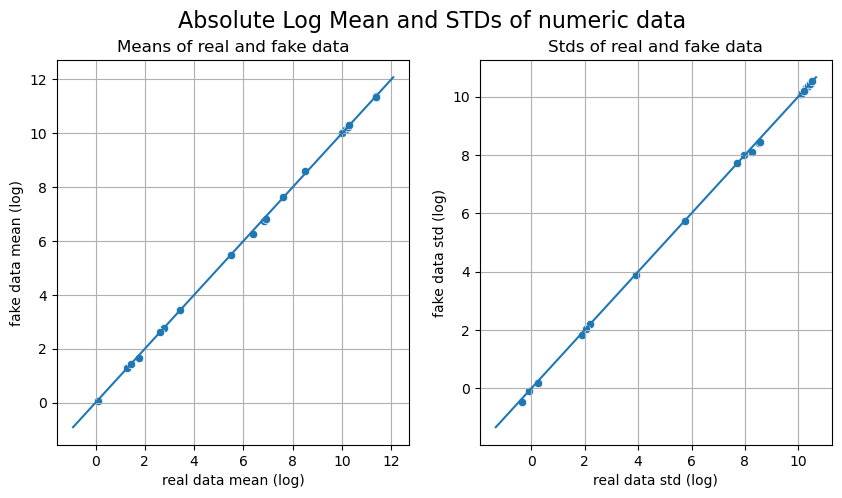

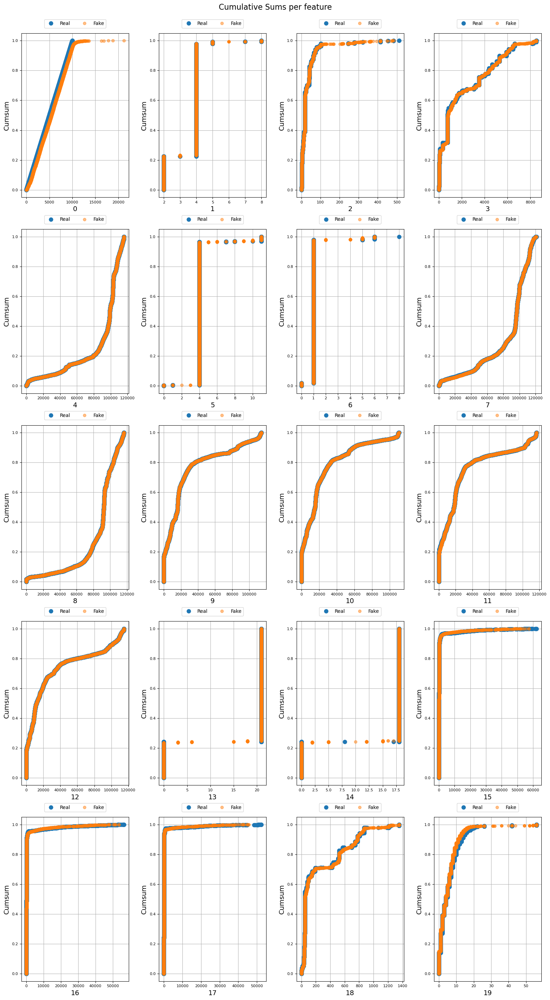

C:\Users\knowl\anaconda3\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  plot_df = pd.DataFrame({col: self.real[col].append(self.fake[col]), 'kind': ['real'] * self.n_samples + ['fake'] * self.n_samples})
C:\Users\knowl\anaconda3\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  plot_df = pd.DataFrame({col: self.real[col].append(self.fake[col]), 'kind': ['real'] * self.n_samples + ['fake'] * self.n_samples})
C:\Users\knowl\anaconda3\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  plot_df = pd.DataFrame({col: self.real[col].append(self.fake[col]), 'kind': ['r

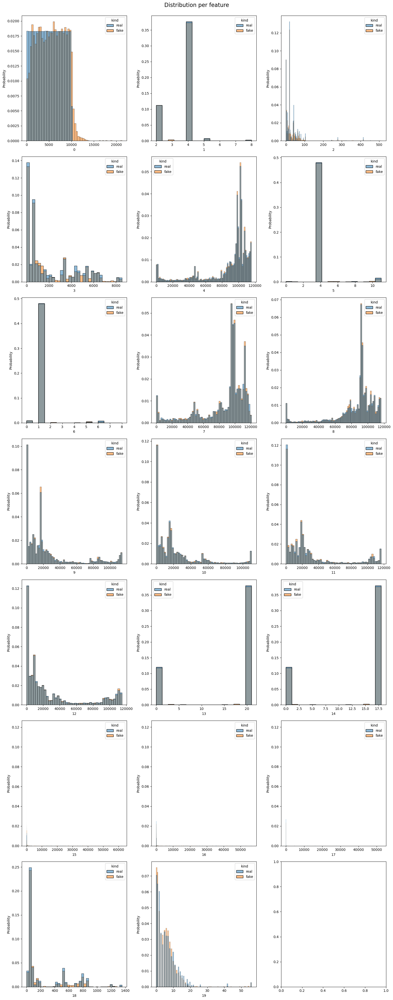

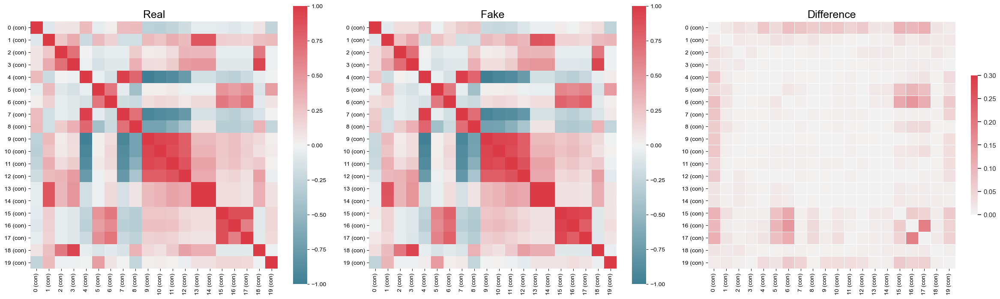

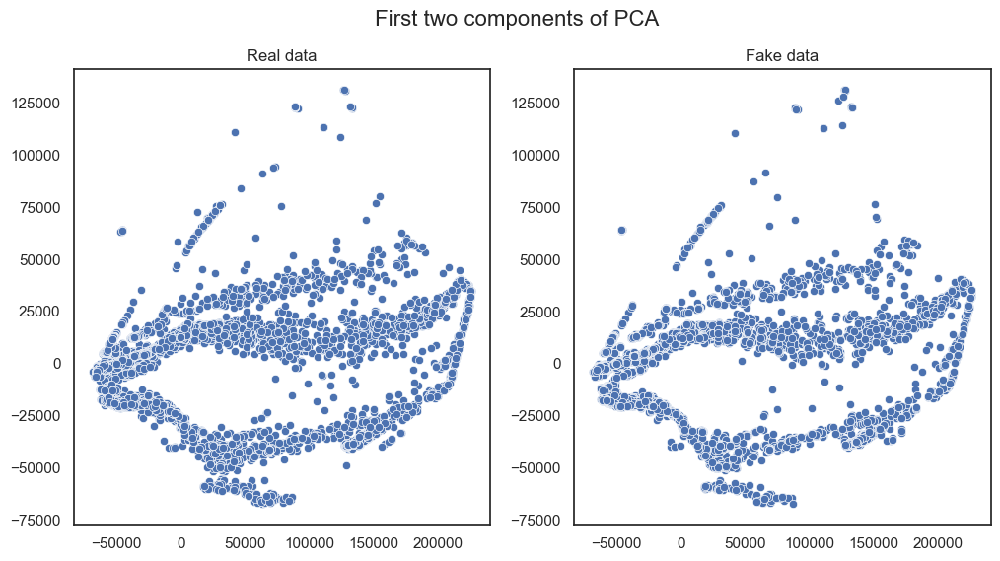

In [204]:
from table_evaluator import load_data, TableEvaluator
cols=['0','1','2','3','4','5','6']
print(abc.shape, xyz.shape)
abc.columns = abc.columns.astype(str)
xyz.columns = xyz.columns.astype(str)
table_evaluator =  TableEvaluator(abc, xyz)

table_evaluator.visual_evaluation()

In [369]:
dataF=pd.read_csv('ProposedUpsamplingData.csv')

In [376]:
dataF=dataF.drop('Unnamed: 0',axis=1)

In [218]:
target1=dataF['target']
feature1=dataF.drop('target',axis=1)

In [219]:
X_train, X_test, y_train, y_test = train_test_split(feature1, target1, test_size=0.15, random_state=1, stratify=target1, shuffle=True)
    

In [220]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
a =  RandomForestClassifier(n_estimators=300, random_state=2,max_depth=100) 
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))
a=accuracy_score(y_test,pred)
print(a)

0.9906937003510068
              precision    recall  f1-score   support

     Anomaly       0.99      0.99      0.99     21652
      Normal       0.99      0.99      0.99     21652

    accuracy                           0.99     43304
   macro avg       0.99      0.99      0.99     43304
weighted avg       0.99      0.99      0.99     43304

[[21471   181]
 [  222 21430]]
0.9906937003510068


In [221]:
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
print("ADA")
xgb = AdaBoostClassifier(n_estimators=300, random_state=5,learning_rate=0.8)
xgb_pred = xgb.fit(X_train, y_train).predict(X_test)  
print(classification_report(y_test,xgb_pred))
print(confusion_matrix(y_test,xgb_pred))

ADA
              precision    recall  f1-score   support

     Anomaly       0.96      0.98      0.97     21652
      Normal       0.98      0.96      0.97     21652

    accuracy                           0.97     43304
   macro avg       0.97      0.97      0.97     43304
weighted avg       0.97      0.97      0.97     43304

[[21189   463]
 [  787 20865]]


In [222]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
b = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=100)
b_pred = b.fit(X_train, y_train).predict(X_test)
print(classification_report(y_test,b_pred))
print(confusion_matrix(y_test,b_pred))

ETC
              precision    recall  f1-score   support

     Anomaly       0.99      0.99      0.99     21652
      Normal       0.99      0.99      0.99     21652

    accuracy                           0.99     43304
   macro avg       0.99      0.99      0.99     43304
weighted avg       0.99      0.99      0.99     43304

[[21445   207]
 [  280 21372]]


In [223]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
# 2. instantiate a logistic regression model
logreg = LogisticRegression(random_state=1000, solver='liblinear',multi_class='ovr',C=3.0)
# 3. train the model using X_train_dtm
x=logreg.fit(X_train, y_train)
# 4. make class predictions for X_test_dtm
y_pred_class = logreg.predict(X_test)
print(classification_report(y_test,y_pred_class))
print(confusion_matrix(y_test,y_pred_class))


              precision    recall  f1-score   support

     Anomaly       0.85      0.89      0.87     21652
      Normal       0.89      0.85      0.87     21652

    accuracy                           0.87     43304
   macro avg       0.87      0.87      0.87     43304
weighted avg       0.87      0.87      0.87     43304

[[19346  2306]
 [ 3310 18342]]


In [379]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
a =  RandomForestClassifier(n_estimators=300, random_state=2,max_depth=100) 
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))
a=accuracy_score(y_test,pred)
print(a)

0.994573249584334
              precision    recall  f1-score   support

     Anomaly       1.00      0.99      0.99     21652
      Normal       0.99      1.00      0.99     21652

    accuracy                           0.99     43304
   macro avg       0.99      0.99      0.99     43304
weighted avg       0.99      0.99      0.99     43304

[[21455   197]
 [   38 21614]]
0.994573249584334


In [380]:
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
print("ADA")
xgb = AdaBoostClassifier(n_estimators=300, random_state=5,learning_rate=0.8)
xgb_pred = xgb.fit(X_train, y_train).predict(X_test)  
print(classification_report(y_test,xgb_pred))
print(confusion_matrix(y_test,xgb_pred))

ADA
              precision    recall  f1-score   support

     Anomaly       0.96      0.98      0.97     21652
      Normal       0.98      0.96      0.97     21652

    accuracy                           0.97     43304
   macro avg       0.97      0.97      0.97     43304
weighted avg       0.97      0.97      0.97     43304

[[21134   518]
 [  893 20759]]


In [381]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
b = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=100)
b_pred = b.fit(X_train, y_train).predict(X_test)
print(classification_report(y_test,b_pred))
print(confusion_matrix(y_test,b_pred))

ETC
              precision    recall  f1-score   support

     Anomaly       1.00      0.99      0.99     21652
      Normal       0.99      1.00      0.99     21652

    accuracy                           0.99     43304
   macro avg       0.99      0.99      0.99     43304
weighted avg       0.99      0.99      0.99     43304

[[21485   167]
 [   93 21559]]


In [382]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
# 2. instantiate a logistic regression model
logreg = LogisticRegression(random_state=1000, solver='liblinear',multi_class='ovr',C=3.0)
# 3. train the model using X_train_dtm
x=logreg.fit(X_train, y_train)
# 4. make class predictions for X_test_dtm
y_pred_class = logreg.predict(X_test)
print(classification_report(y_test,y_pred_class))
print(confusion_matrix(y_test,y_pred_class))


              precision    recall  f1-score   support

     Anomaly       0.85      0.89      0.87     21652
      Normal       0.89      0.85      0.86     21652

    accuracy                           0.87     43304
   macro avg       0.87      0.87      0.87     43304
weighted avg       0.87      0.87      0.87     43304

[[19275  2377]
 [ 3351 18301]]


# SMOTE

In [40]:
from imblearn.over_sampling import SMOTE
sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(feature, target)

In [41]:
X_train, X_test, y_train, y_test = train_test_split(X_res, y_res, test_size=0.15, random_state=1, stratify=y_res, shuffle=True)


In [140]:

from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
a =  RandomForestClassifier(n_estimators=300, random_state=2,max_depth=100) 
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))
a=accuracy_score(y_test,pred)
print(a)

0.9903934971365231
              precision    recall  f1-score   support

     Anomaly       0.99      0.99      0.99     21652
      Normal       0.99      0.99      0.99     21652

    accuracy                           0.99     43304
   macro avg       0.99      0.99      0.99     43304
weighted avg       0.99      0.99      0.99     43304

[[21435   217]
 [  199 21453]]
0.9903934971365231


In [141]:
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
print("ADA")
xgb = AdaBoostClassifier(n_estimators=300, random_state=5,learning_rate=0.8)
xgb_pred = xgb.fit(X_train, y_train).predict(X_test)  
print(classification_report(y_test,xgb_pred))
print(confusion_matrix(y_test,xgb_pred))

ADA
              precision    recall  f1-score   support

     Anomaly       0.96      0.98      0.97     21652
      Normal       0.98      0.96      0.97     21652

    accuracy                           0.97     43304
   macro avg       0.97      0.97      0.97     43304
weighted avg       0.97      0.97      0.97     43304

[[21148   504]
 [  946 20706]]


In [395]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
b = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=100)
b_pred = b.fit(X_train, y_train).predict(X_test)
print(classification_report(y_test,b_pred))
print(confusion_matrix(y_test,b_pred))

ETC
              precision    recall  f1-score   support

     Anomaly       0.99      0.99      0.99     21652
      Normal       0.99      0.99      0.99     21652

    accuracy                           0.99     43304
   macro avg       0.99      0.99      0.99     43304
weighted avg       0.99      0.99      0.99     43304

[[21424   228]
 [  261 21391]]


In [42]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
# 2. instantiate a logistic regression model
logreg = LogisticRegression(random_state=1000, solver='liblinear',multi_class='ovr',C=3.0)
# 3. train the model using X_train_dtm
x=logreg.fit(X_train, y_train)
# 4. make class predictions for X_test_dtm
y_pred_class = logreg.predict(X_test)
print(classification_report(y_test,y_pred_class))
print(confusion_matrix(y_test,y_pred_class))


              precision    recall  f1-score   support

     Anomaly       0.85      0.89      0.87     21652
      Normal       0.88      0.84      0.86     21652

    accuracy                           0.87     43304
   macro avg       0.87      0.87      0.87     43304
weighted avg       0.87      0.87      0.87     43304

[[19250  2402]
 [ 3396 18256]]


# Adasyn

In [239]:
from imblearn.over_sampling import ADASYN
ada = ADASYN()
X_resA, y_resY = ada.fit_resample(X_resA, y_resY)

ValueError: No samples will be generated with the provided ratio settings.

In [240]:
X_train, X_test, y_train, y_test = train_test_split(X_resA, y_resY, test_size=0.15, random_state=1, stratify=y_resY, shuffle=True)


In [241]:

from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
a =  RandomForestClassifier(n_estimators=300, random_state=2,max_depth=100) 
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))
a=accuracy_score(y_test,pred)
print(a)

0.9887120651369357
              precision    recall  f1-score   support

     Anomaly       1.00      0.98      0.99     21652
      Normal       0.98      1.00      0.99     21580

    accuracy                           0.99     43232
   macro avg       0.99      0.99      0.99     43232
weighted avg       0.99      0.99      0.99     43232

[[21223   429]
 [   59 21521]]
0.9887120651369357


In [242]:
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
print("ADA")
xgb = AdaBoostClassifier(n_estimators=300, random_state=5,learning_rate=0.8)
xgb_pred = xgb.fit(X_train, y_train).predict(X_test)  
print(classification_report(y_test,xgb_pred))
print(confusion_matrix(y_test,xgb_pred))

ADA
              precision    recall  f1-score   support

     Anomaly       0.94      0.93      0.94     21652
      Normal       0.93      0.94      0.94     21580

    accuracy                           0.94     43232
   macro avg       0.94      0.94      0.94     43232
weighted avg       0.94      0.94      0.94     43232

[[20198  1454]
 [ 1205 20375]]


In [243]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
b = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=100)
b_pred = b.fit(X_train, y_train).predict(X_test)
print(classification_report(y_test,b_pred))
print(confusion_matrix(y_test,b_pred))

ETC
              precision    recall  f1-score   support

     Anomaly       1.00      0.98      0.99     21652
      Normal       0.98      1.00      0.99     21580

    accuracy                           0.99     43232
   macro avg       0.99      0.99      0.99     43232
weighted avg       0.99      0.99      0.99     43232

[[21148   504]
 [   44 21536]]


In [244]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
# 2. instantiate a logistic regression model
logreg = LogisticRegression(random_state=1000, solver='liblinear',multi_class='ovr',C=3.0)
# 3. train the model using X_train_dtm
x=logreg.fit(X_train, y_train)
# 4. make class predictions for X_test_dtm
y_pred_class = logreg.predict(X_test)
print(classification_report(y_test,y_pred_class))
print(confusion_matrix(y_test,y_pred_class))


              precision    recall  f1-score   support

     Anomaly       0.82      0.80      0.81     21652
      Normal       0.81      0.83      0.82     21580

    accuracy                           0.81     43232
   macro avg       0.81      0.81      0.81     43232
weighted avg       0.81      0.81      0.81     43232

[[17403  4249]
 [ 3761 17819]]


In [153]:

from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
a =  RandomForestClassifier(n_estimators=300, random_state=2,max_depth=100) 
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))
a=accuracy_score(y_test,pred)
print(a)

0.988783573961206
              precision    recall  f1-score   support

     Anomaly       1.00      0.98      0.99     21652
      Normal       0.98      1.00      0.99     21499

    accuracy                           0.99     43151
   macro avg       0.99      0.99      0.99     43151
weighted avg       0.99      0.99      0.99     43151

[[21228   424]
 [   60 21439]]
0.988783573961206


In [154]:
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
print("ADA")
xgb = AdaBoostClassifier(n_estimators=300, random_state=5,learning_rate=0.8)
xgb_pred = xgb.fit(X_train, y_train).predict(X_test)  
print(classification_report(y_test,xgb_pred))
print(confusion_matrix(y_test,xgb_pred))

ADA
              precision    recall  f1-score   support

     Anomaly       0.94      0.93      0.94     21652
      Normal       0.93      0.94      0.94     21499

    accuracy                           0.94     43151
   macro avg       0.94      0.94      0.94     43151
weighted avg       0.94      0.94      0.94     43151

[[20213  1439]
 [ 1206 20293]]


In [45]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
b = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=100)
b_pred = b.fit(X_train, y_train).predict(X_test)
print(classification_report(y_test,b_pred))
print(confusion_matrix(y_test,b_pred))

ETC
              precision    recall  f1-score   support

     Anomaly       1.00      0.98      0.99     21652
      Normal       0.98      1.00      0.99     21499

    accuracy                           0.99     43151
   macro avg       0.99      0.99      0.99     43151
weighted avg       0.99      0.99      0.99     43151

[[21137   515]
 [   45 21454]]


In [46]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
# 2. instantiate a logistic regression model
logreg = LogisticRegression(random_state=1000, solver='liblinear',multi_class='ovr',C=3.0)
# 3. train the model using X_train_dtm
x=logreg.fit(X_train, y_train)
# 4. make class predictions for X_test_dtm
y_pred_class = logreg.predict(X_test)
print(classification_report(y_test,y_pred_class))
print(confusion_matrix(y_test,y_pred_class))


              precision    recall  f1-score   support

     Anomaly       0.80      0.80      0.80     21652
      Normal       0.80      0.80      0.80     21499

    accuracy                           0.80     43151
   macro avg       0.80      0.80      0.80     43151
weighted avg       0.80      0.80      0.80     43151

[[17275  4377]
 [ 4198 17301]]


In [165]:
Data25=newfeatures[:220864]
dataNCTGAN=Data25.loc[Data25['target'] == "Normal"]
print(len(dataNCTGAN))
dataACTGAN=Data25.loc[Data25['target'] == "Anomaly"]
print(len(dataACTGAN))

76520
144344


In [168]:
dataNCTGAN.columns = dataNCTGAN.columns.astype(str)
dataACTGAN.columns = dataACTGAN.columns.astype(str)

In [176]:
dat=dataNCTGAN[:3000]
from sdv.tabular import CTGAN
model = CTGAN(epochs=500,verbose=True)
model.fit(dat)


Epoch 1, Loss G: -0.0856,Loss D: -0.2146
Epoch 2, Loss G: -0.3569,Loss D: -0.6864
Epoch 3, Loss G: -0.8051,Loss D: -0.9335
Epoch 4, Loss G: -1.5010,Loss D: -0.6214
Epoch 5, Loss G: -1.6226,Loss D: -0.4121
Epoch 6, Loss G: -1.8189,Loss D: -0.0313
Epoch 7, Loss G: -1.6617,Loss D:  0.0536
Epoch 8, Loss G: -1.2984,Loss D:  0.0801
Epoch 9, Loss G: -1.0225,Loss D: -0.1340
Epoch 10, Loss G: -0.7601,Loss D: -0.0057
Epoch 11, Loss G: -1.0395,Loss D:  0.2882
Epoch 12, Loss G: -1.1592,Loss D:  0.2903
Epoch 13, Loss G: -1.2304,Loss D:  0.0875
Epoch 14, Loss G: -1.2967,Loss D:  0.2291
Epoch 15, Loss G: -1.3906,Loss D:  0.0477
Epoch 16, Loss G: -1.8080,Loss D:  0.1446
Epoch 17, Loss G: -1.8205,Loss D:  0.0537
Epoch 18, Loss G: -1.7418,Loss D: -0.0369
Epoch 19, Loss G: -1.9473,Loss D:  0.2132
Epoch 20, Loss G: -1.9385,Loss D:  0.1320
Epoch 21, Loss G: -1.7779,Loss D:  0.2129
Epoch 22, Loss G: -1.2793,Loss D: -0.1662
Epoch 23, Loss G: -1.2907,Loss D: -0.1057
Epoch 24, Loss G: -1.5470,Loss D:  0.1733
E

Epoch 195, Loss G: -0.8727,Loss D: -0.3355
Epoch 196, Loss G: -1.0650,Loss D:  0.0181
Epoch 197, Loss G: -0.7321,Loss D: -0.0322
Epoch 198, Loss G: -0.6019,Loss D: -0.2573
Epoch 199, Loss G: -0.2101,Loss D: -0.4339
Epoch 200, Loss G: -0.4506,Loss D: -0.5585
Epoch 201, Loss G: -0.2932,Loss D: -0.3020
Epoch 202, Loss G: -0.2106,Loss D: -0.2951
Epoch 203, Loss G: -0.3302,Loss D: -0.4296
Epoch 204, Loss G: -0.3225,Loss D: -0.6082
Epoch 205, Loss G: -0.9302,Loss D: -0.3233
Epoch 206, Loss G: -0.7026,Loss D: -0.4872
Epoch 207, Loss G: -0.4300,Loss D: -0.6132
Epoch 208, Loss G: -0.4087,Loss D: -0.3743
Epoch 209, Loss G: -0.3522,Loss D: -0.6948
Epoch 210, Loss G: -0.7380,Loss D: -0.4504
Epoch 211, Loss G: -0.8847,Loss D: -0.4641
Epoch 212, Loss G: -0.8074,Loss D: -0.2193
Epoch 213, Loss G: -0.6837,Loss D: -0.5948
Epoch 214, Loss G: -0.7047,Loss D: -0.5885
Epoch 215, Loss G: -0.9563,Loss D: -0.6982
Epoch 216, Loss G: -0.7331,Loss D: -0.4906
Epoch 217, Loss G: -0.4099,Loss D: -0.2774
Epoch 218, 

Epoch 386, Loss G: -0.5877,Loss D: -0.4641
Epoch 387, Loss G: -0.2769,Loss D: -0.2339
Epoch 388, Loss G: -0.4815,Loss D:  0.1067
Epoch 389, Loss G: -0.1322,Loss D:  0.0557
Epoch 390, Loss G: -0.1396,Loss D:  0.0188
Epoch 391, Loss G: -0.0574,Loss D: -0.1193
Epoch 392, Loss G: -0.1553,Loss D:  0.1236
Epoch 393, Loss G: -0.1288,Loss D: -0.5445
Epoch 394, Loss G: -0.2157,Loss D: -0.5710
Epoch 395, Loss G: -0.4512,Loss D: -0.2049
Epoch 396, Loss G: -0.1756,Loss D: -0.5068
Epoch 397, Loss G: -0.5471,Loss D:  0.0178
Epoch 398, Loss G: -0.2396,Loss D: -0.4722
Epoch 399, Loss G: -0.0186,Loss D: -0.6477
Epoch 400, Loss G:  0.0569,Loss D: -0.9572
Epoch 401, Loss G:  0.2788,Loss D: -0.7762
Epoch 402, Loss G: -0.1745,Loss D: -0.3448
Epoch 403, Loss G: -0.1367,Loss D: -0.4742
Epoch 404, Loss G: -0.1514,Loss D: -0.6719
Epoch 405, Loss G: -0.2456,Loss D: -0.0153
Epoch 406, Loss G: -0.1250,Loss D: -0.4496
Epoch 407, Loss G: -0.4341,Loss D: -0.4799
Epoch 408, Loss G: -0.4333,Loss D: -0.1974
Epoch 409, 

In [177]:
new_data_pii = model.sample(67824)

In [179]:
NewCTGANDATA=new_data_pii.append(dataNCTGAN,ignore_index = True)
CTGANDATA=NewCTGANDATA.append(dataACTGAN,ignore_index = True)

C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\2953160227.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  NewCTGANDATA=new_data_pii.append(dataNCTGAN,ignore_index = True)
C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\2953160227.py:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  CTGANDATA=NewCTGANDATA.append(dataACTGAN,ignore_index = True)


In [181]:
ctgantarget=CTGANDATA['target']
ctganFeature=CTGANDATA.drop('target',axis=1)
X_train, X_test, y_train, y_test = train_test_split(ctganFeature, ctgantarget, test_size=0.15, random_state=1, stratify=ctgantarget, shuffle=True)


In [182]:

from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
a =  RandomForestClassifier(n_estimators=300, random_state=2,max_depth=100) 
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))
a=accuracy_score(y_test,pred)
print(a)

0.9902318492518012
              precision    recall  f1-score   support

     Anomaly       0.99      0.99      0.99     21652
      Normal       0.99      0.99      0.99     21652

    accuracy                           0.99     43304
   macro avg       0.99      0.99      0.99     43304
weighted avg       0.99      0.99      0.99     43304

[[21519   133]
 [  290 21362]]
0.9902318492518012


In [183]:
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
print("ADA")
xgb = AdaBoostClassifier(n_estimators=300, random_state=5,learning_rate=0.8)
xgb_pred = xgb.fit(X_train, y_train).predict(X_test)  
print(classification_report(y_test,xgb_pred))
print(confusion_matrix(y_test,xgb_pred))

ADA
              precision    recall  f1-score   support

     Anomaly       0.97      0.99      0.98     21652
      Normal       0.99      0.97      0.98     21652

    accuracy                           0.98     43304
   macro avg       0.98      0.98      0.98     43304
weighted avg       0.98      0.98      0.98     43304

[[21391   261]
 [  694 20958]]


In [184]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
b = ExtraTreesClassifier(n_estimators=200, random_state=5, max_depth=20)
b_pred = b.fit(X_train, y_train).predict(X_test)
print(classification_report(y_test,b_pred))
print(confusion_matrix(y_test,b_pred))

ETC
              precision    recall  f1-score   support

     Anomaly       0.96      1.00      0.98     21652
      Normal       1.00      0.96      0.98     21652

    accuracy                           0.98     43304
   macro avg       0.98      0.98      0.98     43304
weighted avg       0.98      0.98      0.98     43304

[[21566    86]
 [  969 20683]]


In [185]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
# 2. instantiate a logistic regression model
logreg = LogisticRegression(random_state=1000, solver='liblinear',multi_class='ovr',C=3.0)
# 3. train the model using X_train_dtm
x=logreg.fit(X_train, y_train)
# 4. make class predictions for X_test_dtm
y_pred_class = logreg.predict(X_test)
print(classification_report(y_test,y_pred_class))
print(confusion_matrix(y_test,y_pred_class))


C:\Users\knowl\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


              precision    recall  f1-score   support

     Anomaly       0.89      0.92      0.90     21652
      Normal       0.91      0.88      0.90     21652

    accuracy                           0.90     43304
   macro avg       0.90      0.90      0.90     43304
weighted avg       0.90      0.90      0.90     43304

[[19869  1783]
 [ 2529 19123]]


C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 288688 samples in 0.009s...
[t-SNE] Computed neighbors for 288688 samples in 3861.473s...
[t-SNE] Computed conditional probabilities for sample 1000 / 288688
[t-SNE] Computed conditional probabilities for sample 2000 / 288688
[t-SNE] Computed conditional probabilities for sample 3000 / 288688
[t-SNE] Computed conditional probabilities for sample 4000 / 288688
[t-SNE] Computed conditional probabilities for sample 5000 / 288688
[t-SNE] Computed conditional probabilities for sample 6000 / 288688
[t-SNE] Computed conditional probabilities for sample 7000 / 288688
[t-SNE] Computed conditional probabilities for sample 8000 / 288688
[t-SNE] Computed conditional probabilities for sample 9000 / 288688
[t-SNE] Computed conditional probabilities for sample 10000 / 288688
[t-SNE] Computed conditional probabilities for sample 11000 / 288688
[t-SNE] Computed conditional probabilities for sample 12000 / 288688
[t-SNE] Computed conditional pro

[t-SNE] Computed conditional probabilities for sample 126000 / 288688
[t-SNE] Computed conditional probabilities for sample 127000 / 288688
[t-SNE] Computed conditional probabilities for sample 128000 / 288688
[t-SNE] Computed conditional probabilities for sample 129000 / 288688
[t-SNE] Computed conditional probabilities for sample 130000 / 288688
[t-SNE] Computed conditional probabilities for sample 131000 / 288688
[t-SNE] Computed conditional probabilities for sample 132000 / 288688
[t-SNE] Computed conditional probabilities for sample 133000 / 288688
[t-SNE] Computed conditional probabilities for sample 134000 / 288688
[t-SNE] Computed conditional probabilities for sample 135000 / 288688
[t-SNE] Computed conditional probabilities for sample 136000 / 288688
[t-SNE] Computed conditional probabilities for sample 137000 / 288688
[t-SNE] Computed conditional probabilities for sample 138000 / 288688
[t-SNE] Computed conditional probabilities for sample 139000 / 288688
[t-SNE] Computed con

[t-SNE] Computed conditional probabilities for sample 248000 / 288688
[t-SNE] Computed conditional probabilities for sample 249000 / 288688
[t-SNE] Computed conditional probabilities for sample 250000 / 288688
[t-SNE] Computed conditional probabilities for sample 251000 / 288688
[t-SNE] Computed conditional probabilities for sample 252000 / 288688
[t-SNE] Computed conditional probabilities for sample 253000 / 288688
[t-SNE] Computed conditional probabilities for sample 254000 / 288688
[t-SNE] Computed conditional probabilities for sample 255000 / 288688
[t-SNE] Computed conditional probabilities for sample 256000 / 288688
[t-SNE] Computed conditional probabilities for sample 257000 / 288688
[t-SNE] Computed conditional probabilities for sample 258000 / 288688
[t-SNE] Computed conditional probabilities for sample 259000 / 288688
[t-SNE] Computed conditional probabilities for sample 260000 / 288688
[t-SNE] Computed conditional probabilities for sample 261000 / 288688
[t-SNE] Computed con

<AxesSubplot:xlabel='tsne-2d-one', ylabel='tsne-2d-two'>

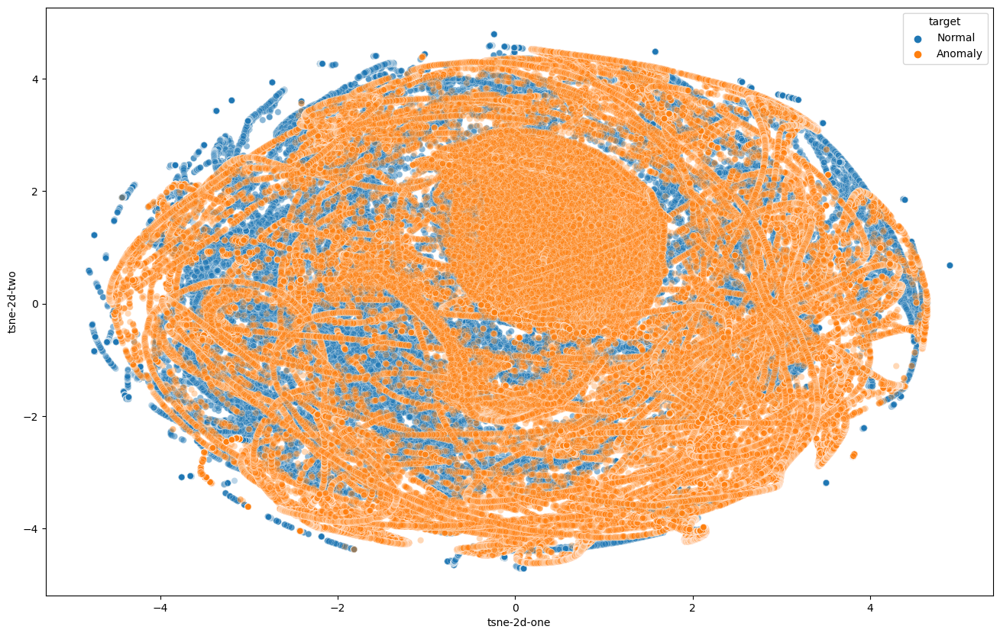

In [144]:
dataF=pd.read_csv('ProposedUpsamplingData.csv')
target1=dataF['target']
feature1=dataF.drop('target',axis=1)
import numpy as np
import pandas as pd

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(feature1)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))

feature1['tsne-2d-one'] = tsne_results[:,0]
feature1['tsne-2d-two'] = tsne_results[:,1]

plt.figure(figsize=(16,10))
sns.scatterplot(
    x="tsne-2d-one", y="tsne-2d-two",
    hue=target1,
    data=feature1,
    legend="full",
    alpha=0.3
)

C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 288688 samples in 0.016s...
[t-SNE] Computed neighbors for 288688 samples in 4926.245s...
[t-SNE] Computed conditional probabilities for sample 1000 / 288688
[t-SNE] Computed conditional probabilities for sample 2000 / 288688
[t-SNE] Computed conditional probabilities for sample 3000 / 288688
[t-SNE] Computed conditional probabilities for sample 4000 / 288688
[t-SNE] Computed conditional probabilities for sample 5000 / 288688
[t-SNE] Computed conditional probabilities for sample 6000 / 288688
[t-SNE] Computed conditional probabilities for sample 7000 / 288688
[t-SNE] Computed conditional probabilities for sample 8000 / 288688
[t-SNE] Computed conditional probabilities for sample 9000 / 288688
[t-SNE] Computed conditional probabilities for sample 10000 / 288688
[t-SNE] Computed conditional probabilities for sample 11000 / 288688
[t-SNE] Computed conditional probabilities for sample 12000 / 288688
[t-SNE] Computed conditional pro

[t-SNE] Computed conditional probabilities for sample 122000 / 288688
[t-SNE] Computed conditional probabilities for sample 123000 / 288688
[t-SNE] Computed conditional probabilities for sample 124000 / 288688
[t-SNE] Computed conditional probabilities for sample 125000 / 288688
[t-SNE] Computed conditional probabilities for sample 126000 / 288688
[t-SNE] Computed conditional probabilities for sample 127000 / 288688
[t-SNE] Computed conditional probabilities for sample 128000 / 288688
[t-SNE] Computed conditional probabilities for sample 129000 / 288688
[t-SNE] Computed conditional probabilities for sample 130000 / 288688
[t-SNE] Computed conditional probabilities for sample 131000 / 288688
[t-SNE] Computed conditional probabilities for sample 132000 / 288688
[t-SNE] Computed conditional probabilities for sample 133000 / 288688
[t-SNE] Computed conditional probabilities for sample 134000 / 288688
[t-SNE] Computed conditional probabilities for sample 135000 / 288688
[t-SNE] Computed con

[t-SNE] Computed conditional probabilities for sample 249000 / 288688
[t-SNE] Computed conditional probabilities for sample 250000 / 288688
[t-SNE] Computed conditional probabilities for sample 251000 / 288688
[t-SNE] Computed conditional probabilities for sample 252000 / 288688
[t-SNE] Computed conditional probabilities for sample 253000 / 288688
[t-SNE] Computed conditional probabilities for sample 254000 / 288688
[t-SNE] Computed conditional probabilities for sample 255000 / 288688
[t-SNE] Computed conditional probabilities for sample 256000 / 288688
[t-SNE] Computed conditional probabilities for sample 257000 / 288688
[t-SNE] Computed conditional probabilities for sample 258000 / 288688
[t-SNE] Computed conditional probabilities for sample 259000 / 288688
[t-SNE] Computed conditional probabilities for sample 260000 / 288688
[t-SNE] Computed conditional probabilities for sample 261000 / 288688
[t-SNE] Computed conditional probabilities for sample 262000 / 288688
[t-SNE] Computed con

C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\3445083758.py:38: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig('ProposedScatter.pdf')
C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\3445083758.py:38: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig('ProposedScatter.pdf')
C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\3445083758.py:39: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig('ProposedScatter.png')
C:\Users\knowl\anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


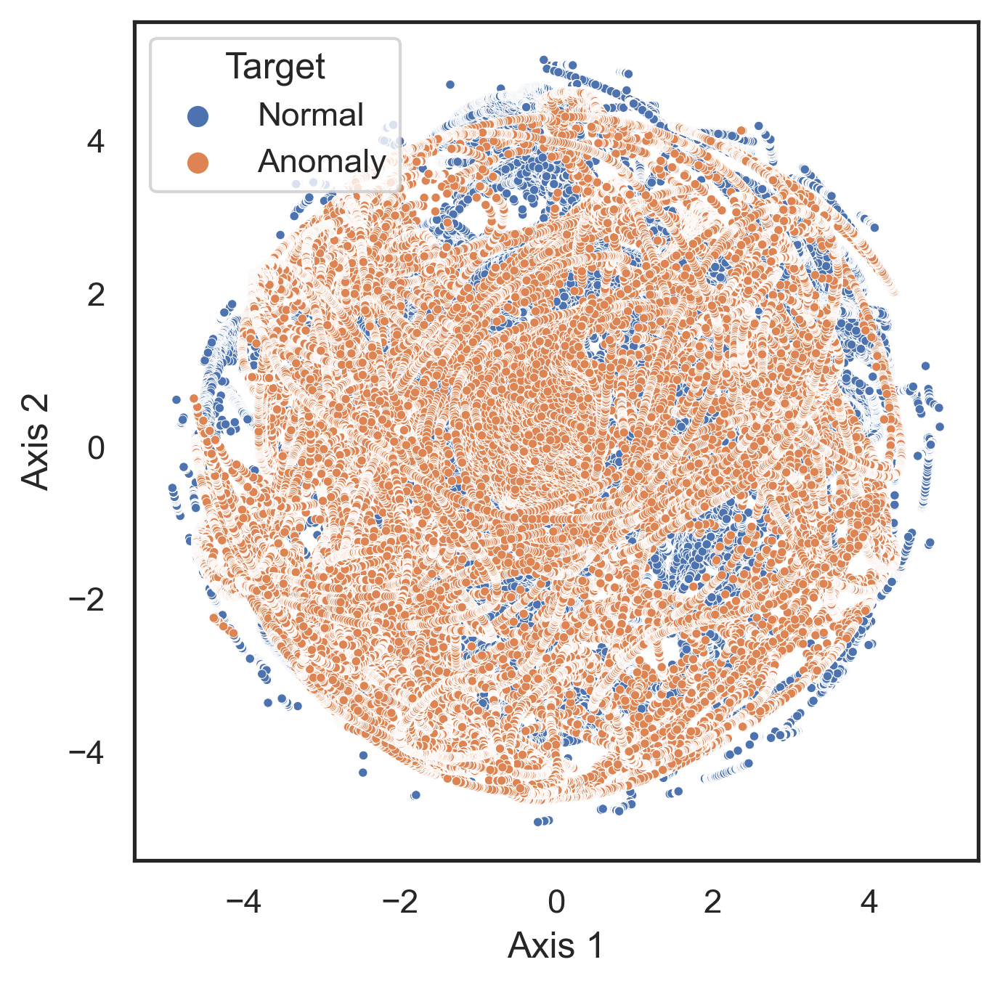

In [358]:
import numpy as np
import pandas as pd

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

dataF=pd.read_csv('ProposedUpsamplingData.csv')

target1=dataF['target']
feature1=dataF.drop('target',axis=1)

%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(feature1)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))



feature1['Axis 1'] = tsne_results[:,0]
feature1['Axis 2'] = tsne_results[:,1]
target1.rename('Target', inplace = True)
plt.figure(figsize=(5,5),dpi=300)
sns.scatterplot(
    x="Axis 1", y="Axis 2",
    hue=target1,
    data=feature1,
    legend="full",
    alpha=1.0,
    linewidths=1.0,
    marker='o',
    s=9
)
plt.savefig('ProposedScatter.pdf')
plt.savefig('ProposedScatter.png')

C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 288688 samples in 0.054s...
[t-SNE] Computed neighbors for 288688 samples in 5681.261s...
[t-SNE] Computed conditional probabilities for sample 1000 / 288688
[t-SNE] Computed conditional probabilities for sample 2000 / 288688
[t-SNE] Computed conditional probabilities for sample 3000 / 288688
[t-SNE] Computed conditional probabilities for sample 4000 / 288688
[t-SNE] Computed conditional probabilities for sample 5000 / 288688
[t-SNE] Computed conditional probabilities for sample 6000 / 288688
[t-SNE] Computed conditional probabilities for sample 7000 / 288688
[t-SNE] Computed conditional probabilities for sample 8000 / 288688
[t-SNE] Computed conditional probabilities for sample 9000 / 288688
[t-SNE] Computed conditional probabilities for sample 10000 / 288688
[t-SNE] Computed conditional probabilities for sample 11000 / 288688
[t-SNE] Computed conditional probabilities for sample 12000 / 288688
[t-SNE] Computed conditional pro

[t-SNE] Computed conditional probabilities for sample 126000 / 288688
[t-SNE] Computed conditional probabilities for sample 127000 / 288688
[t-SNE] Computed conditional probabilities for sample 128000 / 288688
[t-SNE] Computed conditional probabilities for sample 129000 / 288688
[t-SNE] Computed conditional probabilities for sample 130000 / 288688
[t-SNE] Computed conditional probabilities for sample 131000 / 288688
[t-SNE] Computed conditional probabilities for sample 132000 / 288688
[t-SNE] Computed conditional probabilities for sample 133000 / 288688
[t-SNE] Computed conditional probabilities for sample 134000 / 288688
[t-SNE] Computed conditional probabilities for sample 135000 / 288688
[t-SNE] Computed conditional probabilities for sample 136000 / 288688
[t-SNE] Computed conditional probabilities for sample 137000 / 288688
[t-SNE] Computed conditional probabilities for sample 138000 / 288688
[t-SNE] Computed conditional probabilities for sample 139000 / 288688
[t-SNE] Computed con

[t-SNE] Computed conditional probabilities for sample 245000 / 288688
[t-SNE] Computed conditional probabilities for sample 246000 / 288688
[t-SNE] Computed conditional probabilities for sample 247000 / 288688
[t-SNE] Computed conditional probabilities for sample 248000 / 288688
[t-SNE] Computed conditional probabilities for sample 249000 / 288688
[t-SNE] Computed conditional probabilities for sample 250000 / 288688
[t-SNE] Computed conditional probabilities for sample 251000 / 288688
[t-SNE] Computed conditional probabilities for sample 252000 / 288688
[t-SNE] Computed conditional probabilities for sample 253000 / 288688
[t-SNE] Computed conditional probabilities for sample 254000 / 288688
[t-SNE] Computed conditional probabilities for sample 255000 / 288688
[t-SNE] Computed conditional probabilities for sample 256000 / 288688
[t-SNE] Computed conditional probabilities for sample 257000 / 288688
[t-SNE] Computed conditional probabilities for sample 258000 / 288688
[t-SNE] Computed con

C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\2493417384.py:32: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig('SMOTEScatter.pdf')
C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\2493417384.py:32: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig('SMOTEScatter.pdf')
C:\Users\knowl\anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


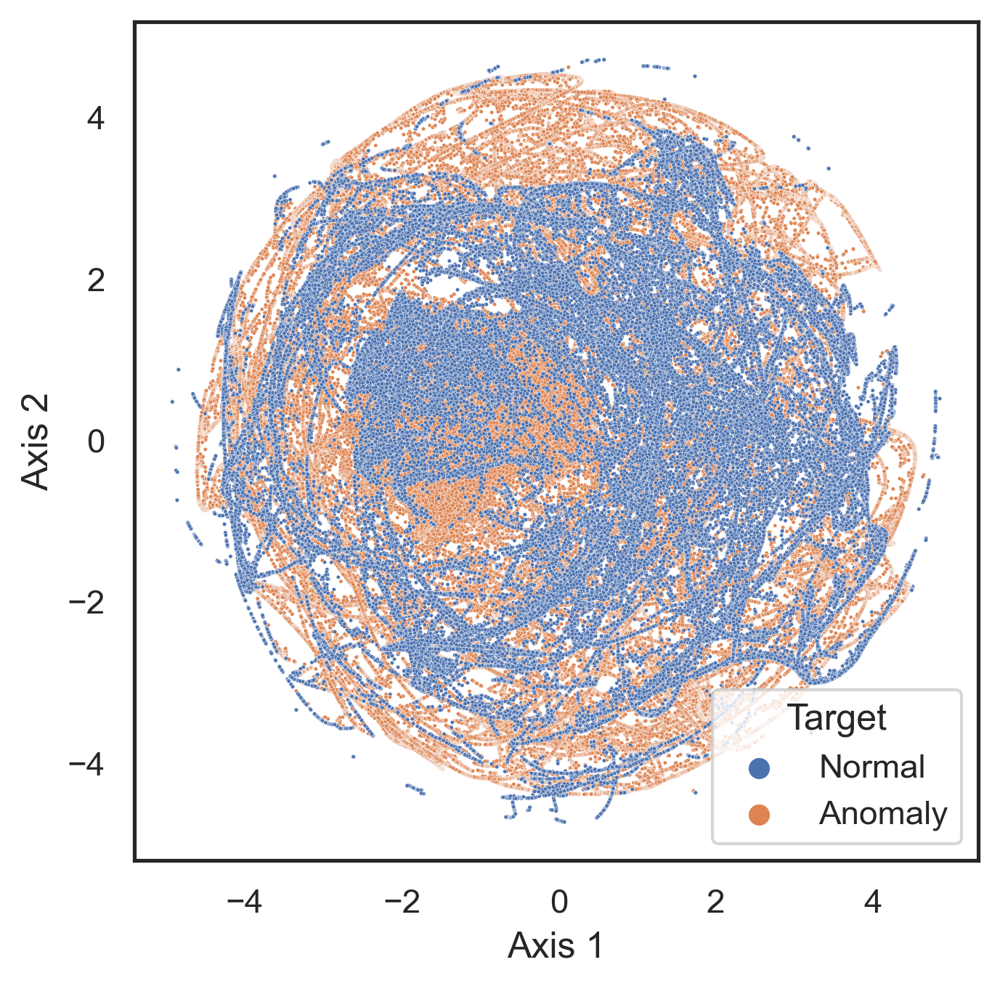

In [347]:
import numpy as np
import pandas as pd

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(X_res)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))


X_res['Axis 1'] = tsne_results[:,0]
X_res['Axis 2'] = tsne_results[:,1]
y_res.rename('Target', inplace = True)
plt.figure(figsize=(5,5),dpi=300)
sns.scatterplot(
    x="Axis 1", y="Axis 2",
    hue=y_res,
    data=X_res,
    legend="full",
    alpha=1.0,
    linewidths=1.0,
    marker='o',
    s=1.6
)
plt.savefig('SMOTEScatter.pdf')



C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 287667 samples in 0.021s...
[t-SNE] Computed neighbors for 287667 samples in 4369.082s...
[t-SNE] Computed conditional probabilities for sample 1000 / 287667
[t-SNE] Computed conditional probabilities for sample 2000 / 287667
[t-SNE] Computed conditional probabilities for sample 3000 / 287667
[t-SNE] Computed conditional probabilities for sample 4000 / 287667
[t-SNE] Computed conditional probabilities for sample 5000 / 287667
[t-SNE] Computed conditional probabilities for sample 6000 / 287667
[t-SNE] Computed conditional probabilities for sample 7000 / 287667
[t-SNE] Computed conditional probabilities for sample 8000 / 287667
[t-SNE] Computed conditional probabilities for sample 9000 / 287667
[t-SNE] Computed conditional probabilities for sample 10000 / 287667
[t-SNE] Computed conditional probabilities for sample 11000 / 287667
[t-SNE] Computed conditional probabilities for sample 12000 / 287667
[t-SNE] Computed conditional pro

[t-SNE] Computed conditional probabilities for sample 120000 / 287667
[t-SNE] Computed conditional probabilities for sample 121000 / 287667
[t-SNE] Computed conditional probabilities for sample 122000 / 287667
[t-SNE] Computed conditional probabilities for sample 123000 / 287667
[t-SNE] Computed conditional probabilities for sample 124000 / 287667
[t-SNE] Computed conditional probabilities for sample 125000 / 287667
[t-SNE] Computed conditional probabilities for sample 126000 / 287667
[t-SNE] Computed conditional probabilities for sample 127000 / 287667
[t-SNE] Computed conditional probabilities for sample 128000 / 287667
[t-SNE] Computed conditional probabilities for sample 129000 / 287667
[t-SNE] Computed conditional probabilities for sample 130000 / 287667
[t-SNE] Computed conditional probabilities for sample 131000 / 287667
[t-SNE] Computed conditional probabilities for sample 132000 / 287667
[t-SNE] Computed conditional probabilities for sample 133000 / 287667
[t-SNE] Computed con

[t-SNE] Computed conditional probabilities for sample 246000 / 287667
[t-SNE] Computed conditional probabilities for sample 247000 / 287667
[t-SNE] Computed conditional probabilities for sample 248000 / 287667
[t-SNE] Computed conditional probabilities for sample 249000 / 287667
[t-SNE] Computed conditional probabilities for sample 250000 / 287667
[t-SNE] Computed conditional probabilities for sample 251000 / 287667
[t-SNE] Computed conditional probabilities for sample 252000 / 287667
[t-SNE] Computed conditional probabilities for sample 253000 / 287667
[t-SNE] Computed conditional probabilities for sample 254000 / 287667
[t-SNE] Computed conditional probabilities for sample 255000 / 287667
[t-SNE] Computed conditional probabilities for sample 256000 / 287667
[t-SNE] Computed conditional probabilities for sample 257000 / 287667
[t-SNE] Computed conditional probabilities for sample 258000 / 287667
[t-SNE] Computed conditional probabilities for sample 259000 / 287667
[t-SNE] Computed con

C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\109965014.py:31: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig('ADASYNScatter.pdf')
C:\Users\knowl\AppData\Local\Temp\ipykernel_7676\109965014.py:31: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig('ADASYNScatter.pdf')
C:\Users\knowl\anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


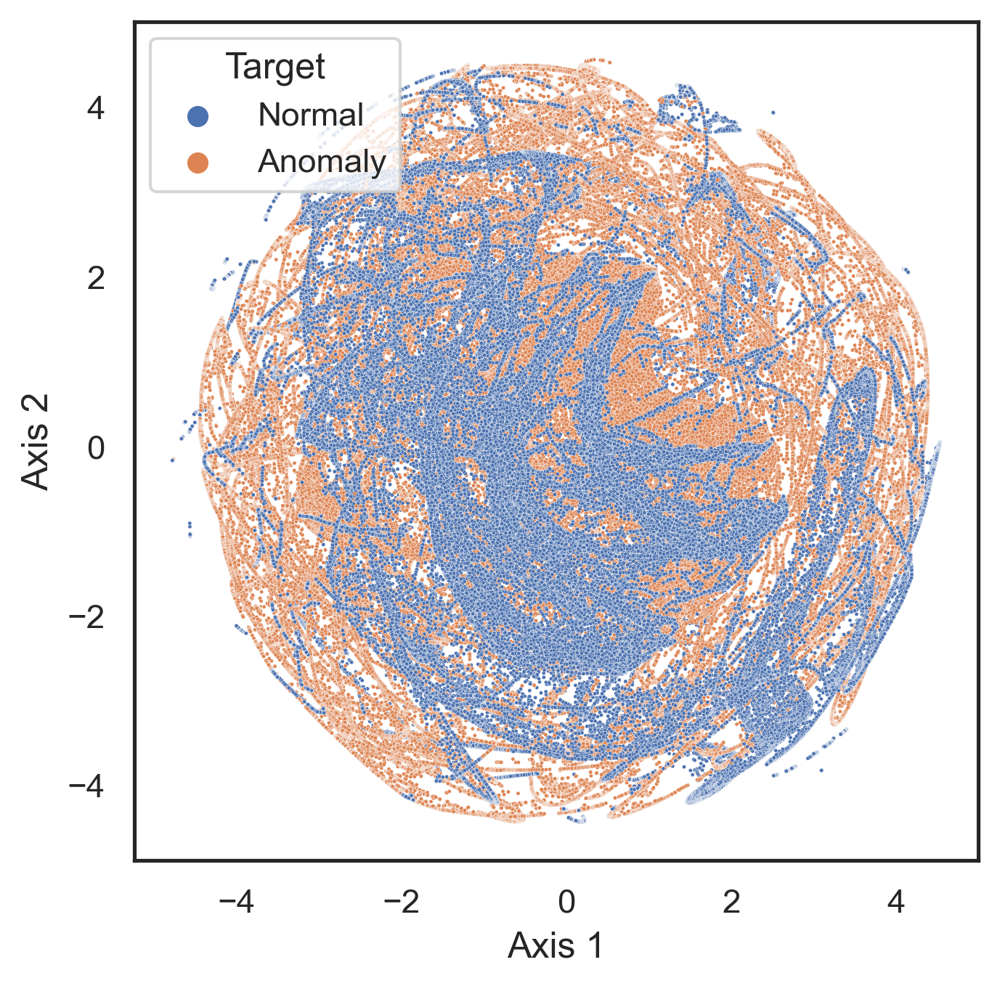

In [346]:
import numpy as np
import pandas as pd

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(X_resA)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))

X_resA['Axis 1'] = tsne_results[:,0]
X_resA['Axis 2'] = tsne_results[:,1]
y_resY.rename('Target', inplace = True)
plt.figure(figsize=(5,5),dpi=300)
sns.scatterplot(
    x="Axis 1", y="Axis 2",
    hue=y_resY,
    data=X_resA,
    legend="full",
    alpha=1.0,
    linewidths=1.0,
    marker='o',
    s=1.6
)
plt.savefig('ADASYNScatter.pdf')

C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\knowl\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 288688 samples in 0.085s...
[t-SNE] Computed neighbors for 288688 samples in 12627.813s...
[t-SNE] Computed conditional probabilities for sample 1000 / 288688
[t-SNE] Computed conditional probabilities for sample 2000 / 288688
[t-SNE] Computed conditional probabilities for sample 3000 / 288688
[t-SNE] Computed conditional probabilities for sample 4000 / 288688
[t-SNE] Computed conditional probabilities for sample 5000 / 288688
[t-SNE] Computed conditional probabilities for sample 6000 / 288688
[t-SNE] Computed conditional probabilities for sample 7000 / 288688
[t-SNE] Computed conditional probabilities for sample 8000 / 288688
[t-SNE] Computed conditional probabilities for sample 9000 / 288688
[t-SNE] Computed conditional probabilities for sample 10000 / 288688
[t-SNE] Computed conditional probabilities for sample 11000 / 288688
[t-SNE] Computed conditional probabilities for sample 12000 / 288688
[t-SNE] Computed conditional pr

[t-SNE] Computed conditional probabilities for sample 118000 / 288688
[t-SNE] Computed conditional probabilities for sample 119000 / 288688
[t-SNE] Computed conditional probabilities for sample 120000 / 288688
[t-SNE] Computed conditional probabilities for sample 121000 / 288688
[t-SNE] Computed conditional probabilities for sample 122000 / 288688
[t-SNE] Computed conditional probabilities for sample 123000 / 288688
[t-SNE] Computed conditional probabilities for sample 124000 / 288688
[t-SNE] Computed conditional probabilities for sample 125000 / 288688
[t-SNE] Computed conditional probabilities for sample 126000 / 288688
[t-SNE] Computed conditional probabilities for sample 127000 / 288688
[t-SNE] Computed conditional probabilities for sample 128000 / 288688
[t-SNE] Computed conditional probabilities for sample 129000 / 288688
[t-SNE] Computed conditional probabilities for sample 130000 / 288688
[t-SNE] Computed conditional probabilities for sample 131000 / 288688
[t-SNE] Computed con

[t-SNE] Computed conditional probabilities for sample 239000 / 288688
[t-SNE] Computed conditional probabilities for sample 240000 / 288688
[t-SNE] Computed conditional probabilities for sample 241000 / 288688
[t-SNE] Computed conditional probabilities for sample 242000 / 288688
[t-SNE] Computed conditional probabilities for sample 243000 / 288688
[t-SNE] Computed conditional probabilities for sample 244000 / 288688
[t-SNE] Computed conditional probabilities for sample 245000 / 288688
[t-SNE] Computed conditional probabilities for sample 246000 / 288688
[t-SNE] Computed conditional probabilities for sample 247000 / 288688
[t-SNE] Computed conditional probabilities for sample 248000 / 288688
[t-SNE] Computed conditional probabilities for sample 249000 / 288688
[t-SNE] Computed conditional probabilities for sample 250000 / 288688
[t-SNE] Computed conditional probabilities for sample 251000 / 288688
[t-SNE] Computed conditional probabilities for sample 252000 / 288688
[t-SNE] Computed con

<AxesSubplot:xlabel='tsne-2d-one', ylabel='tsne-2d-two'>

C:\Users\knowl\anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


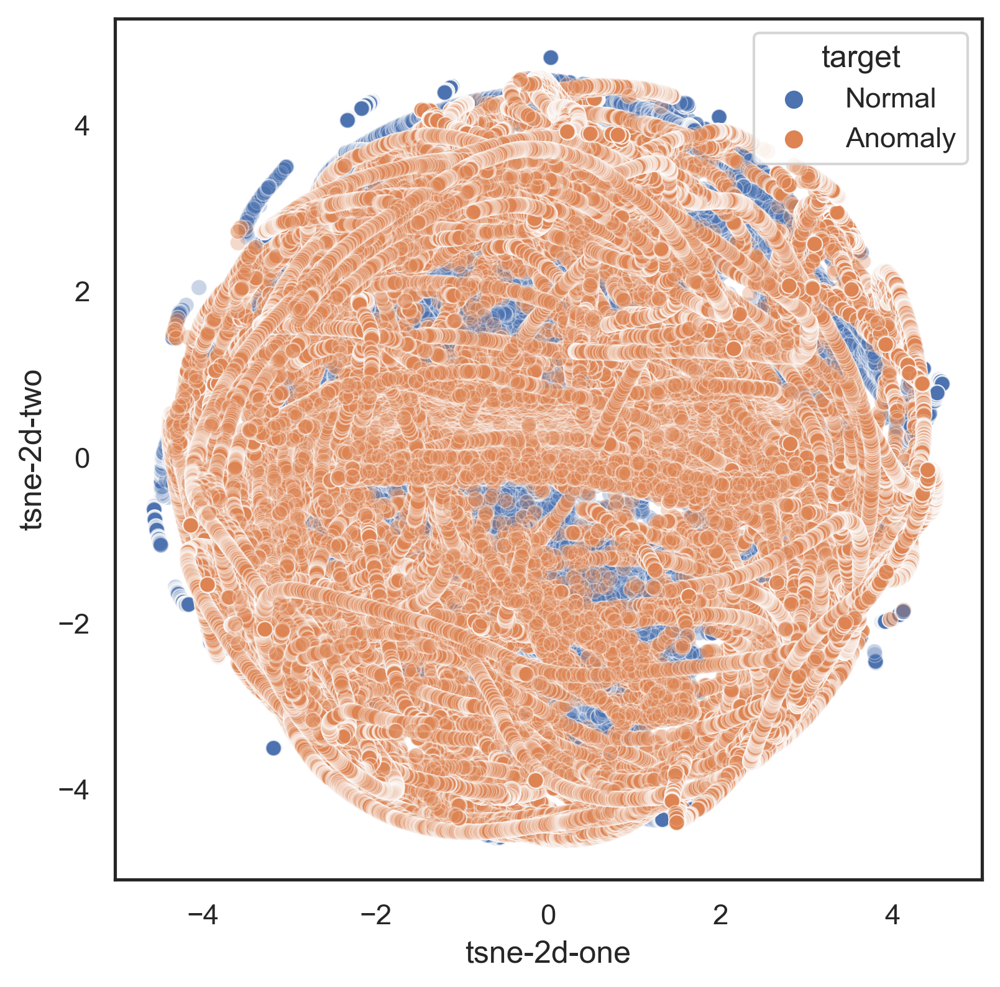

In [325]:
import numpy as np
import pandas as pd

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(ctganFeature)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))
ctganFeature['Axis 1'] = tsne_results[:,0]
ctganFeature['Axis 2'] = tsne_results[:,1]
ctgantarget.rename('Target', inplace = True)
plt.figure(figsize=(5,5),dpi=300)
sns.scatterplot(
    x="Axis 1", y="Axis 2",
    hue=ctgantarget,
    data=ctganFeature,
    legend="full",
    alpha=1.0,
    linewidths=1.0,
    marker='o',
    s=1.6
)
plt.savefig('ctganScatter.pdf')


In [45]:
def conf_matrix(an, title):
    fig, ax =plt.subplots(figsize=(6,6))
    labels=['Anomaly', 'Normal']
    ax=sns.heatmap(an, annot=True, cmap="Blues", fmt='g', cbar=False, annot_kws={"size":25})
    plt.title(title, fontsize=20)
    ax.xaxis.set_ticklabels(labels, fontsize=17) 
    ax.yaxis.set_ticklabels(labels, fontsize=17)
    ax.set_ylabel('Test', fontsize=20)
    ax.set_xlabel('Predicted', fontsize=20)
    plt.savefig('conIMBALANCED.pdf')

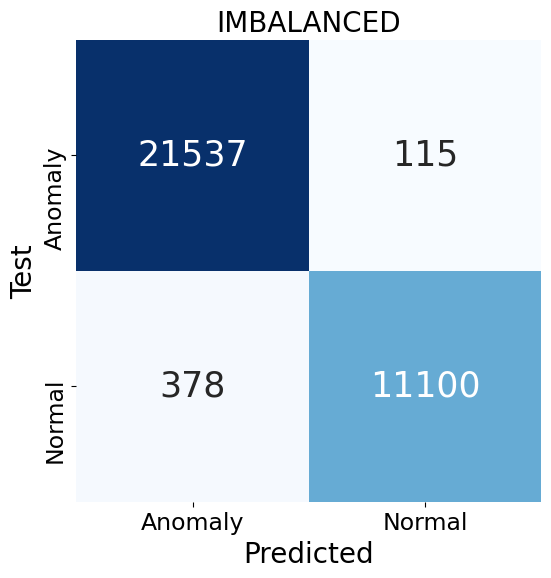

In [48]:
array6 = [[21537  , 115],
 [  378, 11100]]
conf_matrix(array6, 'IMBALANCED')

In [6]:
TP=21537            
TN=11100   
FP=115
FN=378    


print((TP+TN)/(TP+TN+FP+FN))
p=(TP)/(TP+FP)
print(p)
r=(TP)/(TP+FN)
print(r)

print(2*(p*r)/(p+r))

0.9851192272864473
0.9946887123591354
0.9827515400410678
0.9886840957605527


In [21]:
TP=21519            
TN=21362   
FP=133
FN=290    


print((TP+TN)/(TP+TN+FP+FN))
p=(TP)/(TP+FP)
print(p)
r=(TP)/(TP+FN)
print(r)

print(2*(p*r)/(p+r))

0.9902318492518012
0.9938573803805653
0.98670273740199
0.990267136053013


In [24]:
# Python program to demonstrate how to
# perform two sample T-test

# Import the library
import scipy.stats as stats

# Creating data groups
data_group1 = np.array([ 0.990, 0.993,  0.986, 0.990])

data_group2 = np.array([0.991, 0.992, 0.990,0.991])



In [25]:
# t-test for independent samples
from math import sqrt
from numpy.random import seed
from numpy.random import randn
from numpy import mean
from scipy.stats import sem
from scipy.stats import t

# function for calculating the t-test for two independent samples
def independent_ttest(data1, data2, alpha):
	# calculate means
	mean1, mean2 = mean(data1), mean(data2)
	# calculate standard errors
	se1, se2 = sem(data1), sem(data2)
	# standard error on the difference between the samples
	sed = sqrt(se1**2.0 + se2**2.0)
	# calculate the t statistic
	t_stat = (mean1 - mean2) / sed
	# degrees of freedom
	df = len(data1) + len(data2) - 2
	# calculate the critical value
	cv = t.ppf(1.0 - alpha, df)
	# calculate the p-value
	p = (1.0 - t.cdf(abs(t_stat), df)) * 2.0
	# return everything
	return t_stat, df, cv, p

# seed the random number generator
seed(1)
# generate two independent samples
data1 = np.array([ 0.990, 0.993,  0.986, 0.990])
data2 = np.array([ 0.990, 0.993,  0.986, 0.990])
# calculate the t test
alpha = 0.5
t_stat, df, cv, p = independent_ttest(data1, data2, alpha)
print('t=%.3f, df=%d, cv=%.3f, p=%.3f' % (t_stat, df, cv, p))
# interpret via critical value
if abs(t_stat) <= cv:
	print('Accept null hypothesis that the means are equal.')
else:
	print('Reject the null hypothesis that the means are equal.')
# interpret via p-value
if p > alpha:
	print('Accept null hypothesis that the means are equal.')
else:
	print('Reject the null hypothesis that the means are equal.')

t=-0.837, df=6, cv=0.000, p=0.435
Reject the null hypothesis that the means are equal.
Reject the null hypothesis that the means are equal.
